In [1]:
%matplotlib inline
import itertools
import bz2
import json
import pandas
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import networkx as nx
import glob
import fastjet
import awkward as ak
import vector
import math
import awkward
from operator import mul

In [2]:
jetdef = fastjet.JetDefinition(fastjet.antikt_algorithm, 0.4)# What is this?

## Datasets

CLIC detector model, Full Geant4 simulation: https://hepsim.jlab.org/taginfo.php?id=rfull201.

- `/scratch-persistent/joosep/ml-tau-reco/clic/gev380ee_pythia6_ttbar_rfull201/`

In [3]:
#This is is all data. 3600 files . 
#When something works then loop over that data

# Plot one event

In [65]:
#An old detector note describing how to compute track parameters
#http://flc.desy.de/lcnotes/notes/localfsExplorer_read?currentPath=/afs/desy.de/group/flc/lcnotes/LC-DET-2006-004.pdf 
a = 3*10**-4
b = 5 #B-field in tesla

def track_pt(omega):
    return a*np.abs(b/omega)

In [82]:
#Create the genparticle -> track/cluster -> particle flow event graph
#Graph means. 
def event_to_graph(df_gen, df_cl, df_tr, df_pfs):
    g = nx.DiGraph()
    
    #Add genparticles
    for igen in range(len(df_gen)):
        g.add_node("gen{}".format(igen), typ=int(df_gen[igen]["pdgid"]), e=df_gen[igen]["energy"])

    #Add links to parents
    for igen in range(len(df_gen)):
        
        #Add links to parents
        idx_parent0 = int(df_gen[igen]["idx_parent0"])
        if idx_parent0 != -1:
            g.add_edge("gen{}".format(idx_parent0), "gen{}".format(igen), w=0)
            
        idx_parent1 = int(df_gen[igen]["idx_parent1"])
        if idx_parent1 != -1:
            g.add_edge("gen{}".format(idx_parent1), "gen{}".format(igen), w=0)
            
    #Add calorimeter clusters
    for icl in range(len(df_cl)):
        g.add_node(
            "clu{}".format(icl),
            typ=df_cl[icl]["type"],
            e=df_cl[icl]["energy"]
        )
        
        #Add links from genparticles to cluster
        #The weight is the energy contribution from the genparticle
        for gp, gp_w in zip(df_cl[icl]["gp_contributions"]["0"], df_cl[icl]["gp_contributions"]["1"]):
            gp = int(gp)
            if gp_w/df_cl[icl]["energy"]>0.2:
                g.add_edge("gen{}".format(gp), "clu{}".format(icl), w=gp_w)

    #Add tracks
    for itr in range(len(df_tr)):
        g.add_node("tra{}".format(itr), typ=0, e=df_tr[itr]["pt"])
        
        #Add links from genparticles to track.
        #The weight is the number of hits in the track that came from this genparticle
        for gp, gp_w in zip(df_tr[itr]["gp_contributions"]["0"], df_tr[itr]["gp_contributions"]["1"]):
            gp = int(gp)
            if gp_w/df_tr[itr]["nhits"]>0.2:
                g.add_edge("gen{}".format(gp), "tra{}".format(itr), w=gp_w)

    #Add PF objects
    for ipf in range(len(df_pfs)):
        g.add_node(
            "pfo{}".format(ipf),
            typ=int(df_pfs[ipf]["type"]),
            e=df_pfs[ipf]["energy"]
        )
        
        #Add link from cluster to PF object if available
        cl_idx = int(df_pfs[ipf]["cluster_idx"])
        if cl_idx!=-1:
            g.add_edge("clu{}".format(cl_idx), "pfo{}".format(ipf), w=0)

        #Add link from track to PF object if available
        tr_idx = int(df_pfs[ipf]["track_idx"])
        if tr_idx!=-1:
            g.add_edge("tra{}".format(tr_idx), "pfo{}".format(ipf), w=0)
    return g
#Can ignore this code basically. Reconstructing graph cahin

In [115]:
#Given the decay graph, estiamte the energy in each PF object that came from the generator-level tau
def get_tau_fractions(idx_taus, df_pfs, g):
    
    tau_genparticles = [
        "gen{}".format(x) for x in idx_taus
    ]
    
    energy_tau_tr = np.zeros(len(df_pfs["energy"]))
    energy_tau_cl = np.zeros(len(df_pfs["energy"]))
    
    for genp in tau_genparticles:
        
        #Get all the nodes reachable from this gen tau
        ng = nx.descendants(g, genp)
        
        #Find the particle flow objects downstream from the gen tau
        pfs = [node for node in ng if node.startswith("pfo")]
        
        #Loop over all the particle flow objects
        for pfpart in pfs:
            ipf = int(pfpart[3:])
            
            e_tr = 0.0
            e_cl = 0.0
            for pred in list(g.predecessors(pfpart)):
                
                #if this PF object came from a track, get the energy from the parent genparticle
                if pred.startswith('tra'):
                    track_preds = list(g.predecessors(pred))
                    for this_tr_pred in track_preds:
                        e_tr += g.nodes[this_tr_pred]["e"]
                        
                #if this PF object came from a cluster, get the energy from the edge
                elif pred.startswith('clu'):
                    cl_preds = list(g.predecessors(pred))
                    for this_cl_pred in cl_preds:
                        e_cl += g.edges[(this_cl_pred, pred)]["w"]
            
            energy_tau_tr[ipf] = e_tr
            energy_tau_cl[ipf] = e_cl
            
#             print("  {} {} E_pf={:.2f} E_tau_tr={:.2f} E_tau_cl={:.2f}".format(
#                 pfpart, g.nodes[pfpart]["typ"], g.nodes[pfpart]["e"], e_tr, e_cl)
#             )
    df_pf_taufracs = pandas.DataFrame()
    df_pf_taufracs["energy_tau_tr"] = energy_tau_tr
    df_pf_taufracs["energy_tau_cl"] = energy_tau_cl
    return df_pf_taufracs

#I dont need. Each PF canditade and how much comes from TAU.

In [102]:
def compute_track_properties(df_tr):
    df_tr["pt"] = track_pt(df_tr["omega"])
    df_tr["px"] = np.cos(df_tr["phi"])*df_tr["pt"]
    df_tr["py"] = np.sin(df_tr["phi"])*df_tr["pt"]
    df_tr["pz"] = df_tr["tan_lambda"]*df_tr["pt"]
    
#Properties of the tracks #read track properties if ypu want to use.

In [103]:
def computeJet(pfs_this_jet):
    p4sum = {'px':0, 'py':0, 'pz':0, 'energy':0 }
    for key in p4sum:
        for e in pfs_this_jet[key]:
            p4sum[key]+=e
    return vector.obj(x=p4sum['px'],y=p4sum['py'],z=p4sum['pz'],E=p4sum['energy'])

In [104]:
def process_one_event(data, iev):
    
    #Get the dataframes corresponding to this event
    df_gen = data[iev]["genparticles"]
    df_cl = data[iev]["clusters"]
    df_tr = data[iev]["tracks"]
    df_pfs = data[iev]["pfs"]
    compute_track_properties(df_tr)#Might be useful

    #Get the generator taus with status==2
    #PDG= number assigned to generator particles
    #Status=2 mean this is the last tau in the decay chain. 
    idx_taus = awkward.where((np.abs(df_gen["pdgid"])==15) & (df_gen["status"]==2))[0]
    
    #cluster the PF particles to jets, reorder by pt descending.
    cluster = fastjet.ClusterSequence(ak.Array({
        "px": df_pfs["px"],
        "py": df_pfs["py"],
        "pz": df_pfs["pz"],
        "E": df_pfs["energy"],
    }), jetdef)
    jets_constituents = cluster.constituent_index(min_pt=5)[::-1]
    #Usually anti k_t jets. 
    
    #Get the tau contributions in each PF object
    graph = event_to_graph(df_gen, df_cl, df_tr, df_pfs)
    df_pfs_taufrac = get_tau_fractions(idx_taus, df_pfs, graph)
    
    #Now get the list of PF objects in each jet
    pfs_by_jet = []
    jets = []
    for jet_constituents in jets_constituents:
        
        #Get the PF objects corresponding to this jet
        pfs_jet = df_pfs.iloc[jet_constituents]
        pfs_jet_additional = df_pfs_taufrac.iloc[jet_constituents]
        pfs_this_jet = pandas.concat([pfs_jet, pfs_jet_additional], axis=1)
        pfs_by_jet.append(pfs_this_jet)
        jet = computeJet(pfs_this_jet)
        jets.append(jet)

    #return the gen taus, the computed jet, the list of PF candidates in each jet, cluster, tracks and genparticles
    return df_tau, jets, pfs_by_jet, df_cl, df_tr, df_gen
#pfs_by_jet

In [105]:
def filterPFS(pfs, df_cl, df_tr, df_gen): #quality criteria for pfs: https://cmssdt.cern.ch/lxr/source/RecoTauTag/RecoTau/python/PFRecoTauQualityCuts_cfi.py
    goodPFS =[]
    for ipf, pf in enumerate(pfs.iterrows()):
        pftype = abs(int(pf[1]['type']))
        if pftype == 211 or pftype == 11: #charged pion / electron 
            trackidx = int(pf[1]['track_idx'])
            if trackidx <0:
                print('faulty pf')
                continue
            if df_tr.iloc[trackidx]['pt']<0.5: continue # track pt cut
            if df_tr.iloc[trackidx]['z0']>0.4 : continue #dz cut, are these wrt primary vertex or detector center?
            if math.sqrt(max(0,df_tr.iloc[trackidx]['d0']**2-df_tr.iloc[trackidx]['z0']**2)) >0.1 : continue #dxy cut, are these wrt primary vertex or detector center?
            if df_tr.iloc[trackidx]['nhits']<5 : continue # nhits? do we need a chi2 cut ?
        elif pftype == 22 or pftype == 2112: #photon / pi0 / neutral hadron
            clusteridx = int(pf[1]['cluster_idx'])
            if clusteridx <0:
                print('faulty pf')
                continue
            tempPF = vector.obj(x=pf[1]['px'],y=pf[1]['py'],z=pf[1]['pz'],E=pf[1]['energy'])
            if tempPF.pt < 1 : continue
            if tempPF.pt < 30 and pftype == 2112 : continue
        goodPFS.append(pf)
    return goodPFS
def cleanJets(df_tau, jets, pfs_by_jet, df_cl, df_tr,df_gen, cleanPFS=True, recomputeJet=False, matchingCone=0.3, invertTau=False):
    matched_jets = []
    cleaned_pfs_by_matchedjet = []
    matched_tau = []
    leptonic=0
    hadronic=0
    for njet, jet in enumerate(jets):
        cleaned_pfs = pfs_by_jet[njet]
        if cleanPFS: cleaned_pfs = filterPFS(cleaned_pfs,df_cl, df_tr, df_gen)
        cleanedJet = jet
        if recomputeJet: cleanedJet = computeJet(cleaned_pfs)
        matchedTau = None
        matchedTau_index = -1
        
        #tau pdgid 15
        #Units in GeV
        
        
        #if len(df_tau)>1:
            #print(f'On küll suuremaid: {len(df_tau)}')
        for itau, tau in enumerate(df_tau.iterrows()):
    
            #print(tau[1])
            tempTau = vector.obj(x=tau[1]['px'],y=tau[1]['py'],z=tau[1]['pz'],E=tau[1]['energy'])
            #print(tempTau)
            #if tau is not hadronic then skip it-function needed iterate over df_gen
            #print(df_gen)
            print(f'print df_tau:\n {df_tau}')
            if check_if_leptonic(df_tau,df_gen):
                leptonic+=1
                continue
            else:
                hadronic+=1
            
    
            if matchedTau is None:
                if tempTau.deltaR(cleanedJet)<matchingCone :
                    matchedTau=tempTau
                    matchedTau_index=itau 
        
            elif tempTau.deltaR(cleanedJet) < matchedTau.deltaR(cleanedJet) :
                
                matchedTau=tempTau
                matchedTau_index=itau
        if invertTau and matchedTau is None:
            matched_jets.append(cleanedJet)
            cleaned_pfs_by_matchedjet.append(cleaned_pfs)
        elif matchedTau is not None:
            matched_tau.append(df_tau.iloc[matchedTau_index])
            matched_jets.append(cleanedJet)
            cleaned_pfs_by_matchedjet.append(cleaned_pfs)
    return matched_tau, matched_jets, cleaned_pfs_by_matchedjet,df_gen,df_tau,leptonic,hadronic
#

# Process one event

In [117]:
data = ak.from_parquet("../testdata/pythia6_ttbar_0001_pandora.parquet")

#data = json.load(bz2.BZ2File("/scratch-persistent/joosep/ml-tau-reco/clic/gev380ee_pythia6_ttbar_rfull201/pythia6_ttbar_0115_pandora_10.json.bz2", "r"))
ret = process_one_event(data, 3)
#ret = cleanJets(ret[0], ret[1], ret[2], ret[3], ret[4], ret[5])
#print(ret[0], ret[1], ret[2])
#df_gen=ret[3]|
#df_tau=ret[4]
#Tau properties are printed
#name 22 is jets
#and below that PF canditaes. 
#pandora 4 event 3 even better.

ValueError: operands could not be broadcast together with shapes (1,84) (1,43) 

{'0': 192, '1': 0.399}
{'0': 144, '1': 0.212}


In [48]:
data["clusters"]["gp_contributions"]

<Array [[[{'0': 192, ... '1': 0.207}]]] type='49 * var * var * {"0": int64, "1":...'>

In [366]:
ret[4]


,charge,energy,idx_parent0,idx_parent1,mass,pdgid,pdgid_parent0,pdgid_parent1,px,py,pz,status
146,-1.0,21.064941,85,-1,1.777,15,-511,0,-16.135698,6.16804,-11.923444,2


In [62]:
check_if_leptonic(df_tau,df_gen)

NameError: name 'df_tau' is not defined

In [1114]:
tau_daughters #pandora 4 event 3 even better.
#anti-electron neutrino, electron

[-12, 11, 16]

In [61]:
leptons=[11,12,13,14]
#res = any(ele in test_string for ele in test_list)#Returns True False
tau_daughters=[abs(i) for i in tau_daughters]
print(tau_daughters)
res = any(ele in tau_daughters for ele in leptons)
if any(ele in tau_daughters for ele in leptons):
    print("leptonic")

NameError: name 'tau_daughters' is not defined

In [259]:
#DeltaR test
examp1=ret[2][0][0][1]
examp2=ret[2][0][1][1]
examp2.type
vec1=getPF_lv(examp1)
vec2=getPF_lv(examp2)
#Dr (solid angle) leiad kahe vecktori lv vectori järgi
print(vec1.deltaR(vec2))
#pikalt on $\Delta R = \sqrt{\Delta\phi^2 + \Delta\eta^2}$
def deltaR(vec1,vec2):
    deltaR=np.sqrt((vec1.phi-vec2.phi)**2+(vec1.eta-vec2.eta)**2)
    return deltaR
print(deltaR(vec1,vec2))

0.11360930532302599
0.11360930532302599


# Strips
To reconstruct the full energy of the neutral pions, the electron and
photon candidates falling within a certain region of ∆η×∆φ are clustered together, with the
resulting object referred to as a “strip”. 

The initial position of the strip in the η − φ plane is set
according to the η and φ of the seed e or γ.

In [ ]:
#Are electrons in same strip

In [559]:
print(f'eta_bounds: {eta_bounds}, phi_bounds: {phi_bounds}')
print(f'photon eta:{photon.eta}, electron phi: {photon.phi}')
print(f'electron eta:{electron.eta}, electron phi: {electron.phi}')
print(f'electron2 eta:{electron2.eta}, electron2 phi: {electron2.phi}')

eta_bounds: [-0.6708204516183678, -0.6208204516183677], phi_bounds: [2.6642361980112637, 2.864236198011264]
photon eta:-0.6458204516183678, electron phi: 2.7642361980112637
electron eta:-0.6233909230719732, electron phi: 2.857109777646021
electron2 eta:-0.7431784667916799, electron2 phi: 3.048721790997009


In [ ]:
event 3 one photon and pion. 2 decay modes can be bulit. I have one strip
event 1 is boring one electron
If empty - cleanJETS
COne important

In [ ]:
#phi azimuthal angle(transverse plane) theta polar angle(parallel to z). 
#22-photon
#11-electron
#211-pion
#111- neutral pion

In [ ]:
#neutron code mean neutron. because you can not be sure.
#we have a tau and in the end i see charged pions and photons. 
# For mor events try to see if i can reimplement HPS. First try to do strips and plot out. 
#And try to understand whats going on. Negative masses would be bad :D. Maybe need to poke 
#filterPFS and clean jets but above them it I do not need. Strips with lists below jets. 
# ONE IMPORTANT THING: python functions for 4 vector moduls. DeltaR and shit like that.

In [438]:
def get_e_and_y(event_pfs):
    #Funtion to get pf candidates that are photons or electrons
    e_and_y = []
    for pf in event_pfs:
        pf_type=abs(pf[1].type)
        if pf_type == 22 or pf_type == 11: #photon(22) or electron(11)
            #print(pf_type)
            #print(pf[1])
            e_and_y.append(pf[1])
            
    return e_and_y

def get_pions(event_pfs):
        #Funtion to get pf candidates that are pions
    pions = []
    for pf in event_pfs:
        pf_type=abs(pf[1].type)
        #print(pf_type)
        if pf_type == 111 or pf_type == 211: #pi^0(22) or pi^+(11)
            pions.append(pf[1])
    return pions  
def get_electrons(event_pfs):
    #Funtion to get pf candidates that are photons or electrons
    electrons = []
    for pf in event_pfs:
        pf_type=abs(pf[1].type)
        if pf_type == 11: #photon(22) or electron(11)
            #print(pf_type)
            #print(pf[1])
            electrons.append(pf[1])
    return electrons

def get_pf_mass(pf_obj):
    obj_lv=getPF_lv(pf_obj)#object lorentz vector
    mass=obj_lv.m #invariant mass of object
    return mass  

def get_invm(pf_obj):# just hands on version of previous mass function
    inv_m=np.sqrt((pf_obj.energy**2)-(pf_obj.px**2)-(pf_obj.py**2)-(pf_obj.pz**2))
    return inv_m

def deltaR(vec1,vec2):#hands on version of deltaR function
    deltaR=np.sqrt((vec1.phi-vec2.phi)**2+(vec1.eta-vec2.eta)**2)
    return deltaR

def getPF_lv(pf_obj):
    #Function for getting lorentz momentum vector from PF candidates
    lv = vector.obj(x=pf_obj['px'],y=pf_obj['py'],z=pf_obj['pz'],E=pf_obj['energy'])
    return lv

def get_all_PF_lv(pf_objects):
    #Function that converts and returns pf objects as lorentz vectors
    lvs=[]
    for obj in pf_objects:
        lvs.append(getPF_lv(obj))
    return lvs
def sort_by_pt(pf_objects):
    #Function that sorts pf objects by pt in descending order 
    #returns both lvs and pfs in same order
    PF_lv_objects=get_all_PF_lv(pf_objects)
    pts=[obj.pt for obj in PF_lv_objects]
    sorted_indx=sorted(range(len(pts)), reverse=True, key=lambda k: pts[k])#https://stackoverflow.com/questions/7851077/how-to-return-index-of-a-sorted-list
    sorted_lvs=[]
    sorted_pfs=[]
    for  indx in sorted_indx:
        sorted_lvs.append(PF_lv_objects[indx])
        sorted_pfs.append(pf_objects[indx])
        
    return sorted_lvs,sorted_pfs

def sort_by_pt2(lvs_objects):
    #Function that sorts pf objects by pt in descending order 
    #returns both lvs and pfs in same order
    pts=[obj.pt for obj in lvs_objects]
    sorted_indx=sorted(range(len(pts)), reverse=True, key=lambda k: pts[k])#https://stackoverflow.com/questions/7851077/how-to-return-index-of-a-sorted-list
    sorted_lvs=[]
    for  indx in sorted_indx:
        sorted_lvs.append(lvs_objects[indx])
        
    return sorted_lvs

def calc_strips_properties(all_strips):
    #Finction to calculate masses pts and etas of events
    masses=[]
    etas=[]
    pts=[]
    for event_strips in all_strips:
        #print(event_strips)
        if len(event_strips) > 1:
            for strip in event_strips:
                strip_mass=0
                strip_p4=vector.obj(x=0,y=0,z=0,E=0)
                strip_ptsum=0
                for strip_comp in strip['lvs']:
                    #print(strip_comp.mass)
                    strip_p4+=strip_comp
                    strip_ptsum+=strip_comp.pt# 
                    #strip_mass += strip_comp.mass
                    #print(strip_mass)
                    print(strip_ptsum)
                #If strip pt sum(not constituents lv) bigger than 2.5 
                #then it is a PI^0 candidate
                masses.append(strip_p4.mass)
                etas.append(strip_p4.eta)
                pts.append(strip_p4.pt)
                #prnt(masses)
                
                
        else:
            #print(event_strips[0]['lvs'])
            #print(event_strips[0]['lvs'][0].mass)
            masses.append(event_strips[0]['lvs'][0].mass)
    return masses,etas,pts

#event_pfs=ret[2][0]

def cal_strips_event(event_pfs):
    #Function returns strips as pf objects with thei complimentary lorentz vectros
    e_and_y=get_e_and_y(event_pfs)
    sorted_lvs,sorted_pfs=sort_by_pt(e_and_y)
    
    strips=[]
    while len(sorted_lvs) != 0:
        strip={ "lvs" : [] , "pfs" : []}
        strip['lvs'].append(sorted_lvs[0])
        strip['pfs'].append(sorted_pfs[0])
        seed_loc={ "eta" : sorted_lvs[0].eta, "phi" : sorted_lvs[0].phi}
        eta_bounds,phi_bounds=calc_window(seed_loc)
        del sorted_lvs[0],sorted_pfs[0] # remove from list so it will be easier to loop
    
        if len(sorted_lvs) ==1 :
            strip['lvs'].append(sorted_lvs[0])
            strip['pfs'].append(sorted_pfs[0])
        for i,lv in enumerate(sorted_lvs):
            #print(i)
            #print(lv)
            if check_if_in_window(lv,eta_bounds,phi_bounds) == True:
                #print('if True')
                #add to strip
                strip['lvs'].append(sorted_lvs[i])
                strip['pfs'].append(sorted_pfs[i])
                del sorted_lvs[0],sorted_pfs[0]
                #test_strip=strip
                strip_loc= calc_strip_loc(strip)
                #print(strip_loc)
                eta_bounds,phi_bounds=calc_window(strip_loc)
                #print(eta_bounds, phi_bounds)
            #else:
                #print('not in bounds')
        strips.append(strip)
    
    return strips

def calc_strip_loc(strip_lv_objects):
    strip_objects_eta=[obj.eta for obj in strip_lv_objects['lvs']]
    strip_objects_phi=[obj.phi for obj in strip_lv_objects['lvs']]
    #print(strip_objects_eta)
    #print(strip_objects_phi)
    #pf_object_eta=pf_object.eta
    #pf_object_phi=pf_object.phi
    strip_objects_pt= [obj.pt for obj in strip_lv_objects['lvs']]
    #pf_object_pt=pf_object.pt
    #pt_strip=pf_object_pt
    eta_mult=[*map(mul,strip_objects_pt,strip_objects_eta)]
    phi_mult=[*map(mul,strip_objects_pt,strip_objects_phi)]
    eta_strip=(1/sum(strip_objects_pt))*sum(eta_mult)
    phi_strip=(1/sum(strip_objects_pt))*sum(phi_mult)
    strip_loc={ "eta" : eta_strip, "phi" : phi_strip}
    return strip_loc

#Maybe calc_strip wrong. Lets see if we pu
        
def calc_window(seed_loc):
    #Function to calculate window for strip origin. Size (eta X phi)= (0.05 X 0.20)
    eta_bounds= [seed_loc['eta']-0.025, seed_loc['eta']+0.025]
    phi_bounds= [seed_loc['phi']-0.1, seed_loc['phi']+0.1]
    return eta_bounds,phi_bounds
def check_if_in_window(pf_object,eta_bounds,phi_bounds):
    #Function to check whether ovject is in strip origin window
    pf_object_eta=pf_object.eta
    pf_object_phi=pf_object.phi
    #print(pf_object_eta)
    #print(pf_object_phi)
    #print(eta_bounds[0],eta_bounds[1])
    if eta_bounds[0] < pf_object_eta < eta_bounds[1] and phi_bounds[0] < pf_object_phi < phi_bounds[1]:
        return True
    else:
        return False
    
    
#Taking a look at the daughters of the tau particle.
#Tau neutrino in every decay. Leptonical channel has muon, electron or their neutrinos.
#so events that have them i will classify them leptonic decay.
def check_if_leptonic(df_tau,df_gen):
    leptons=[11,12,13,14]
    tau_daughters=[]
    tau_idx=df_tau.index
    for i,gen_id in enumerate(df_gen['idx_parent0']):
        #print(f'gen_id: {gen_id} and tau_idx: {tau_idx}')
        if gen_id == tau_idx:#.all():
            tau_daughters.append(df_gen['pdgid'].iloc[i])
    tau_daughters=[abs(i) for i in tau_daughters]
    result = any(ele in tau_daughters for ele in leptons)

    return result

def sum_lvs(lvs):
    #Function to add up lvs
    lv_sum=vector.obj(px=0,py=0,pz=0,E=0)
    for i,lv in enumerate(lvs):
        #print(lv)
        lv_sum+=lv
    return lv_sum

def calc_conedr(lv_pt):
    #Function to calculate cone for tau candidate.
    cone_dr=3.0/lv_pt
    if cone_dr<0.05:
        cone_dr=0.05
    if cone_dr>0.1:
        cone_dr=0.1
    return cone_dr

def get_strip_lv(strip_lvs):
    #get strip lorentz vector sum
    strip_lv=sum_lvs(strip_lvs)
    return strip_lv 

def pion2strip_umass(tau_cand_pt):
    #Function to calc upper mass limit for tau candidate in
    #charged hadron + TWO strips mode
    sroot=np.sqrt(tau_cand_pt/100)
    if sroot<=1:
        return 1.2
    if sroot>=1:
        mult=1.2*sroot
        
        if mult<4.0:
            return mult
        else:
            return 4.0
        
def pion2strip_umass2(tau_cand_pt):
    #Function to calc upper mass limit for tau candidate in
    #charged hadron + ONE strips mode
    sroot=np.sqrt(tau_cand_pt/100)
    if sroot<=1:
        return 1.3
    if sroot>=1:
        mult=1.3*sroot
        
        if mult<4.2:
            return mult
        else:
            return 4.2
    

# Process all the data

In [ ]:
/scratch-persistent/joosep/ml-tau-reco/clic/gev380ee_pythia6_ttbar_rfull201/pythia6_ttbar_0115_pandora_10.json.bz2

In [1008]:
for fn in glob.glob("../testdata/*.json.bz2"):
    
    #Load the data file consisting of multiple events
    data = json.load(bz2.BZ2File(fn, "r"))
    
    #Loop over the events in the data file
    for iev in range(len(data)):
        #print(iev)
        process_one_event(data, iev)

In [374]:
pion_masses=[]
electron_masses=[]
all_pions=[]
all_pions_strips=[]
errors=0
event_count=0
hadronic=0
leptonic=0
more_than_1taus=[]
for nf,fn in enumerate(glob.glob("/scratch-persistent/joosep/ml-tau-reco/clic/gev380ee_pythia6_ttbar_rfull201/*.json.bz2")):
    #print('teen')
    if not nf % 100: print("Event: "+str(nf))
    event_count+=1
    if nf > 10: # -->15 min
        break
    #Load the data file consisting of multiple events
    data = json.load(bz2.BZ2File(fn, "r"))
    
    #Loop over the events in the data file
    
    for iev in range(len(data)):
        #print(iev)
        event_count+=1
        ret=process_one_event(data, iev)
        ret = cleanJets(ret[0], ret[1], ret[2], ret[3], ret[4], ret[5])
        #try:
            #ret = cleanJets(ret[0], ret[1], ret[2], ret[3], ret[4], ret[5])
        #except Exception:
            #errors +=1
            #print(f'errors: {errors}')
            #continue
        if len(ret[0])>1:
            #print("more than one taus")
            more_than_1taus.append([ret[0], ret[1], ret[2]])       
        leptonic+=ret[5]
        hadronic+=ret[6]
        #print(f'length of ret {len(ret[2])}')
        if len(ret[2]):#if list contains something(Taus) do it:
            #print("Yeah contained something")
            taus=ret[0][0]
            jets=ret[1][0]
            event_pfs=ret[2][0]    
            pions=get_pions(event_pfs)
            #Create a dict that combines strips,taus,pions,jets of single event    
            #Add all pions to a list from which the tau candidates can be calculated
            strips_pions_taus={'strips' : [], 'pions' : pions ,'taus' : taus, 'jets' : jets}
            electrons=get_electrons(event_pfs)
            for el in electrons:
                electron_masses.append(get_pf_mass(el)*10**3)# Adding pion masses
            for pion in pions:
                pion_masses.append(get_pf_mass(pion)*10**3)# Adding pion masses
                
            strips=cal_strips_event(event_pfs)
            #print(len(strips))
            
            
            if len(strips)!=0: #some events contain only pions. Have to fix it right no just a patch with a if clause
                #So if strips has any length then add to memory. If not ignore
                #strips_pions_taus['strips'].append(strips)
                strips_pions_taus['strips']=strips
            #temptau error exception
            all_pions_strips.append(strips_pions_taus)
            
        else: #if empty continue
            continue
            
        #print(f'errors:{errors} ')
        

Event: 0
print df_tau:
     charge     energy  idx_parent0  idx_parent1   mass  pdgid  pdgid_parent0  \
20    -1.0  16.971327           15           19  1.777     15             15   

    pdgid_parent1        px       py         pz  status  
20            -24  9.204911  3.65707 -13.666149       2  
gen_id: -1 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: -1 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.20

gen_id: 287 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 288 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 289 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777

gen_id: 102 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 104 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 104 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777

gen_id: 378 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 378 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 378 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777

gen_id: 181 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 181 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 204 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777

gen_id: 335 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 461 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 334 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777

gen_id: 141 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 141 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 147 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777

gen_id: 281 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 291 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 295 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777

gen_id: 72 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 72 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 72 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000

gen_id: 68 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 68 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 422 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.77700

gen_id: 89 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 89 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 91 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000

gen_id: 400 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 320 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px                9.204911
py                3.657070
pz              -13.666149
status            2.000000
Name: 20, dtype: float64
gen_id: 320 and tau_idx: Int64Index([20], dtype='int64')
charge           -1.000000
energy           16.971327
idx_parent0      15.000000
idx_parent1      19.000000
mass              1.777

print df_tau:
      charge     energy  idx_parent0  idx_parent1   mass  pdgid  pdgid_parent0  \
198     1.0  24.423502          131           -1  1.777    -15            511   

     pdgid_parent1       px         py         pz  status  
198              0  6.70912 -20.202513 -11.840437       2  
gen_id: -1 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: -1 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px

gen_id: 291 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 291 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 291 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       

gen_id: 610 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 287 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 93 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -

Name: 198, dtype: float64
gen_id: 50 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 50 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 50 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.00

gen_id: 388 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 389 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 390 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       

charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 429 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 432 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15

Name: 198, dtype: float64
gen_id: 82 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 83 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 83 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.00

charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 400 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 401 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15

gen_id: 623 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 709 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 339 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       

gen_id: 102 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 111 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 111 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       

gen_id: 289 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 305 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 307 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       

charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 419 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 152 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15

gen_id: 340 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 340 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 341 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       

charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 81 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 431 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.

Name: 198, dtype: float64
gen_id: 119 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 120 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 120 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131

charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 145 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 145 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15

gen_id: 564 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 564 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    511.000000
pdgid_parent1      0.000000
px                 6.709120
py               -20.202513
pz               -11.840437
status             2.000000
Name: 198, dtype: float64
gen_id: 567 and tau_idx: Int64Index([198], dtype='int64')
charge             1.000000
energy            24.423502
idx_parent0      131.000000
idx_parent1       

print df_tau:
     charge     energy  idx_parent0  idx_parent1   mass  pdgid  pdgid_parent0  \
22     1.0  49.848507           13           20  1.777    -15            -15   

    pdgid_parent1         px        py        pz  status  
22             24  48.948563 -9.093624  1.749334       2  
gen_id: -1 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: -1 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py

gen_id: 199 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 450 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 199 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777

charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 12 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 12 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
p

gen_id: 160 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 160 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 282 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777

gen_id: 344 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 348 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 418 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777

gen_id: 72 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 73 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 73 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000

gen_id: 97 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 362 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 362 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.7770

gen_id: 467 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 470 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 472 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777

gen_id: 176 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 191 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 191 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777

Name: 22, dtype: float64
gen_id: 198 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 347 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 346 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.00000

gen_id: 0 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 1 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 10 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
p

Name: 22, dtype: float64
gen_id: 273 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 274 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 275 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.00000

charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 414 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 422 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000

gen_id: 124 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 123 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 123 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777

charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 459 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 459 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000

Name: 22, dtype: float64
gen_id: 172 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 172 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 172 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.00000

charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 435 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 198 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000

Name: 22, dtype: float64
gen_id: 6 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 2 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 3 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass

charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 266 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px               48.948563
py               -9.093624
pz                1.749334
status            2.000000
Name: 22, dtype: float64
gen_id: 267 and tau_idx: Int64Index([22], dtype='int64')
charge            1.000000
energy           49.848507
idx_parent0      13.000000
idx_parent1      20.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000

print df_tau:
     charge    energy  idx_parent0  idx_parent1   mass  pdgid  pdgid_parent0  \
26    -1.0  99.86322           15           22  1.777     15             15   

    pdgid_parent1       px         py         pz  status  
26            -24 -58.0979  78.627983 -20.292336       2  
gen_id: -1 and tau_idx: Int64Index([26], dtype='int64')
charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px              -58.097900
py               78.627983
pz              -20.292336
status            2.000000
Name: 26, dtype: float64
gen_id: -1 and tau_idx: Int64Index([26], dtype='int64')
charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px              -58.097900
py  

gen_id: 38 and tau_idx: Int64Index([26], dtype='int64')
charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px              -58.097900
py               78.627983
pz              -20.292336
status            2.000000
Name: 26, dtype: float64
gen_id: 38 and tau_idx: Int64Index([26], dtype='int64')
charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px              -58.097900
py               78.627983
pz              -20.292336
status            2.000000
Name: 26, dtype: float64
gen_id: 38 and tau_idx: Int64Index([26], dtype='int64')
charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000

gen_id: 53 and tau_idx: Int64Index([26], dtype='int64')
charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px              -58.097900
py               78.627983
pz              -20.292336
status            2.000000
Name: 26, dtype: float64
gen_id: 54 and tau_idx: Int64Index([26], dtype='int64')
charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px              -58.097900
py               78.627983
pz              -20.292336
status            2.000000
Name: 26, dtype: float64
gen_id: 54 and tau_idx: Int64Index([26], dtype='int64')
charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000

charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px              -58.097900
py               78.627983
pz              -20.292336
status            2.000000
Name: 26, dtype: float64
gen_id: 58 and tau_idx: Int64Index([26], dtype='int64')
charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
pdgid_parent1   -24.000000
px              -58.097900
py               78.627983
pz              -20.292336
status            2.000000
Name: 26, dtype: float64
gen_id: 59 and tau_idx: Int64Index([26], dtype='int64')
charge           -1.000000
energy           99.863220
idx_parent0      15.000000
idx_parent1      22.000000
mass              1.777000
pdgid            15.000000
pdgid_parent0    15.000000
p

print df_tau:
      charge     energy  idx_parent0  idx_parent1   mass  pdgid  pdgid_parent0  \
154     1.0  41.101711           99           -1  1.777    -15            521   

     pdgid_parent1        px        py        pz  status  
154              0 -6.247486  39.69651  8.446825       2  
gen_id: -1 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: -1 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px  

charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 320 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 321 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15

Name: 154, dtype: float64
gen_id: 12 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 12 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 13 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.00

charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 133 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 133 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15

gen_id: 478 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 478 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 478 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       

gen_id: 425 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 125 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 129 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       

Name: 154, dtype: float64
gen_id: 80 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 80 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 85 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.00

charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 143 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 445 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15

Name: 154, dtype: float64
gen_id: 99 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 99 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 99 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.00

charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 402 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 403 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15

Name: 154, dtype: float64
gen_id: 63 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 64 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 64 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.00

charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 167 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 167 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15

Name: 154, dtype: float64
gen_id: 36 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 69 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 69 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.00

charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 318 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15.000000
pdgid_parent0    521.000000
pdgid_parent1      0.000000
px                -6.247486
py                39.696510
pz                 8.446825
status             2.000000
Name: 154, dtype: float64
gen_id: 319 and tau_idx: Int64Index([154], dtype='int64')
charge             1.000000
energy            41.101711
idx_parent0       99.000000
idx_parent1       -1.000000
mass               1.777000
pdgid            -15

print df_tau:
     charge     energy  idx_parent0  idx_parent1   mass  pdgid  pdgid_parent0  \
21     1.0  83.669807           13           19  1.777    -15            -15   
23    -1.0  42.973309           15           20  1.777     15             15   

    pdgid_parent1         px         py         pz  status  
21             24 -64.791862 -45.859013  26.390232       2  
23            -24 -39.396290 -15.964427   6.051192       2  
gen_id: -1 and tau_idx: Int64Index([21, 23], dtype='int64')
charge            1.000000
energy           83.669807
idx_parent0      13.000000
idx_parent1      19.000000
mass              1.777000
pdgid           -15.000000
pdgid_parent0   -15.000000
pdgid_parent1    24.000000
px              -64.791862
py              -45.859013
pz               26.390232
status            2.000000
Name: 21, dtype: float64
charge           -1.000000
energy           42.973309
idx_parent0      15.000000
idx_parent1      20.000000
mass              1.777000
pdgid            

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [367]:
def check_if_leptonic(df_tau,df_gen):
    #Function to check if a decay is leptonic or hadronic
    #First f takes tau indx and then it tries to find gen particles with the
    #same parent particle indx as tau.
    leptons=[11,12,13,14]
    tau_daughters=[]
    tau_idx=df_tau.index
    for i,gen_id in enumerate(df_gen['idx_parent0']):
        #
        
        print(f'gen_id: {gen_id} and tau_idx: {tau_idx}')
        [print(df_gen.iloc[j]) for j in tau_idx]
        if gen_id == tau_idx:#.all():
            tau_daughters.append(df_gen['pdgid'].iloc[i])
    tau_daughters=[abs(i) for i in tau_daughters]
    result = any(ele in tau_daughters for ele in leptons)

    return result

In [441]:
#Lets do the first combinatorics. 3 charged pions charge  must be 1.
#So two same and one opposite charge.
#all_pions_strips[1]['pions'][0]-six pions
#test_pions
#pions=all_pions_strips[1]['pions'][0]
#test_pions=all_pions_strips[1]['pions'][0]
#def ch_pions_comb(pions):
#####3Charged particles
tau_candidates=[]
for evt in range(len(all_pions_strips2)):
    evt_tau_candidates=[]
    pions=all_pions_strips2[evt]['pions']
    #print(all_pions_strips[evt]['strips'])
    
    strips=all_pions_strips2[evt]['strips']
    strip_comb_indxs=[]
    pion_indxs=range(len(pions))
    strip_indxs=range(len(strips))
    ########################Three#charged#hadrons###########
    if len(pions)>2:
        print('more than two')
        #find subsets of three particles
        combs= list(itertools.combinations(pion_indxs, 3))
        #iterate through all combinations
        for i,pion_comb_indxs in enumerate(combs):
            #if charge abs(1) then continue:        
            charge_sum=sum([pions[i].charge for i in pion_comb_indxs])
            if abs(charge_sum)==1:
                #print('charge1')
                #now calculate mass of tau candidate(3 charged pions) from their 4-vector.
                lvs=[getPF_lv(pions[i]) for i in pion_comb_indxs]
                tau_cand_lv=sum_lvs(lvs)
                tau_cand_mass=tau_cand_lv.mass
                tau_cand_pt=tau_cand_lv.pt
                if 0.8<tau_cand_mass<1.5:
                    print(f'evt: {evt}')
                    print('found  smthng')
                    #Calculate cone using formula and tau candidate pt
                    cone_dr=calc_conedr(tau_cand_pt)
                    result=check_if_incone(pions, strips, pion_comb_indxs, strip_comb_indxs,cone_dr,tau_cand_lv)
                    if result == False:
                        #Nothing surrounds the candidate
                        print('found candidate')
                        tau_candidate=tau_cand_lv
                        tau_candidates.append(tau_candidate)
    ######################Three#charged#hadron#END#############
    
    ######################One#charged#hadron#TWO#strips########
    if len(pions) >= 1 and len(strips) >= 2:
        #one charged hadron + two strips mode:     
        strip_combs=list(itertools.combinations(strip_indxs, 2))
        for i,pion in enumerate(pions):
            #iterate over all pions and match with two strip combination:
            for j,strip_comb_indxs in enumerate(strip_combs):
                #pion_lv=getPF_lv(pions[i])
                pion_lv=getPF_lv(pion)
                
                #print(strips[3])
                print(strip_comb_indxs[1])
                strips_lv=get_strip_lv(strips[strip_comb_indxs[0]]['lvs'])+get_strip_lv(strips[strip_comb_indxs[1]]['lvs'])
                tau_cand_lv=pion_lv+strips_lv
                tau_cand_mass=tau_cand_lv.mass
                tau_cand_pt=tau_cand_lv.pt
                
                #print(f'what this: {tau_cand_pt}')
                if 0.4 <tau_cand_mass<pion2strip_umass(tau_cand_pt):
                    #print(f'found something: {tau_cand_pt/100}')
                    cone_dr=calc_conedr(tau_cand_pt)
                    result=check_if_incone(pions, strips, pion_comb_indxs, strip_comb_indxs,cone_dr,tau_cand_lv)
                    if result == False:
                        #Nothing surrounds the candidate
                        print('found candidate')
                        tau_candidate=tau_cand_lv
                        tau_candidates.append(tau_candidate)
    ##############One#charged#hadron#TWO#strips#END############
    ###############One#charged#hadron#ONE#strips################
    if len(pions) >= 1 and len(strips) >=1:
        #No combinations needed Iterate over all possible hadron and strip
        #pairs
        for i,pion in enumerate(pions):
            for j,strip in enumerate(strips):
                pion_lv=getPF_lv(pion)
                strips_lv=get_strip_lv(strip['lvs'])
                tau_cand_lv=pion_lv+strips_lv
                tau_cand_mass=tau_cand_lv.mass
                tau_cand_pt=tau_cand_lv.pt
                
                if 0.3 < tau_cand_mass<pion2strip_umass2(tau_cand_pt):
                    cone_dr=calc_conedr(tau_cand_pt)
                    result=check_if_incone(pions, strips, pion_comb_indxs, strip_comb_indxs,cone_dr,tau_cand_lv)
                    if result == False:
                        #Nothing surrounds the candidate
                        print('found candidate')
                        tau_candidate=tau_cand_lv
                        tau_candidates.append(tau_candidate)
                     
    ###############One#charged#hadron#ONE#strips#END############
    
    ###############One#charged#hadron###########################
    if len(pions) != 0:
        for i,pion in enumerate(pions):
            pion_lv=getPF_lv(pion)
            tau_candidate=pion_lv
            tau_candidates.append(tau_candidate)
    ###############One#charged#hadron#END#######################
            
                

                
                
    
    #sort evt_candidates by pt and take the one with highest pt as candidate
    sorted_cands=sort_by_pt2(evt_tau_candidates)
    if len(sorted_cands)!=0:
        tau_candidates.append(sorted_cands[0])
                        

more than two
evt: 0
found  smthng
cone: 0.1
len strips: 0
reached end
found candidate
more than two
evt: 1
found  smthng
cone: 0.1
dr_pion: 0.033072414274396764
pion_check
evt: 1
found  smthng
cone: 0.1
dr_pion: 0.030941686694239523
pion_check
evt: 1
found  smthng
cone: 0.1
dr_pion: 0.12495951453268847
dr_pion: 0.1810202920923968
dr_pion: 0.20472664417545305
len strips: 5
stripcheck
evt: 1
found  smthng
cone: 0.1
dr_pion: 0.18568205867956358
dr_pion: 0.07838631048008164
pion_check
evt: 1
found  smthng
cone: 0.1
dr_pion: 0.13497207977265502
dr_pion: 0.023346053972886645
pion_check
evt: 1
found  smthng
cone: 0.1
dr_pion: 0.06579530260905478
pion_check
evt: 1
found  smthng
cone: 0.1
dr_pion: 0.05144836163861481
pion_check
evt: 1
found  smthng
cone: 0.1
dr_pion: 0.04398982958819735
pion_check
evt: 1
found  smthng
cone: 0.1
dr_pion: 0.044774184464376664
pion_check
1
2
3
4
2
cone: 0.1
dr_pion: 0.03628681919634057
pion_check
3
4
cone: 0.1
dr_pion: 0.04967855158957476
pion_check
3
4
cone: 0.1

dr_pion: 0.17131379308625597
len strips: 7
stripcheck
evt: 12
found  smthng
cone: 0.1
dr_pion: 0.23002683492596868
dr_pion: 0.3604560606507987
dr_pion: 0.049148486584412135
pion_check
evt: 12
found  smthng
cone: 0.1
dr_pion: 0.1271897143544215
dr_pion: 0.2646220969840659
dr_pion: 0.16711019653803005
dr_pion: 0.05698130259666736
pion_check
evt: 12
found  smthng
cone: 0.1
dr_pion: 0.19185918329315388
dr_pion: 0.34192074795326527
dr_pion: 0.08081435340349873
pion_check
evt: 12
found  smthng
cone: 0.1
dr_pion: 0.2180704531500309
dr_pion: 0.1706963358615123
dr_pion: 0.24083856421828048
dr_pion: 0.12001240939122215
dr_pion: 0.16700414649948853
dr_pion: 0.27724590488922024
len strips: 7
reached end
found candidate
evt: 12
found  smthng
cone: 0.1
dr_pion: 0.13416237454162183
dr_pion: 0.11524590508625455
dr_pion: 0.11693837575981944
dr_pion: 0.11300093047962256
dr_pion: 0.2548477237921853
dr_pion: 0.1985793595976651
len strips: 7
stripcheck
evt: 12
found  smthng
cone: 0.1
dr_pion: 0.12975743606

cone: 0.1
dr_pion: 0.1572513083235954
dr_pion: 0.1206409961783054
dr_pion: 0.28375850130599056
dr_pion: 0.15930274327745855
dr_pion: 0.06542782319778619
pion_check
4
cone: 0.1
dr_pion: 0.15903557102445628
dr_pion: 0.0926062273811448
pion_check
5
cone: 0.1
dr_pion: 0.17902445766473735
dr_pion: 0.1228197514781489
dr_pion: 0.3060476397537734
dr_pion: 0.1486606711478971
dr_pion: 0.07584549416965918
pion_check
6
cone: 0.1
dr_pion: 0.18633381376384478
dr_pion: 0.08563058542739407
pion_check
2
cone: 0.1
dr_pion: 0.19280208573810356
dr_pion: 0.11663754848598061
dr_pion: 0.3161389393996975
dr_pion: 0.1530243460616369
dr_pion: 0.09026804938831151
pion_check
3
cone: 0.1
dr_pion: 0.14632728502325631
dr_pion: 0.12369497086430974
dr_pion: 0.27385134473757794
dr_pion: 0.162976485859277
dr_pion: 0.060213322705119345
pion_check
4
cone: 0.1
dr_pion: 0.1490545273308066
dr_pion: 0.09247623684178224
pion_check
5
cone: 0.1
dr_pion: 0.1724609459118859
dr_pion: 0.12428861934479685
dr_pion: 0.3004633998489532


cone: 0.1
dr_pion: 0.08190167712080182
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.11919855837296398
dr_pion: 0.11018881349061982
dr_pion: 0.06722792339308457
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.08867608438291984
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.0767894323470219
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.06596962859625831
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.0623854656268748
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.04010647406555998
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.05646844365752104
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.05700340549895656
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.035561579221002663
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.04984143388997715
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.14419038367982784
dr_pion: 0.03564765265171282
pion_check
evt: 20
found  smthng
cone: 0.1
dr_pion: 0.053073010187149515
pion_check

cone: 0.1
dr_pion: 0.3120664514929833
dr_pion: 0.0635138066886775
pion_check
cone: 0.1
dr_pion: 0.3418314069700916
dr_pion: 0.016009407104248054
pion_check
cone: 0.1
dr_pion: 0.3422107671148622
dr_pion: 0.025374593316245538
pion_check
cone: 0.1
dr_pion: 0.33651919276680975
dr_pion: 0.03345561409014997
pion_check
cone: 0.1
dr_pion: 0.3361875510065039
dr_pion: 0.009734360189726027
pion_check
cone: 0.1
dr_pion: 0.35377113823774714
dr_pion: 0.02725066297333859
pion_check
cone: 0.1
dr_pion: 0.3361626650503966
dr_pion: 0.022343035694348905
pion_check
cone: 0.1
dr_pion: 0.32904885187555877
dr_pion: 0.03060006792503928
pion_check
cone: 0.1
dr_pion: 0.3496331607335102
dr_pion: 0.024384834652816816
pion_check
more than two
evt: 25
found  smthng
cone: 0.07924248988153731
len strips: 0
reached end
found candidate
more than two
evt: 28
found  smthng
cone: 0.09797277031099409
dr_pion: 0.035159970875372544
pion_check
evt: 28
found  smthng
cone: 0.0737028187795029
dr_pion: 0.12169362591475946
dr_pion:

pion_check
cone: 0.1
dr_pion: 0.22748996912493877
dr_pion: 0.15899656966079043
dr_pion: 0.21846951478176457
dr_pion: 0.33650626673392753
dr_pion: 0.11383979922859994
dr_pion: 0.172921360045529
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.23907415615357566
dr_pion: 0.22084431485711395
dr_pion: 0.24667710399210085
dr_pion: 0.3052260130607982
dr_pion: 0.15954187288755428
dr_pion: 0.11859037178768336
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.19580208296248108
dr_pion: 0.12518458126182508
dr_pion: 0.1842563275347446
dr_pion: 0.3143136663764466
dr_pion: 0.07899564847116478
pion_check
cone: 0.1
dr_pion: 0.32636601107538815
dr_pion: 0.2664290941990497
len strips: 1
reached end
found candidate
1
1
cone: 0.1
dr_pion: 0.009870796979271937
pion_check
more than two
evt: 31
found  smthng
cone: 0.08947276170452664
len strips: 0
reached end
found candidate
more than two
evt: 33
found  smthng
cone: 0.08863087257484631
len strips: 0
reached end
found candidate
more than two
evt: 35
found  smthng
co

cone: 0.1
dr_pion: 0.07638618403319317
pion_check
more than two
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.06497921471131897
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.04777312749823106
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.05537019335635976
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.03179811511016255
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.039873269848181805
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.06412745296440082
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.046639466239651366
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.05476983926741026
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.03068114046849346
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.03898089310686477
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.06310449293021965
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.058400275327172936
pion_check
evt: 52
found  smthng
cone: 0.1
dr_pion: 0.060616471210019444
pion_ch

dr_pion: 0.0715268315418145
pion_check
3
cone: 0.1
dr_pion: 0.07969062605501268
pion_check
4
cone: 0.1
dr_pion: 0.05767568553200763
pion_check
4
cone: 0.1
dr_pion: 0.09928464806425484
pion_check
1
cone: 0.1
dr_pion: 0.08285074984236201
pion_check
2
cone: 0.1
dr_pion: 0.07046134759628443
pion_check
3
4
2
cone: 0.1
dr_pion: 0.047248628711744366
pion_check
3
cone: 0.1
dr_pion: 0.0824550832107475
pion_check
4
cone: 0.1
dr_pion: 0.05414516894354372
pion_check
3
cone: 0.1
dr_pion: 0.06364167400120214
pion_check
4
cone: 0.1
dr_pion: 0.030753382764203026
pion_check
4
cone: 0.1
dr_pion: 0.07265636104361126
pion_check
1
cone: 0.1
dr_pion: 0.09432061643123553
pion_check
2
3
4
2
cone: 0.1
dr_pion: 0.07890637179735033
pion_check
3
cone: 0.1
dr_pion: 0.10737066047401377
dr_pion: 0.044864279423969575
pion_check
4
cone: 0.1
dr_pion: 0.09294861252524184
pion_check
3
cone: 0.1
dr_pion: 0.09534244967662472
pion_check
4
cone: 0.1
dr_pion: 0.08393592023180663
pion_check
4
cone: 0.1
dr_pion: 0.1105114300742

dr_pion: 0.41176406052302233
len strips: 6
reached end
found candidate
1
2
3
4
5
2
cone: 0.1
dr_pion: 0.09879015326104576
pion_check
3
cone: 0.1
dr_pion: 0.08255398504146863
pion_check
4
5
cone: 0.1
dr_pion: 0.01937743895674744
pion_check
3
cone: 0.1
dr_pion: 0.10784176352005581
dr_pion: 0.23865561437714913
dr_pion: 0.35928222723958125
len strips: 6
reached end
found candidate
4
cone: 0.1
dr_pion: 0.0841118552457937
pion_check
5
cone: 0.1
dr_pion: 0.06550299934483589
pion_check
4
cone: 0.1
dr_pion: 0.08262957831236921
pion_check
5
cone: 0.1
dr_pion: 0.06115732155938466
pion_check
5
cone: 0.1
dr_pion: 0.1272535437297014
dr_pion: 0.2495982617322768
dr_pion: 0.4389286056038137
len strips: 6
reached end
found candidate
1
2
3
4
5
2
3
4
5
3
cone: 0.1
dr_pion: 0.18515784061932494
dr_pion: 0.14404031082805105
dr_pion: 0.4575730509217289
len strips: 6
reached end
found candidate
4
5
cone: 0.1
dr_pion: 0.18386042840038655
dr_pion: 0.11564730374858889
dr_pion: 0.4848951526348641
len strips: 6
rea

dr_pion: 0.36852451211904796
dr_pion: 0.21997736119513678
dr_pion: 0.3386926821699113
dr_pion: 0.40288845153743263
dr_pion: 0.1821846840454876
dr_pion: 0.3451882925385444
len strips: 3
reached end
found candidate
evt: 84
found  smthng
cone: 0.1
dr_pion: 0.3538425453127549
dr_pion: 0.25568373554777646
dr_pion: 0.35699621586107416
dr_pion: 0.256747255157609
dr_pion: 0.29627796209662094
dr_pion: 0.21719994910724302
dr_pion: 0.2539140782591027
len strips: 3
stripcheck
evt: 84
found  smthng
cone: 0.1
dr_pion: 0.3185551337384323
dr_pion: 0.2796799117781606
dr_pion: 0.3229857270711556
dr_pion: 0.27121141849648767
dr_pion: 0.3187678119867266
dr_pion: 0.12471857857281013
dr_pion: 0.27115778777409527
len strips: 3
stripcheck
evt: 84
found  smthng
cone: 0.1
dr_pion: 0.23449505143972837
dr_pion: 0.2958102849507129
dr_pion: 0.22669916274015336
dr_pion: 0.2535478962439347
dr_pion: 0.3254517819548584
dr_pion: 0.22770753067168664
dr_pion: 0.179036936127782
len strips: 3
stripcheck
evt: 84
found  smthn

stripcheck
evt: 84
found  smthng
cone: 0.1
dr_pion: 0.3197022628016695
dr_pion: 0.3532462658024944
dr_pion: 0.26772636465007943
dr_pion: 0.35805602825461474
dr_pion: 0.2698263721480238
dr_pion: 0.11511652406376155
dr_pion: 0.2668433062609702
len strips: 3
stripcheck
evt: 84
found  smthng
cone: 0.1
dr_pion: 0.24052840865937783
dr_pion: 0.3124574968131308
dr_pion: 0.23791903326333638
dr_pion: 0.3080126001313521
dr_pion: 0.21636670724322493
dr_pion: 0.18771889895954685
dr_pion: 0.10432778232573953
len strips: 3
stripcheck
evt: 84
found  smthng
cone: 0.1
dr_pion: 0.3277006003794345
dr_pion: 0.40448619975089795
dr_pion: 0.1992602481580059
dr_pion: 0.4028550798880145
dr_pion: 0.21392145624838288
dr_pion: 0.1766211190503215
dr_pion: 0.279099701510116
len strips: 3
reached end
found candidate
evt: 84
found  smthng
cone: 0.1
dr_pion: 0.33386247206272596
dr_pion: 0.3448239890607156
dr_pion: 0.2998526209278471
dr_pion: 0.3536344918555619
dr_pion: 0.3016214204793767
dr_pion: 0.34080780525534676
dr

stripcheck
cone: 0.1
dr_pion: 0.3426906990247007
len strips: 1
stripcheck
cone: 0.1
dr_pion: 0.3595003237961368
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.30009440262436543
len strips: 1
stripcheck
cone: 0.1
dr_pion: 0.13795987483420968
len strips: 1
stripcheck
1
1
cone: 0.1
dr_pion: 0.02732044441189497
pion_check
cone: 0.1
dr_pion: 0.007688821129675496
pion_check
cone: 0.1
dr_pion: 0.013833697038703215
pion_check
cone: 0.1
dr_pion: 0.02144172883886565
pion_check
cone: 0.1
dr_pion: 0.034789368032337224
pion_check
1
cone: 0.1
dr_pion: 0.043146424014629446
pion_check
2
cone: 0.1
dr_pion: 0.04566847522645023
pion_check
2
cone: 0.1
dr_pion: 0.058501472221305424
pion_check
1
cone: 0.06005182191206348
dr_pion: 0.04140364398472491
pion_check
2
cone: 0.06370720553611374
dr_pion: 0.041603215767853745
pion_check
2
cone: 0.0759552339169455
dr_pion: 0.04397500023141404
pion_check
cone: 0.1
dr_pion: 0.03920724927722012
pion_check
cone: 0.1
dr_pion: 0.04785474833521655
pion_check

stripcheck
evt: 91
found  smthng
cone: 0.1
dr_pion: 0.2262882653390193
dr_pion: 0.08202335697187839
pion_check
evt: 91
found  smthng
cone: 0.1
dr_pion: 0.22051840132271305
dr_pion: 0.07986135236862713
pion_check
1
2
3
4
5
2
cone: 0.1
dr_pion: 0.13694359857678695
dr_pion: 0.08990833325410191
pion_check
3
cone: 0.1
dr_pion: 0.1773260854347277
dr_pion: 0.06272911988622362
pion_check
4
cone: 0.1
dr_pion: 0.14489999578135598
dr_pion: 0.023470364981183375
pion_check
5
cone: 0.1
dr_pion: 0.13723491462451695
dr_pion: 0.050022799608464764
pion_check
3
cone: 0.1
dr_pion: 0.1553068058634031
dr_pion: 0.07885014703251979
pion_check
4
cone: 0.1
dr_pion: 0.1200370189234743
dr_pion: 0.04932119084755798
pion_check
5
cone: 0.1
dr_pion: 0.10886487631701747
dr_pion: 0.08216626439385369
pion_check
4
cone: 0.1
dr_pion: 0.16761718692422894
dr_pion: 0.002701014361092643
pion_check
5
cone: 0.1
dr_pion: 0.16280928507903228
dr_pion: 0.03031641719491925
pion_check
5
cone: 0.1
dr_pion: 0.1365604236749536
dr_pion: 

cone: 0.1
dr_pion: 0.1797887876184794
dr_pion: 0.02235642268454559
pion_check
cone: 0.1
dr_pion: 0.18939357858101488
dr_pion: 0.08584523499075501
pion_check
cone: 0.1
dr_pion: 0.28887807796541387
dr_pion: 0.17094847591465548
dr_pion: 0.36527814882334714
dr_pion: 0.23339960931010278
dr_pion: 0.43430351058911204
dr_pion: 0.26956611894573274
dr_pion: 0.21473013176698452
dr_pion: 0.20391424445562895
dr_pion: 0.22225820223796763
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.14353770429209137
dr_pion: 0.02996111006502815
pion_check
cone: 0.1
dr_pion: 0.09351748248587086
pion_check
cone: 0.1
dr_pion: 0.19406309100378064
dr_pion: 0.028725932489263258
pion_check
cone: 0.1
dr_pion: 0.16111794065380763
dr_pion: 0.07766476129114222
pion_check
cone: 0.1
dr_pion: 0.13160571096811968
dr_pion: 0.08098885455683574
pion_check
cone: 0.1
dr_pion: 0.292455631384037
dr_pion: 0.15242563631160508
dr_pion: 0.336803069288865
dr_pion: 0.25711767048472695
dr_pion: 0.39890871484440166
dr_pion: 0.24949443878530517


evt: 100
found  smthng
cone: 0.1
dr_pion: 0.2551506164016975
dr_pion: 0.10734143025857971
dr_pion: 0.04193625502452423
pion_check
evt: 100
found  smthng
cone: 0.1
dr_pion: 0.22213869222887792
dr_pion: 0.07620400994393647
pion_check
evt: 100
found  smthng
cone: 0.1
dr_pion: 0.22563333240858763
dr_pion: 0.08077301367293795
pion_check
evt: 100
found  smthng
cone: 0.1
dr_pion: 0.22997078199634846
dr_pion: 0.08249007060715546
pion_check
evt: 100
found  smthng
cone: 0.1
dr_pion: 0.25614413049904966
dr_pion: 0.22242030935867818
dr_pion: 0.04724862847588162
pion_check
evt: 100
found  smthng
cone: 0.1
dr_pion: 0.2214813265439464
dr_pion: 0.1971729988862686
dr_pion: 0.04542941507443928
pion_check
evt: 100
found  smthng
cone: 0.1
dr_pion: 0.24550313504945717
dr_pion: 0.2797980896744822
dr_pion: 0.08840084974274477
pion_check
evt: 100
found  smthng
cone: 0.1
dr_pion: 0.22995751988685978
dr_pion: 0.19854248692324658
dr_pion: 0.13015807492982492
dr_pion: 0.37521208853078236
dr_pion: 0.33757302267319

cone: 0.1
dr_pion: 0.413026960023405
len strips: 6
stripcheck
3
cone: 0.1
dr_pion: 0.32450295965641746
len strips: 6
stripcheck
4
cone: 0.1
dr_pion: 0.3469211351842713
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.27029923797107896
len strips: 6
stripcheck
4
cone: 0.1
dr_pion: 0.40929332081509606
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.3387797399127766
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.40174325173725944
len strips: 6
stripcheck
1
2
cone: 0.1
dr_pion: 0.2980936346233995
len strips: 6
stripcheck
3
cone: 0.1
dr_pion: 0.3112584234893098
len strips: 6
reached end
found candidate
4
5
cone: 0.1
dr_pion: 0.29585025145547533
len strips: 6
stripcheck
2
cone: 0.1
dr_pion: 0.3225520251129842
len strips: 6
stripcheck
3
cone: 0.1
dr_pion: 0.3482328543782706
len strips: 6
stripcheck
4
cone: 0.1
dr_pion: 0.35810343020057755
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.32537461849067484
len strips: 6
stripcheck
3
cone: 0.1
dr_pion: 0.3132750288944975
len strips: 6
stripcheck


3
4
3
4
4
cone: 0.1
dr_pion: 0.12160010941502356
dr_pion: 0.288500782533608
dr_pion: 0.08506621275063987
pion_check
cone: 0.1
dr_pion: 0.330938781975372
dr_pion: 0.08267044174554043
pion_check
cone: 0.1
dr_pion: 0.34046763324358675
dr_pion: 0.08480210462745824
pion_check
cone: 0.1
dr_pion: 0.19717320110183467
dr_pion: 0.21240959904156753
dr_pion: 0.14204484451448648
dr_pion: 0.018576898867935482
pion_check
cone: 0.1
dr_pion: 0.36506260295841964
dr_pion: 0.04510638501913792
pion_check
cone: 0.1
dr_pion: 0.38479738808397074
dr_pion: 0.034742078894723
pion_check
cone: 0.1
dr_pion: 0.11056071631140604
dr_pion: 0.2921780360087439
dr_pion: 0.06767447961157964
pion_check
cone: 0.1
dr_pion: 0.04244320875493891
pion_check
cone: 0.1
dr_pion: 0.16205375252581222
dr_pion: 0.2526176871224295
dr_pion: 0.11720905478234718
dr_pion: 0.03458824349133564
pion_check
cone: 0.1
dr_pion: 0.17408758103738853
dr_pion: 0.2441339893290139
dr_pion: 0.12901095660750342
dr_pion: 0.023058754877436485
pion_check
cone

dr_pion: 0.15785736211851892
dr_pion: 0.017052889249809036
pion_check
more than two
1
2
cone: 0.1
len strips: 3
reached end
found candidate
2
1
2
cone: 0.1
len strips: 3
reached end
found candidate
2
cone: 0.1
len strips: 3
stripcheck
1
2
cone: 0.1
len strips: 3
reached end
found candidate
2
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
reached end
found candidate
more than two
evt: 117
found  smthng
cone: 0.1
dr_pion: 0.07696732960395085
pion_check
evt: 117
found  smthng
cone: 0.1
dr_pion: 0.08305413330349719
pion_check
evt: 117
found  smthng
cone: 0.1
dr_pion: 0.0949711702938817
pion_check
evt: 117
found  smthng
cone: 0.1
dr_pion: 0.07065924131818294
pion_check
1
1
cone: 0.1
dr_pion: 0.3185900584390798
dr_pion: 0.28095722707952053
len strips: 2
reached end
found ca

cone: 0.1
dr_pion: 0.11573106039179738
dr_pion: 0.25061918579221126
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.12812746925824003
dr_pion: 0.11281027754473345
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.24952004803905478
dr_pion: 0.013736298109086552
pion_check
cone: 0.1
dr_pion: 0.29660645117605705
dr_pion: 0.060924406343672494
pion_check
cone: 0.1
dr_pion: 0.22860690890999305
dr_pion: 0.04821093419928906
pion_check
cone: 0.1
dr_pion: 0.13281806283599598
dr_pion: 0.1517905488722416
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.02660443647481323
pion_check
more than two
evt: 127
found  smthng
cone: 0.060980016345106164
len strips: 0
reached end
found candidate
cone: 0.07774099464794466
len strips: 1
stripcheck
more than two
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 130
found  smthng
cone: 0.1
dr_pion: 0.1303343729721266
dr_pion: 0.06087863491861474
pion_check
evt: 130

found  smthng
cone: 0.1
dr_pion: 0.10944151243823706
dr_pion: 0.3457901751377
dr_pion: 0.19785341823858302
len strips: 1
stripcheck
evt: 141
found  smthng
cone: 0.1
dr_pion: 0.069687871694616
pion_check
evt: 141
found  smthng
cone: 0.1
dr_pion: 0.08957461178697937
pion_check
evt: 141
found  smthng
cone: 0.1
dr_pion: 0.08658483841526458
pion_check
evt: 141
found  smthng
cone: 0.1
dr_pion: 0.02191592333772393
pion_check
evt: 141
found  smthng
cone: 0.1
dr_pion: 0.09349605859218187
pion_check
cone: 0.1
dr_pion: 0.03985732467939847
pion_check
cone: 0.1
dr_pion: 0.06187723698576524
pion_check
cone: 0.1
dr_pion: 0.11294518772823496
dr_pion: 0.08241961050187399
pion_check
cone: 0.1
dr_pion: 0.09557844786652255
pion_check
cone: 0.1
dr_pion: 0.053086986052729164
pion_check
cone: 0.1
dr_pion: 0.06550562577637584
pion_check
more than two
evt: 142
found  smthng
cone: 0.1
dr_pion: 0.38668094295894484
dr_pion: 0.26736359669688514
dr_pion: 0.3726797140544746
dr_pion: 0.3218707557645173
dr_pion: 0.563

cone: 0.1
dr_pion: 0.2880204447962731
dr_pion: 0.12750089633233436
dr_pion: 0.17772826413063003
dr_pion: 0.06943655391913395
pion_check
cone: 0.1
dr_pion: 0.329706421449225
dr_pion: 0.09184376853809381
pion_check
cone: 0.1
dr_pion: 0.30585636246079667
dr_pion: 0.11146093447230608
dr_pion: 0.13496534159232756
dr_pion: 0.018235775713896358
pion_check
cone: 0.1
dr_pion: 0.19732433408490171
dr_pion: 0.21787909708379544
dr_pion: 0.10675322057606959
dr_pion: 0.09366202472210043
pion_check
cone: 0.1
dr_pion: 0.34899774343474904
dr_pion: 0.06907358954980325
pion_check
cone: 0.1
dr_pion: 0.29364837608171607
dr_pion: 0.11827480039477674
dr_pion: 0.14364025661555754
dr_pion: 0.027895517019483774
pion_check
cone: 0.1
dr_pion: 0.18292459237294215
dr_pion: 0.22803472023167326
dr_pion: 0.13408667739727936
dr_pion: 0.11123190753991342
dr_pion: 0.3343450171788816
dr_pion: 0.2159324654058391
dr_pion: 0.16725067633628818
dr_pion: 0.4164186577043213
dr_pion: 0.09425057758379449
pion_check
cone: 0.1
dr_pio

dr_pion: 0.2301770196680272
dr_pion: 0.1328007812327919
dr_pion: 0.1576071700331522
dr_pion: 0.2099717443429941
dr_pion: 0.17893527838331102
len strips: 4
reached end
found candidate
evt: 154
found  smthng
cone: 0.1
dr_pion: 0.3264743094721476
dr_pion: 0.0710762720232522
pion_check
evt: 154
found  smthng
cone: 0.1
dr_pion: 0.32469082002731003
dr_pion: 0.06696521449836554
pion_check
evt: 154
found  smthng
cone: 0.1
dr_pion: 0.33579796273483264
dr_pion: 0.08847920842198408
pion_check
1
cone: 0.1
dr_pion: 0.2744268062767165
dr_pion: 0.01685866764579781
pion_check
2
3
cone: 0.1
dr_pion: 0.22806883305778738
dr_pion: 0.044866337179544406
pion_check
2
3
cone: 0.1
dr_pion: 0.16717245925194665
dr_pion: 0.09344332853758298
pion_check
3
cone: 0.1
dr_pion: 0.18392666937384425
dr_pion: 0.24135776228268685
dr_pion: 0.2726232285186641
dr_pion: 0.12397326015502115
dr_pion: 0.3065866033446243
len strips: 4
reached end
found candidate
1
cone: 0.1
dr_pion: 0.27033686515563965
dr_pion: 0.01238404046202141

cone: 0.1
dr_pion: 0.3409908914332023
dr_pion: 0.34531543374284956
dr_pion: 0.27232894951783787
dr_pion: 0.16093210063942084
dr_pion: 0.3711488348230358
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.29333472757508433
dr_pion: 0.2929788536411494
dr_pion: 0.19803187483866252
dr_pion: 0.09528354844143207
pion_check
cone: 0.1
dr_pion: 0.35101961626444506
dr_pion: 0.3515277804669751
dr_pion: 0.2556385703142423
dr_pion: 0.10752755748378433
dr_pion: 0.35246857727189057
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.2204851078899228
dr_pion: 0.22699799521061298
dr_pion: 0.18759332729799558
dr_pion: 0.1916027588706314
dr_pion: 0.28202446585868457
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.18000187402286602
dr_pion: 0.17872603684650593
dr_pion: 0.10655650624019909
dr_pion: 0.1661797943630873
dr_pion: 0.20305130499574134
len strips: 3
reached end
found candidate
more than two
evt: 162
found  smthng
cone: 0.1
dr_pion: 0.02990654514131995
pion_ch

cone: 0.1
dr_pion: 0.00917189780865012
pion_check
cone: 0.1
dr_pion: 0.016560077518475005
pion_check
cone: 0.1
dr_pion: 0.013699168908948463
pion_check
cone: 0.1
dr_pion: 0.07701339604214603
pion_check
cone: 0.1
dr_pion: 0.09548551188721592
pion_check
cone: 0.1
dr_pion: 0.03476381941298011
pion_check
cone: 0.1
dr_pion: 0.03922633681927504
pion_check
cone: 0.1
dr_pion: 0.06996036301544066
pion_check
cone: 0.1
dr_pion: 0.050120740577545946
pion_check
cone: 0.1
dr_pion: 0.02394825816661582
pion_check
cone: 0.1
dr_pion: 0.11319977176492446
len strips: 7
reached end
found candidate
cone: 0.1
dr_pion: 0.15947069425019592
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.053328817139033646
pion_check
cone: 0.1
dr_pion: 0.06007011867855093
pion_check
cone: 0.1
dr_pion: 0.04005901955190363
pion_check
cone: 0.1
dr_pion: 0.02837121091425524
pion_check
cone: 0.1
dr_pion: 0.0496642066880798
pion_check
cone: 0.1
dr_pion: 0.09169133278052848
pion_check
cone: 0.1
dr_pion: 0.045651826839915234
pion_check
c

evt: 183
found  smthng
cone: 0.1
dr_pion: 0.284284155567063
dr_pion: 0.2171754364344379
dr_pion: 0.18770883859208612
dr_pion: 0.16875610576957903
dr_pion: 0.244576918073632
len strips: 2
stripcheck
evt: 183
found  smthng
cone: 0.1
dr_pion: 0.24453093068849396
dr_pion: 0.1416895515736937
dr_pion: 0.06252220893804135
pion_check
evt: 183
found  smthng
cone: 0.1
dr_pion: 0.29083153918201643
dr_pion: 0.11582662582791708
dr_pion: 0.040797233485955514
pion_check
evt: 183
found  smthng
cone: 0.1
dr_pion: 0.2134722236958084
dr_pion: 0.14138889001778754
dr_pion: 0.10156138540722724
dr_pion: 0.09851092195480862
pion_check
evt: 183
found  smthng
cone: 0.1
dr_pion: 0.27237513295431115
dr_pion: 0.0820899418558202
pion_check
evt: 183
found  smthng
cone: 0.1
dr_pion: 0.11845803411718811
dr_pion: 0.23985702894770064
dr_pion: 0.18242015833831937
dr_pion: 0.12640811470373745
dr_pion: 0.20075410749514916
len strips: 2
stripcheck
evt: 183
found  smthng
cone: 0.1
dr_pion: 0.36157869209317206
dr_pion: 0.0885

pion_check
2
cone: 0.1
dr_pion: 0.25102319928581085
dr_pion: 0.03838238009280456
pion_check
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.20104618524108392
dr_pion: 0.061002427750572165
pion_check
1
2
cone: 0.1
dr_pion: 0.26072386750064663
dr_pion: 0.061482528971927304
pion_check
2
cone: 0.1
dr_pion: 0.24015103687327516
dr_pion: 0.057640066022648324
pion_check
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.19801597401197768
dr_pion: 0.061860270573653495
pion_check
1
cone: 0.09346714307690641
dr_pion: 0.25224856601244644
dr_pion: 0.021959278553328913
pion_check
2
cone: 0.1
dr_pion: 0.25648978680354
dr_pion: 0.028853652113617775
pion_check
2
cone: 0.1
dr_pion: 0.2400480115017432
dr_pion: 0.00733737052635611
pion_check
cone: 0.1
dr_pion: 0.25016790034749864
dr_pion: 0.033474312706468744
pion_check
cone: 0.1
dr_pion: 0.18484110341964682
dr_pion: 0.051591771271507436
pion_check
cone: 0.1
dr_pion: 0.12720596046985883
dr_pion: 0.11047432964588819
dr_pion: 0.14821018372592287
dr_pion: 0.20696492923970242
dr_pion: 0.3649

more than two
evt: 229
found  smthng
cone: 0.1
len strips: 0
reached end
found candidate
1
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
cone: 0.06326769601665895
len strips: 1
stripcheck
more than two
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 236
found  smthng
cone: 0.1
dr_pion: 0.05378698420649359
pion_check
evt: 236
found  smthng
cone: 0.1
dr_pion: 0.12231431010297103
len strips: 2
stripcheck
evt: 236
found  smthng
cone: 0.1
dr_pion: 0.08357564209845274
pion_check
evt: 236
found  smthng
cone: 0.1
dr

found  smthng
cone: 0.1
dr_pion: 0.1867618982245146
dr_pion: 0.12270550093332301
dr_pion: 0.12237705394056687
dr_pion: 0.10971479256767755
dr_pion: 0.2732851014501775
dr_pion: 0.12436997835778481
dr_pion: 0.2348397351812532
dr_pion: 0.22887831925043636
len strips: 5
stripcheck
evt: 256
found  smthng
cone: 0.1
dr_pion: 0.2163777404867879
dr_pion: 0.07491488861358009
pion_check
evt: 256
found  smthng
cone: 0.1
dr_pion: 0.20266965948895108
dr_pion: 0.13971226864056605
dr_pion: 0.1380974042465752
dr_pion: 0.23921389817215258
dr_pion: 0.09068508191779576
pion_check
evt: 256
found  smthng
cone: 0.1
dr_pion: 0.21976382888891638
dr_pion: 0.17476180625611756
dr_pion: 0.1734569245650842
dr_pion: 0.269012025979888
dr_pion: 0.06312781782135875
pion_check
evt: 256
found  smthng
cone: 0.1
dr_pion: 0.1656155648951285
dr_pion: 0.12987066273891637
dr_pion: 0.13301724051561997
dr_pion: 0.2550580754824374
dr_pion: 0.12053567485853611
dr_pion: 0.2987273277001028
dr_pion: 0.1498763033180327
dr_pion: 0.2422

cone: 0.1
dr_pion: 0.1655056104171093
dr_pion: 0.08803927777415925
pion_check
cone: 0.1
dr_pion: 0.2467595845171934
dr_pion: 0.16934910104296177
dr_pion: 0.04027255889919193
pion_check
cone: 0.1
dr_pion: 0.34804383310445264
dr_pion: 0.2722887240182448
dr_pion: 0.1008540813638362
dr_pion: 0.08390097945495306
pion_check
cone: 0.1
dr_pion: 0.23010684196475936
dr_pion: 0.15286574715909654
dr_pion: 0.03613149246677215
pion_check
cone: 0.1
dr_pion: 0.3657067526271918
dr_pion: 0.2884454056926707
dr_pion: 0.12482818098665101
dr_pion: 0.1077133201930844
dr_pion: 0.08565711348056027
pion_check
cone: 0.1
dr_pion: 0.3095750115843037
dr_pion: 0.23382276368231142
dr_pion: 0.0624510500318811
pion_check
cone: 0.1
dr_pion: 0.24124158987553707
dr_pion: 0.16414319417818415
dr_pion: 0.028808744634869907
pion_check
cone: 0.1
dr_pion: 0.24856306339297438
dr_pion: 0.1719231409538713
dr_pion: 0.018550308001117802
pion_check
cone: 0.1
dr_pion: 0.3099626165983213
dr_pion: 0.23327869418427344
dr_pion: 0.06588014

pion_check
cone: 0.1
dr_pion: 0.04433490061217455
pion_check
1
cone: 0.1
dr_pion: 0.173848199547272
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.1747473072644344
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.08864891529008073
pion_check
cone: 0.09935552946401592
dr_pion: 0.0241319286124856
pion_check
cone: 0.1
dr_pion: 0.014388783088379565
pion_check
cone: 0.1
dr_pion: 0.010875575146690436
pion_check
more than two
evt: 266
found  smthng
cone: 0.07144131822079668
len strips: 0
reached end
found candidate
more than two
more than two
evt: 268
found  smthng
cone: 0.1
dr_pion: 0.04679130631495351
pion_check
evt: 268
found  smthng
cone: 0.1
dr_pion: 0.04350973842515057
pion_check
evt: 268
found  smthng
cone: 0.1
dr_pion: 0.07506344994173071
pion_check
1
cone: 0.1
dr_pion: 0.056335641519580724
pion_check
2
cone: 0.1
dr_pion: 0.05082992140314096
pion_check
3
cone: 0.1
dr_pion: 0.07111913644846167
pion_check
2
cone: 0.1
dr_pion: 0.04614543892488026
pion_check


len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.10954633649294063
dr_pion: 0.0939477504151238
pion_check
cone: 0.1
dr_pion: 0.10808082440488939
dr_pion: 0.09123316660975693
pion_check
cone: 0.1
dr_pion: 0.15592473276924643
dr_pion: 0.12434533803814837
dr_pion: 0.10543153171869288
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.15882076345300233
dr_pion: 0.12409854325841288
dr_pion: 0.10880927961648276
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.3772366932450944
dr_pion: 0.36561145385881566
dr_pion: 0.32853514147752433
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.38424700468910505
dr_pion: 0.37250428040138445
dr_pion: 0.33553881134876445
len strips: 3
reached end
found candidate
more than two
more than two
evt: 278
found  smthng
cone: 0.1
dr_pion: 0.2901923388740212
dr_pion: 0.2793442717715207
dr_pion: 0.15860087440628365
dr_pion: 0.34101763183743566
dr_pion: 0.07355699091824715
pion_check
evt: 278
found  smthng
cone: 0.1
dr_pion: 0.4014059885229294
dr_p

10
11
cone: 0.1
dr_pion: 0.06899761838919849
pion_check
9
cone: 0.1
dr_pion: 0.07455204186535576
pion_check
10
11
10
cone: 0.1
dr_pion: 0.0958430483656832
pion_check
11
cone: 0.1
dr_pion: 0.06682502294893002
pion_check
11
1
cone: 0.1
dr_pion: 0.0652489042233097
pion_check
2
3
4
cone: 0.1
dr_pion: 0.031302028486126204
pion_check
5
6
cone: 0.1
dr_pion: 0.06351495540270793
pion_check
7
cone: 0.1
dr_pion: 0.022440005893853945
pion_check
8
9
cone: 0.1
dr_pion: 0.04785780507330812
pion_check
10
11
2
cone: 0.1
dr_pion: 0.18217080892426019
dr_pion: 0.014246419751089721
pion_check
3
cone: 0.1
dr_pion: 0.2031082567437918
dr_pion: 0.050447231240305965
pion_check
4
cone: 0.1
dr_pion: 0.09168191252389567
pion_check
5
cone: 0.1
dr_pion: 0.20587868258505596
dr_pion: 0.035202898803808745
pion_check
6
7
cone: 0.1
dr_pion: 0.08570958310133474
pion_check
8
cone: 0.1
dr_pion: 0.1811102271729024
dr_pion: 0.007768865230596647
pion_check
9
cone: 0.1
dr_pion: 0.1328528420709483
dr_pion: 0.0635971484165213
pio

11
cone: 0.1
dr_pion: 0.02361835031200168
pion_check
2
cone: 0.1
dr_pion: 0.15079560489448546
dr_pion: 0.02458065980636735
pion_check
3
4
cone: 0.1
dr_pion: 0.04408997691626917
pion_check
5
cone: 0.1
dr_pion: 0.1634645084359064
dr_pion: 0.02302394997186268
pion_check
6
cone: 0.1
dr_pion: 0.10655261475915895
dr_pion: 0.06845408827352303
pion_check
7
cone: 0.1
dr_pion: 0.032180281303822805
pion_check
8
cone: 0.1
dr_pion: 0.13388471203989452
dr_pion: 0.039835134824087695
pion_check
9
cone: 0.1
dr_pion: 0.08393299870909504
pion_check
10
cone: 0.1
dr_pion: 0.14845066596718468
dr_pion: 0.024904872845670657
pion_check
11
cone: 0.1
dr_pion: 0.062151575826169494
pion_check
3
4
5
6
cone: 0.1
dr_pion: 0.1656424908469864
dr_pion: 0.008622196420654111
pion_check
7
8
cone: 0.1
dr_pion: 0.19029989881982273
dr_pion: 0.023422142228556354
pion_check
9
cone: 0.1
dr_pion: 0.143438395744671
dr_pion: 0.036607465424799784
pion_check
10
cone: 0.1
dr_pion: 0.19631912239290367
dr_pion: 0.025536610792135556
pion

cone: 0.1
dr_pion: 0.06641626598128678
pion_check
9
cone: 0.1
dr_pion: 0.09102161591128866
pion_check
10
cone: 0.1
dr_pion: 0.07845490530580745
pion_check
11
cone: 0.1
dr_pion: 0.1675838570076298
dr_pion: 0.3394237462023245
dr_pion: 0.23100867101598033
dr_pion: 0.2144793903477289
dr_pion: 0.03969452612245517
pion_check
9
cone: 0.1
dr_pion: 0.09070424084119852
pion_check
10
cone: 0.1
dr_pion: 0.21138132029118195
dr_pion: 0.07047470498450213
pion_check
11
cone: 0.1
dr_pion: 0.026730058226634157
pion_check
10
cone: 0.1
dr_pion: 0.12186039861430269
dr_pion: 0.05211884654425903
pion_check
11
cone: 0.1
dr_pion: 0.13489329422519308
dr_pion: 0.28768202474356613
dr_pion: 0.16244036027186945
dr_pion: 0.15783157478163704
dr_pion: 0.08159220910840624
pion_check
11
1
2
3
4
5
6
7
8
9
10
11
2
3
4
5
6
cone: 0.1
dr_pion: 0.11215612732922214
dr_pion: 0.09206802148285434
pion_check
7
8
9
10
11
3
4
5
6
7
8
9
10
11
4
5
6
7
8
9
10
11
5
6
cone: 0.1
dr_pion: 0.10507071442375222
dr_pion: 0.11453794891949688
dr

reached end
found candidate
evt: 286
found  smthng
cone: 0.1
dr_pion: 0.4379805625116848
dr_pion: 0.31614348185101926
dr_pion: 0.13177384535386194
len strips: 1
reached end
found candidate
evt: 286
found  smthng
cone: 0.1
dr_pion: 0.28797210155265307
dr_pion: 0.04422813492462235
pion_check
evt: 286
found  smthng
cone: 0.1
dr_pion: 0.2525345276405835
dr_pion: 0.18724847624133414
dr_pion: 0.21141973310165882
len strips: 1
reached end
found candidate
evt: 286
found  smthng
cone: 0.1
dr_pion: 0.2303820067003082
dr_pion: 0.22666817019279684
dr_pion: 0.04139713682213505
pion_check
evt: 286
found  smthng
cone: 0.1
dr_pion: 0.3034188949231902
dr_pion: 0.12706651517232284
dr_pion: 0.26891807947663476
len strips: 1
reached end
found candidate
evt: 286
found  smthng
cone: 0.1
dr_pion: 0.3340755982202951
dr_pion: 0.15087348562278277
dr_pion: 0.08538051531197804
pion_check
evt: 286
found  smthng
cone: 0.1
dr_pion: 0.26057655819851216
dr_pion: 0.06802642668803123
pion_check
evt: 286
found  smthng
co

1
2
3
4
2
cone: 0.1
dr_pion: 0.08245773194031147
pion_check
3
4
cone: 0.1
dr_pion: 0.11119504544859354
dr_pion: 0.14360592776122397
dr_pion: 0.012999752756031463
pion_check
3
4
cone: 0.1
dr_pion: 0.05475802777539503
pion_check
4
1
2
3
4
cone: 0.1
dr_pion: 0.40335273972473845
dr_pion: 0.5259649471576561
dr_pion: 0.3971806889952013
dr_pion: 0.4317084100464684
dr_pion: 0.5107413232677582
dr_pion: 0.07285790535293803
pion_check
2
3
4
3
4
4
cone: 0.1
dr_pion: 0.38965961642889807
dr_pion: 0.5161203478577273
dr_pion: 0.38646628674938255
dr_pion: 0.4186754922510216
dr_pion: 0.49678486484723183
dr_pion: 0.07339963626381325
pion_check
cone: 0.1
dr_pion: 0.10961098299041316
dr_pion: 0.11574807305188159
dr_pion: 0.018034676926629006
pion_check
cone: 0.1
dr_pion: 0.08378768926769162
pion_check
cone: 0.1
dr_pion: 0.07160130974237354
pion_check
cone: 0.1
dr_pion: 0.23827551349015547
dr_pion: 0.33560222190546257
dr_pion: 0.20913943681932845
dr_pion: 0.2579435535982575
dr_pion: 0.3450774532955636
dr_pi

dr_pion: 0.003210960468378825
pion_check
4
cone: 0.1
dr_pion: 0.03620652073712336
pion_check
5
cone: 0.1
dr_pion: 0.03790871782074476
pion_check
2
cone: 0.1
dr_pion: 0.03679624680445661
pion_check
3
4
cone: 0.1
dr_pion: 0.06182114241693412
pion_check
5
cone: 0.1
dr_pion: 0.06566746954984784
pion_check
3
cone: 0.1
dr_pion: 0.029258474108927582
pion_check
4
cone: 0.1
dr_pion: 0.036094205613789884
pion_check
5
cone: 0.1
dr_pion: 0.035719215329381056
pion_check
4
5
cone: 0.1
dr_pion: 0.028048874246589493
pion_check
5
cone: 0.1
dr_pion: 0.08471246867839445
pion_check
1
2
3
4
5
2
3
4
5
3
4
5
4
5
5
1
cone: 0.1
dr_pion: 0.04411959983108884
pion_check
2
cone: 0.1
dr_pion: 0.025690578604136854
pion_check
3
4
5
cone: 0.1
dr_pion: 0.050642997638538724
pion_check
2
cone: 0.1
dr_pion: 0.041868807907551424
pion_check
3
4
5
cone: 0.1
dr_pion: 0.07503411718193893
pion_check
3
cone: 0.1
dr_pion: 0.02157958608842034
pion_check
4
cone: 0.1
dr_pion: 0.04160030167115922
pion_check
5
cone: 0.1
dr_pion: 0.049

dr_pion: 0.25452766372358915
dr_pion: 0.08313276239257247
pion_check
6
cone: 0.1
dr_pion: 0.1240640710717682
dr_pion: 0.264081733849622
dr_pion: 0.08215331649008528
pion_check
7
8
9
10
11
cone: 0.1
dr_pion: 0.1079081458704441
dr_pion: 0.27055350367618186
dr_pion: 0.0962578100270222
pion_check
3
4
5
6
7
8
9
10
11
4
5
6
7
8
9
10
11
5
cone: 0.1
dr_pion: 0.1949012145431733
dr_pion: 0.17450214130180075
dr_pion: 0.061944293047693624
pion_check
6
cone: 0.1
dr_pion: 0.19091928809843878
dr_pion: 0.18325569076353235
dr_pion: 0.03931737586305001
pion_check
7
cone: 0.1
dr_pion: 0.18002489935293234
dr_pion: 0.18920297018503168
dr_pion: 0.07686859152906686
pion_check
8
9
cone: 0.1
dr_pion: 0.21459470928992944
dr_pion: 0.1782068710529387
dr_pion: 0.012512830003219635
pion_check
10
cone: 0.1
dr_pion: 0.18762934244657647
dr_pion: 0.18678493241132962
dr_pion: 0.03905001192854787
pion_check
11
cone: 0.1
dr_pion: 0.1897656925709888
dr_pion: 0.17961926859581182
dr_pion: 0.0621116057796665
pion_check
6
cone

6
cone: 0.1
dr_pion: 0.09271734708360384
pion_check
7
cone: 0.1
dr_pion: 0.03966360619869518
pion_check
8
cone: 0.1
dr_pion: 0.09977733350873151
pion_check
9
cone: 0.1
dr_pion: 0.1488960698071397
dr_pion: 0.3661685265255152
dr_pion: 0.17574979288647533
dr_pion: 0.12799609053172056
dr_pion: 0.1545273817928693
dr_pion: 0.12584702493592695
len strips: 12
reached end
found candidate
10
cone: 0.1
dr_pion: 0.09228850118836501
pion_check
11
cone: 0.1
dr_pion: 0.07192903957169731
pion_check
3
cone: 0.1
dr_pion: 0.11325110699366421
dr_pion: 0.4782557273038717
dr_pion: 0.3019159287374414
dr_pion: 0.2270164811031122
dr_pion: 0.26445370509517835
dr_pion: 0.05361924995424268
pion_check
4
5
cone: 0.1
dr_pion: 0.034424257110475524
pion_check
6
cone: 0.1
dr_pion: 0.06918278282632018
pion_check
7
cone: 0.1
dr_pion: 0.03378548862395658
pion_check
8
cone: 0.1
dr_pion: 0.11864249402875512
dr_pion: 0.48137567367667905
dr_pion: 0.3032889489879197
dr_pion: 0.22891077853372502
dr_pion: 0.2663559973066309
dr_p

7
cone: 0.1
dr_pion: 0.03785917979543547
pion_check
8
cone: 0.1
dr_pion: 0.07434907493338559
pion_check
9
cone: 0.1
dr_pion: 0.1268473736902255
dr_pion: 0.3244076920738448
dr_pion: 0.1340214208561762
dr_pion: 0.0809530520185941
pion_check
10
cone: 0.1
dr_pion: 0.05995378081316561
pion_check
11
cone: 0.1
dr_pion: 0.004693054465844649
pion_check
3
cone: 0.1
dr_pion: 0.12067166407403467
dr_pion: 0.487151156137196
dr_pion: 0.3243512847385455
dr_pion: 0.24843903050413207
dr_pion: 0.2846376763056759
dr_pion: 0.10904680579003825
len strips: 12
stripcheck
4
cone: 0.1
dr_pion: 0.07497589685563655
pion_check
5
cone: 0.1
dr_pion: 0.03766412124871654
pion_check
6
cone: 0.1
dr_pion: 0.008209706805239378
pion_check
7
cone: 0.1
dr_pion: 0.0650717821532944
pion_check
8
cone: 0.1
dr_pion: 0.1244915621068975
dr_pion: 0.4916437006454198
dr_pion: 0.327797895257705
dr_pion: 0.25183628488393817
dr_pion: 0.2881974100458847
dr_pion: 0.10830159383851208
len strips: 12
stripcheck
9
cone: 0.1
dr_pion: 0.07957988

evt: 321
found  smthng
cone: 0.1
dr_pion: 0.07258561662525495
pion_check
evt: 321
found  smthng
cone: 0.1
dr_pion: 0.13901740657212078
dr_pion: 0.09375520202308743
pion_check
evt: 321
found  smthng
cone: 0.1
dr_pion: 0.10749315060955797
dr_pion: 0.04311171386650537
pion_check
evt: 321
found  smthng
cone: 0.1
dr_pion: 0.10646365769258284
dr_pion: 0.018860997723354624
pion_check
evt: 321
found  smthng
cone: 0.1
dr_pion: 0.13386308015807527
dr_pion: 0.3180240045911763
dr_pion: 0.25039973568513907
dr_pion: 0.18784844878834453
dr_pion: 0.04881262023042423
pion_check
evt: 321
found  smthng
cone: 0.1
dr_pion: 0.1400720302384127
dr_pion: 0.04250145055907383
pion_check
evt: 321
found  smthng
cone: 0.1
dr_pion: 0.15519138064156615
dr_pion: 0.09687049041047727
pion_check
evt: 321
found  smthng
cone: 0.1
dr_pion: 0.12989385999082084
dr_pion: 0.07336677353699284
pion_check
evt: 321
found  smthng
cone: 0.1
dr_pion: 0.14979561406349248
dr_pion: 0.039765746017461454
pion_check
evt: 321
found  smthng
c

cone: 0.1
dr_pion: 0.06771645941621464
pion_check
cone: 0.1
dr_pion: 0.1015471767017433
dr_pion: 0.09407860577042293
pion_check
cone: 0.1
dr_pion: 0.06534318966607972
pion_check
cone: 0.1
dr_pion: 0.06333079581231049
pion_check
cone: 0.1
dr_pion: 0.11288063415000389
dr_pion: 0.09917837863529928
pion_check
cone: 0.1
dr_pion: 0.08220371297157386
pion_check
cone: 0.1
dr_pion: 0.08247644185414789
pion_check
cone: 0.1
dr_pion: 0.1110329413892132
dr_pion: 0.10332363401535422
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.15220433700879374
dr_pion: 0.14096697938595354
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.07134101644759072
pion_check
more than two
evt: 328
found  smthng
cone: 0.1
dr_pion: 0.09052336321039836
pion_check
evt: 328
found  smthng
cone: 0.1
dr_pion: 0.10202419814585417
dr_pion: 0.006875977395090926
pion_check
evt: 328
found  smthng
cone: 0.1
dr_pion: 0.12203895929270714
dr_pion: 0.10927905167290347
dr_pion: 0.23498704207378204
dr_pion: 0.07995602243453233
pion_check
evt: 328

cone: 0.1
dr_pion: 0.06961558682153038
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.08833748975231313
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.07134252967278588
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.06749472718500864
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.054922425785489205
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.042685078304651805
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.04987741248663632
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.028815570251603955
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.032905959121280394
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.022191697524868183
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.07000222770096813
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.04885929550471764
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.04752385325446327
pion_check
evt: 341
found  smthng
cone: 0.1
dr_pion: 0.04104811310033056
pion_ch

dr_pion: 0.21952523961381695
dr_pion: 0.10476491537993628
dr_pion: 0.019632640655399075
pion_check
cone: 0.1
dr_pion: 0.2694876306871071
dr_pion: 0.18789347704381967
dr_pion: 0.11969426940797828
len strips: 6
reached end
found candidate
cone: 0.1
dr_pion: 0.2770609692210222
dr_pion: 0.1774237363348811
dr_pion: 0.096941918136671
pion_check
cone: 0.1
dr_pion: 0.19980035885150596
dr_pion: 0.07470534705693789
pion_check
cone: 0.1
dr_pion: 0.11297843029573416
dr_pion: 0.01949143324922009
pion_check
cone: 0.1
dr_pion: 0.1874734760375419
dr_pion: 0.06570322960922521
pion_check
cone: 0.1
dr_pion: 0.2017390328079657
dr_pion: 0.09944007541245
pion_check
cone: 0.1
dr_pion: 0.20768099531523515
dr_pion: 0.09443215887779485
pion_check
cone: 0.1
dr_pion: 0.18109154570098523
dr_pion: 0.05476501371277518
pion_check
cone: 0.1
dr_pion: 0.27588066875935774
dr_pion: 0.14902545824353652
dr_pion: 0.08553080975182982
pion_check
cone: 0.1
dr_pion: 0.24035638527560918
dr_pion: 0.12267917158486502
dr_pion: 0.037

2
3
4
5
6
7
8
2
3
4
5
6
7
8
3
4
5
6
7
8
4
5
6
7
8
5
6
7
8
6
7
8
7
8
8
1
cone: 0.1
dr_pion: 0.23952542361606532
dr_pion: 0.06888126058972228
pion_check
2
3
cone: 0.1
dr_pion: 0.30410153881863167
dr_pion: 0.03694161601953186
pion_check
4
cone: 0.1
dr_pion: 0.26560435573164676
dr_pion: 0.04729214998845628
pion_check
5
cone: 0.1
dr_pion: 0.27188151915273495
dr_pion: 0.046724544540772135
pion_check
6
7
cone: 0.1
dr_pion: 0.30571603632456407
dr_pion: 0.03473142661506581
pion_check
8
cone: 0.1
dr_pion: 0.2832785856165287
dr_pion: 0.04238627208918138
pion_check
2
3
cone: 0.1
dr_pion: 0.24659156903366936
dr_pion: 0.0386566827721003
pion_check
4
cone: 0.1
dr_pion: 0.19447450050912934
dr_pion: 0.09303302346299172
pion_check
5
cone: 0.1
dr_pion: 0.19993696118167892
dr_pion: 0.08837029346378454
pion_check
6
7
8
cone: 0.1
dr_pion: 0.21113109550591133
dr_pion: 0.07627521556786701
pion_check
3
cone: 0.1
dr_pion: 0.39006810096204503
dr_pion: 0.1291504804100462
dr_pion: 0.3857781977462521
dr_pion: 0.127

cone: 0.1
dr_pion: 0.28815904520148733
dr_pion: 0.07439911049437373
pion_check
evt: 356
found  smthng
cone: 0.1
dr_pion: 0.07555324785626226
pion_check
evt: 356
found  smthng
cone: 0.1
dr_pion: 0.14185888331347019
dr_pion: 0.2180620128333033
dr_pion: 0.14175854439116004
dr_pion: 0.19421112129555473
len strips: 0
reached end
found candidate
evt: 356
found  smthng
cone: 0.1
dr_pion: 0.03386470578520578
pion_check
evt: 356
found  smthng
cone: 0.1
dr_pion: 0.05321284342252131
pion_check
evt: 356
found  smthng
cone: 0.1
dr_pion: 0.008399772300158922
pion_check
evt: 356
found  smthng
cone: 0.1
dr_pion: 0.03460290769899125
pion_check
evt: 356
found  smthng
cone: 0.1
dr_pion: 0.08022081733811308
pion_check
evt: 356
found  smthng
cone: 0.1
dr_pion: 0.05465865723491367
pion_check
evt: 356
found  smthng
cone: 0.1
dr_pion: 0.00814346724636695
pion_check
evt: 356
found  smthng
cone: 0.1
dr_pion: 0.10815828322484737
dr_pion: 0.1976160818538166
dr_pion: 0.16121798937107987
dr_pion: 0.1973599544232625

evt: 363
found  smthng
cone: 0.1
dr_pion: 0.12165281021790225
dr_pion: 0.04223863457770577
pion_check
evt: 363
found  smthng
cone: 0.09968731845003619
dr_pion: 0.11150745442729273
dr_pion: 0.03417954212889925
pion_check
evt: 363
found  smthng
cone: 0.1
dr_pion: 0.10838555929730082
dr_pion: 0.058609694002176194
pion_check
evt: 363
found  smthng
cone: 0.1
dr_pion: 0.14067131089580676
dr_pion: 0.06675675485921116
pion_check
evt: 363
found  smthng
cone: 0.1
dr_pion: 0.09930541362687781
pion_check
evt: 363
found  smthng
cone: 0.1
dr_pion: 0.09741138109108503
pion_check
evt: 363
found  smthng
cone: 0.09213747934349464
dr_pion: 0.08008264995515511
pion_check
evt: 363
found  smthng
cone: 0.1
dr_pion: 0.09562211434212686
pion_check
evt: 363
found  smthng
cone: 0.1
dr_pion: 0.1359034026176678
dr_pion: 0.12318699558829711
dr_pion: 0.05682333774258465
pion_check
evt: 363
found  smthng
cone: 0.1
dr_pion: 0.10748214494289964
dr_pion: 0.07986532744053988
pion_check
evt: 363
found  smthng
cone: 0.1
dr

dr_pion: 0.170827307744069
dr_pion: 0.18641966092617213
dr_pion: 0.268407828099934
dr_pion: 0.17583564543757968
dr_pion: 0.2564436355127121
dr_pion: 0.33207199354150324
dr_pion: 0.3403270116570853
len strips: 9
reached end
found candidate
7
8
cone: 0.1
dr_pion: 0.14773627633464062
dr_pion: 0.13410307708528005
dr_pion: 0.270228345217769
dr_pion: 0.13161241267053497
dr_pion: 0.2755607724911768
dr_pion: 0.22495101850724156
dr_pion: 0.21606107289121665
len strips: 9
stripcheck
8
1
2
3
4
5
6
7
8
2
3
cone: 0.1
dr_pion: 0.34261163221578794
dr_pion: 0.06645387346875031
pion_check
4
5
cone: 0.1
dr_pion: 0.27305905007392006
dr_pion: 0.050229223951277185
pion_check
6
cone: 0.1
dr_pion: 0.29652404647399977
dr_pion: 0.05483013457572456
pion_check
7
8
cone: 0.1
dr_pion: 0.3077193264425537
dr_pion: 0.10144384497689819
dr_pion: 0.4205240201187833
dr_pion: 0.0900980430315509
pion_check
3
4
cone: 0.1
dr_pion: 0.09620179808532636
pion_check
5
cone: 0.1
dr_pion: 0.08447494541013445
pion_check
6
7
8
cone: 

cone: 0.1
dr_pion: 0.06780599815584455
pion_check
evt: 374
found  smthng
cone: 0.1
dr_pion: 0.15740069771325385
dr_pion: 0.21363280993708614
dr_pion: 0.2897937949266712
len strips: 7
stripcheck
evt: 374
found  smthng
cone: 0.1
dr_pion: 0.19978188408045927
dr_pion: 0.13918590699582256
dr_pion: 0.32395721853761966
len strips: 7
stripcheck
evt: 374
found  smthng
cone: 0.1
dr_pion: 0.048285536958773
pion_check
evt: 374
found  smthng
cone: 0.1
dr_pion: 0.24196788552636578
dr_pion: 0.30753447610424195
dr_pion: 0.016170373044177254
pion_check
evt: 374
found  smthng
cone: 0.1
dr_pion: 0.16342449121952987
dr_pion: 0.32674117778822204
dr_pion: 0.15859208341113953
len strips: 7
stripcheck
evt: 374
found  smthng
cone: 0.1
dr_pion: 0.18691704215936553
dr_pion: 0.24110221549019611
dr_pion: 0.25097518511543176
len strips: 7
stripcheck
evt: 374
found  smthng
cone: 0.1
dr_pion: 0.21914300884384538
dr_pion: 0.17022297403264133
dr_pion: 0.2834687704808949
len strips: 7
stripcheck
evt: 374
found  smthng
c

dr_pion: 0.07931267043102407
pion_check
5
cone: 0.1
dr_pion: 0.25970293095877983
dr_pion: 0.21467072996759334
dr_pion: 0.12269769526948068
len strips: 7
stripcheck
6
6
cone: 0.1
dr_pion: 0.10837627872523423
dr_pion: 0.045516899009502655
pion_check
cone: 0.1
dr_pion: 0.15726573066369423
dr_pion: 0.11364416489928647
dr_pion: 0.2259815347586713
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.18291272136857775
dr_pion: 0.18670792356041502
dr_pion: 0.21440552755304507
len strips: 7
reached end
found candidate
cone: 0.1
dr_pion: 0.14782167262630788
dr_pion: 0.10488449880263961
dr_pion: 0.23549763095374096
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.0977246953210622
pion_check
cone: 0.1
dr_pion: 0.061502736852291004
pion_check
cone: 0.1
dr_pion: 0.12396825202479549
dr_pion: 0.04556292240432763
pion_check
cone: 0.1
dr_pion: 0.1581456606561967
dr_pion: 0.09632261971502616
pion_check
cone: 0.1
dr_pion: 0.1532323375100636
dr_pion: 0.12011690446570235
dr_pion: 0.22532774193876148
len strips: 7
str

dr_pion: 0.20418455285727896
dr_pion: 0.25664959593614667
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.17163125893812756
dr_pion: 0.12047988943011775
dr_pion: 0.0954310334794416
pion_check
cone: 0.1
dr_pion: 0.1984499352019336
dr_pion: 0.14906458468915032
dr_pion: 0.12344415622762364
dr_pion: 0.09078215408560063
pion_check
cone: 0.1
dr_pion: 0.023143301372457976
pion_check
cone: 0.1
dr_pion: 0.06157483715255486
pion_check
cone: 0.1
dr_pion: 0.07851734140179537
pion_check
cone: 0.1
dr_pion: 0.07445643940952719
pion_check
more than two
evt: 377
found  smthng
cone: 0.07643436982990738
dr_pion: 0.24171974449774342
dr_pion: 0.1395941751280636
len strips: 3
stripcheck
evt: 377
found  smthng
cone: 0.1
dr_pion: 0.07205673008995196
pion_check
1
cone: 0.09065490394916322
dr_pion: 0.016981091220723974
pion_check
2
cone: 0.09603826246156123
dr_pion: 0.0164479430455383
pion_check
2
cone: 0.1
dr_pion: 0.005665341608106282
pion_check
1
2
cone: 0.0891842505933075
dr_pion: 0.035077734

evt: 399
found  smthng
cone: 0.1
dr_pion: 0.3377388843772389
dr_pion: 0.22743915403498868
dr_pion: 0.16059631656423
dr_pion: 0.25934662182656193
dr_pion: 0.2606670890684654
dr_pion: 0.059933306786596655
pion_check
evt: 399
found  smthng
cone: 0.1
dr_pion: 0.35138169718177187
dr_pion: 0.20426553479396772
dr_pion: 0.13066715554752542
dr_pion: 0.10890379239189474
dr_pion: 0.031846255297780984
pion_check
evt: 399
found  smthng
cone: 0.1
dr_pion: 0.35116528177207157
dr_pion: 0.2073900452064563
dr_pion: 0.14302543593817296
dr_pion: 0.11203018318739622
dr_pion: 0.2356382586174614
dr_pion: 0.05333809896008396
pion_check
evt: 399
found  smthng
cone: 0.1
dr_pion: 0.3511764274351068
dr_pion: 0.21588248043745095
dr_pion: 0.16583652282606756
dr_pion: 0.12052620593068729
dr_pion: 0.2530490731015282
dr_pion: 0.052444515446873986
pion_check
evt: 399
found  smthng
cone: 0.1
dr_pion: 0.38790089500966
dr_pion: 0.1707689476256964
dr_pion: 0.15351115837193205
dr_pion: 0.1464651568836451
dr_pion: 0.28552155

cone: 0.1
dr_pion: 0.04696227771348891
pion_check
cone: 0.1
dr_pion: 0.11701887867923805
dr_pion: 0.3903216764863494
dr_pion: 0.16343137638569724
dr_pion: 0.12089825701212109
dr_pion: 0.14415886952725926
dr_pion: 0.26762358689049126
dr_pion: 0.1783990828056814
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.08251201418274395
pion_check
cone: 0.1
dr_pion: 0.046711823054822514
pion_check
cone: 0.1
dr_pion: 0.23309883575458248
dr_pion: 0.14282873607123264
dr_pion: 0.4503937787181552
dr_pion: 0.2844524481990931
dr_pion: 0.16519771331591224
dr_pion: 0.225405876697437
dr_pion: 0.4680193651604547
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.1353064432507483
dr_pion: 0.24945021916491456
dr_pion: 0.30432659021427527
dr_pion: 0.13195302686194585
dr_pion: 0.01462488624252318
pion_check
cone: 0.1
dr_pion: 0.17600789592934482
dr_pion: 0.3296856264083779
dr_pion: 0.24286875804038463
dr_pion: 0.032348328189286145
pion_check
cone: 0.1
dr_pion: 0.13467503035647826
dr_pion: 0.30676387144373685
dr_pion: 0

pion_check
cone: 0.1
dr_pion: 0.09606279583736155
pion_check
cone: 0.1
dr_pion: 0.033540000707054436
pion_check
cone: 0.1
dr_pion: 0.09535606476807724
pion_check
cone: 0.1
dr_pion: 0.09216641712108424
pion_check
cone: 0.1
dr_pion: 0.12104708975259915
dr_pion: 0.23729875396158126
dr_pion: 0.05868773032396095
pion_check
cone: 0.1
dr_pion: 0.05013953746146515
pion_check
cone: 0.1
dr_pion: 0.0595559615821075
pion_check
cone: 0.1
dr_pion: 0.09101805994533825
pion_check
cone: 0.1
dr_pion: 0.017325439155417503
pion_check
cone: 0.1
dr_pion: 0.08095833641563992
pion_check
more than two
evt: 408
found  smthng
cone: 0.1
dr_pion: 0.10311106676100615
dr_pion: 0.07026342354052906
pion_check
evt: 408
found  smthng
cone: 0.1
dr_pion: 0.13699381057435844
dr_pion: 0.17651780492725208
dr_pion: 0.17929676411950315
len strips: 1
reached end
found candidate
evt: 408
found  smthng
cone: 0.1
dr_pion: 0.11549261458534621
dr_pion: 0.232855793000607
dr_pion: 0.10646779244461783
len strips: 1
reached end
found ca

cone: 0.1
dr_pion: 0.024415493402781277
pion_check
evt: 441
found  smthng
cone: 0.1
dr_pion: 0.10943642290666793
dr_pion: 0.12269303465448264
dr_pion: 0.28333494958627425
len strips: 2
reached end
found candidate
evt: 441
found  smthng
cone: 0.1
dr_pion: 0.03831482912378008
pion_check
evt: 441
found  smthng
cone: 0.1
dr_pion: 0.0774302765150244
pion_check
evt: 441
found  smthng
cone: 0.1
dr_pion: 0.14799319108826356
dr_pion: 0.13765161266001671
dr_pion: 0.3217534727443429
len strips: 2
reached end
found candidate
evt: 441
found  smthng
cone: 0.1
dr_pion: 0.12887482383580817
dr_pion: 0.11595586647658321
dr_pion: 0.14110818581012827
len strips: 2
reached end
found candidate
evt: 441
found  smthng
cone: 0.1
dr_pion: 0.08520298209132347
pion_check
1
cone: 0.1
dr_pion: 0.05076556598784094
pion_check
1
cone: 0.1
dr_pion: 0.04910834261288054
pion_check
1
cone: 0.1
dr_pion: 0.0706633830459057
pion_check
1
cone: 0.1
dr_pion: 0.06438768353947892
pion_check
1
cone: 0.1
dr_pion: 0.0998428214227681

cone: 0.1
dr_pion: 0.13937529459903156
dr_pion: 0.18351714048636894
dr_pion: 0.011997737982555361
pion_check
cone: 0.1
dr_pion: 0.214632946203695
dr_pion: 0.25419164191677934
dr_pion: 0.08719619575611479
pion_check
cone: 0.1
dr_pion: 0.09379110348555621
pion_check
cone: 0.1
dr_pion: 0.2533863151933006
dr_pion: 0.31678221921199917
dr_pion: 0.16555515969366694
dr_pion: 0.3112754493772658
dr_pion: 0.17495720831868464
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.0803457671321737
pion_check
cone: 0.1
dr_pion: 0.06394771109001227
pion_check
cone: 0.1
dr_pion: 0.1443135508091995
dr_pion: 0.20625666429640202
dr_pion: 0.07048153065375033
pion_check
cone: 0.1
dr_pion: 0.04169409400194301
pion_check
cone: 0.1
dr_pion: 0.025845827436938928
pion_check
cone: 0.1
dr_pion: 0.179890408961053
dr_pion: 0.22183787165821214
dr_pion: 0.05206907039750359
pion_check
cone: 0.1
dr_pion: 0.11331628964698692
dr_pion: 0.16895979214236642
dr_pion: 0.03302535228713229
pion_check
cone: 0.1
dr_pion: 

cone: 0.1
dr_pion: 0.1346308382088995
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.03605882086055391
pion_check
more than two
evt: 467
found  smthng
cone: 0.1
dr_pion: 0.09798205411411127
pion_check
evt: 467
found  smthng
cone: 0.1
dr_pion: 0.3882231517126151
len strips: 0
reached end
found candidate
more than two
evt: 468
found  smthng
cone: 0.08922952247234911
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 469
found  smthng
cone: 0.1
dr_pion: 0.40118728216791494
dr_pion: 0.4061660170912648
dr_pion: 0.26888746874341785
dr_pion: 0.19643502476850586
dr_pion: 0.2166796175434937
dr_pion: 0.06166521319853623
pion_check
evt: 469
found  smthng
cone: 0.1
dr_pion: 0.2060037193038132
dr_pion: 0.36676793901194865
dr_pion: 0.22527306112004705
dr_pion: 0.1537183957815777
dr_pion: 0.23566050966390464
dr_pion: 0.10571096236161645
dr_pion: 0.37354804720892204
len strips: 4
stripchec

dr_pion: 0.12825959191729677
dr_pion: 0.21755872849270388
dr_pion: 0.36183278744371095
len strips: 4
stripcheck
evt: 469
found  smthng
cone: 0.1
dr_pion: 0.1579868004625127
dr_pion: 0.2996568386095916
dr_pion: 0.21140395211613133
dr_pion: 0.3121339912853283
dr_pion: 0.12199811744010781
dr_pion: 0.2883542389225694
dr_pion: 0.312956228056778
len strips: 4
stripcheck
evt: 469
found  smthng
cone: 0.1
dr_pion: 0.13138572571606363
dr_pion: 0.39629175245121817
dr_pion: 0.08669584169220931
pion_check
evt: 469
found  smthng
cone: 0.1
dr_pion: 0.15671254957154146
dr_pion: 0.3017541009322817
dr_pion: 0.20843824271017797
dr_pion: 0.3151134628272427
dr_pion: 0.12321668943975718
dr_pion: 0.07980747834445792
pion_check
evt: 469
found  smthng
cone: 0.1
dr_pion: 0.1952598157970023
dr_pion: 0.334983812804914
dr_pion: 0.2058496470418038
dr_pion: 0.3196819247252187
dr_pion: 0.2243965687420654
dr_pion: 0.24332435790913484
dr_pion: 0.31727711690262494
len strips: 4
stripcheck
evt: 469
found  smthng
cone: 0.

7
cone: 0.1
dr_pion: 0.1035370401204559
dr_pion: 0.3709380514950459
dr_pion: 0.004489897173575387
pion_check
4
5
cone: 0.1
dr_pion: 0.09680148797873028
pion_check
6
7
cone: 0.1
dr_pion: 0.09383967242538674
pion_check
5
6
7
6
cone: 0.1
dr_pion: 0.11007403638935287
dr_pion: 0.3501668326486667
dr_pion: 0.024337735266731022
pion_check
7
cone: 0.1
dr_pion: 0.10050492225756147
dr_pion: 0.35591754595643044
dr_pion: 0.01709624686667745
pion_check
7
cone: 0.1
dr_pion: 0.107240630342251
dr_pion: 0.3445241691070602
dr_pion: 0.02911236085300005
pion_check
1
2
3
4
5
cone: 0.1
dr_pion: 0.0489697910835495
pion_check
6
7
2
3
4
5
6
7
3
cone: 0.1
dr_pion: 0.09809355289147602
pion_check
4
5
cone: 0.1
dr_pion: 0.11145301864272408
dr_pion: 0.3721417787283855
dr_pion: 0.004042762334278365
pion_check
6
cone: 0.1
dr_pion: 0.1188016261586014
dr_pion: 0.35292396469348236
dr_pion: 0.026504213831265708
pion_check
7
cone: 0.1
dr_pion: 0.10472320889981385
dr_pion: 0.36284815422585875
dr_pion: 0.009990670202366863
p

3
4
5
6
7
3
4
5
6
7
4
5
6
7
5
6
7
6
7
7
cone: 0.1
dr_pion: 0.013145629204167904
pion_check
cone: 0.1
dr_pion: 0.017515101047725513
pion_check
cone: 0.1
dr_pion: 0.022120978578064054
pion_check
cone: 0.1
dr_pion: 0.027246092845824084
pion_check
cone: 0.1
dr_pion: 0.011312433746343104
pion_check
cone: 0.1
dr_pion: 0.028005197521680816
pion_check
cone: 0.1
dr_pion: 0.009918204168703747
pion_check
cone: 0.1
dr_pion: 0.32552099657780115
dr_pion: 0.021246544031493307
pion_check
cone: 0.1
dr_pion: 0.31622967424123977
dr_pion: 0.03129407609015658
pion_check
cone: 0.1
dr_pion: 0.11051729649895926
dr_pion: 0.38289335590181783
dr_pion: 0.010227516932558162
pion_check
cone: 0.1
dr_pion: 0.09658736417409823
pion_check
cone: 0.1
dr_pion: 0.11161965597310165
dr_pion: 0.3532907181493312
dr_pion: 0.0218903309916727
pion_check
cone: 0.1
dr_pion: 0.10128298339485234
dr_pion: 0.360160412510775
dr_pion: 0.012974934776601225
pion_check
cone: 0.1
dr_pion: 0.04587326306590817
pion_check
cone: 0.1
dr_pion: 0.2

evt: 482
found  smthng
cone: 0.1
dr_pion: 0.061429963392171084
pion_check
evt: 482
found  smthng
cone: 0.1
dr_pion: 0.07475271738352225
pion_check
evt: 482
found  smthng
cone: 0.1
dr_pion: 0.07541513537368577
pion_check
evt: 482
found  smthng
cone: 0.1
dr_pion: 0.07546539459420602
pion_check
evt: 482
found  smthng
cone: 0.1
dr_pion: 0.11896194446234813
dr_pion: 0.1708672053182164
dr_pion: 0.03748154557469656
pion_check
evt: 482
found  smthng
cone: 0.1
dr_pion: 0.09218713391128226
pion_check
evt: 482
found  smthng
cone: 0.1
dr_pion: 0.10940119981011338
dr_pion: 0.10696768933655018
dr_pion: 0.26656983841192694
dr_pion: 0.056450563092442264
pion_check
evt: 482
found  smthng
cone: 0.1
dr_pion: 0.12866790125001165
dr_pion: 0.03363422337043543
pion_check
evt: 482
found  smthng
cone: 0.1
dr_pion: 0.1034541398415722
dr_pion: 0.06412708502633242
pion_check
evt: 482
found  smthng
cone: 0.1
dr_pion: 0.10833652628552135
dr_pion: 0.06970107470597854
pion_check
evt: 482
found  smthng
cone: 0.1
dr_pi

found  smthng
cone: 0.1
dr_pion: 0.010384008023586223
pion_check
evt: 489
found  smthng
cone: 0.1
dr_pion: 0.010981508941404114
pion_check
evt: 489
found  smthng
cone: 0.1
dr_pion: 0.03742229852984525
pion_check
evt: 489
found  smthng
cone: 0.09530318587940591
dr_pion: 0.010977089164882459
pion_check
cone: 0.1
dr_pion: 0.052093013910736265
pion_check
cone: 0.1
dr_pion: 0.08002312760024688
pion_check
cone: 0.1
dr_pion: 0.08554653092776392
pion_check
cone: 0.1
dr_pion: 0.046628595541370416
pion_check
cone: 0.1
dr_pion: 0.007913677094663845
pion_check
cone: 0.1
dr_pion: 0.07342432879895622
pion_check
more than two
evt: 490
found  smthng
cone: 0.1
dr_pion: 0.08149707533275305
pion_check
evt: 490
found  smthng
cone: 0.1
dr_pion: 0.08513604499183458
pion_check
evt: 490
found  smthng
cone: 0.1
dr_pion: 0.03195018078929991
pion_check
evt: 490
found  smthng
cone: 0.1
dr_pion: 0.17148373124937938
dr_pion: 0.1805138859196955
dr_pion: 0.33288388760800525
dr_pion: 0.2806340517146901
len strips: 2
s

evt: 497
found  smthng
cone: 0.1
dr_pion: 0.027640004977608785
pion_check
evt: 497
found  smthng
cone: 0.09476245717499039
dr_pion: 0.07620077178375101
pion_check
evt: 497
found  smthng
cone: 0.1
dr_pion: 0.06119668268988422
pion_check
evt: 497
found  smthng
cone: 0.1
dr_pion: 0.05075654258607685
pion_check
evt: 497
found  smthng
cone: 0.09197909604139184
dr_pion: 0.04454328270484566
pion_check
evt: 497
found  smthng
cone: 0.1
dr_pion: 0.050358101541670246
pion_check
evt: 497
found  smthng
cone: 0.1
dr_pion: 0.023985931549295705
pion_check
evt: 497
found  smthng
cone: 0.1
dr_pion: 0.019431686011540068
pion_check
evt: 497
found  smthng
cone: 0.08193402077534723
dr_pion: 0.06115800488014397
pion_check
evt: 497
found  smthng
cone: 0.1
dr_pion: 0.060065820279517054
pion_check
evt: 497
found  smthng
cone: 0.07374087901995745
dr_pion: 0.043187168784804456
pion_check
evt: 497
found  smthng
cone: 0.07981164281842074
dr_pion: 0.03135171693402971
pion_check
evt: 497
found  smthng
cone: 0.1
dr_pi

reached end
found candidate
cone: 0.1
dr_pion: 0.1550929470302659
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.0649893845985671
pion_check
cone: 0.1
dr_pion: 0.06499292913652714
pion_check
cone: 0.05
dr_pion: 0.010847782709660437
pion_check
1
cone: 0.1
dr_pion: 0.03419185858110377
pion_check
2
cone: 0.1
dr_pion: 0.027721294042154912
pion_check
3
cone: 0.1
dr_pion: 0.03676013162147093
pion_check
2
cone: 0.1
dr_pion: 0.01326364388170374
pion_check
3
cone: 0.1
dr_pion: 0.00863508254852234
pion_check
3
cone: 0.1
dr_pion: 0.01985692811664966
pion_check
cone: 0.1
dr_pion: 0.03985667276784131
pion_check
cone: 0.1
dr_pion: 0.013312469952605198
pion_check
cone: 0.1
dr_pion: 0.017473642549872145
pion_check
cone: 0.07299477551386366
dr_pion: 0.038878194996737926
pion_check
cone: 0.1
dr_pion: 0.2455617382793344
len strips: 1
stripcheck
cone: 0.1
dr_pion: 0.2139586038458835
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.09035838402486131
pion_check
1
1
cone: 0.1
dr

evt: 538
found  smthng
cone: 0.1
dr_pion: 0.07010163907644253
pion_check
evt: 538
found  smthng
cone: 0.1
dr_pion: 0.1209226203466236
dr_pion: 0.2900800765221319
dr_pion: 0.1518668608136792
dr_pion: 0.2017862013712692
dr_pion: 0.2147111192181254
dr_pion: 0.138438671059061
dr_pion: 0.14767850836737115
dr_pion: 0.23057611943573741
len strips: 4
reached end
found candidate
evt: 538
found  smthng
cone: 0.1
dr_pion: 0.0804862672756325
pion_check
evt: 538
found  smthng
cone: 0.1
dr_pion: 0.0570841152401322
pion_check
evt: 538
found  smthng
cone: 0.1
dr_pion: 0.06975132854761584
pion_check
evt: 538
found  smthng
cone: 0.1
dr_pion: 0.012816885796647371
pion_check
evt: 538
found  smthng
cone: 0.1
dr_pion: 0.08285052895310775
pion_check
evt: 538
found  smthng
cone: 0.1
dr_pion: 0.06734351036782205
pion_check
evt: 538
found  smthng
cone: 0.1
dr_pion: 0.025984237179019223
pion_check
evt: 538
found  smthng
cone: 0.1
dr_pion: 0.0852456946296558
pion_check
evt: 538
found  smthng
cone: 0.1
dr_pion: 0.

cone: 0.1
dr_pion: 0.11152027118428914
dr_pion: 0.12658512305787595
dr_pion: 0.18328458896792021
dr_pion: 0.08290751048219898
pion_check
cone: 0.1
dr_pion: 0.2200017553437463
dr_pion: 0.3710497977401275
dr_pion: 0.2881961283514153
dr_pion: 0.24456926158088824
dr_pion: 0.20746732502838236
dr_pion: 0.23358400015435796
dr_pion: 0.22931535317190396
dr_pion: 0.23168883248830152
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.19944342969798012
dr_pion: 0.35005643151459553
dr_pion: 0.2692490826691559
dr_pion: 0.22353431249531866
dr_pion: 0.2120524923803646
dr_pion: 0.217553433765076
dr_pion: 0.21649960534442025
dr_pion: 0.22056174259416073
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.21839970855851237
dr_pion: 0.330813892865032
dr_pion: 0.30158743326226933
dr_pion: 0.22956737008167835
dr_pion: 0.29630021575351445
dr_pion: 0.15573635447395123
dr_pion: 0.2800243605517222
dr_pion: 0.2885385607959524
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.0

evt: 541
found  smthng
cone: 0.1
dr_pion: 0.4143298863189396
dr_pion: 0.02003729509686712
pion_check
evt: 541
found  smthng
cone: 0.1
dr_pion: 0.3672758369892919
dr_pion: 0.11245596458285442
dr_pion: 0.3012023504719875
dr_pion: 0.32882636349190175
dr_pion: 0.4703357448849694
dr_pion: 0.40678426263429807
dr_pion: 0.4524895218229424
dr_pion: 0.2336016002756765
dr_pion: 0.33667898979380756
len strips: 8
stripcheck
evt: 541
found  smthng
cone: 0.1
dr_pion: 0.2911968577432502
dr_pion: 0.19169490022544874
dr_pion: 0.20675586763444584
dr_pion: 0.42492601687782566
dr_pion: 0.4048739014078896
dr_pion: 0.44858479818493086
dr_pion: 0.14257956701955235
dr_pion: 0.4949625225220386
dr_pion: 0.3939630953792591
len strips: 8
stripcheck
evt: 541
found  smthng
cone: 0.1
dr_pion: 0.447382003103397
dr_pion: 0.3660326277326015
dr_pion: 0.48212599057635663
dr_pion: 0.47876437967309676
dr_pion: 0.28106958911724084
dr_pion: 0.14245222518431247
dr_pion: 0.41996801082539315
dr_pion: 0.3643513062578689
dr_pion: 

7
cone: 0.1
dr_pion: 0.30693017573718184
dr_pion: 0.07976711352453802
pion_check
4
cone: 0.1
dr_pion: 0.11870021858505962
dr_pion: 0.33347346356359164
dr_pion: 0.30403648292618407
dr_pion: 0.19911675385565858
dr_pion: 0.5948397759009498
dr_pion: 0.17573309503272763
dr_pion: 0.35700686694931727
dr_pion: 0.31860647967958006
dr_pion: 0.3956668173781657
len strips: 8
stripcheck
5
cone: 0.1
dr_pion: 0.13734849387447343
dr_pion: 0.30946631540542646
dr_pion: 0.27776678577653574
dr_pion: 0.19932294635990602
dr_pion: 0.5685200067748151
dr_pion: 0.20205454179692367
dr_pion: 0.3444290947844131
dr_pion: 0.29248826408329154
dr_pion: 0.38464611227708495
len strips: 8
stripcheck
6
7
cone: 0.1
dr_pion: 0.10046982817037872
dr_pion: 0.3783510970137213
dr_pion: 0.3497851059590471
dr_pion: 0.21231128253152418
dr_pion: 0.6406952102426527
dr_pion: 0.13031355296409702
dr_pion: 0.3781040033317123
dr_pion: 0.36523709952155275
dr_pion: 0.41372004683756847
len strips: 8
reached end
found candidate
5
cone: 0.1
dr

dr_pion: 0.08658868119686354
pion_check
7
cone: 0.1
dr_pion: 0.25130389999970215
dr_pion: 0.13884863038221393
dr_pion: 0.22153988693166596
dr_pion: 0.1640818036092918
dr_pion: 0.4665793470482207
dr_pion: 0.36768695709390986
dr_pion: 0.4556217794952235
dr_pion: 0.18060719533886654
dr_pion: 0.5017132501411616
len strips: 8
reached end
found candidate
4
cone: 0.1
dr_pion: 0.09464273707782841
pion_check
5
cone: 0.1
dr_pion: 0.11190061818574966
dr_pion: 0.29267094563927215
dr_pion: 0.2867456653403314
dr_pion: 0.1524650509120972
dr_pion: 0.5744155527638722
dr_pion: 0.20388028236418973
dr_pion: 0.3871914697398593
dr_pion: 0.2895761439912097
dr_pion: 0.42845859252840907
len strips: 8
stripcheck
6
7
cone: 0.1
dr_pion: 0.0677959818287385
pion_check
5
cone: 0.1
dr_pion: 0.20154355624321957
dr_pion: 0.21941906977495912
dr_pion: 0.19649195133162764
dr_pion: 0.20035240710260888
dr_pion: 0.48433734364977327
dr_pion: 0.2894531330171551
dr_pion: 0.34116818232819973
dr_pion: 0.20231412714599414
dr_pion:

dr_pion: 0.17475149443987112
dr_pion: 0.4538355188634127
len strips: 8
reached end
found candidate
cone: 0.1
dr_pion: 0.09844933637348925
pion_check
cone: 0.1
dr_pion: 0.33926595227339873
dr_pion: 0.11528465934676482
dr_pion: 0.07361371535830027
pion_check
cone: 0.1
dr_pion: 0.3881998998391189
dr_pion: 0.0956787096951189
pion_check
cone: 0.1
dr_pion: 0.32269991478734383
dr_pion: 0.1078681955672473
dr_pion: 0.24546896327938955
dr_pion: 0.21290802198003783
dr_pion: 0.4444001863924984
dr_pion: 0.4427918398551034
dr_pion: 0.5145599106563172
dr_pion: 0.1846136384058952
dr_pion: 0.560950810842045
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.06573700935445431
pion_check
cone: 0.1
dr_pion: 0.19381821749632125
dr_pion: 0.2076596446248478
dr_pion: 0.2068097178500292
dr_pion: 0.17613525187708826
dr_pion: 0.48988949109287067
dr_pion: 0.29143582022423276
dr_pion: 0.36921452414082545
dr_pion: 0.202509978504218
dr_pion: 0.4140704220047764
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.221990467611994

cone: 0.1
dr_pion: 0.07375985640889103
pion_check
cone: 0.1
dr_pion: 0.17234899203983364
dr_pion: 0.1846819258385873
dr_pion: 0.4506163361023481
dr_pion: 0.19128460010852527
dr_pion: 0.3254411965227193
dr_pion: 0.13205507346274564
dr_pion: 0.34286989130260465
dr_pion: 0.24101978176187305
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.09053944363686009
pion_check
cone: 0.1
dr_pion: 0.03412761077981916
pion_check
cone: 0.1
dr_pion: 0.0627745889813896
pion_check
cone: 0.1
dr_pion: 0.10246836195714444
dr_pion: 0.06380055144468262
pion_check
cone: 0.1
dr_pion: 0.20467080871228785
dr_pion: 0.2177541356961839
dr_pion: 0.48368769908973014
dr_pion: 0.22300725363123403
dr_pion: 0.3548408080766182
dr_pion: 0.16496594002579346
dr_pion: 0.3750686755745402
dr_pion: 0.27142361127808357
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.11273728492931015
dr_pion: 0.0742058466045816
pion_check
cone: 0.1
dr_pion: 0.17406174760463722
dr_pion: 0.1868864093075716
dr_pion: 0.19691491913694623
dr_

cone: 0.1
dr_pion: 0.028887345473384816
pion_check
cone: 0.1
dr_pion: 0.059182470762230065
pion_check
cone: 0.1
dr_pion: 0.048803453239069
pion_check
cone: 0.1
dr_pion: 0.11235148684255024
dr_pion: 0.26298563880962234
dr_pion: 0.24092893836730714
dr_pion: 0.11558983323660486
dr_pion: 0.25070071603629335
dr_pion: 0.30385278367160307
dr_pion: 0.09597983834076466
pion_check
cone: 0.1
dr_pion: 0.08304930783983622
pion_check
cone: 0.1
dr_pion: 0.08863875750837245
pion_check
more than two
evt: 547
found  smthng
cone: 0.1
dr_pion: 0.06003685872832248
pion_check
evt: 547
found  smthng
cone: 0.1
dr_pion: 0.134333469054985
dr_pion: 0.19065932267216698
dr_pion: 0.326094706116114
dr_pion: 0.019597738051453963
pion_check
evt: 547
found  smthng
cone: 0.1
dr_pion: 0.044971793640166506
pion_check
evt: 547
found  smthng
cone: 0.1
dr_pion: 0.4005356735366651
dr_pion: 0.14585010352627187
dr_pion: 0.39022735704359085
dr_pion: 0.08518563611205253
pion_check
evt: 547
found  smthng
cone: 0.1
dr_pion: 0.41204

cone: 0.09105980134047537
dr_pion: 0.3852141560998378
dr_pion: 0.2181537639835333
dr_pion: 0.10601938178707938
dr_pion: 0.32563893858268184
len strips: 5
stripcheck
evt: 563
found  smthng
cone: 0.1
dr_pion: 0.3826530179264187
dr_pion: 0.2201909301414393
dr_pion: 0.030846450462948035
pion_check
evt: 563
found  smthng
cone: 0.1
dr_pion: 0.39592283330641026
dr_pion: 0.23215730447834032
dr_pion: 0.019491191460749784
pion_check
1
2
3
4
2
3
4
3
4
4
1
2
3
4
2
3
4
3
4
4
1
2
3
4
2
3
4
3
4
4
1
2
3
4
2
3
4
3
4
4
1
2
3
4
2
3
4
3
4
4
1
2
3
4
2
3
4
3
4
4
cone: 0.1
dr_pion: 0.5276802457209074
dr_pion: 0.3467187737042107
dr_pion: 0.1460066137996251
dr_pion: 0.1672355649783132
len strips: 5
reached end
found candidate
1
2
3
4
2
3
4
3
4
4
cone: 0.1
dr_pion: 0.041203904430889546
pion_check
cone: 0.1
dr_pion: 0.16330456485857514
dr_pion: 0.07406115724656136
pion_check
cone: 0.1
dr_pion: 0.10865858795381281
dr_pion: 0.16101215036630684
dr_pion: 0.28063387988115623
dr_pion: 0.2592650305317136
len strips: 5


len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.09186936855198224
pion_check
1
cone: 0.1
dr_pion: 0.09020467041817168
pion_check
2
cone: 0.1
dr_pion: 0.07425147646406256
pion_check
3
cone: 0.1
dr_pion: 0.07380568850151663
pion_check
4
cone: 0.1
dr_pion: 0.07173725692676991
pion_check
2
cone: 0.1
dr_pion: 0.09443271263348964
pion_check
3
cone: 0.1
dr_pion: 0.09056178905610854
pion_check
4
cone: 0.1
dr_pion: 0.09219716697663673
pion_check
3
cone: 0.1
dr_pion: 0.07506482560640688
pion_check
4
4
cone: 0.1
dr_pion: 0.03770344086212506
pion_check
cone: 0.1
dr_pion: 0.030109497499956887
pion_check
cone: 0.1
dr_pion: 0.023693922726613654
pion_check
cone: 0.1
dr_pion: 0.0407330058075599
pion_check
cone: 0.1
dr_pion: 0.023941027073183154
pion_check
cone: 0.1
dr_pion: 0.011638201036542953
pion_check
cone: 0.1
dr_pion: 0.033202264193830086
pion_check
cone: 0.1
dr_pion: 0.09681026992529934
pion_check
cone: 0.1
dr_pion: 0.097956350921804
pion_check
cone: 0.1
dr_pion: 0.05209325020612949
pion_check
c

evt: 606
found  smthng
cone: 0.1
dr_pion: 0.11033152161098443
dr_pion: 0.14423596875121533
dr_pion: 0.08594900514789151
pion_check
evt: 606
found  smthng
cone: 0.1
dr_pion: 0.10561191498521305
dr_pion: 0.14562475191794538
dr_pion: 0.09873030675486999
pion_check
evt: 606
found  smthng
cone: 0.1
dr_pion: 0.15490877583744433
dr_pion: 0.18187843308431975
dr_pion: 0.06967120136493275
pion_check
evt: 606
found  smthng
cone: 0.1
dr_pion: 0.10808670225242575
dr_pion: 0.15362186745182738
dr_pion: 0.07433931037447841
pion_check
evt: 606
found  smthng
cone: 0.1
dr_pion: 0.1060340494831873
dr_pion: 0.17453161825413888
dr_pion: 0.09416512467096674
pion_check
evt: 606
found  smthng
cone: 0.1
dr_pion: 0.16270903710903706
dr_pion: 0.1732252957711515
dr_pion: 0.13753567061386188
dr_pion: 0.05544250394466154
pion_check
evt: 606
found  smthng
cone: 0.1
dr_pion: 0.1511028246514022
dr_pion: 0.17425633331474485
dr_pion: 0.12382414261222854
dr_pion: 0.06286460141974284
pion_check
evt: 606
found  smthng
cone:

cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.08359794390999008
len strips: 1
stripcheck
more than two
evt: 613
found  smthng
cone: 0.1
dr_pion: 0.2161708690007068
len strips: 1
reached end
found candidate
cone: 0.05948416736403199
dr_pion: 0.05875433385227667
pion_check
cone: 0.06277061593370997
dr_pion: 0.0629442614827479
len strips: 1
stripcheck
cone: 0.1
dr_pion: 0.05892567038251881
pion_check
cone: 0.1
dr_pion: 0.04992284425354754
pion_check
more than two
cone: 0.1
len strips: 1
reached end
found candidate
cone: 0.1
len strips: 1
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck


evt: 628
found  smthng
cone: 0.1
dr_pion: 0.1279733022524812
dr_pion: 0.05362338573723242
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.10201761686213127
dr_pion: 0.20833987977826818
dr_pion: 0.18369449857731077
dr_pion: 0.04245811361121986
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.10940915070085146
dr_pion: 0.23547693442329062
dr_pion: 0.07793473707436673
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.04856219626220212
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.12200329282876136
dr_pion: 0.2613909446674798
dr_pion: 0.10670291199800035
dr_pion: 0.2348922050819487
dr_pion: 0.10214428416007734
dr_pion: 0.32938050060410146
dr_pion: 0.021974505371193324
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.12419536634988311
dr_pion: 0.26872213993005795
dr_pion: 0.11377535754669867
dr_pion: 0.2400835280219456
dr_pion: 0.10940725191703843
dr_pion: 0.3302913562907072
dr_pion: 0.2368903800867987
dr_pion: 0.10380022262957693
dr_pion: 0.1736826871148542

evt: 628
found  smthng
cone: 0.1
dr_pion: 0.054503864517136874
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.06629954511061145
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.11077411915693952
dr_pion: 0.17071585054484018
dr_pion: 0.19232548772053332
dr_pion: 0.2362151633506622
dr_pion: 0.21195594045063457
dr_pion: 0.0747427826516732
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.10441483892560553
dr_pion: 0.18167969172768136
dr_pion: 0.19795153551620603
dr_pion: 0.19910393259641845
dr_pion: 0.1779634669214206
dr_pion: 0.032755932015483276
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.09509526546734677
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.10461874008087985
dr_pion: 0.1739918308386768
dr_pion: 0.1948970346975712
dr_pion: 0.2181422986178977
dr_pion: 0.19421147624459723
dr_pion: 0.05408650805145086
pion_check
evt: 628
found  smthng
cone: 0.1
dr_pion: 0.10950149196374497
dr_pion: 0.16876802495593338
dr_pion: 0.19409952729147076
dr_pion: 0.

cone: 0.1
dr_pion: 0.10031077681326775
dr_pion: 0.18836515909697615
dr_pion: 0.2714440607580789
dr_pion: 0.17923931654853142
dr_pion: 0.061672077693564704
pion_check
3
4
2
cone: 0.1
dr_pion: 0.11900054269313502
dr_pion: 0.18235674966242973
dr_pion: 0.3579445305792495
dr_pion: 0.24197285235621224
dr_pion: 0.14625405914053577
dr_pion: 0.025967094250267227
pion_check
3
4
cone: 0.1
dr_pion: 0.08062351075698032
pion_check
3
4
cone: 0.1
dr_pion: 0.1019478266819936
dr_pion: 0.18906839962613015
dr_pion: 0.27889171711543176
dr_pion: 0.18153123314917255
dr_pion: 0.06942101598240374
pion_check
4
1
cone: 0.1
dr_pion: 0.06076457425338043
pion_check
2
cone: 0.1
dr_pion: 0.12121397785076726
dr_pion: 0.20322468396592264
dr_pion: 0.19140658094533802
dr_pion: 0.1730404615437393
dr_pion: 0.022185132998498884
pion_check
3
cone: 0.1
dr_pion: 0.18920595119387393
dr_pion: 0.24261964093723845
dr_pion: 0.1208347143819581
dr_pion: 0.24030483985724402
dr_pion: 0.13106060423013272
dr_pion: 0.2790540790583009
dr_p

dr_pion: 0.10827981480751878
dr_pion: 0.37342395446393184
dr_pion: 0.2443820551250882
dr_pion: 0.054192778375279874
pion_check
cone: 0.1
dr_pion: 0.11680093067566838
dr_pion: 0.18347616412087267
dr_pion: 0.18297651205372334
dr_pion: 0.21840497133576667
dr_pion: 0.06582350587575
pion_check
more than two
evt: 629
found  smthng
cone: 0.1
dr_pion: 0.21553230161310227
dr_pion: 0.022177491977578383
pion_check
evt: 629
found  smthng
cone: 0.1
dr_pion: 0.10704976508913715
dr_pion: 0.1239007461034412
dr_pion: 0.2283452779575422
dr_pion: 0.2982914799850457
dr_pion: 0.1688908008811006
dr_pion: 0.07447171322044299
pion_check
evt: 629
found  smthng
cone: 0.1
dr_pion: 0.28485257561474353
dr_pion: 0.0685635770989181
pion_check
evt: 629
found  smthng
cone: 0.1
dr_pion: 0.15589813603456545
dr_pion: 0.06815683813458609
pion_check
evt: 629
found  smthng
cone: 0.1
dr_pion: 0.09603066884560005
pion_check
evt: 629
found  smthng
cone: 0.1
dr_pion: 0.1176474593425131
dr_pion: 0.20393760303167807
dr_pion: 0.37

cone: 0.1
dr_pion: 0.14756944361875743
dr_pion: 0.09163520047925669
pion_check
cone: 0.1
dr_pion: 0.04852420167336413
pion_check
cone: 0.1
dr_pion: 0.11662723713471061
dr_pion: 0.12417733187362057
dr_pion: 0.2106256427614348
dr_pion: 0.06509121957537167
pion_check
cone: 0.1
dr_pion: 0.1158380691758693
dr_pion: 0.1306360795591447
dr_pion: 0.19706536737511746
dr_pion: 0.060766411667939634
pion_check
cone: 0.1
dr_pion: 0.19754273308629267
dr_pion: 0.05018168087656588
pion_check
cone: 0.1
dr_pion: 0.07932380749562934
pion_check
cone: 0.1
dr_pion: 0.19835421299384437
dr_pion: 0.09421216426563361
pion_check
cone: 0.1
dr_pion: 0.21861598904174712
dr_pion: 0.02806811574018703
pion_check
cone: 0.1
dr_pion: 0.11755392493616966
dr_pion: 0.13812883313303256
dr_pion: 0.18452178924808404
dr_pion: 0.060178622719543905
pion_check
cone: 0.1
dr_pion: 0.2705660369192328
dr_pion: 0.07389070262541149
pion_check
cone: 0.1
dr_pion: 0.18369726606943476
dr_pion: 0.12557098040237133
dr_pion: 0.2026655106226489


pion_check
evt: 642
found  smthng
cone: 0.1
dr_pion: 0.13910056040896895
dr_pion: 0.16073719139542597
dr_pion: 0.13068722993148443
dr_pion: 0.14319221486075878
len strips: 1
reached end
found candidate
evt: 642
found  smthng
cone: 0.1
dr_pion: 0.1078220842604948
dr_pion: 0.13273002049944152
dr_pion: 0.07761211228136597
pion_check
evt: 642
found  smthng
cone: 0.1
dr_pion: 0.10656530204598008
dr_pion: 0.12574492122843597
dr_pion: 0.08368556695496267
pion_check
evt: 642
found  smthng
cone: 0.1
dr_pion: 0.09341752470625556
pion_check
evt: 642
found  smthng
cone: 0.1
dr_pion: 0.11492368928358693
dr_pion: 0.19052122514286862
dr_pion: 0.015775671522008247
pion_check
evt: 642
found  smthng
cone: 0.1
dr_pion: 0.11919575920652409
dr_pion: 0.1631598030838367
dr_pion: 0.1174842932512771
dr_pion: 0.13660992183507176
len strips: 1
reached end
found candidate
evt: 642
found  smthng
cone: 0.1
dr_pion: 0.11442371167839543
dr_pion: 0.13614954939674773
dr_pion: 0.08800799748790163
pion_check
evt: 642
fou

cone: 0.1
dr_pion: 0.24010142716697702
dr_pion: 0.09923929223910007
pion_check
evt: 663
found  smthng
cone: 0.1
dr_pion: 0.2599526295366209
dr_pion: 0.11396374820121732
dr_pion: 0.20428208448683555
dr_pion: 0.2172424426081002
len strips: 1
reached end
found candidate
evt: 663
found  smthng
cone: 0.1
dr_pion: 0.21860366892834687
dr_pion: 0.10312161130725422
dr_pion: 0.27943245138618905
dr_pion: 0.21423721340415677
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.16246151672432044
dr_pion: 0.017699620760366075
pion_check
cone: 0.1
dr_pion: 0.3200727149646898
dr_pion: 0.18475531858991295
dr_pion: 0.1543230815526895
dr_pion: 0.2541632304243855
len strips: 1
reached end
found candidate
more than two
evt: 664
found  smthng
cone: 0.1
dr_pion: 0.07702171822459437
pion_check
evt: 664
found  smthng
cone: 0.1
dr_pion: 0.04472068250101017
pion_check
evt: 664
found  smthng
cone: 0.1
dr_pion: 0.017769340595919038
pion_check
evt: 664
found  smthng
cone: 0.1
dr_pion: 0.11052249194409522


cone: 0.1
dr_pion: 0.29486048879907234
dr_pion: 0.17338895225953696
dr_pion: 0.3115437127725999
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.3945253435302546
dr_pion: 0.25565144228768355
dr_pion: 0.4044515932328641
len strips: 2
reached end
found candidate
more than two
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
reached end
found candidate
cone: 0.1
len strips: 1
reached end
found candidate
more than two
more than two
evt: 684
found  smthng
cone: 0.1
dr_pion: 0.37953606537813733
len strips: 0
reached end
found candidate
evt: 684
found  smthng
cone: 0.1
dr_pion: 0.27576794686365036
len strips: 0
reached end
found candidate
1
cone: 0.1
dr_pion: 0.01967684867004324
pion_check
more than two
evt: 686
found  smthng
cone: 0.1
dr_pion: 0.1415695221408579
dr_pion: 0.09596935645982524
pion_check
evt: 686
found  smthng
cone: 0.1
dr_pion: 0.17733080677147203
dr_pion: 0.1848741994119158
dr_pion: 0.08380516168270315
pion_check
evt: 686
found  smthng
cone: 0.1
dr_pio

dr_pion: 0.30473520001285753
dr_pion: 0.4504790783805587
dr_pion: 0.1462270110863786
dr_pion: 0.31223588085268045
dr_pion: 0.4156289881668967
dr_pion: 0.23414091843209747
dr_pion: 0.21076501377815332
len strips: 0
reached end
found candidate
evt: 698
found  smthng
cone: 0.1
dr_pion: 0.32018022869865503
dr_pion: 0.25179706818742875
dr_pion: 0.10781581315441856
dr_pion: 0.4384967835237872
dr_pion: 0.29489932018915566
dr_pion: 0.3847709396152666
dr_pion: 0.18173417810254516
dr_pion: 0.16048629016580043
len strips: 0
reached end
found candidate
evt: 698
found  smthng
cone: 0.1
dr_pion: 0.3707877906052682
dr_pion: 0.2880607299053271
dr_pion: 0.07515290473966361
pion_check
evt: 698
found  smthng
cone: 0.1
dr_pion: 0.34584410625078227
dr_pion: 0.23121085648593676
dr_pion: 0.46366282455624097
dr_pion: 0.1595468283793255
dr_pion: 0.3263907730462469
dr_pion: 0.43097516217102433
dr_pion: 0.24736054535359808
dr_pion: 0.22503469781599267
len strips: 0
reached end
found candidate
evt: 698
found  smt

dr_pion: 0.276676833915242
dr_pion: 0.08462715215309179
pion_check
cone: 0.08739738946573879
dr_pion: 0.327702345109281
dr_pion: 0.18496962545356882
dr_pion: 0.012979323479895055
pion_check
cone: 0.1
dr_pion: 0.3475874759046486
dr_pion: 0.17571546002101837
dr_pion: 0.025244151798306587
pion_check
cone: 0.1
dr_pion: 0.31039432908978304
dr_pion: 0.15368559007735944
dr_pion: 0.020645667581216515
pion_check
cone: 0.1
dr_pion: 0.344055951212383
dr_pion: 0.15405432462233803
dr_pion: 0.04163093837102286
pion_check
cone: 0.1
dr_pion: 0.12194675956591694
dr_pion: 0.18788228593557604
dr_pion: 0.3035227785668289
dr_pion: 0.06965742786131413
pion_check
cone: 0.1
dr_pion: 0.33316586348846733
dr_pion: 0.2000505017628244
dr_pion: 0.028413290941942858
pion_check
cone: 0.1
dr_pion: 0.3597879592011581
dr_pion: 0.19472897712062123
dr_pion: 0.03377821120894602
pion_check
cone: 0.1
dr_pion: 0.31320079292794734
dr_pion: 0.1765356891241407
dr_pion: 0.017382005964320463
pion_check
cone: 0.1
dr_pion: 0.0832999

cone: 0.1
dr_pion: 0.08931973089171552
pion_check
cone: 0.1
dr_pion: 0.16231182547027415
dr_pion: 0.09789564765996625
pion_check
cone: 0.1
dr_pion: 0.16229171986630933
dr_pion: 0.09753490309426238
pion_check
cone: 0.1
dr_pion: 0.14982993071137427
dr_pion: 0.10918573495753865
dr_pion: 0.052218199778117355
pion_check
cone: 0.1
dr_pion: 0.15460704212855025
dr_pion: 0.10710792643225643
dr_pion: 0.050165417671608224
pion_check
cone: 0.1
dr_pion: 0.21951802679313173
dr_pion: 0.1934908746177041
dr_pion: 0.22464756464828858
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.07743911783878993
pion_check
cone: 0.1
dr_pion: 0.06318422075602166
pion_check
cone: 0.1
dr_pion: 0.07359192829200539
pion_check
cone: 0.1
dr_pion: 0.15761724746769892
dr_pion: 0.10002334942074557
dr_pion: 0.06145496523200099
pion_check
cone: 0.1
dr_pion: 0.1493038971771048
dr_pion: 0.1065327911622293
dr_pion: 0.06361754350886807
pion_check
cone: 0.1
dr_pion: 0.15486539535833443
dr_pion: 0.10126780813181578
dr_p

dr_pion: 0.2723494999171647
dr_pion: 0.08493366539482436
pion_check
evt: 729
found  smthng
cone: 0.1
dr_pion: 0.20340274883394152
dr_pion: 0.15061218412198726
dr_pion: 0.2973803062623156
dr_pion: 0.1071682587242371
dr_pion: 0.16480606113980276
dr_pion: 0.11875422157543136
len strips: 3
stripcheck
evt: 729
found  smthng
cone: 0.1
dr_pion: 0.2077269717540246
dr_pion: 0.12474954657566868
dr_pion: 0.2728231273049478
dr_pion: 0.08236653695771753
pion_check
evt: 729
found  smthng
cone: 0.1
dr_pion: 0.08953216839835712
pion_check
evt: 729
found  smthng
cone: 0.1
dr_pion: 0.07771612907074037
pion_check
evt: 729
found  smthng
cone: 0.1
dr_pion: 0.02402960876967844
pion_check
evt: 729
found  smthng
cone: 0.1
dr_pion: 0.09672215745497682
pion_check
evt: 729
found  smthng
cone: 0.1
dr_pion: 0.0071850839304552945
pion_check
evt: 729
found  smthng
cone: 0.1
dr_pion: 0.024622826827061066
pion_check
evt: 729
found  smthng
cone: 0.1
dr_pion: 0.021858965867462127
pion_check
evt: 729
found  smthng
cone: 

evt: 744
found  smthng
cone: 0.1
dr_pion: 0.20262790660571578
dr_pion: 0.34439028797766025
dr_pion: 0.2127566648025679
dr_pion: 0.05918343470775245
pion_check
evt: 744
found  smthng
cone: 0.1
dr_pion: 0.24216658493343524
dr_pion: 0.36296107652187326
dr_pion: 0.20773091194297405
dr_pion: 0.10014641069741628
dr_pion: 0.04257011391769604
pion_check
evt: 744
found  smthng
cone: 0.1
dr_pion: 0.21663283997745852
dr_pion: 0.08670324721827802
pion_check
evt: 744
found  smthng
cone: 0.1
dr_pion: 0.2384287467848063
dr_pion: 0.06615296730092227
pion_check
evt: 744
found  smthng
cone: 0.1
dr_pion: 0.23937398248640768
dr_pion: 0.10025003883886509
dr_pion: 0.36792638373605974
dr_pion: 0.08883479637497371
pion_check
evt: 744
found  smthng
cone: 0.1
dr_pion: 0.3175250372898745
dr_pion: 0.04755780833321685
pion_check
evt: 744
found  smthng
cone: 0.1
dr_pion: 0.25366955027839133
dr_pion: 0.0839508789864759
pion_check
evt: 744
found  smthng
cone: 0.1
dr_pion: 0.25054995453308576
dr_pion: 0.10337815669576

found  smthng
cone: 0.1
dr_pion: 0.09450950425213304
pion_check
evt: 748
found  smthng
cone: 0.1
dr_pion: 0.052549705468202215
pion_check
1
2
cone: 0.1
dr_pion: 0.1099072567822749
len strips: 8
stripcheck
3
cone: 0.1
dr_pion: 0.061274458645705736
pion_check
4
cone: 0.1
dr_pion: 0.10229691550182668
len strips: 8
stripcheck
5
cone: 0.1
dr_pion: 0.03146874298999965
pion_check
6
cone: 0.1
dr_pion: 0.07373883354733045
pion_check
7
cone: 0.1
dr_pion: 0.05063659054980349
pion_check
2
3
cone: 0.1
dr_pion: 0.07929312354222359
pion_check
4
5
cone: 0.1
dr_pion: 0.10344770971194471
len strips: 8
stripcheck
6
7
cone: 0.1
dr_pion: 0.08633995119199497
pion_check
3
cone: 0.1
dr_pion: 0.05725792237564465
pion_check
4
cone: 0.1
dr_pion: 0.10994536022545474
len strips: 8
stripcheck
5
cone: 0.1
dr_pion: 0.03691094038473331
pion_check
6
cone: 0.1
dr_pion: 0.07623155848714795
pion_check
7
cone: 0.1
dr_pion: 0.05164612554738048
pion_check
4
cone: 0.1
dr_pion: 0.040208476812811506
pion_check
5
cone: 0.1
dr_pi

cone: 0.1
dr_pion: 0.3031691288248742
dr_pion: 0.060447067757155394
pion_check
evt: 764
found  smthng
cone: 0.1
dr_pion: 0.07399186785010821
pion_check
evt: 764
found  smthng
cone: 0.1
dr_pion: 0.09756750883174488
pion_check
evt: 764
found  smthng
cone: 0.1
dr_pion: 0.10060295863062829
dr_pion: 0.21162570209911727
dr_pion: 0.07900580052748254
pion_check
evt: 764
found  smthng
cone: 0.1
dr_pion: 0.08506009713917605
pion_check
evt: 764
found  smthng
cone: 0.1
dr_pion: 0.03329802392974298
pion_check
evt: 764
found  smthng
cone: 0.1
dr_pion: 0.11264658813889572
dr_pion: 0.07487641043067676
pion_check
evt: 764
found  smthng
cone: 0.1
dr_pion: 0.12082533475915244
dr_pion: 0.11424858458300682
dr_pion: 0.2008225971039067
dr_pion: 0.07285998691967109
pion_check
evt: 764
found  smthng
cone: 0.1
dr_pion: 0.13550425759698834
dr_pion: 0.11423174851233223
dr_pion: 0.228148153148071
dr_pion: 0.1140958309535867
dr_pion: 0.1650797434772521
len strips: 2
stripcheck
evt: 764
found  smthng
cone: 0.1
dr_pi

dr_pion: 0.22832465837299712
dr_pion: 0.136926554433292
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.13901741624307914
dr_pion: 0.10049880351814212
dr_pion: 0.13268044548742713
dr_pion: 0.23474423497247224
dr_pion: 0.12212228842267332
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.2119326801588966
dr_pion: 0.04307570678984172
pion_check
cone: 0.1
dr_pion: 0.0505480117349563
pion_check
cone: 0.1
dr_pion: 0.053463467319077994
pion_check
cone: 0.1
dr_pion: 0.04211598057386863
pion_check
cone: 0.1
dr_pion: 0.04395601316774059
pion_check
cone: 0.1
dr_pion: 0.054527602348906974
pion_check
cone: 0.1
dr_pion: 0.04984803248926492
pion_check
cone: 0.1
dr_pion: 0.11708825632422276
dr_pion: 0.35483040632413443
dr_pion: 0.12829351020848817
dr_pion: 0.16224223924691422
dr_pion: 0.2550433654076718
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.09547675717845
pion_check
cone: 0.1
dr_pion: 0.14846567785613585
dr_pion: 0.17699828446619414
dr_pion: 0.16703308642419876
dr_pion: 0.13775476061016476
dr_pion:

cone: 0.1
dr_pion: 0.11889598330864792
dr_pion: 0.2980749109341205
dr_pion: 0.3535249209026001
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.05103516376087279
pion_check
more than two
evt: 780
found  smthng
cone: 0.1
dr_pion: 0.07104691418575994
pion_check
evt: 780
found  smthng
cone: 0.1
dr_pion: 0.030465381953358267
pion_check
evt: 780
found  smthng
cone: 0.1
dr_pion: 0.09441760063725062
pion_check
evt: 780
found  smthng
cone: 0.1
dr_pion: 0.052829089034649446
pion_check
evt: 780
found  smthng
cone: 0.1
dr_pion: 0.043712852376025034
pion_check
evt: 780
found  smthng
cone: 0.1
dr_pion: 0.170263678203027
dr_pion: 0.04544106638121636
pion_check
evt: 780
found  smthng
cone: 0.1
dr_pion: 0.17452277953294104
dr_pion: 0.03285499815801402
pion_check
evt: 780
found  smthng
cone: 0.1
dr_pion: 0.16480590595552164
dr_pion: 0.04136198380616697
pion_check
1
cone: 0.1
dr_pion: 0.08842261923443628
pion_check
2
cone: 0.1
dr_pion: 0.07700859261292413
pion_check
2
cone: 0.1
dr_pion: 0.12045627014470624

pion_check
evt: 786
found  smthng
cone: 0.1
dr_pion: 0.10076443973643559
dr_pion: 0.18503854434202266
dr_pion: 0.1603064776452794
dr_pion: 0.12177082420675868
dr_pion: 0.06468091938946294
pion_check
evt: 786
found  smthng
cone: 0.1
dr_pion: 0.14250501033286125
dr_pion: 0.2272559694165276
dr_pion: 0.20857273806694726
dr_pion: 0.08698398337749844
pion_check
evt: 786
found  smthng
cone: 0.1
dr_pion: 0.18332851309742468
dr_pion: 0.07921158700211568
pion_check
evt: 786
found  smthng
cone: 0.1
dr_pion: 0.19227832332891598
dr_pion: 0.10988121507232805
dr_pion: 0.27620860737349306
dr_pion: 0.25794804580994923
dr_pion: 0.17358344901859127
dr_pion: 0.21294386155748388
len strips: 5
stripcheck
evt: 786
found  smthng
cone: 0.1
dr_pion: 0.19518414701169717
dr_pion: 0.04835064989524506
pion_check
evt: 786
found  smthng
cone: 0.1
dr_pion: 0.21911988378098074
dr_pion: 0.12827270052442663
dr_pion: 0.10723537586646606
dr_pion: 0.19372711488420286
dr_pion: 0.12263261182100571
dr_pion: 0.202143403339669
l

cone: 0.1
dr_pion: 0.26828657122845423
dr_pion: 0.1943721922548685
dr_pion: 0.13733770582661753
dr_pion: 0.23332321986146257
dr_pion: 0.4032533964422664
dr_pion: 0.3526874999472071
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.2478676903645494
dr_pion: 0.10177241017887045
dr_pion: 0.08989976915780405
pion_check
cone: 0.1
dr_pion: 0.21210697111695712
dr_pion: 0.09746061082014447
pion_check
more than two
evt: 787
found  smthng
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 789
found  smthng
cone: 0.1
dr_pion: 0.25922119270939054
dr_pion: 0.1464951750440345
len strips: 4
stripcheck
evt: 789
found  smthng
cone: 0.1
dr_pion: 0.2689870205094256
dr_pion: 0.12790926420050794
len strips: 4
stripcheck
evt: 789
found  smthng
cone: 0.1
dr_pion: 0.24982542194095853
dr

pion_check
evt: 808
found  smthng
cone: 0.1
dr_pion: 0.04673847712352247
pion_check
evt: 808
found  smthng
cone: 0.1
dr_pion: 0.09943444776003851
pion_check
evt: 808
found  smthng
cone: 0.1
dr_pion: 0.11850329754442715
dr_pion: 0.25239307021599583
dr_pion: 0.13844042513899593
dr_pion: 0.18352647802697597
dr_pion: 0.15509082135224364
dr_pion: 0.33013779328261444
dr_pion: 0.08393588394863233
pion_check
evt: 808
found  smthng
cone: 0.1
dr_pion: 0.032785134057349515
pion_check
evt: 808
found  smthng
cone: 0.1
dr_pion: 0.09141871583835474
pion_check
evt: 808
found  smthng
cone: 0.1
dr_pion: 0.20179594873620843
dr_pion: 0.08423788297137974
pion_check
evt: 808
found  smthng
cone: 0.1
dr_pion: 0.14838225550185982
dr_pion: 0.18777778450492405
dr_pion: 0.16191563268493825
dr_pion: 0.09152526262118639
pion_check
evt: 808
found  smthng
cone: 0.1
dr_pion: 0.1797264128553014
dr_pion: 0.14439706577170483
dr_pion: 0.12600046547661364
dr_pion: 0.1897182393190804
dr_pion: 0.2411793063267999
dr_pion: 0.1

3
cone: 0.1
dr_pion: 0.17479192992228956
dr_pion: 0.06662169362335686
pion_check
4
cone: 0.1
dr_pion: 0.16870013430934355
dr_pion: 0.07370609980414734
pion_check
2
3
cone: 0.1
dr_pion: 0.24292940800020382
dr_pion: 0.01088174796138428
pion_check
4
cone: 0.1
dr_pion: 0.2439981373220931
dr_pion: 0.014545511357012745
pion_check
3
cone: 0.1
dr_pion: 0.2642038004584143
dr_pion: 0.07885365875352718
pion_check
4
cone: 0.1
dr_pion: 0.2744239155526875
dr_pion: 0.09760463612005596
pion_check
4
cone: 0.1
dr_pion: 0.20176600801883576
dr_pion: 0.03652025822852349
pion_check
1
2
3
4
2
3
cone: 0.1
dr_pion: 0.2716792256629212
dr_pion: 0.03790160169205963
pion_check
4
cone: 0.1
dr_pion: 0.27557572237016487
dr_pion: 0.041659146549953376
pion_check
3
4
cone: 0.1
dr_pion: 0.30943652379462244
dr_pion: 0.10885819317901146
dr_pion: 0.03774077684083209
pion_check
4
cone: 0.1
dr_pion: 0.26198830207320306
dr_pion: 0.04196379922528571
pion_check
1
2
3
4
2
3
4
3
4
cone: 0.1
dr_pion: 0.38342524422208957
dr_pion: 0.

found  smthng
cone: 0.1
dr_pion: 0.13937890089766172
dr_pion: 0.16942992825218078
dr_pion: 0.1583153565119824
dr_pion: 0.15298692266135872
len strips: 3
stripcheck
evt: 824
found  smthng
cone: 0.1
dr_pion: 0.1269422170760491
dr_pion: 0.18775225883398558
dr_pion: 0.0549867836191907
pion_check
evt: 824
found  smthng
cone: 0.1
dr_pion: 0.08976843384284988
pion_check
evt: 824
found  smthng
cone: 0.1
dr_pion: 0.18064641578941948
dr_pion: 0.14574393368206467
dr_pion: 0.1320572550407653
dr_pion: 0.08868192772112796
pion_check
evt: 824
found  smthng
cone: 0.1
dr_pion: 0.15447050024983067
dr_pion: 0.1309157856526795
dr_pion: 0.14649468342518476
dr_pion: 0.13092903936606184
len strips: 3
stripcheck
evt: 824
found  smthng
cone: 0.1
dr_pion: 0.18101593885382747
dr_pion: 0.15501381730610017
dr_pion: 0.14278520039562803
dr_pion: 0.16204882943981522
len strips: 3
stripcheck
evt: 824
found  smthng
cone: 0.1
dr_pion: 0.15214810108776397
dr_pion: 0.10601815743873402
dr_pion: 0.1931854808744215
dr_pion: 

stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 834
found  smthng
cone: 0.1
dr_pion: 0.16359083983230707
dr_pion: 0.17107114753466998
len strips: 1
reached end
found candidate
evt: 834
found  smthng
cone: 0.1
dr_pion: 0.13009491122417807
dr_pion: 0.1896079206922614
len strips: 1
reached end
found candidate
evt: 834
found  smthng
cone: 0.1
dr_pion: 0.08795232235951254
pion_check
evt: 834
found  smthng
cone: 0.1
dr_pion: 0.10193304350990647
dr_pion: 0.24573078821601366
len strips: 1
reached end
found candidate
evt: 834
found  smthng
cone: 0.1
dr_pion: 0.15147316930345325
dr_pion: 0.19292596026042932
len strips: 1
reached end
found candidate
evt: 834
found  smthng
cone: 0.1
dr_pion: 0.2913641039225691
dr_pion: 0.10945214275078119
len strips: 1
reached end
found candidate
evt: 834
found  smthng
cone: 0.1
dr_pion: 0.29440338612964323
dr_pion: 0.23182515120363664
len strips: 1
reached end
found candidate
evt: 834
found  smthng
cone: 0.1
dr_

cone: 0.1
dr_pion: 0.15812306963010594
len strips: 2
reached end
found candidate
more than two
evt: 838
found  smthng
cone: 0.1
dr_pion: 0.14387298284622432
dr_pion: 0.091960955923806
pion_check
evt: 838
found  smthng
cone: 0.1
dr_pion: 0.019473909971219158
pion_check
evt: 838
found  smthng
cone: 0.1
dr_pion: 0.04785737959361365
pion_check
evt: 838
found  smthng
cone: 0.1
dr_pion: 0.05233732194586022
pion_check
evt: 838
found  smthng
cone: 0.1
dr_pion: 0.017230852546884837
pion_check
cone: 0.1
dr_pion: 0.055485497443329604
pion_check
more than two
evt: 840
found  smthng
cone: 0.1
dr_pion: 0.025978318005029304
pion_check
more than two
evt: 841
found  smthng
cone: 0.1
dr_pion: 0.1189919526056917
dr_pion: 0.025804073756209148
pion_check
evt: 841
found  smthng
cone: 0.1
dr_pion: 0.11584374372299494
dr_pion: 0.10291737568463205
dr_pion: 0.0899817761319234
pion_check
evt: 841
found  smthng
cone: 0.1
dr_pion: 0.11303644398733109
dr_pion: 0.12372778859099978
dr_pion: 0.04841255914696483
pion_c

evt: 849
found  smthng
cone: 0.1
dr_pion: 0.14059413108499524
dr_pion: 0.02138197252416893
pion_check
evt: 849
found  smthng
cone: 0.1
dr_pion: 0.17270378892874005
dr_pion: 0.014565729510151558
pion_check
evt: 849
found  smthng
cone: 0.1
dr_pion: 0.12508300164352748
dr_pion: 0.22456587564914474
dr_pion: 0.10705639765872012
dr_pion: 0.19161479571784146
dr_pion: 0.23298851158554973
dr_pion: 0.2246662394069357
dr_pion: 0.19958593613227085
dr_pion: 0.20633269331486653
len strips: 8
stripcheck
evt: 849
found  smthng
cone: 0.1
dr_pion: 0.1386261392458834
dr_pion: 0.2542454241912326
dr_pion: 0.09924215582411004
pion_check
1
2
3
cone: 0.1
dr_pion: 0.045407787626375054
pion_check
4
cone: 0.1
dr_pion: 0.062185711968882944
pion_check
5
cone: 0.1
dr_pion: 0.0456277470970727
pion_check
6
7
2
3
4
5
6
7
3
cone: 0.1
dr_pion: 0.0921944581062551
pion_check
4
cone: 0.1
dr_pion: 0.09694505554939777
pion_check
5
cone: 0.1
dr_pion: 0.08558861745276944
pion_check
6
7
cone: 0.1
dr_pion: 0.08833663130861649
pi

7
cone: 0.1
dr_pion: 0.10913694024373477
dr_pion: 0.25680088283314695
dr_pion: 0.09541686141241737
pion_check
7
cone: 0.1
dr_pion: 0.20144561038469724
dr_pion: 0.3442783644917516
dr_pion: 0.17192599673361753
dr_pion: 0.295936567692765
dr_pion: 0.3620558807686404
dr_pion: 0.2147242162643753
dr_pion: 0.35988443013721627
dr_pion: 0.17621167413035096
len strips: 8
reached end
found candidate
1
2
3
4
5
6
7
2
3
4
5
6
7
3
4
5
6
7
4
5
6
7
5
6
7
6
7
7
cone: 0.1
dr_pion: 0.04596070955359121
pion_check
cone: 0.1
dr_pion: 0.08241523836853891
pion_check
cone: 0.1
dr_pion: 0.04670528416476011
pion_check
cone: 0.1
dr_pion: 0.06400501734647454
pion_check
cone: 0.1
dr_pion: 0.03171749583893229
pion_check
cone: 0.1
dr_pion: 0.08158992155864826
pion_check
cone: 0.1
dr_pion: 0.06187757833321528
pion_check
cone: 0.1
dr_pion: 0.09046119713956688
pion_check
cone: 0.1
dr_pion: 0.23923435222320383
dr_pion: 0.1726858318594065
dr_pion: 0.2821135422664896
dr_pion: 0.1887739897485624
dr_pion: 0.16371142380542217
d

cone: 0.1
dr_pion: 0.19445040390268328
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.149333473861691
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.1658607591021905
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.2905918762365353
len strips: 3
reached end
found candidate
more than two
evt: 854
found  smthng
cone: 0.1
dr_pion: 0.17554130177193397
dr_pion: 0.06029455545009166
pion_check
evt: 854
found  smthng
cone: 0.1
dr_pion: 0.263728988385264
dr_pion: 0.07048981182427308
pion_check
evt: 854
found  smthng
cone: 0.1
dr_pion: 0.2697576125695088
dr_pion: 0.1942826689880054
dr_pion: 0.18311087245367777
dr_pion: 0.1918362119638957
dr_pion: 0.18247321089323104
len strips: 1
reached end
found candidate
evt: 854
found  smthng
cone: 0.1
dr_pion: 0.27712697695306043
dr_pion: 0.158814527569039
dr_pion: 0.09679296881451542
pion_check
evt: 854
found  smthng
cone: 0.1
dr_pion: 0.19380740569249888
dr_pion: 0.11939070627585957
dr_pion: 0.19985580398350816
dr_pion: 0.2228

stripcheck
evt: 873
found  smthng
cone: 0.1
dr_pion: 0.11424716178407843
dr_pion: 0.02744906168176891
pion_check
evt: 873
found  smthng
cone: 0.1
dr_pion: 0.1484562643109968
dr_pion: 0.12832085948171434
len strips: 4
stripcheck
1
cone: 0.1
dr_pion: 0.036654507970721034
pion_check
2
3
2
3
cone: 0.1
dr_pion: 0.05392643794485271
pion_check
3
1
2
3
2
3
3
1
2
3
2
3
3
1
2
3
2
3
3
1
cone: 0.1
dr_pion: 0.03995951809124487
pion_check
2
3
2
3
cone: 0.1
dr_pion: 0.056498654848196904
pion_check
3
cone: 0.1
dr_pion: 0.0485836947665894
pion_check
cone: 0.1
dr_pion: 0.03564835686165814
pion_check
cone: 0.1
dr_pion: 0.12205528427105777
dr_pion: 0.15107072264584212
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.045971643218612475
pion_check
cone: 0.1
dr_pion: 0.02621098799868454
pion_check
cone: 0.1
dr_pion: 0.2222603653371788
dr_pion: 0.21624911860272217
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.06000380240761222
pion_check
cone: 0.1
dr_pion: 0.03857524793650067
pi

dr_pion: 0.14878657209722385
dr_pion: 0.4022083048759977
dr_pion: 0.18203324413573307
dr_pion: 0.21635387876158327
dr_pion: 0.2034018667126989
dr_pion: 0.2525300178977246
len strips: 5
reached end
found candidate
4
cone: 0.1
dr_pion: 0.1926813563679737
dr_pion: 0.430278768833276
dr_pion: 0.16941766959694968
dr_pion: 0.2385113971320066
dr_pion: 0.171476499018174
dr_pion: 0.22466868988694289
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.16475844782794913
dr_pion: 0.4063441941041089
dr_pion: 0.17075984786515563
dr_pion: 0.22852896690713537
dr_pion: 0.18799249886667105
dr_pion: 0.23791479720624067
len strips: 5
stripcheck
1
2
3
4
2
cone: 0.1
dr_pion: 0.21826142628903156
dr_pion: 0.35433009510452235
dr_pion: 0.08271074406751913
pion_check
3
cone: 0.1
dr_pion: 0.20103844780852803
dr_pion: 0.34953471155288957
dr_pion: 0.09819920936896513
pion_check
4
cone: 0.1
dr_pion: 0.23237726436523412
dr_pion: 0.3573829978400477
dr_pion: 0.06987713155299424
pion_check
3
cone: 0.1
dr_pion: 0.173594980843

reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 894
found  smthng
cone: 0.1
dr_pion: 0.19088052859326715
dr_pion: 0.13072106262621747
dr_pion: 0.10722423877652858
dr_pion: 0.011962228958198044
pion_check
evt: 894
found  smthng
cone: 0.1
dr_pion: 0.22668465910746421
dr_pion: 0.02986368031602036
pion_check
evt: 894
found  smthng
cone: 0.1
dr_pion: 0.2538860691987059
dr_pion: 0.22458001987370743
dr_pion: 0.1308693591612741
dr_pion: 0.09612529417712497
pion_check
evt: 894
found  smthng
cone: 0.1
dr_pion: 0.2712035870030155
dr_pion: 0.19542233008411916
dr_pion: 0.08845366578040872
pion_check
evt: 894
found  smthng
cone: 0.1
dr_pion: 0.32042669641149885
dr_pion: 0.13384610078903642
dr_pion: 0.06875699705529165
pion_check
evt: 894
found  smthng
cone: 0.1
dr_pion: 0.3294669388567643
dr_pion: 0.2336557242591732
dr_pion: 0.01828680140638774
pi

cone: 0.1
dr_pion: 0.2209981419823303
dr_pion: 0.10865117763348221
dr_pion: 0.17687921552862482
dr_pion: 0.021548763552998743
pion_check
cone: 0.1
dr_pion: 0.18096108884157783
dr_pion: 0.0765668550090726
pion_check
cone: 0.1
dr_pion: 0.05571679253084346
pion_check
cone: 0.1
dr_pion: 0.20198208881766094
dr_pion: 0.08109670719634952
pion_check
cone: 0.1
dr_pion: 0.16225558665929637
dr_pion: 0.07425030128604447
pion_check
cone: 0.1
dr_pion: 0.11991148266427985
dr_pion: 0.23375454950921531
dr_pion: 0.14004141886751548
dr_pion: 0.32360304384317434
dr_pion: 0.3094572899386067
dr_pion: 0.12263377450177695
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.06986632267718117
pion_check
cone: 0.1
dr_pion: 0.2296813044887434
dr_pion: 0.1500064457209686
dr_pion: 0.17791015874486063
dr_pion: 0.09958761866065813
pion_check
cone: 0.1
dr_pion: 0.29701478514834206
dr_pion: 0.3034249643824272
dr_pion: 0.2556850453118454
dr_pion: 0.3040959015213526
dr_pion: 0.5044824533145471
dr_pion: 0.39391

dr_pion: 0.017671748639758816
pion_check
cone: 0.1
dr_pion: 0.41966178329541565
dr_pion: 0.407764729638548
dr_pion: 0.11191969005774963
dr_pion: 0.18690413312231066
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.3482390332949157
dr_pion: 0.3314618107577546
dr_pion: 0.21271295023375425
dr_pion: 0.1493921087389854
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.053789490909645306
pion_check
cone: 0.1
dr_pion: 0.10783510066768008
dr_pion: 0.11126415058210802
dr_pion: 0.4411801299886639
dr_pion: 0.1449879813479717
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.16663490244027843
dr_pion: 0.1869890068741013
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.2971716238486788
dr_pion: 0.0815122603036539
pion_check
more than two
evt: 903
found  smthng
cone: 0.1
dr_pion: 0.3508691906723188
dr_pion: 0.3389388005866492
len strips: 0
reached end
found candidate
evt: 903
found  smthng
cone: 0.1
dr_pion: 0.13469945075963527
dr_pion: 0.1421455243028473
len str

cone: 0.1
dr_pion: 0.28186975243299855
dr_pion: 0.20433219202780392
dr_pion: 0.21352848749393025
dr_pion: 0.05506723490007589
pion_check
cone: 0.1
dr_pion: 0.3504282508104865
dr_pion: 0.26428571508315735
dr_pion: 0.19742923518986502
dr_pion: 0.05506768981951647
pion_check
cone: 0.1
dr_pion: 0.3809681763503395
dr_pion: 0.31920406950976177
dr_pion: 0.09005515413816421
pion_check
cone: 0.1
dr_pion: 0.39221468555559985
dr_pion: 0.3143563884490257
dr_pion: 0.13657885029422293
dr_pion: 0.05892540813451174
pion_check
cone: 0.1
dr_pion: 0.20126863759531294
dr_pion: 0.1295924893940591
dr_pion: 0.2785573597340281
dr_pion: 0.13330678253821374
dr_pion: 0.09006127255617512
pion_check
cone: 0.1
dr_pion: 0.23364922831675516
dr_pion: 0.16015533312856836
dr_pion: 0.24952185639387658
dr_pion: 0.10089967313450786
dr_pion: 0.0601688613910501
pion_check
cone: 0.1
dr_pion: 0.09730037919854091
pion_check
cone: 0.1
dr_pion: 0.08787921689195231
pion_check
cone: 0.1
dr_pion: 0.42567194179103385
dr_pion: 0.33666

cone: 0.1
dr_pion: 0.1363803350267568
dr_pion: 0.037453855774265674
pion_check
evt: 916
found  smthng
cone: 0.1
dr_pion: 0.11664867364219762
dr_pion: 0.0579786872400397
pion_check
evt: 916
found  smthng
cone: 0.1
dr_pion: 0.224674204796231
dr_pion: 0.13856033980651977
dr_pion: 0.30627119272952075
dr_pion: 0.12023005977667858
dr_pion: 0.2099480727015044
dr_pion: 0.22799782769499713
dr_pion: 0.13101682192545355
dr_pion: 0.2220692409702579
len strips: 5
reached end
found candidate
evt: 916
found  smthng
cone: 0.1
dr_pion: 0.06078391204707364
pion_check
evt: 916
found  smthng
cone: 0.1
dr_pion: 0.024058054687544527
pion_check
evt: 916
found  smthng
cone: 0.1
dr_pion: 0.061589825661909584
pion_check
evt: 916
found  smthng
cone: 0.1
dr_pion: 0.029333881331220956
pion_check
evt: 916
found  smthng
cone: 0.1
dr_pion: 0.0713599173927374
pion_check
evt: 916
found  smthng
cone: 0.1
dr_pion: 0.04670980661948839
pion_check
evt: 916
found  smthng
cone: 0.1
dr_pion: 0.020126191993069815
pion_check
evt

cone: 0.1
dr_pion: 0.05396878345805061
pion_check
cone: 0.1
dr_pion: 0.06404912812856976
pion_check
cone: 0.1
dr_pion: 0.2228571947526104
dr_pion: 0.05129944832161843
pion_check
cone: 0.1
dr_pion: 0.203677947008334
dr_pion: 0.07048144958548314
pion_check
cone: 0.1
dr_pion: 0.20845142039610415
dr_pion: 0.07755749123563782
pion_check
cone: 0.1
dr_pion: 0.1704847694797175
dr_pion: 0.029700840173575258
pion_check
cone: 0.1
dr_pion: 0.18358184901399893
dr_pion: 0.03473174262520516
pion_check
cone: 0.1
dr_pion: 0.17437676712513508
dr_pion: 0.08430658928770018
pion_check
cone: 0.1
dr_pion: 0.15656324413441158
dr_pion: 0.12539974900446288
dr_pion: 0.1888172381915343
dr_pion: 0.02969794036738504
pion_check
cone: 0.1
dr_pion: 0.10426225074246087
dr_pion: 0.09468801150715464
pion_check
cone: 0.1
dr_pion: 0.11028500032373857
dr_pion: 0.12449900181614475
dr_pion: 0.19790762035424728
dr_pion: 0.03043723733400443
pion_check
cone: 0.1
dr_pion: 0.09658913501152501
pion_check
cone: 0.1
dr_pion: 0.233385

dr_pion: 0.41075432734853945
dr_pion: 0.38284301274083193
dr_pion: 0.409433565915915
dr_pion: 0.10082953650588053
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.24877916185150858
dr_pion: 0.2956291208849297
dr_pion: 0.24760351662918328
dr_pion: 0.3047846453512474
dr_pion: 0.08983507876403206
pion_check
cone: 0.1
dr_pion: 0.20904442288691363
dr_pion: 0.27440470564825264
dr_pion: 0.24538953954638923
dr_pion: 0.2762789689540294
dr_pion: 0.12475129762198844
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.3258131163121556
dr_pion: 0.39193912132139036
dr_pion: 0.3553193541830605
dr_pion: 0.3945153435695348
dr_pion: 0.05469985840726089
pion_check
cone: 0.1
dr_pion: 0.117013959426742
dr_pion: 0.06027389302591414
pion_check
cone: 0.1
dr_pion: 0.09392171681030237
pion_check
cone: 0.1
dr_pion: 0.11950231894351152
dr_pion: 0.13768508418864392
dr_pion: 0.0988248602462775
pion_check
cone: 0.1
dr_pion: 0.10075898518107058
dr_pion: 0.1312760321134612
dr_pion: 0.10694947868440403
dr_pion:

evt: 938
found  smthng
cone: 0.1
dr_pion: 0.07385272881871366
pion_check
evt: 938
found  smthng
cone: 0.1
dr_pion: 0.1685849762941812
dr_pion: 0.12378832862181363
len strips: 2
stripcheck
1
1
1
cone: 0.1
dr_pion: 0.16829501794876148
dr_pion: 0.12349238381774297
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.1386175561084335
dr_pion: 0.09336449126953875
pion_check
1
cone: 0.1
dr_pion: 0.1595219843364109
dr_pion: 0.11460136564165194
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.04774319915677853
pion_check
cone: 0.1
dr_pion: 0.02939714946627391
pion_check
cone: 0.1
dr_pion: 0.06585606782841728
pion_check
cone: 0.1
dr_pion: 0.057785127628352424
pion_check
cone: 0.1
dr_pion: 0.167848443555431
dr_pion: 0.12347076601858767
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.17871844922404795
dr_pion: 0.13406716242028438
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.12791136636936923
dr_pion: 0.08291317120501421
pion_check
cone: 0

2
2
1
2
2
cone: 0.1
dr_pion: 0.14579988766031432
dr_pion: 0.036402337755170315
pion_check
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.14499073505564247
dr_pion: 0.022695403712170905
pion_check
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.13698209227401661
dr_pion: 0.03054333540917961
pion_check
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.09813608667231029
pion_check
cone: 0.1
dr_pion: 0.06041716756756442
pion_check
cone: 0.1
dr_pion: 0.09191122061245863
pion_check
cone: 0.1
dr_pion: 0.13048742108824174
dr_pion: 0.07019934676159671
pion_check
cone: 0.1
dr_pion: 0.14240257386540503
dr_pion: 0.06174575558878346
pion_check
cone: 0.1
dr_pion: 0.15548137271071835
dr_pion: 0.007394502027626107
pion_check
cone: 0.1
dr_pion: 0.2430899231598677
dr_pion: 0.12753310441945606
dr_pion: 0.2702943594029951
dr_pion: 0.14050484951053058
dr_pion: 0.17693103278179909
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.20509282991723604
dr_pion: 0.04824033709175466
pion_check
cone: 0.1
dr_pion: 0.1336470586752215
dr_pion: 0.0584

found  smthng
cone: 0.1
dr_pion: 0.037582841734248675
pion_check
evt: 965
found  smthng
cone: 0.1
dr_pion: 0.045068196522988796
pion_check
evt: 965
found  smthng
cone: 0.1
dr_pion: 0.0363200387473012
pion_check
evt: 965
found  smthng
cone: 0.1
dr_pion: 0.038950665216136375
pion_check
evt: 965
found  smthng
cone: 0.1
dr_pion: 0.04093680816860416
pion_check
evt: 965
found  smthng
cone: 0.1
dr_pion: 0.03273068017625286
pion_check
1
cone: 0.1
dr_pion: 0.04424237300471025
pion_check
2
cone: 0.1
dr_pion: 0.03634673295018698
pion_check
2
1
cone: 0.1
dr_pion: 0.03388729800321604
pion_check
2
cone: 0.1
dr_pion: 0.0273252823984842
pion_check
2
cone: 0.1
dr_pion: 0.028464531769072553
pion_check
1
2
2
1
cone: 0.1
dr_pion: 0.04409662260888924
pion_check
2
cone: 0.1
dr_pion: 0.03723641864027552
pion_check
2
cone: 0.1
dr_pion: 0.04306562957891932
pion_check
1
cone: 0.1
dr_pion: 0.03854832912996869
pion_check
2
cone: 0.1
dr_pion: 0.03051300980161018
pion_check
2
cone: 0.1
dr_pion: 0.04644601200846635


dr_pion: 0.08865197894069829
pion_check
evt: 981
found  smthng
cone: 0.1
dr_pion: 0.17997064442907532
dr_pion: 0.299682587229053
dr_pion: 0.07691572049159273
pion_check
evt: 981
found  smthng
cone: 0.1
dr_pion: 0.1706918294745511
dr_pion: 0.29488258798671413
dr_pion: 0.026769783328154727
pion_check
evt: 981
found  smthng
cone: 0.1
dr_pion: 0.2185889408821531
dr_pion: 0.3337811172641927
dr_pion: 0.05541589536736418
pion_check
evt: 981
found  smthng
cone: 0.1
dr_pion: 0.20764062599981425
dr_pion: 0.3298821711540144
dr_pion: 0.05188435105502187
pion_check
evt: 981
found  smthng
cone: 0.1
dr_pion: 0.17934410200371845
dr_pion: 0.29883763114076284
dr_pion: 0.021031612401287335
pion_check
evt: 981
found  smthng
cone: 0.1
dr_pion: 0.13356380029199205
dr_pion: 0.24954453683815517
dr_pion: 0.09507032663841651
pion_check
evt: 981
found  smthng
cone: 0.1
dr_pion: 0.18263158079591094
dr_pion: 0.28755972306033506
dr_pion: 0.07428435907691693
pion_check
evt: 981
found  smthng
cone: 0.1
dr_pion: 0.173

dr_pion: 0.16837103704687983
len strips: 2
stripcheck
evt: 984
found  smthng
cone: 0.1
dr_pion: 0.3710321388484809
len strips: 2
stripcheck
evt: 984
found  smthng
cone: 0.1
dr_pion: 0.3497502430144381
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.045187020782576415
pion_check
1
cone: 0.1
dr_pion: 0.08330921338418287
pion_check
1
1
cone: 0.1
dr_pion: 0.06675084484598473
pion_check
cone: 0.1
dr_pion: 0.03887492586563103
pion_check
cone: 0.1
dr_pion: 0.08725089653333798
pion_check
cone: 0.1
dr_pion: 0.13504209368738912
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.05728863988499368
pion_check
cone: 0.1
dr_pion: 0.11371681821081898
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.07637529592724006
pion_check
cone: 0.1
dr_pion: 0.10438184139337763
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.10604297044174361
len strips: 1
stripcheck
more than two
evt: 986
found  smthng
cone: 0.06450714802168636
len strips: 1
stripcheck
con

cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
more than two
evt: 998
found  smthng
cone: 0.1
dr_pion: 0.2714492303476839
dr_pion: 0.4138820372252897
dr_pion: 0.0726375533421769
pion_check
evt: 998
found  smthng
cone: 0.1
dr_pion: 0.13777479220514807
dr_pion: 0.4429765299290019
dr_pion: 0.06720707592011779
pion_check
evt: 998
found  smthng
cone: 0.1
dr_pion: 0.15515684970595994
dr_pion: 0.3504243806546153
dr_pion: 0.16370335111224218
dr_pion: 0.2068383995049494
dr_pion: 0.16008486422154375
dr_pion: 0.28632243875244
len strips: 4
stripcheck
evt: 998
found  smthng
cone: 0.1
dr_pion: 0.13647074819483
dr_pion: 0.2702812196093452
dr_pion: 0.4409451436049635
dr_pion: 0.21529357116596626
dr_pion: 0.24008188559847282
dr_pion: 0.2951538430236642
len strips: 4
stripcheck
evt: 998
found  smthng
cone: 0.1
dr_pion: 0.19184939807823034
dr_pion: 0.33636051494259595
dr_pion: 0.42819026942688315
dr_pion: 0.13397745364473226
dr_pion: 0.25928966465

cone: 0.1
dr_pion: 0.06701533825154951
pion_check
cone: 0.1
dr_pion: 0.058088425364914056
pion_check
cone: 0.1
dr_pion: 0.21516921022354984
dr_pion: 0.126079273868169
dr_pion: 0.18961711031364334
dr_pion: 0.39364529274061966
dr_pion: 0.2776076518729504
dr_pion: 0.21418277000135608
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.10278151018075256
dr_pion: 0.2262049413744273
dr_pion: 0.06622596621235559
pion_check
cone: 0.1
dr_pion: 0.24649886097308785
dr_pion: 0.1804364227010547
dr_pion: 0.18403409631129872
dr_pion: 0.3939544137545502
dr_pion: 0.23682935447390493
dr_pion: 0.23600597378208596
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.3523966644164288
dr_pion: 0.1902682005325949
dr_pion: 0.30458225928970195
dr_pion: 0.5144904156646767
dr_pion: 0.1554972148170909
dr_pion: 0.3489931913614348
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.34413896562450264
dr_pion: 0.2179704661035672
dr_pion: 0.27813717993552545
dr_pion: 0.4874351505160603


dr_pion: 0.07679060366989847
pion_check
cone: 0.1
dr_pion: 0.1677442081295339
dr_pion: 0.19834862320377017
dr_pion: 0.08216369578256383
pion_check
cone: 0.1
dr_pion: 0.21811224644421903
dr_pion: 0.2076067799913281
dr_pion: 0.02643294643413238
pion_check
cone: 0.1
dr_pion: 0.24646935894553956
dr_pion: 0.11966730348161393
dr_pion: 0.09545996758741203
pion_check
cone: 0.1
dr_pion: 0.08119302051551933
pion_check
cone: 0.1
dr_pion: 0.12591841741849075
dr_pion: 0.33896096630718986
dr_pion: 0.14767415508482876
dr_pion: 0.2717429811040755
dr_pion: 0.16937840197292148
dr_pion: 0.2945593382349927
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.16690322725566117
dr_pion: 0.22315545911609916
dr_pion: 0.04143580023535407
pion_check
cone: 0.1
dr_pion: 0.29610274830086847
dr_pion: 0.08344753512612127
pion_check
cone: 0.1
dr_pion: 0.298009148972819
dr_pion: 0.11388766859687771
dr_pion: 0.09523564890329231
pion_check
cone: 0.1
dr_pion: 0.1122286823454136
dr_pion: 0.44758017970412634
dr_pion: 0.2648302646

evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.030820582279862802
pion_check
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.056442241278521675
pion_check
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.046649031873126766
pion_check
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.06149602914476963
pion_check
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.06752445496724958
pion_check
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.05367852221530364
pion_check
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.06388557119681174
pion_check
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.06966262021702349
pion_check
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.0824544513949042
pion_check
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.08675787288324675
pion_check
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.1906803059830694
dr_pion: 0.19085337752793227
dr_pion: 0.20780769115111308
dr_pion: 0.13177205414667806
len strips: 1
reached end
found candidate
evt: 1017
found  smthng
cone: 0.1
dr_pion: 0.1138535027983524
dr_pi

dr_pion: 0.2083274805879469
dr_pion: 0.12882481821452335
dr_pion: 0.16399771601751506
len strips: 3
stripcheck
2
cone: 0.1
dr_pion: 0.2993476588160542
dr_pion: 0.35226420094476063
dr_pion: 0.23605231638117954
dr_pion: 0.056985672728821435
pion_check
1
cone: 0.1
dr_pion: 0.34470066941951993
dr_pion: 0.4275861827120175
dr_pion: 0.23074501421934085
dr_pion: 0.12535588047829
dr_pion: 0.14145307285715022
len strips: 3
reached end
found candidate
2
cone: 0.1
dr_pion: 0.3346619994536326
dr_pion: 0.4033180157267762
dr_pion: 0.23552683320310225
dr_pion: 0.10118524653674393
dr_pion: 0.14756470570453503
len strips: 3
stripcheck
2
cone: 0.1
dr_pion: 0.31583795236796613
dr_pion: 0.3371588670894786
dr_pion: 0.26038452099778725
dr_pion: 0.035872838733887094
pion_check
1
2
cone: 0.1
dr_pion: 0.39637842631562414
dr_pion: 0.43657020909273353
dr_pion: 0.2832420215918788
dr_pion: 0.13885726788066355
dr_pion: 0.08734760598599162
pion_check
2
1
2
2
1
2
cone: 0.1
dr_pion: 0.3307017059112534
dr_pion: 0.390007

dr_pion: 0.17619416613865385
dr_pion: 0.06963869509064732
pion_check
evt: 1049
found  smthng
cone: 0.1
dr_pion: 0.18102105992317213
dr_pion: 0.06199477888448818
pion_check
evt: 1049
found  smthng
cone: 0.1
dr_pion: 0.22579691040534086
dr_pion: 0.09385989544503485
pion_check
evt: 1049
found  smthng
cone: 0.1
dr_pion: 0.2095886856833666
dr_pion: 0.15412520517196848
dr_pion: 0.1823466293520838
dr_pion: 0.19479631457821667
dr_pion: 0.22805499515942995
dr_pion: 0.19970977128487133
dr_pion: 0.2528339035084864
dr_pion: 0.4123974671756689
dr_pion: 0.228844950401713
dr_pion: 0.25934780699518445
len strips: 6
reached end
found candidate
evt: 1049
found  smthng
cone: 0.1
dr_pion: 0.19560598178471789
dr_pion: 0.07801729945318095
pion_check
evt: 1049
found  smthng
cone: 0.1
dr_pion: 0.24521148410255433
dr_pion: 0.11434643442426616
dr_pion: 0.1267818302383495
dr_pion: 0.1602830927924873
dr_pion: 0.13488430277856858
dr_pion: 0.18494621131511807
dr_pion: 0.36930477767288783
dr_pion: 0.1609568980895536

cone: 0.1
dr_pion: 0.3684081643307756
dr_pion: 0.1462306527536879
dr_pion: 0.15970927172763777
dr_pion: 0.05685031438034466
pion_check
evt: 1049
found  smthng
cone: 0.1
dr_pion: 0.222767427388307
dr_pion: 0.2651951882075512
dr_pion: 0.1823318090737004
dr_pion: 0.1308269094005128
dr_pion: 0.14187894675968651
dr_pion: 0.1732030108951878
dr_pion: 0.14148711140654507
dr_pion: 0.19830085455713928
dr_pion: 0.17448819671113772
dr_pion: 0.20023377998861538
len strips: 6
reached end
found candidate
evt: 1049
found  smthng
cone: 0.1
dr_pion: 0.28978373353251763
dr_pion: 0.19821968585069816
dr_pion: 0.12895883356259696
dr_pion: 0.0642660605432771
pion_check
evt: 1049
found  smthng
cone: 0.1
dr_pion: 0.23455136571541157
dr_pion: 0.25397218364596624
dr_pion: 0.16648897021959816
dr_pion: 0.12168943821740803
dr_pion: 0.1336594785180404
dr_pion: 0.1664543146750717
dr_pion: 0.13860153193197214
dr_pion: 0.19132720664182018
dr_pion: 0.3667847732710776
dr_pion: 0.16735406722307394
len strips: 6
reached en

dr_pion: 0.2698619557458775
dr_pion: 0.27244408483671373
dr_pion: 0.24770582886232323
dr_pion: 0.08624985913198213
pion_check
4
cone: 0.1
dr_pion: 0.34417574746675994
dr_pion: 0.20425780524169668
dr_pion: 0.21410423179056717
dr_pion: 0.0685394579614052
pion_check
5
cone: 0.1
dr_pion: 0.3341552056274899
dr_pion: 0.19848012265820902
dr_pion: 0.19898443162246487
dr_pion: 0.05063090109424771
pion_check
5
cone: 0.1
dr_pion: 0.2987389059310833
dr_pion: 0.2374443844489366
dr_pion: 0.2224040931243079
dr_pion: 0.06007352053051782
pion_check
1
cone: 0.1
dr_pion: 0.39423975576944864
dr_pion: 0.0941991114291418
pion_check
2
3
cone: 0.1
dr_pion: 0.3898389656516783
dr_pion: 0.10232611026730755
dr_pion: 0.11138167900869725
dr_pion: 0.09262670377485893
pion_check
4
5
cone: 0.1
dr_pion: 0.37026056224820275
dr_pion: 0.11870282535491672
dr_pion: 0.09965392406071615
pion_check
2
cone: 0.1
dr_pion: 0.32124156319986763
dr_pion: 0.195759712244358
dr_pion: 0.18310372924822652
dr_pion: 0.029242195656403815
pio

dr_pion: 0.3966638507731363
dr_pion: 0.09130813810680202
pion_check
cone: 0.1
dr_pion: 0.2864012638225367
dr_pion: 0.2574347226831117
dr_pion: 0.23944841414002058
dr_pion: 0.07674872592198707
pion_check
cone: 0.1
dr_pion: 0.3207388571418068
dr_pion: 0.2176409563020152
dr_pion: 0.2131990221518302
dr_pion: 0.056294681727502016
pion_check
cone: 0.1
dr_pion: 0.29585115049516075
dr_pion: 0.22018967415244967
dr_pion: 0.19552704487641664
dr_pion: 0.032807382048862445
pion_check
cone: 0.1
dr_pion: 0.41360561014689406
dr_pion: 0.07786007774369662
pion_check
cone: 0.1
dr_pion: 0.3600729224194439
dr_pion: 0.16231578807987793
dr_pion: 0.1738780399543912
dr_pion: 0.05752093241801856
pion_check
cone: 0.1
dr_pion: 0.4082958755939605
dr_pion: 0.11240420312097497
dr_pion: 0.15862380813194027
dr_pion: 0.10235014342530428
dr_pion: 0.0743093377810818
pion_check
cone: 0.1
dr_pion: 0.38298687132245346
dr_pion: 0.13785327467656913
dr_pion: 0.16429082745930249
dr_pion: 0.07757843921276038
pion_check
cone: 0.1

cone: 0.1
dr_pion: 0.1435635037140906
dr_pion: 0.31053414007822444
dr_pion: 0.13846891505629466
len strips: 3
stripcheck
evt: 1055
found  smthng
cone: 0.1
dr_pion: 0.14730035771498512
dr_pion: 0.3472432877339697
dr_pion: 0.0952742277522293
pion_check
evt: 1055
found  smthng
cone: 0.1
dr_pion: 0.1450140394999439
dr_pion: 0.29610616883913343
dr_pion: 0.34963118443223673
len strips: 3
stripcheck
evt: 1055
found  smthng
cone: 0.1
dr_pion: 0.1315768853516493
dr_pion: 0.029347906404022215
pion_check
1
cone: 0.1
dr_pion: 0.09279451039752803
pion_check
2
cone: 0.1
dr_pion: 0.08272473339847318
pion_check
2
cone: 0.1
dr_pion: 0.1101021883511065
dr_pion: 0.10125445661711095
dr_pion: 0.34770540151394985
len strips: 3
stripcheck
1
2
2
cone: 0.1
dr_pion: 0.1417330716510415
dr_pion: 0.03644893655564547
pion_check
1
2
2
cone: 0.1
dr_pion: 0.11695959470211115
dr_pion: 0.04654534579790415
pion_check
1
2
2
1
cone: 0.1
dr_pion: 0.11593941726118252
dr_pion: 0.10523865214503374
dr_pion: 0.3542962199368693
l

evt: 1070
found  smthng
cone: 0.1
dr_pion: 0.11349471777863242
dr_pion: 0.10633743460184485
dr_pion: 0.22761908877133372
len strips: 3
reached end
found candidate
evt: 1070
found  smthng
cone: 0.1
dr_pion: 0.16114843388524533
dr_pion: 0.13556083411199576
dr_pion: 0.18072878031427367
len strips: 3
reached end
found candidate
evt: 1070
found  smthng
cone: 0.1
dr_pion: 0.2499278091519151
dr_pion: 0.2244176624821862
dr_pion: 0.24162561193714965
len strips: 3
reached end
found candidate
evt: 1070
found  smthng
cone: 0.1
dr_pion: 0.25924726610801524
dr_pion: 0.23366545870663277
dr_pion: 0.08473546299510286
pion_check
evt: 1070
found  smthng
cone: 0.1
dr_pion: 0.29052636395202863
dr_pion: 0.09125356326719766
pion_check
evt: 1070
found  smthng
cone: 0.1
dr_pion: 0.2708261846105415
dr_pion: 0.13806907826689005
dr_pion: 0.04302659766329956
pion_check
evt: 1070
found  smthng
cone: 0.1
dr_pion: 0.2551849653796852
dr_pion: 0.21966908550264222
dr_pion: 0.19453091551525828
len strips: 3
reached end
f

found  smthng
cone: 0.1
dr_pion: 0.45518441881324245
dr_pion: 0.11446647164137591
dr_pion: 0.24093329078550899
dr_pion: 0.43100609749484065
dr_pion: 0.03113685735901874
pion_check
evt: 1082
found  smthng
cone: 0.1
dr_pion: 0.45012600209155273
dr_pion: 0.11497120030329293
dr_pion: 0.23448162983700865
dr_pion: 0.4248959011831519
dr_pion: 0.16955876978464968
dr_pion: 0.13637704657404728
dr_pion: 0.2391764119740043
dr_pion: 0.0949831302427698
pion_check
evt: 1082
found  smthng
cone: 0.1
dr_pion: 0.568295350405951
dr_pion: 0.1809024179140172
dr_pion: 0.3627842134170602
dr_pion: 0.5405882553043414
dr_pion: 0.2911194247440517
dr_pion: 0.10497261692498097
dr_pion: 0.19915088034976142
dr_pion: 0.14499081883037304
dr_pion: 0.4552152957650087
dr_pion: 0.2717892135010816
len strips: 5
stripcheck
evt: 1082
found  smthng
cone: 0.1
dr_pion: 0.5461488401409094
dr_pion: 0.17155907259058195
dr_pion: 0.32947390864494525
dr_pion: 0.5039783882363317
dr_pion: 0.2556935339178132
dr_pion: 0.08234228112587823


3
4
2
cone: 0.1
dr_pion: 0.09805574142143443
pion_check
3
cone: 0.1
dr_pion: 0.10213505316430786
dr_pion: 0.49970970474597626
dr_pion: 0.15044826979799655
dr_pion: 0.27368176853997644
dr_pion: 0.4500957518886452
dr_pion: 0.1999670282314355
dr_pion: 0.05280230937267345
pion_check
4
cone: 0.1
dr_pion: 0.014227626901602803
pion_check
3
cone: 0.1
dr_pion: 0.06478507874925164
pion_check
4
cone: 0.1
dr_pion: 0.11723043108300102
dr_pion: 0.3173171938165145
dr_pion: 0.20824322579618496
dr_pion: 0.062481704977876425
pion_check
4
cone: 0.1
dr_pion: 0.13430566951678707
dr_pion: 0.43416344713798777
dr_pion: 0.2588502674662619
dr_pion: 0.14222263076953753
dr_pion: 0.2673565626453321
dr_pion: 0.0581900162764663
pion_check
1
2
cone: 0.1
dr_pion: 0.3542604590640115
dr_pion: 0.05134629165984955
pion_check
3
4
2
cone: 0.1
dr_pion: 0.1324307287083262
dr_pion: 0.3573467530412665
dr_pion: 0.04339809252808045
pion_check
3
cone: 0.1
dr_pion: 0.09025524795190831
pion_check
4
3
cone: 0.1
dr_pion: 0.12350537210

reached end
found candidate
cone: 0.1
dr_pion: 0.090303072711151
pion_check
cone: 0.1
dr_pion: 0.15604244026116734
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.09485399903283345
pion_check
cone: 0.1
dr_pion: 0.3387666012386432
len strips: 2
reached end
found candidate
cone: 0.09067263063789041
dr_pion: 0.022944058682159086
pion_check
more than two
evt: 1087
found  smthng
cone: 0.1
dr_pion: 0.3682627906405056
len strips: 5
stripcheck
1
2
3
4
2
cone: 0.1
dr_pion: 0.05969373007842437
pion_check
3
4
3
4
4
1
2
3
4
cone: 0.1
dr_pion: 0.4065499603510879
len strips: 5
stripcheck
2
3
4
3
4
4
cone: 0.1
dr_pion: 0.4138078105474694
len strips: 5
stripcheck
1
2
3
4
2
cone: 0.1
dr_pion: 0.08456275333783965
pion_check
3
4
3
4
4
1
2
3
4
cone: 0.1
dr_pion: 0.4129071037344797
len strips: 5
stripcheck
2
cone: 0.1
dr_pion: 0.04905806706043004
pion_check
3
4
3
4
4
cone: 0.1
dr_pion: 0.42376791833650523
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.03917531290073772
pion_check
cone: 0.1
dr

cone: 0.1
dr_pion: 0.10034790937818415
dr_pion: 0.14508238597006215
dr_pion: 0.10533886185985054
dr_pion: 0.2732546430150106
dr_pion: 0.320742471645547
dr_pion: 0.356098266721057
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.11470191523478704
dr_pion: 0.16506151343201345
dr_pion: 0.0838576831126614
pion_check
4
cone: 0.1
dr_pion: 0.10421697528929902
dr_pion: 0.13172623268883416
dr_pion: 0.13638984573738294
dr_pion: 0.2666443006531004
dr_pion: 0.3034281414063806
dr_pion: 0.32557448723616295
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.11448927043084925
dr_pion: 0.14826878487833273
dr_pion: 0.12075073974022162
dr_pion: 0.25581977234936537
dr_pion: 0.29857691397899006
dr_pion: 0.3424536392433592
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.14855365374644847
dr_pion: 0.19393506135944916
dr_pion: 0.08144853953836483
pion_check
1
2
3
4
5
2
3
4
5
3
cone: 0.1
dr_pion: 0.14211956490112831
dr_pion: 0.1624679019834826
dr_pion: 0.14555941772496517
dr_pion: 0.23008892223877278
dr_pion: 0.26

evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.00434280910460582
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.06773317754174175
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.13598236563281815
dr_pion: 0.21207117531198974
dr_pion: 0.03967095439759361
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.1299445058038425
dr_pion: 0.20800543549926984
dr_pion: 0.04940717852658436
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.04382228231355646
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.029039163007017667
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.013687977919245748
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.08723832635761572
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.07064428293482539
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.041546686892075475
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.048952012490212235
pion_check
evt: 1097
found  smthng
cone: 0.1
dr_pion: 0.0583140396666582
pion_

3
cone: 0.1
dr_pion: 0.0845297827081911
pion_check
4
cone: 0.1
dr_pion: 0.054955863561240575
pion_check
5
cone: 0.1
dr_pion: 0.13619475334947032
dr_pion: 0.26327830870996677
dr_pion: 0.13983706587496733
dr_pion: 0.09518970113086872
pion_check
6
cone: 0.1
dr_pion: 0.11104772482460488
dr_pion: 0.23788916051617373
dr_pion: 0.1996423421084375
dr_pion: 0.09927641833216629
pion_check
3
cone: 0.1
dr_pion: 0.07082590233347712
pion_check
4
cone: 0.1
dr_pion: 0.0689670592782279
pion_check
5
cone: 0.1
dr_pion: 0.07671427564913456
pion_check
6
cone: 0.1
dr_pion: 0.0238876211727114
pion_check
4
cone: 0.1
dr_pion: 0.11262182092420712
dr_pion: 0.13516567414485958
dr_pion: 0.2165190455759872
dr_pion: 0.10090699878643541
dr_pion: 0.04853192808007764
pion_check
5
cone: 0.1
dr_pion: 0.10933011740190392
dr_pion: 0.21307536628491308
dr_pion: 0.1261006712043896
dr_pion: 0.04940984131314192
pion_check
6
cone: 0.1
dr_pion: 0.048085697900042856
pion_check
5
cone: 0.1
dr_pion: 0.08408539141161979
pion_check
6
c

dr_pion: 0.23195396655576592
dr_pion: 0.18012272467293114
dr_pion: 0.04960452013980977
pion_check
evt: 1104
found  smthng
cone: 0.1
dr_pion: 0.15452786224830153
dr_pion: 0.2558275627546833
dr_pion: 0.13344759769354367
dr_pion: 0.0766983176022035
pion_check
evt: 1104
found  smthng
cone: 0.1
dr_pion: 0.23100054479472168
dr_pion: 0.2027589663283959
dr_pion: 0.06393560727662458
pion_check
evt: 1104
found  smthng
cone: 0.1
dr_pion: 0.17968264353938723
dr_pion: 0.21923443794303377
dr_pion: 0.09814006812055191
pion_check
evt: 1104
found  smthng
cone: 0.1
dr_pion: 0.3513675525377391
dr_pion: 0.305627812840053
dr_pion: 0.07978434995768484
pion_check
evt: 1104
found  smthng
cone: 0.1
dr_pion: 0.32022889898125095
dr_pion: 0.28261928406591075
dr_pion: 0.0720341556085264
pion_check
evt: 1104
found  smthng
cone: 0.1
dr_pion: 0.24249817956935343
dr_pion: 0.1977118813606888
dr_pion: 0.15184283607153412
dr_pion: 0.1995781475371137
dr_pion: 0.20828916048308954
dr_pion: 0.3641261331748562
dr_pion: 0.2245

cone: 0.1
dr_pion: 0.1281592907126334
dr_pion: 0.3747999742296903
dr_pion: 0.3190349107058803
dr_pion: 0.1885514824670855
dr_pion: 0.11411371525633214
dr_pion: 0.19004636463116029
dr_pion: 0.314875139570255
dr_pion: 0.33225728358147505
dr_pion: 0.453860724409945
dr_pion: 0.3631731923949125
dr_pion: 0.2127866361972688
dr_pion: 0.23150251428641627
len strips: 3
reached end
found candidate
evt: 1104
found  smthng
cone: 0.1
dr_pion: 0.18633782971481586
dr_pion: 0.30579649495465877
dr_pion: 0.25525468086599934
dr_pion: 0.1469690744787253
dr_pion: 0.03689295949943996
pion_check
evt: 1104
found  smthng
cone: 0.1
dr_pion: 0.3115520423736225
dr_pion: 0.18121542661156279
dr_pion: 0.13078343093105627
dr_pion: 0.2147802932847666
dr_pion: 0.09510814321642189
pion_check
1
2
2
1
2
2
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.3000477997506495
dr_pion: 0.31741148432497074
dr_pion: 0.30580481754109634
dr_pion: 0.08889316662012256
pion_check
1
2
2
1
2
2
1
2
2
1
2
2
1
2
cone: 0.1
dr_pion: 0.47501348220575124
dr_pio

dr_pion: 0.33520327060388855
len strips: 0
reached end
found candidate
evt: 1106
found  smthng
cone: 0.1
dr_pion: 0.09883300116622495
pion_check
more than two
evt: 1107
found  smthng
cone: 0.1
dr_pion: 0.0917381693904318
pion_check
evt: 1107
found  smthng
cone: 0.1
dr_pion: 0.04836273461163142
pion_check
evt: 1107
found  smthng
cone: 0.1
dr_pion: 0.057980478314633155
pion_check
evt: 1107
found  smthng
cone: 0.1
dr_pion: 0.06710320657747816
pion_check
1
2
2
1
2
cone: 0.1
dr_pion: 0.10746740271062853
len strips: 3
stripcheck
2
cone: 0.1
dr_pion: 0.10743291431426975
len strips: 3
reached end
found candidate
1
2
2
cone: 0.1
dr_pion: 0.0994825973064
pion_check
1
2
cone: 0.1
dr_pion: 0.11088187300005317
len strips: 3
reached end
found candidate
2
cone: 0.1
dr_pion: 0.03767572148870919
pion_check
cone: 0.1
dr_pion: 0.023252554358642395
pion_check
cone: 0.1
dr_pion: 0.1052713994686119
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.08954701414082712
pion_check
cone: 0.1
dr_pion: 0.10775842964564

found candidate
more than two
evt: 1149
found  smthng
cone: 0.1
len strips: 1
stripcheck
cone: 0.07353173828287454
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
1
cone: 0.05483142180133648
len strips: 2
reached end
found candidate
cone: 0.05633824329952678
len strips: 2
reached end
found candidate
1
cone: 0.06845974652625396
len strips: 2
reached end
found candidate
cone: 0.0709671794330734
len strips: 2
reached end
found candidate
cone: 0.07974164060056228
len strips: 2
reached end
found candidate
more than two
evt: 1153
found  smthng
cone: 0.1
dr_pion: 0.40930973484195676
dr_pion: 0.07211964742928326
pion_check
evt: 1153
found  smthng
cone: 0.1
dr_pion: 0.28029136992066944
dr_pion: 0.3570953130454465
dr_pion: 0.03299222231603945
pion_check
evt: 1153
found  smthng
cone: 0.1
dr_pion: 0.20402858271256205
dr_pion: 0.02379077228493674
pion_check
evt: 1153
found  smthng
cone: 0.1
dr_pion: 0.19460580409116676
dr_pion: 0.38584867658104166
dr_p

dr_pion: 0.16585711581947188
dr_pion: 0.36712501584538676
dr_pion: 0.12783598657160736
dr_pion: 0.0969711025484452
pion_check
evt: 1157
found  smthng
cone: 0.1
dr_pion: 0.1760915980500299
dr_pion: 0.35506453618429995
dr_pion: 0.05952995883378423
pion_check
evt: 1157
found  smthng
cone: 0.1
dr_pion: 0.19909886564808324
dr_pion: 0.3843942203864768
dr_pion: 0.0902030554805504
pion_check
evt: 1157
found  smthng
cone: 0.1
dr_pion: 0.19327788689093722
dr_pion: 0.35339775663989736
dr_pion: 0.03861795465742198
pion_check
evt: 1157
found  smthng
cone: 0.1
dr_pion: 0.21563518137823046
dr_pion: 0.05605762574718493
pion_check
evt: 1157
found  smthng
cone: 0.1
dr_pion: 0.18322158934693608
dr_pion: 0.047194767251346956
pion_check
evt: 1157
found  smthng
cone: 0.1
dr_pion: 0.2458003073293184
dr_pion: 0.19267936457876186
dr_pion: 0.15932768686530308
dr_pion: 0.03990324918467415
pion_check
evt: 1157
found  smthng
cone: 0.1
dr_pion: 0.16333153756937163
dr_pion: 0.0128693758162372
pion_check
evt: 1157
fo

2
cone: 0.1
dr_pion: 0.21864779439005028
dr_pion: 0.12129273535201318
dr_pion: 0.25217175535336284
dr_pion: 0.0630548404322122
pion_check
3
cone: 0.1
dr_pion: 0.24053304912037876
dr_pion: 0.118936732315027
dr_pion: 0.2313773043171686
dr_pion: 0.08529148619727922
pion_check
2
cone: 0.1
dr_pion: 0.20400789886126305
dr_pion: 0.11184196465207998
dr_pion: 0.2674282499775166
dr_pion: 0.052457437034805654
pion_check
3
cone: 0.1
dr_pion: 0.2368131932665212
dr_pion: 0.09334707792798748
pion_check
3
cone: 0.1
dr_pion: 0.1757378068720915
dr_pion: 0.13837506805688363
dr_pion: 0.29492228009961086
dr_pion: 0.024159750062945577
pion_check
1
cone: 0.1
dr_pion: 0.22227786413492526
dr_pion: 0.11917417329075645
dr_pion: 0.24852886501972177
dr_pion: 0.06667916832589321
pion_check
2
cone: 0.1
dr_pion: 0.19779231301607064
dr_pion: 0.13353045596762148
dr_pion: 0.27297574697042404
dr_pion: 0.04221203963878653
pion_check
3
cone: 0.1
dr_pion: 0.20970186621295542
dr_pion: 0.13126101691994496
dr_pion: 0.261740659

dr_pion: 0.17255937923066159
len strips: 3
reached end
found candidate
1
2
2
cone: 0.1
dr_pion: 0.305663304903199
dr_pion: 0.10896272361254825
dr_pion: 0.09305869060450148
pion_check
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.37956849910169177
dr_pion: 0.1698663369938527
dr_pion: 0.16629046292668936
len strips: 3
reached end
found candidate
1
2
2
cone: 0.1
dr_pion: 0.40876557428495613
dr_pion: 0.1802088310518281
dr_pion: 0.20445098508645765
len strips: 3
reached end
found candidate
1
2
2
cone: 0.1
dr_pion: 0.3771955547351711
dr_pion: 0.14382113498174462
dr_pion: 0.1815262287390159
len strips: 3
reached end
found candidate
1
2
2
cone: 0.1
dr_pion: 0.32402300535877954
dr_pion: 0.09666562036447195
pion_check
cone: 0.1
dr_pion: 0.2035912949427483
dr_pion: 0.035987364146126945
pion_check
cone: 0.1
dr_pion: 0.25769102691105106
dr_pion: 0.08506307658066509
pion_check
cone: 0.1
dr_pion: 0.23672392837682749
dr_pion: 0.07096293673729898
pion_check
cone: 0.1
dr_pion: 0.22727610359801897
dr_pion: 0.01279775

cone: 0.09414745255960308
dr_pion: 0.017123348373723625
pion_check
cone: 0.1
dr_pion: 0.002813028501398908
pion_check
cone: 0.1
dr_pion: 0.021829367647325577
pion_check
cone: 0.1
dr_pion: 0.03027098004041761
pion_check
more than two
more than two
evt: 1183
found  smthng
cone: 0.1
dr_pion: 0.17385493924885284
dr_pion: 0.1178396548466808
len strips: 3
reached end
found candidate
evt: 1183
found  smthng
cone: 0.1
dr_pion: 0.2177260416374668
dr_pion: 0.017777754884568023
pion_check
evt: 1183
found  smthng
cone: 0.1
dr_pion: 0.13789404717577847
dr_pion: 0.05525790993022661
pion_check
evt: 1183
found  smthng
cone: 0.1
dr_pion: 0.14610067221222262
dr_pion: 0.23086047138552734
len strips: 3
reached end
found candidate
evt: 1183
found  smthng
cone: 0.1
dr_pion: 0.30026989597399006
dr_pion: 0.07384715607211378
pion_check
evt: 1183
found  smthng
cone: 0.1
dr_pion: 0.2739916824950413
dr_pion: 0.20364236604024863
len strips: 3
reached end
found candidate
evt: 1183
found  smthng
cone: 0.1
dr_pion: 0

found candidate
cone: 0.1
dr_pion: 0.13109769177482314
dr_pion: 0.12143230748515696
dr_pion: 0.3622000472075361
dr_pion: 0.17371239810645359
dr_pion: 0.23210294561627012
dr_pion: 0.22604124021830158
dr_pion: 0.12391918727584034
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.23935083005983077
dr_pion: 0.05816182784459575
pion_check
cone: 0.1
dr_pion: 0.21162224710336455
dr_pion: 0.03290519606131728
pion_check
1
1
cone: 0.1
dr_pion: 0.0932723038328941
pion_check
cone: 0.1
dr_pion: 0.10550279864580336
dr_pion: 0.12583563938814518
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.10983427608553858
dr_pion: 0.10567944386876835
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.049580812296467235
pion_check
cone: 0.1
dr_pion: 0.04108224641205309
pion_check
cone: 0.1
dr_pion: 0.02199124617007592
pion_check
cone: 0.07882797253611025
dr_pion: 0.039103742540211255
pion_check
more than two
evt: 1196
found  smthng
cone: 0.06110365872923122
len strips: 0
r

len strips: 0
reached end
found candidate
evt: 1219
found  smthng
cone: 0.1
dr_pion: 0.39323581157945203
len strips: 0
reached end
found candidate
evt: 1219
found  smthng
cone: 0.1
dr_pion: 0.18036522330695362
len strips: 0
reached end
found candidate
1
cone: 0.05269226489315631
dr_pion: 0.0034511981988020494
pion_check
cone: 0.08241136074072593
dr_pion: 0.0033595509368675937
pion_check
more than two
1
cone: 0.1
len strips: 2
reached end
found candidate
1
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 1223
found  smthng
cone: 0.08672793847937157
len strips: 0
reached end
found candidate
more than two
evt: 1224
found  smthng
cone: 0.1
dr_pion: 0.303906017

dr_pion: 0.09597590865172011
pion_check
evt: 1243
found  smthng
cone: 0.1
dr_pion: 0.07489118816207424
pion_check
evt: 1243
found  smthng
cone: 0.1
dr_pion: 0.07780310234383535
pion_check
evt: 1243
found  smthng
cone: 0.1
dr_pion: 0.09811119633603688
pion_check
evt: 1243
found  smthng
cone: 0.1
dr_pion: 0.10010172695457928
dr_pion: 0.1540234584808499
dr_pion: 0.06852875609942623
pion_check
evt: 1243
found  smthng
cone: 0.1
dr_pion: 0.10603139767037535
dr_pion: 0.14464671962630998
dr_pion: 0.08473417842529173
pion_check
evt: 1243
found  smthng
cone: 0.1
dr_pion: 0.12813383752802054
dr_pion: 0.1506341993047526
dr_pion: 0.1126091811388171
dr_pion: 0.0684500392709311
pion_check
1
cone: 0.1
dr_pion: 0.1237475084708456
dr_pion: 0.10056673868110859
dr_pion: 0.13564676791660674
dr_pion: 0.13303101717391738
dr_pion: 0.08207911239353692
pion_check
1
cone: 0.1
dr_pion: 0.1551225006501156
dr_pion: 0.11155833394946298
dr_pion: 0.1716496102545117
dr_pion: 0.16685606473053505
dr_pion: 0.1189345885578

reached end
found candidate
cone: 0.1
dr_pion: 0.1739958860104979
dr_pion: 0.3038720081186152
len strips: 6
reached end
found candidate
cone: 0.1
dr_pion: 0.20812962870541613
dr_pion: 0.34317708314322665
len strips: 6
reached end
found candidate
cone: 0.0981755976770826
dr_pion: 0.00549847667068106
pion_check
cone: 0.1
dr_pion: 0.013625803869339205
pion_check
cone: 0.1
dr_pion: 0.006606490728177826
pion_check
cone: 0.1
dr_pion: 0.010287451408020213
pion_check
cone: 0.1
dr_pion: 0.024121154267052105
pion_check
cone: 0.1
dr_pion: 0.014888528629807059
pion_check
cone: 0.1
dr_pion: 0.05328889583570415
pion_check
cone: 0.1
dr_pion: 0.0635000295404262
pion_check
cone: 0.1
dr_pion: 0.03514100862921788
pion_check
cone: 0.1
dr_pion: 0.04131928158089157
pion_check
cone: 0.1
dr_pion: 0.010277591484133304
pion_check
cone: 0.1
dr_pion: 0.0946472437613687
pion_check
cone: 0.1
dr_pion: 0.16981422366436985
dr_pion: 0.1934418070283479
len strips: 1
stripcheck
more than two
evt: 1260
found  smthng
cone:

more than two
evt: 1278
found  smthng
cone: 0.054015435088763344
len strips: 0
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 1281
found  smthng
cone: 0.1
len strips: 0
reached end
found candidate
cone: 0.1
len strips: 1
reached end
found candidate
more than two
evt: 1283
found  smthng
cone: 0.1
dr_pion: 0.20361937021611717
dr_pion: 0.03626837710834831
pion_check
evt: 1283
found  smthng
cone: 0.1
dr_pion: 0.21987909204472242
dr_pion: 0.148079446493207
len strips: 4
stripcheck
evt: 1283
found  smthng
cone: 0.1
dr_pion: 0.041324986682822015
pion_check
evt: 1283
found  smthng
cone: 0.1
dr_pion: 0.07255024894101547
pion_check
1
2
cone: 0.1
dr_pion: 0.22771685623635723
dr_pion: 0.1473683053396203
len strips: 4
reached end
found candidate
3
2
cone: 0.1
dr_pion: 0.08891885745402132
pion_check
3
cone: 0.1
dr_pion: 0.05987666909565853
pion_check
3
cone: 0.1
dr_pion: 0.09260634192547018
pion_check
1
2
3
2
cone: 0.1
dr_pion: 0.

found  smthng
cone: 0.1
dr_pion: 0.0845053583046643
pion_check
evt: 1295
found  smthng
cone: 0.1
dr_pion: 0.11891185346255814
dr_pion: 0.126518195783718
dr_pion: 0.25654479380164497
dr_pion: 0.3867173547533101
dr_pion: 0.21871320511340514
dr_pion: 0.03478233712372133
pion_check
evt: 1295
found  smthng
cone: 0.1
dr_pion: 0.18131890054076868
dr_pion: 0.21383504890913638
dr_pion: 0.32949337039206844
dr_pion: 0.4605255757124821
dr_pion: 0.2152174446927175
dr_pion: 0.27488910840120656
dr_pion: 0.10161797514162553
dr_pion: 0.2529268085024758
len strips: 12
stripcheck
evt: 1295
found  smthng
cone: 0.1
dr_pion: 0.0985840035511551
pion_check
evt: 1295
found  smthng
cone: 0.1
dr_pion: 0.14673790032983536
dr_pion: 0.11220445173057193
dr_pion: 0.19121985877016082
dr_pion: 0.27379407672636963
dr_pion: 0.22774011491816543
dr_pion: 0.11440713808887529
dr_pion: 0.3652772009513077
dr_pion: 0.16330884233158183
len strips: 12
stripcheck
evt: 1295
found  smthng
cone: 0.1
dr_pion: 0.15610335843495068
dr_pi

dr_pion: 0.3980095403021649
dr_pion: 0.18029160088410248
dr_pion: 0.23779907866892253
len strips: 12
stripcheck
7
cone: 0.1
dr_pion: 0.024554667735517025
pion_check
8
cone: 0.1
dr_pion: 0.155346839564361
dr_pion: 0.1361796415729962
dr_pion: 0.14748914728059023
dr_pion: 0.21113780839379226
dr_pion: 0.27422309654135085
dr_pion: 0.4077174284901877
dr_pion: 0.16568918605802052
dr_pion: 0.25221156932112476
len strips: 12
stripcheck
9
cone: 0.1
dr_pion: 0.03526754621465509
pion_check
10
cone: 0.1
dr_pion: 0.16993178313340815
dr_pion: 0.16403377422583953
dr_pion: 0.1783575777129999
dr_pion: 0.24572119800535253
dr_pion: 0.27489098410589263
dr_pion: 0.4390662126165433
dr_pion: 0.1579966301291377
dr_pion: 0.2700822834706954
len strips: 12
stripcheck
11
cone: 0.1
dr_pion: 0.15926615593951157
dr_pion: 0.1464298488371627
dr_pion: 0.15871240549613308
dr_pion: 0.22486337446929924
dr_pion: 0.27304691078028287
dr_pion: 0.4199124602929922
dr_pion: 0.16095107255916505
dr_pion: 0.258217467894779
len strip

9
cone: 0.1
dr_pion: 0.06961339121727626
pion_check
10
cone: 0.1
dr_pion: 0.07614462516331803
pion_check
11
cone: 0.1
dr_pion: 0.04924717188108868
pion_check
6
cone: 0.1
dr_pion: 0.1851478443551249
dr_pion: 0.21069787345321908
dr_pion: 0.1272479014778325
dr_pion: 0.22141908993086903
dr_pion: 0.297202519124876
dr_pion: 0.28790780432745655
dr_pion: 0.30709874056077124
dr_pion: 0.22092301720299673
len strips: 12
reached end
found candidate
7
cone: 0.1
dr_pion: 0.1918546668990146
dr_pion: 0.3275693572056942
dr_pion: 0.14393880351933788
dr_pion: 0.3406377838812105
dr_pion: 0.2587531568148528
dr_pion: 0.16931593455337146
dr_pion: 0.416059771360186
dr_pion: 0.16615041950598602
len strips: 12
stripcheck
8
cone: 0.1
dr_pion: 0.21183222289153172
dr_pion: 0.21361720487614724
dr_pion: 0.15384258046404187
dr_pion: 0.21387394882971528
dr_pion: 0.3228282237473672
dr_pion: 0.2977452538327963
dr_pion: 0.3153857688655134
dr_pion: 0.2445949599009923
len strips: 12
reached end
found candidate
9
cone: 0.1


dr_pion: 0.11882134337226749
dr_pion: 0.18183928859090367
dr_pion: 0.28368850222720543
dr_pion: 0.3583294062321731
dr_pion: 0.21252716425569815
dr_pion: 0.23460173912543297
len strips: 12
stripcheck
9
cone: 0.1
dr_pion: 0.06435589442098248
pion_check
10
cone: 0.1
dr_pion: 0.1474720140640293
dr_pion: 0.13905761927192553
dr_pion: 0.1370052427098044
dr_pion: 0.21121922920758884
dr_pion: 0.2682434940307524
dr_pion: 0.39680201445357055
dr_pion: 0.17515325860202932
dr_pion: 0.2432362617390919
len strips: 12
stripcheck
11
cone: 0.1
dr_pion: 0.14967708947284408
dr_pion: 0.13336024086943565
dr_pion: 0.11864855894844517
dr_pion: 0.18870095069848822
dr_pion: 0.2765401533235458
dr_pion: 0.36686279333896066
dr_pion: 0.20132874377339072
dr_pion: 0.23362738322390722
len strips: 12
stripcheck
8
cone: 0.1
dr_pion: 0.1050025447986467
dr_pion: 0.2751285276599685
dr_pion: 0.05415886324532901
pion_check
9
10
cone: 0.1
dr_pion: 0.04836646849784475
pion_check
11
cone: 0.1
dr_pion: 0.08611219977376328
pion_ch

10
cone: 0.1
dr_pion: 0.16842328157313158
dr_pion: 0.12705488051819766
dr_pion: 0.1606491292527309
dr_pion: 0.20440963932781367
dr_pion: 0.2864192691117262
dr_pion: 0.42059799378328644
dr_pion: 0.15235460504286616
dr_pion: 0.26551767941440124
len strips: 12
stripcheck
11
cone: 0.1
dr_pion: 0.16868725061723436
dr_pion: 0.1137662174400187
dr_pion: 0.15097375671963878
dr_pion: 0.18496710952721243
dr_pion: 0.2917624667715233
dr_pion: 0.4068799637066923
dr_pion: 0.1610984233983017
dr_pion: 0.26156256223022095
len strips: 12
stripcheck
3
4
5
cone: 0.1
dr_pion: 0.3268011129753331
dr_pion: 0.15824692962451312
dr_pion: 0.2759877334382893
dr_pion: 0.10139602088267138
dr_pion: 0.4501200151867329
dr_pion: 0.44233341234956847
dr_pion: 0.26902949647093477
dr_pion: 0.3826685301227299
len strips: 12
reached end
found candidate
6
cone: 0.1
dr_pion: 0.2931895125295808
dr_pion: 0.11087726091020801
dr_pion: 0.24678049155508186
dr_pion: 0.07364554845681881
pion_check
7
cone: 0.1
dr_pion: 0.2423469378469493

cone: 0.1
dr_pion: 0.098064838950025
pion_check
cone: 0.1
dr_pion: 0.10700054469746796
dr_pion: 0.17329266503713778
dr_pion: 0.09339840971755801
pion_check
cone: 0.1
dr_pion: 0.2587351498837644
dr_pion: 0.11196848116012456
dr_pion: 0.2548719902272266
dr_pion: 0.19503981749626345
dr_pion: 0.3690492072987272
dr_pion: 0.5144766524874943
dr_pion: 0.06347825262666604
pion_check
cone: 0.1
dr_pion: 0.07060759155844983
pion_check
cone: 0.1
dr_pion: 0.05416673609372334
pion_check
cone: 0.1
dr_pion: 0.28139955029859753
dr_pion: 0.19913163040270235
dr_pion: 0.22517584096002424
dr_pion: 0.1697033807907888
dr_pion: 0.3973059357328829
dr_pion: 0.36332088263207274
dr_pion: 0.31047101050694437
dr_pion: 0.3210866462703894
len strips: 12
stripcheck
cone: 0.1
dr_pion: 0.06307735374813797
pion_check
cone: 0.1
dr_pion: 0.19297940090120821
dr_pion: 0.20567523687411898
dr_pion: 0.13538252296161218
dr_pion: 0.2137320852206407
dr_pion: 0.3060456354754105
dr_pion: 0.29565194945066514
dr_pion: 0.3039465525810353

cone: 0.07462768491317832
len strips: 2
reached end
found candidate
1
cone: 0.07498457266090498
len strips: 2
reached end
found candidate
cone: 0.06193642389583046
len strips: 2
reached end
found candidate
cone: 0.07694215660975084
len strips: 2
reached end
found candidate
cone: 0.07732140036624616
len strips: 2
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.08759086465777524
len strips: 1
stripcheck
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 1333
found  smthng
cone: 0.08179443561460031
len strips: 1
stripcheck
cone: 0.05
len strips: 1
stripcheck
cone: 0.05206185050618774
len strips: 1
stripcheck
cone: 0.055811469209199355
len strips: 1
stripcheck
more than two
evt: 1334
found  smthng
cone: 0.059236221763163316
len strips: 0
reached end
found candidate
cone: 0.1
len strips: 1
s

found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
1
2
3
4
5
2
3
4
cone: 0.1
dr_pion: 0.0976199070342152
pion_check
5
cone: 0.1
dr_pion: 0.09964288003424264
pion_check
3
4
5
4
5
5
cone: 0.1
dr_pion: 0.05878680012301247
pion_check
1
2
3
4
5
2
3
cone: 0.1
dr_pion: 0.18071049322625204
dr_pion: 0.13856251168633313
len strips: 6
stripcheck
4
cone: 0.1
dr_pion: 0.12547452423883407
dr_pion: 0.10430086793614704
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.13399513546250924
dr_pion: 0.10513693330520199
len strips: 6
stripcheck
3
4
5
cone: 0.1
dr_pion: 0.2128911811538938
dr_pion: 0.15493969975473662
len strips: 6
reached end
found candidate
4
cone: 0.1
dr_pion: 0.15323162192280457
dr_pion: 0.1036980663216

6
cone: 0.1
dr_pion: 0.10086769772392065
dr_pion: 0.45759301826213156
dr_pion: 0.12201115800615712
len strips: 8
stripcheck
7
cone: 0.1
dr_pion: 0.08922612992978195
pion_check
3
cone: 0.1
dr_pion: 0.19148963436675664
dr_pion: 0.360844310831418
dr_pion: 0.20989339657343453
len strips: 8
stripcheck
4
cone: 0.1
dr_pion: 0.13093379062613222
dr_pion: 0.4210172278054904
dr_pion: 0.15958389049512373
len strips: 8
stripcheck
5
cone: 0.1
dr_pion: 0.18122502196720938
dr_pion: 0.4214661732459456
dr_pion: 0.14388844556286695
len strips: 8
stripcheck
6
cone: 0.1
dr_pion: 0.15728167776479504
dr_pion: 0.39477264879131385
dr_pion: 0.18076008768851176
len strips: 8
stripcheck
7
cone: 0.1
dr_pion: 0.16179552648259812
dr_pion: 0.3875246905283508
dr_pion: 0.19773308968526704
len strips: 8
stripcheck
4
cone: 0.1
dr_pion: 0.12482698911599346
dr_pion: 0.42462286330034443
dr_pion: 0.1749990151087304
len strips: 8
stripcheck
5
cone: 0.1
dr_pion: 0.16473206917119443
dr_pion: 0.41712759038861286
dr_pion: 0.14519

len strips: 8
stripcheck
7
cone: 0.1
dr_pion: 0.23665624729021437
dr_pion: 0.34631649298083356
dr_pion: 0.21836197713973554
len strips: 8
stripcheck
7
cone: 0.1
dr_pion: 0.22015480895110554
dr_pion: 0.33732499636784075
dr_pion: 0.22698677255702174
len strips: 8
stripcheck
1
2
3
4
cone: 0.1
dr_pion: 0.16884236281003237
dr_pion: 0.38855509627131213
dr_pion: 0.17938205694857484
len strips: 8
stripcheck
5
6
7
2
cone: 0.1
dr_pion: 0.148505707032116
dr_pion: 0.404325818101052
dr_pion: 0.17127290491421124
len strips: 8
stripcheck
3
cone: 0.1
dr_pion: 0.14554319897030424
dr_pion: 0.40501857806868274
dr_pion: 0.17615787666173993
len strips: 8
stripcheck
4
cone: 0.1
dr_pion: 0.12048916498854276
dr_pion: 0.42990493418821957
dr_pion: 0.15747958951195454
len strips: 8
stripcheck
5
cone: 0.1
dr_pion: 0.13554750202802207
dr_pion: 0.4261196135931884
dr_pion: 0.1431879865950988
len strips: 8
stripcheck
6
cone: 0.1
dr_pion: 0.13337054454708117
dr_pion: 0.41719299820215827
dr_pion: 0.1664930647091111
len

stripcheck
cone: 0.1
dr_pion: 0.12103109539203827
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.12354159113304689
len strips: 3
reached end
found candidate
more than two
evt: 1369
found  smthng
cone: 0.1
dr_pion: 0.4209676395083256
dr_pion: 0.3706166240961743
dr_pion: 0.15161418104432509
dr_pion: 0.06427698245500832
pion_check
evt: 1369
found  smthng
cone: 0.1
dr_pion: 0.4095029930093675
dr_pion: 0.3351875330375834
dr_pion: 0.16777616020610198
dr_pion: 0.12268081063580558
dr_pion: 0.300756958713681
dr_pion: 0.2971324095146414
dr_pion: 0.1931333111372764
dr_pion: 0.1706015511255038
len strips: 2
reached end
found candidate
evt: 1369
found  smthng
cone: 0.1
dr_pion: 0.39402092618507
dr_pion: 0.342790326731103
dr_pion: 0.13803582621283186
dr_pion: 0.14867561898689413
dr_pion: 0.2781402092170946
dr_pion: 0.2603588187184801
dr_pion: 0.1520474715004578
dr_pion: 0.2123577023998603
len strips: 2
reached end
found candidate
evt: 1369
found  smthng
cone: 0.1
dr_pion: 0.365116431

dr_pion: 0.3256673672188169
dr_pion: 0.30587376613053585
dr_pion: 0.1756186441290621
len strips: 2
reached end
found candidate
evt: 1369
found  smthng
cone: 0.1
dr_pion: 0.29266078671861917
dr_pion: 0.24486503973651677
dr_pion: 0.12338436785741823
dr_pion: 0.20347404521839077
dr_pion: 0.2807318543492263
dr_pion: 0.17736061518181345
dr_pion: 0.27918898562423455
dr_pion: 0.3316198053855516
len strips: 2
reached end
found candidate
evt: 1369
found  smthng
cone: 0.1
dr_pion: 0.16020640337159178
dr_pion: 0.40950177873904015
dr_pion: 0.10375725650266071
dr_pion: 0.3546794419355197
dr_pion: 0.12935009957711333
dr_pion: 0.0746049510092326
pion_check
evt: 1369
found  smthng
cone: 0.1
dr_pion: 0.24014481223816556
dr_pion: 0.47246890141504333
dr_pion: 0.11491530296647212
dr_pion: 0.3786827311217856
dr_pion: 0.1937938389769389
dr_pion: 0.1867944466619609
dr_pion: 0.36971228131863276
dr_pion: 0.2315532397523832
len strips: 2
reached end
found candidate
evt: 1369
found  smthng
cone: 0.1
dr_pion: 0.2

found candidate
1
cone: 0.1
dr_pion: 0.12905795934212894
dr_pion: 0.4803101025354904
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.03194174469431868
pion_check
cone: 0.1
dr_pion: 0.09004749874337711
pion_check
more than two
evt: 1385
found  smthng
cone: 0.1
dr_pion: 0.05698812090427446
pion_check
evt: 1385
found  smthng
cone: 0.0641180141343388
dr_pion: 0.22202266875876545
dr_pion: 0.09310369143689941
dr_pion: 0.39102739581121676
dr_pion: 0.03439915827353694
pion_check
evt: 1385
found  smthng
cone: 0.07164524137919881
dr_pion: 0.2343121404761383
dr_pion: 0.10576606193464386
dr_pion: 0.37836456581818106
dr_pion: 0.030479661794247964
pion_check
evt: 1385
found  smthng
cone: 0.08745005915554245
dr_pion: 0.19745409221553
dr_pion: 0.04326308908868515
pion_check
evt: 1385
found  smthng
cone: 0.1
dr_pion: 0.21090827191668224
dr_pion: 0.03408840798377361
pion_check
evt: 1385
found  smthng
cone: 0.0810660815364173
dr_pion: 0.2216333137935684
dr_pion: 0.0255096787037362
pion_che

found candidate
evt: 1396
found  smthng
cone: 0.1
dr_pion: 0.0694813273342561
pion_check
more than two
evt: 1397
found  smthng
cone: 0.1
len strips: 0
reached end
found candidate
more than two
evt: 1398
found  smthng
cone: 0.1
dr_pion: 0.13445562702463168
dr_pion: 0.27928599147463906
dr_pion: 0.15618477971142292
dr_pion: 0.3000291186059648
len strips: 1
reached end
found candidate
evt: 1398
found  smthng
cone: 0.1
dr_pion: 0.14946420966473056
dr_pion: 0.22756048821347333
dr_pion: 0.2648409296133019
dr_pion: 0.3349357405667317
len strips: 1
reached end
found candidate
evt: 1398
found  smthng
cone: 0.1
dr_pion: 0.058410474152792845
pion_check
evt: 1398
found  smthng
cone: 0.1
dr_pion: 0.36123725947124924
dr_pion: 0.22446329769747422
dr_pion: 0.2624339150067292
dr_pion: 0.33200281280808747
len strips: 1
reached end
found candidate
evt: 1398
found  smthng
cone: 0.1
dr_pion: 0.2970741906706197
dr_pion: 0.16129916185712231
dr_pion: 0.2411552405985436
dr_pion: 0.29922136661793897
len strips: 

cone: 0.1
dr_pion: 0.016000412273749914
pion_check
cone: 0.1
dr_pion: 0.001748903697084485
pion_check
cone: 0.08170132845658198
dr_pion: 0.03663002399495516
pion_check
more than two
evt: 1412
found  smthng
cone: 0.1
len strips: 3
stripcheck
1
2
cone: 0.1
len strips: 3
reached end
found candidate
2
1
2
cone: 0.1
len strips: 3
reached end
found candidate
2
cone: 0.1
len strips: 3
reached end
found candidate
1
cone: 0.1
len strips: 3
reached end
found candidate
2
cone: 0.1
len strips: 3
reached end
found candidate
2
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found can

evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.2106420014255876
dr_pion: 0.09216972647856227
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.1644888050127165
dr_pion: 0.10697058918741864
dr_pion: 0.2781501405591835
dr_pion: 0.11879137250423277
dr_pion: 0.2687556412324437
dr_pion: 0.3617997862068576
dr_pion: 0.30193548954194327
dr_pion: 0.16201329078516866
dr_pion: 0.20577605218632886
dr_pion: 0.2754832099931231
dr_pion: 0.4252622521655767
dr_pion: 0.10050239202391903
dr_pion: 0.12985753752773777
dr_pion: 0.35461932267302027
dr_pion: 0.3442229643690401
len strips: 5
stripcheck
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.14285961349073042
dr_pion: 0.06882654465173349
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.19919258368796708
dr_pion: 0.22205746644403712
dr_pion: 0.17724898674617673
dr_pion: 0.0808472747270265
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.2629032068528506
dr_pion: 0.15999597987479353
dr_pion: 0.11912987628989323
dr_pion: 0.01529047825363750

dr_pion: 0.09332588969219244
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.33912248019625724
dr_pion: 0.16378385705832463
dr_pion: 0.058171948241723184
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.3498712291731106
dr_pion: 0.19892097589670377
dr_pion: 0.07066367793991823
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.35347251706564203
dr_pion: 0.19876715505087883
dr_pion: 0.0636124070710252
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.3617841591820308
dr_pion: 0.20709770821973295
dr_pion: 0.06059912076564906
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.3910311947052043
dr_pion: 0.21770422540002235
dr_pion: 0.016169533513151518
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.3294992101064535
dr_pion: 0.17246504103623236
dr_pion: 0.07516651532953975
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.38777768726471856
dr_pion: 0.241555966207586
dr_pion: 0.07664383733419024
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion

dr_pion: 0.3920414820070609
dr_pion: 0.11706298276684841
dr_pion: 0.251813518971199
dr_pion: 0.3154003015833004
dr_pion: 0.23882705768105028
dr_pion: 0.19059547236438487
dr_pion: 0.12412022925323442
dr_pion: 0.023569519546349386
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.3947909704829252
dr_pion: 0.13620720451090731
dr_pion: 0.2244859095162454
dr_pion: 0.2871037100289413
dr_pion: 0.17711622567808094
dr_pion: 0.15370848310233506
dr_pion: 0.08693410895065855
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.415731466588507
dr_pion: 0.165496439442778
dr_pion: 0.23483457036380134
dr_pion: 0.29563700122922787
dr_pion: 0.1621528172304135
dr_pion: 0.16126546180989734
dr_pion: 0.06636280569786233
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.3573378714777044
dr_pion: 0.106327134341365
dr_pion: 0.18790802841852686
dr_pion: 0.25099783331576137
dr_pion: 0.1624539026551579
dr_pion: 0.11915646557585918
dr_pion: 0.12348290341691193
dr_pion: 0.09328118218029965
pion_check

dr_pion: 0.20924000598011933
dr_pion: 0.16613002931890208
dr_pion: 0.0007063021499392847
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.33491527088812734
dr_pion: 0.07246542482910386
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.3461628020907154
dr_pion: 0.12710651976025392
dr_pion: 0.1584790024922551
dr_pion: 0.06010589793018912
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.35325733087526096
dr_pion: 0.09522879071554964
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.3616089311379189
dr_pion: 0.11483109418343271
dr_pion: 0.18772962702573098
dr_pion: 0.036216272595306645
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.36697185508991986
dr_pion: 0.09202024466038172
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.3682689903078848
dr_pion: 0.11400591887906263
dr_pion: 0.19903250228259511
dr_pion: 0.03474928432327597
pion_check
evt: 1445
found  smthng
cone: 0.1
dr_pion: 0.4003638252786769
dr_pion: 0.15625168094334702
dr_pion: 0.217132787

dr_pion: 0.3491895272473579
dr_pion: 0.07415874203765332
pion_check
4
cone: 0.1
dr_pion: 0.3885589699477383
dr_pion: 0.11422518977319537
dr_pion: 0.24541477255947144
dr_pion: 0.08325428923086661
pion_check
1
2
3
4
2
3
4
3
4
cone: 0.1
dr_pion: 0.3642878892737689
dr_pion: 0.090885971686656
pion_check
4
cone: 0.1
dr_pion: 0.3871389636620826
dr_pion: 0.11188329104992853
dr_pion: 0.25612088413979894
dr_pion: 0.10745552292447925
dr_pion: 0.31940119744393874
dr_pion: 0.2531922573282271
dr_pion: 0.1983247587947834
dr_pion: 0.14099774183452005
dr_pion: 0.03318033703762641
pion_check
1
2
3
4
cone: 0.1
dr_pion: 0.20349833193817324
dr_pion: 0.08194601904426119
pion_check
2
cone: 0.1
dr_pion: 0.4006165274517908
dr_pion: 0.130092440867798
dr_pion: 0.24539289120496097
dr_pion: 0.06072789272260828
pion_check
3
cone: 0.1
dr_pion: 0.45272382811038375
dr_pion: 0.18716271196339804
dr_pion: 0.28291071026837067
dr_pion: 0.0669957922243818
pion_check
4
cone: 0.1
dr_pion: 0.4318604794467372
dr_pion: 0.1703788

dr_pion: 0.12080365444147702
dr_pion: 0.28335183341267894
dr_pion: 0.1652936382097929
dr_pion: 0.3444588913267229
dr_pion: 0.3053223845889669
dr_pion: 0.2360834612416148
dr_pion: 0.19522902647049392
dr_pion: 0.08384934009738598
pion_check
cone: 0.1
dr_pion: 0.4234730615246916
dr_pion: 0.15073253218191546
dr_pion: 0.3009538893305599
dr_pion: 0.14132907975588602
dr_pion: 0.3640715784755518
dr_pion: 0.2933262896654329
dr_pion: 0.24349053357608635
dr_pion: 0.15130786047563433
dr_pion: 0.046428402289899924
pion_check
cone: 0.1
dr_pion: 0.3987738862649388
dr_pion: 0.1352237088650011
dr_pion: 0.2964811349013469
dr_pion: 0.16794789461779497
dr_pion: 0.3580071406602991
dr_pion: 0.31211167956892966
dr_pion: 0.24717317089565144
dr_pion: 0.19098370821093427
dr_pion: 0.08064466621904086
pion_check
cone: 0.1
dr_pion: 0.30032199863178194
dr_pion: 0.1052120573325552
dr_pion: 0.1155680560919178
dr_pion: 0.1027843441344413
dr_pion: 0.17807434991985946
dr_pion: 0.1265488328711715
dr_pion: 0.0461479708154

dr_pion: 0.2557212801153297
dr_pion: 0.15778554006811366
dr_pion: 0.08893212237652572
pion_check
evt: 1455
found  smthng
cone: 0.1
dr_pion: 0.18540104241134653
dr_pion: 0.15585173450709341
dr_pion: 0.1463396507673994
dr_pion: 0.05994072983992597
pion_check
evt: 1455
found  smthng
cone: 0.1
dr_pion: 0.19782534985789965
dr_pion: 0.12202333025930838
dr_pion: 0.1531690241826841
dr_pion: 0.08184498576677704
pion_check
evt: 1455
found  smthng
cone: 0.1
dr_pion: 0.1348569792182162
dr_pion: 0.2345676864166004
dr_pion: 0.1904001200104984
dr_pion: 0.2141042005620961
len strips: 3
stripcheck
1
2
2
1
2
cone: 0.1
dr_pion: 0.1349787117628464
dr_pion: 0.21533077910268653
dr_pion: 0.23411525594772759
dr_pion: 0.09577136964876282
pion_check
2
cone: 0.1
dr_pion: 0.31588922093665406
dr_pion: 0.3852158977423696
dr_pion: 0.23275791046824248
dr_pion: 0.0856556787858965
pion_check
1
2
cone: 0.1
dr_pion: 0.2448108574417256
dr_pion: 0.3427134660652904
dr_pion: 0.09879129575649621
pion_check
2
cone: 0.1
dr_pion

cone: 0.1
dr_pion: 0.16651797452193734
dr_pion: 0.06831430385431393
pion_check
4
5
cone: 0.1
dr_pion: 0.14296554003961962
dr_pion: 0.08092378040170091
pion_check
6
cone: 0.1
dr_pion: 0.19334179507657503
dr_pion: 0.11531275725526674
dr_pion: 0.20173403328654482
len strips: 10
stripcheck
7
8
cone: 0.1
dr_pion: 0.18252485192211895
dr_pion: 0.09268587449609293
pion_check
9
cone: 0.1
dr_pion: 0.163040086782357
dr_pion: 0.08139624631464096
pion_check
5
cone: 0.1
dr_pion: 0.009361000690325806
pion_check
6
cone: 0.1
dr_pion: 0.05912421583364314
pion_check
7
cone: 0.1
dr_pion: 0.022767756875708742
pion_check
8
cone: 0.1
dr_pion: 0.0586762128406779
pion_check
9
cone: 0.1
dr_pion: 0.024960836759646426
pion_check
6
cone: 0.1
dr_pion: 0.0927311732066815
pion_check
7
8
cone: 0.1
dr_pion: 0.06722134510635036
pion_check
9
7
cone: 0.1
dr_pion: 0.0729682787699227
pion_check
8
cone: 0.1
dr_pion: 0.12245087940251943
dr_pion: 0.06802454038712362
pion_check
9
cone: 0.1
dr_pion: 0.09156678970792745
pion_chec

more than two
evt: 1460
found  smthng
cone: 0.1
dr_pion: 0.4351032279501572
len strips: 2
reached end
found candidate
1
1
1
1
cone: 0.1
dr_pion: 0.23975021664299195
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.12796781772614613
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.36763690806597843
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.3365557062360086
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.4102085953309372
len strips: 2
reached end
found candidate
more than two
evt: 1461
found  smthng
cone: 0.1
dr_pion: 0.20848046537854148
dr_pion: 0.02747217791268079
pion_check
evt: 1461
found  smthng
cone: 0.1
dr_pion: 0.23209777748222693
dr_pion: 0.0897570031962633
pion_check
evt: 1461
found  smthng
cone: 0.1
dr_pion: 0.03523777107880428
pion_check
evt: 1461
found  smthng
cone: 0.1
dr_pion: 0.18579841888767343
dr_pion: 0.09250105304182647
pion_check
evt: 1461
found  smthng
cone: 0.1
dr_pion: 0.1728149026555355
dr_pion: 0.06

1
cone: 0.1
dr_pion: 0.08572763848219828
pion_check
2
cone: 0.1
dr_pion: 0.11031054556490251
dr_pion: 0.17105851489203816
dr_pion: 0.1316031289128834
dr_pion: 0.1403840401645426
dr_pion: 0.1506634416561069
len strips: 3
stripcheck
2
cone: 0.1
dr_pion: 0.11568092881219703
dr_pion: 0.08892116386212776
pion_check
1
2
2
cone: 0.1
dr_pion: 0.15687077343621536
dr_pion: 0.04818662995148789
pion_check
1
cone: 0.1
dr_pion: 0.1374837962783245
dr_pion: 0.16650888573531752
dr_pion: 0.09855592195230524
pion_check
2
cone: 0.1
dr_pion: 0.17858923914254793
dr_pion: 0.18880904986333266
dr_pion: 0.06919187086946811
pion_check
2
cone: 0.1
dr_pion: 0.1847024970538693
dr_pion: 0.12252726663612357
dr_pion: 0.058544933575807645
pion_check
1
2
cone: 0.1
dr_pion: 0.13780266563976032
dr_pion: 0.13168684450583365
dr_pion: 0.08654763459964097
pion_check
2
cone: 0.1
dr_pion: 0.1610941868384141
dr_pion: 0.07310818106896663
pion_check
1
2
cone: 0.1
dr_pion: 0.19802628198507477
dr_pion: 0.18434443533856684
dr_pion: 0

dr_pion: 0.045113872757764927
pion_check
evt: 1482
found  smthng
cone: 0.1
dr_pion: 0.14009036276924813
dr_pion: 0.1798216344709421
dr_pion: 0.25765638904554305
dr_pion: 0.2128578479770167
dr_pion: 0.14343955370446707
dr_pion: 0.13037156686567444
len strips: 8
stripcheck
evt: 1482
found  smthng
cone: 0.1
dr_pion: 0.237486620552475
dr_pion: 0.02449153039771921
pion_check
evt: 1482
found  smthng
cone: 0.1
dr_pion: 0.16319913081602228
dr_pion: 0.1366725351108289
dr_pion: 0.0906090574173376
pion_check
evt: 1482
found  smthng
cone: 0.060017160770831836
dr_pion: 0.1424141310241263
dr_pion: 0.1244003799677799
dr_pion: 0.08397872061728515
dr_pion: 0.13674749544380266
dr_pion: 0.08484349764479644
dr_pion: 0.18993448807736088
len strips: 8
stripcheck
evt: 1482
found  smthng
cone: 0.1
dr_pion: 0.24573236277807176
dr_pion: 0.06520300205289241
pion_check
evt: 1482
found  smthng
cone: 0.06319485021471584
dr_pion: 0.1339063057492732
dr_pion: 0.050145136746743604
pion_check
evt: 1482
found  smthng
con

dr_pion: 0.1488251997682672
dr_pion: 0.19329507577223756
dr_pion: 0.14873415975157983
dr_pion: 0.0206327271604456
pion_check
1
2
3
4
5
6
cone: 0.05594993466586453
dr_pion: 0.12978697988799928
dr_pion: 0.018858747657445583
pion_check
7
cone: 0.057619836134659014
dr_pion: 0.12997992757927176
dr_pion: 0.018478895240550214
pion_check
2
3
4
5
6
7
3
4
5
6
7
4
5
6
7
5
6
7
cone: 0.06686203274728895
dr_pion: 0.13336687186878984
dr_pion: 0.016861715874608628
pion_check
6
7
7
cone: 0.0672116321662634
dr_pion: 0.132403574315436
dr_pion: 0.01606702204154642
pion_check
1
2
3
4
cone: 0.1
dr_pion: 0.10997394352956592
dr_pion: 0.044462596138712215
pion_check
5
6
cone: 0.1
dr_pion: 0.1059096373393424
dr_pion: 0.042911611341322035
pion_check
7
cone: 0.1
dr_pion: 0.1040107386924757
dr_pion: 0.04437322625027739
pion_check
2
3
4
cone: 0.1
dr_pion: 0.1455523660562969
dr_pion: 0.004192171563028225
pion_check
5
cone: 0.1
dr_pion: 0.18218218898087568
dr_pion: 0.050896472103938974
pion_check
6
cone: 0.1
dr_pion:

evt: 1491
found  smthng
cone: 0.1
dr_pion: 0.07979802884542718
pion_check
1
2
3
cone: 0.1
dr_pion: 0.03542527057068283
pion_check
4
5
6
cone: 0.1
dr_pion: 0.04591816231382797
pion_check
2
3
4
5
6
cone: 0.1
dr_pion: 0.10009820481872556
dr_pion: 0.3388745995029069
dr_pion: 0.36471512403484047
dr_pion: 0.3452209787537862
dr_pion: 0.03403987619331063
pion_check
3
4
5
6
4
5
cone: 0.1
dr_pion: 0.0435452312757129
pion_check
6
cone: 0.1
dr_pion: 0.03303582845337549
pion_check
5
6
6
cone: 0.1
dr_pion: 0.06347803053216752
pion_check
1
2
3
4
5
6
2
3
4
5
6
3
4
cone: 0.1
dr_pion: 0.3095688068943888
dr_pion: 0.0770069491466861
pion_check
5
cone: 0.1
dr_pion: 0.24279789224762216
dr_pion: 0.09080142115969791
pion_check
6
cone: 0.1
dr_pion: 0.2504603915858432
dr_pion: 0.0695911042637172
pion_check
4
5
6
5
6
cone: 0.1
dr_pion: 0.3063402957413302
dr_pion: 0.09863102717016306
pion_check
6
cone: 0.1
dr_pion: 0.19787246332607883
dr_pion: 0.13389546676557704
dr_pion: 0.2442329870455619
dr_pion: 0.13198904575

dr_pion: 0.028612571997641247
pion_check
cone: 0.1
dr_pion: 0.1675912923552316
dr_pion: 0.057264961758928916
pion_check
cone: 0.1
dr_pion: 0.2312314736753759
dr_pion: 0.13437374455330353
dr_pion: 0.15097452708433878
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.19637555249777205
dr_pion: 0.08261165036428164
pion_check
cone: 0.1
dr_pion: 0.36921121068058455
dr_pion: 0.2686109250832651
dr_pion: 0.17650964624084636
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.1616113251156654
dr_pion: 0.05379804859998081
pion_check
cone: 0.1
dr_pion: 0.20326478643357912
dr_pion: 0.10814492722124583
dr_pion: 0.16026575224881473
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.18267313414162267
dr_pion: 0.07612526107614244
pion_check
cone: 0.1
dr_pion: 0.36266095495684314
dr_pion: 0.27707950142132953
dr_pion: 0.21669847272289566
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.1897109420961049
dr_pion: 0.07447250327985051
pion_check
cone: 0.1
dr_pion: 0.322442844715229
dr_pion: 

1
2
2
cone: 0.1
dr_pion: 0.04544883167038127
pion_check
1
2
2
cone: 0.1
dr_pion: 0.07333372696653996
pion_check
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.06530373788532105
pion_check
1
2
2
cone: 0.1
dr_pion: 0.07763735464381599
pion_check
1
2
2
cone: 0.1
dr_pion: 0.05274352066497049
pion_check
cone: 0.1
dr_pion: 0.038240038947858275
pion_check
cone: 0.1
dr_pion: 0.027081154407039662
pion_check
cone: 0.1
dr_pion: 0.03531966351813808
pion_check
cone: 0.1
dr_pion: 0.04143598772956334
pion_check
cone: 0.1
dr_pion: 0.05792808394231067
pion_check
cone: 0.1
dr_pion: 0.08085801886190593
pion_check
cone: 0.1
dr_pion: 0.08124936278946171
pion_check
cone: 0.1
dr_pion: 0.11400884669389094
dr_pion: 0.11214118472316426
dr_pion: 0.05250565562868217
pion_check
cone: 0.1
dr_pion: 0.05185939812481939
pion_check
cone: 0.1
dr_pion: 0.04229832422486377
pion_check
cone: 0.1
dr_pion: 0.07281403100308405
pion_check
cone: 0.1
dr_pion: 0.060054827648598284
pion_check
cone: 0.1
dr_pion: 0.06420778521741684
pion_check
con

stripcheck
5
cone: 0.1
dr_pion: 0.16903998754839178
dr_pion: 0.3563351423666642
dr_pion: 0.3777306211728232
dr_pion: 0.1262176878618831
dr_pion: 0.4248126758055012
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.13578945074495866
dr_pion: 0.31773700135357974
dr_pion: 0.3401839983518452
dr_pion: 0.19673005766281604
dr_pion: 0.4794331085150924
len strips: 6
stripcheck
1
2
3
cone: 0.1
dr_pion: 0.25504452041557885
dr_pion: 0.42888071112314174
dr_pion: 0.44767748197161017
dr_pion: 0.03901632693877407
pion_check
4
5
cone: 0.1
dr_pion: 0.24358934055500364
dr_pion: 0.4217206592174896
dr_pion: 0.4411553900567157
dr_pion: 0.05155909503876608
pion_check
2
cone: 0.1
dr_pion: 0.11743112040222888
dr_pion: 0.3017363060312894
dr_pion: 0.32248904085633096
dr_pion: 0.12679632590066878
dr_pion: 0.3938329669345903
len strips: 6
stripcheck
3
cone: 0.1
dr_pion: 0.1284755541161529
dr_pion: 0.30863615044850834
dr_pion: 0.328777091643581
dr_pion: 0.10846500709701083
dr_pion: 0.3741557865044651
len strips: 6
st

cone: 0.1
dr_pion: 0.07264610167577579
pion_check
1
1
cone: 0.1
dr_pion: 0.1300741553293009
dr_pion: 0.24870701479380825
dr_pion: 0.054949699465096126
pion_check
1
cone: 0.1
dr_pion: 0.13528815211966466
dr_pion: 0.23369188982749747
dr_pion: 0.0399357159087598
pion_check
1
cone: 0.1
dr_pion: 0.12359574632272675
dr_pion: 0.2598518321640003
dr_pion: 0.06616043284691005
pion_check
1
1
cone: 0.1
dr_pion: 0.09929691104095136
pion_check
cone: 0.1
dr_pion: 0.08017690038388117
pion_check
cone: 0.1
dr_pion: 0.027761544242746808
pion_check
cone: 0.1
dr_pion: 0.13375508005066908
dr_pion: 0.25720900406298425
dr_pion: 0.06369107502308279
pion_check
cone: 0.1
dr_pion: 0.1703987244455591
dr_pion: 0.1489864041563896
dr_pion: 0.05435846953421039
pion_check
cone: 0.1
dr_pion: 0.13722312717266696
dr_pion: 0.23704151240524904
dr_pion: 0.04342429624073055
pion_check
cone: 0.1
dr_pion: 0.12677763501464578
dr_pion: 0.2692389076605131
dr_pion: 0.07549109273590611
pion_check
cone: 0.1
dr_pion: 0.102186548351429

dr_pion: 0.2704579824541324
dr_pion: 0.1483554046699889
dr_pion: 0.16707457534056788
len strips: 4
reached end
found candidate
3
cone: 0.1
dr_pion: 0.08989752238193752
pion_check
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.16806747470680383
dr_pion: 0.07769264800108866
pion_check
cone: 0.1
dr_pion: 0.12130233684723059
dr_pion: 0.3077304172795449
dr_pion: 0.3672915015946677
dr_pion: 0.2814024644771638
dr_pion: 0.26104582365107143
dr_pion: 0.18057950803389713
dr_pion: 0.19113649016098413
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.04607418937445562
pion_check
cone: 0.1
dr_pion: 0.04871507676195691
pion_check
cone: 0.1
dr_pion: 0.23277246246680414
dr_pion: 0.014827553579339157
pion_check
cone: 0.1
dr_pion: 0.12959310208213554
dr_pion: 0.2581380262391889
dr_pion: 0.3933235192130292
dr_pion: 0.29264254538096984
dr_pion: 0.3013552280588289
dr_pion: 0.16438448128803754
dr_pion: 0.18872930009833197
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.1317327381059816
dr_pion: 0.1152309248688079
dr_pion: 0.343

dr_pion: 0.18763377303485285
dr_pion: 0.16602922276376997
dr_pion: 0.12469175743314777
dr_pion: 0.1566111219773027
dr_pion: 0.12112370166463533
len strips: 4
stripcheck
evt: 1563
found  smthng
cone: 0.1
dr_pion: 0.0422532923464628
pion_check
evt: 1563
found  smthng
cone: 0.1
dr_pion: 0.09785420356180465
pion_check
evt: 1563
found  smthng
cone: 0.1
dr_pion: 0.09358805348101275
pion_check
evt: 1563
found  smthng
cone: 0.1
dr_pion: 0.05055935262719219
pion_check
evt: 1563
found  smthng
cone: 0.1
dr_pion: 0.054514311003668166
pion_check
evt: 1563
found  smthng
cone: 0.1
dr_pion: 0.04586372291594909
pion_check
evt: 1563
found  smthng
cone: 0.1
dr_pion: 0.09545972495661276
pion_check
1
2
3
2
cone: 0.1
dr_pion: 0.049830001271460755
pion_check
3
cone: 0.1
dr_pion: 0.04563241472406161
pion_check
3
cone: 0.1
dr_pion: 0.13715546524604844
dr_pion: 0.18827047742986386
dr_pion: 0.19225689357304385
dr_pion: 0.10802275018742234
dr_pion: 0.12019845080126047
len strips: 4
stripcheck
1
2
3
2
cone: 0.1
dr

found candidate
more than two
evt: 1584
found  smthng
cone: 0.1
dr_pion: 0.08257884998918044
pion_check
evt: 1584
found  smthng
cone: 0.1
dr_pion: 0.09081409945071249
pion_check
evt: 1584
found  smthng
cone: 0.1
dr_pion: 0.06084557995632484
pion_check
evt: 1584
found  smthng
cone: 0.1
dr_pion: 0.0895703318212184
pion_check
evt: 1584
found  smthng
cone: 0.1
dr_pion: 0.15425078264180297
dr_pion: 0.1657322030907633
dr_pion: 0.01554847999898898
pion_check
evt: 1584
found  smthng
cone: 0.1
dr_pion: 0.12637148468454795
dr_pion: 0.11624985354757959
dr_pion: 0.07032142501703177
pion_check
evt: 1584
found  smthng
cone: 0.1
dr_pion: 0.1552549576722733
dr_pion: 0.30593087913057415
dr_pion: 0.31278397855482165
dr_pion: 0.21310094914785319
len strips: 4
reached end
found candidate
evt: 1584
found  smthng
cone: 0.1
dr_pion: 0.1672252297768716
dr_pion: 0.10278003364701899
dr_pion: 0.3159582575941133
dr_pion: 0.22322958517151137
len strips: 4
stripcheck
evt: 1584
found  smthng
cone: 0.1
dr_pion: 0.180

cone: 0.1
len strips: 0
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
1
cone: 0.06314925452112771
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
1
cone: 0.0743855336197143
len strips: 2
reached end
found candidate
cone: 0.07524727710914365
len strips: 2
reached end
found candidate
more than two
evt: 1603
found  smthng
cone: 0.1
dr_pion: 0.16692309632362748
dr_pion: 0.3514595822153808
dr_pion: 0.15091974313030979
dr_pion: 0.2287150126046079
dr_pion: 0.022213382975455782
pion_check
evt: 1603
found  smthng
cone: 0.1
dr_pion: 0.11127392835012882
dr_pion: 0.36398609863830494
dr_pion: 0.22405329370215313
dr_pion: 0.3000671026433209
dr_pion: 0.09467913928383433
pion_check
evt: 1603
found  smthng
cone: 0.1
dr_pion: 0.08662111727750871
pion_check
evt: 1603
found  smthng
cone: 0.1
dr_pion: 0.10328181085931211
dr_pion: 0.18626814830601457
dr_pion: 0.40330275671860

found candidate
cone: 0.1
dr_pion: 0.117037563799035
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.04851247371392046
pion_check
cone: 0.1
dr_pion: 0.06857664587624954
pion_check
1
cone: 0.1
dr_pion: 0.01892528216969372
pion_check
cone: 0.1
dr_pion: 0.044884020752874204
pion_check
1
cone: 0.1
dr_pion: 0.05481220434626663
pion_check
more than two
evt: 1617
found  smthng
cone: 0.07501429820231928
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.08852308454894627
len strips: 1
stripcheck
cone: 0.09680679562230819
len strips: 1
stripcheck
1
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 1619
found  smthng
cone: 0.1
dr_pion: 0.0560998685256377
pion_check
evt: 1619
found  smthng
cone: 0.1
dr_pion: 0.035712434773840264
pion_check
evt: 1619
found  smthng
cone: 0.1
dr_pion: 0.07140893936188773
pion_check
evt: 1619
found  smthng
cone: 0.1
dr_pion: 0.07260872111458101
pion_check
evt: 1619
found  smthng
cone: 0.1
dr_pion: 0.083447344019538

dr_pion: 0.31385984365113756
dr_pion: 0.060646760449020384
pion_check
evt: 1633
found  smthng
cone: 0.1
dr_pion: 0.3034074011741937
dr_pion: 0.12018122924269606
dr_pion: 0.26106164671724347
dr_pion: 0.17806000146615275
dr_pion: 0.3178868277008986
dr_pion: 0.35199113966795503
len strips: 6
reached end
found candidate
evt: 1633
found  smthng
cone: 0.1
dr_pion: 0.2708258798176379
dr_pion: 0.09562116989771291
pion_check
evt: 1633
found  smthng
cone: 0.1
dr_pion: 0.3528137683711945
dr_pion: 0.1550347434408711
dr_pion: 0.2399957301045018
dr_pion: 0.17496705533880505
dr_pion: 0.22528339716079948
dr_pion: 0.23435072391776723
len strips: 6
reached end
found candidate
evt: 1633
found  smthng
cone: 0.1
dr_pion: 0.2810946273269548
dr_pion: 0.1626962684070806
dr_pion: 0.16226097040857557
dr_pion: 0.10900601674009763
dr_pion: 0.14061768040710262
dr_pion: 0.2388645913862002
len strips: 6
stripcheck
evt: 1633
found  smthng
cone: 0.1
dr_pion: 0.30021689443732497
dr_pion: 0.21846701582370207
dr_pion: 0.

dr_pion: 0.15228598870504517
dr_pion: 0.24558993994781217
dr_pion: 0.2724653202752999
dr_pion: 0.018551931959610236
pion_check
cone: 0.1
dr_pion: 0.31249156808346273
dr_pion: 0.09629605090481329
pion_check
cone: 0.1
dr_pion: 0.20373054670184718
dr_pion: 0.2010915620365732
dr_pion: 0.10271756279634806
dr_pion: 0.16742240632902727
dr_pion: 0.1718010754327525
dr_pion: 0.1009771520645091
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.37036682341075283
dr_pion: 0.1938563364554603
dr_pion: 0.40002807792032474
dr_pion: 0.3681779496756493
dr_pion: 0.25466366042257
dr_pion: 0.2881380868956724
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.1713067555526043
dr_pion: 0.10518313415328279
dr_pion: 0.25243362217386783
dr_pion: 0.26123081932450065
dr_pion: 0.044694538946725273
pion_check
cone: 0.1
dr_pion: 0.3546931452438699
dr_pion: 0.12850565463095784
dr_pion: 0.3271210491672068
dr_pion: 0.28833494265792337
dr_pion: 0.22713880367791725
dr_pion: 0.23591126088931402
len strips: 6
stripcheck
cone: 0.1
dr

stripcheck
cone: 0.1
dr_pion: 0.21381811713880602
dr_pion: 0.2400244448305238
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.13954069369264954
dr_pion: 0.14536015785081846
len strips: 3
stripcheck
more than two
1
2
3
4
5
2
3
cone: 0.1
len strips: 6
reached end
found candidate
4
5
cone: 0.1
len strips: 6
stripcheck
3
4
5
4
5
cone: 0.1
len strips: 6
stripcheck
5
1
2
3
4
5
2
3
cone: 0.1
len strips: 6
stripcheck
4
5
cone: 0.1
len strips: 6
stripcheck
3
4
5
4
5
5
1
2
3
4
5
2
cone: 0.1
len strips: 6
stripcheck
3
cone: 0.1
len strips: 6
stripcheck
4
5
cone: 0.1
len strips: 6
stripcheck
3
4
5
4
5
cone: 0.1
len strips: 6
stripcheck
5
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
reached end
found candidate
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
more than two
evt: 1653
found  smthng
cone: 0.1
dr_pion: 0.028492874602

more than two
evt: 1660
found  smthng
cone: 0.07600355366341106
len strips: 1
reached end
found candidate
more than two
evt: 1661
found  smthng
cone: 0.1
len strips: 0
reached end
found candidate
more than two
evt: 1662
found  smthng
cone: 0.1
dr_pion: 0.09649499376080213
pion_check
evt: 1662
found  smthng
cone: 0.1
dr_pion: 0.11143871590258266
dr_pion: 0.11082047587110752
len strips: 4
stripcheck
evt: 1662
found  smthng
cone: 0.1
dr_pion: 0.08793034211133371
pion_check
evt: 1662
found  smthng
cone: 0.1
dr_pion: 0.11343797147313858
dr_pion: 0.1334983577421767
len strips: 4
stripcheck
evt: 1662
found  smthng
cone: 0.1
dr_pion: 0.16143913020931375
dr_pion: 0.1361889996901106
len strips: 4
stripcheck
evt: 1662
found  smthng
cone: 0.1
dr_pion: 0.06961184248519438
pion_check
evt: 1662
found  smthng
cone: 0.1
dr_pion: 0.07313814862072925
pion_check
evt: 1662
found  smthng
cone: 0.1
dr_pion: 0.17184779846050585
dr_pion: 0.19179316359711476
len strips: 4
reached end
found candidate
1
cone: 0.1

pion_check
evt: 1666
found  smthng
cone: 0.1
dr_pion: 0.3158525360711789
dr_pion: 0.37330676276347274
dr_pion: 0.19486496541481588
dr_pion: 0.20286157038114294
dr_pion: 0.15336777374098962
dr_pion: 0.2525080068874199
len strips: 5
stripcheck
evt: 1666
found  smthng
cone: 0.1
dr_pion: 0.23844227656845204
dr_pion: 0.26290495354253524
dr_pion: 0.1824362073521541
dr_pion: 0.09609942591172389
pion_check
evt: 1666
found  smthng
cone: 0.1
dr_pion: 0.20030768520132575
dr_pion: 0.27546337384187936
dr_pion: 0.1369974333803508
dr_pion: 0.08442935351129112
pion_check
evt: 1666
found  smthng
cone: 0.1
dr_pion: 0.23549833219112598
dr_pion: 0.26342830236313164
dr_pion: 0.155901133071485
dr_pion: 0.04106506681571912
pion_check
evt: 1666
found  smthng
cone: 0.1
dr_pion: 0.23255673224466836
dr_pion: 0.25148609265910987
dr_pion: 0.16734692042898638
dr_pion: 0.08617254765990973
pion_check
evt: 1666
found  smthng
cone: 0.1
dr_pion: 0.20175283038547523
dr_pion: 0.26094688172985764
dr_pion: 0.149839670611804

cone: 0.1
dr_pion: 0.17140747728052072
dr_pion: 0.1546028224481448
dr_pion: 0.2597472900277864
dr_pion: 0.22264775891658975
dr_pion: 0.043645518054139375
pion_check
cone: 0.1
dr_pion: 0.20985128777454237
dr_pion: 0.25494774179020213
dr_pion: 0.15697594630490308
dr_pion: 0.16262804595706107
dr_pion: 0.07331207140770368
pion_check
cone: 0.1
dr_pion: 0.1723776717942895
dr_pion: 0.22522943307835785
dr_pion: 0.1867830757881303
dr_pion: 0.1627646336763808
dr_pion: 0.030715766826775976
pion_check
cone: 0.1
dr_pion: 0.1792007320602615
dr_pion: 0.25829249382305597
dr_pion: 0.15367794880570013
dr_pion: 0.13697403922082946
dr_pion: 0.06299201411346159
pion_check
cone: 0.1
dr_pion: 0.19851929516006842
dr_pion: 0.25030377294414197
dr_pion: 0.16043122098798365
dr_pion: 0.15751800843099928
dr_pion: 0.06381977720104758
pion_check
cone: 0.1
dr_pion: 0.2088742405124505
dr_pion: 0.09563470500631203
pion_check
cone: 0.1
dr_pion: 0.3070988160967651
dr_pion: 0.32154306420116613
dr_pion: 0.1478637659990598
d

stripcheck
2
cone: 0.1
dr_pion: 0.3331755240738022
len strips: 5
stripcheck
3
cone: 0.1
dr_pion: 0.32392747879491796
len strips: 5
reached end
found candidate
4
cone: 0.1
dr_pion: 0.3344365220907241
len strips: 5
stripcheck
2
cone: 0.1
dr_pion: 0.2990932515348488
len strips: 5
stripcheck
3
cone: 0.1
dr_pion: 0.297402441927244
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.30456767653201766
len strips: 5
stripcheck
3
cone: 0.1
dr_pion: 0.341770174527134
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.35683198406901195
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.3464516959867595
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.11011428589667728
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.06868773775933792
pion_check
cone: 0.1
dr_pion: 0.10155561590299252
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.12715979598803692
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.0967652207825482
pion_check
cone: 0.1
dr_pion: 0.23081175077804686
len strips: 5
stripche

cone: 0.0821660715334074
dr_pion: 0.1738225823994249
dr_pion: 0.014715868536484265
pion_check
evt: 1703
found  smthng
cone: 0.1
dr_pion: 0.06444025961320711
pion_check
evt: 1703
found  smthng
cone: 0.06340485228803293
dr_pion: 0.17615164796506833
dr_pion: 0.06388159968030349
dr_pion: 0.3551369703767561
len strips: 5
reached end
found candidate
1
cone: 0.1
dr_pion: 0.045000834188324255
pion_check
2
cone: 0.1
dr_pion: 0.052762097443887566
pion_check
3
4
cone: 0.1
dr_pion: 0.0832768055143394
pion_check
2
cone: 0.1
dr_pion: 0.04352096391245059
pion_check
3
4
cone: 0.1
dr_pion: 0.06821406688455854
pion_check
3
cone: 0.1
dr_pion: 0.08215655801142557
pion_check
4
cone: 0.1
dr_pion: 0.07568793631611445
pion_check
4
1
cone: 0.1
dr_pion: 0.0770896210539492
pion_check
2
cone: 0.1
dr_pion: 0.09189690405480863
pion_check
3
cone: 0.1
dr_pion: 0.13142135937551627
dr_pion: 0.09266877480902537
pion_check
4
cone: 0.1
dr_pion: 0.1397580594219804
dr_pion: 0.11820719664255461
dr_pion: 0.1853230540218382
le

cone: 0.1
dr_pion: 0.08760030411577066
pion_check
cone: 0.1
dr_pion: 0.06769449990762293
pion_check
more than two
evt: 1720
found  smthng
cone: 0.08168530905722407
len strips: 0
reached end
found candidate
more than two
evt: 1721
found  smthng
cone: 0.1
len strips: 3
stripcheck
1
2
2
1
2
2
1
2
2
cone: 0.07053642307719395
len strips: 3
stripcheck
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.06837456229805908
len strips: 3
stripcheck
cone: 0.1
len strips: 3
stripcheck
more than two
evt: 1722
found  smthng
cone: 0.1
dr_pion: 0.027005443618182728
pion_check
evt: 1722
found  smthng
cone: 0.1
dr_pion: 0.04477693637836267
pion_check
evt: 1722
found  smthng
cone: 0.1
dr_pion: 0.04624388481991718
pion_check
evt: 1722
found  smthng
cone: 0.1
dr_pion: 0.06387113334672655
pion_check
evt: 1722
found  smthng
cone: 0.1
dr_pion: 0.04028878836938567
pion_check
evt: 1722
found  smthng
c

3
cone: 0.1
dr_pion: 0.2634731490064818
dr_pion: 0.0858769210601148
pion_check
1
2
3
2
3
3
1
2
3
cone: 0.1
dr_pion: 0.23542029331910788
dr_pion: 0.13682629085509881
dr_pion: 0.15112406583327445
dr_pion: 0.1504470977263327
dr_pion: 0.14233317863198028
dr_pion: 0.10930063544868869
dr_pion: 0.24311203233877285
dr_pion: 0.0191578086819946
pion_check
2
3
3
cone: 0.1
dr_pion: 0.22725650342060597
dr_pion: 0.08433221019801232
pion_check
1
2
3
2
3
3
1
2
3
cone: 0.1
dr_pion: 0.2709164703345251
dr_pion: 0.16311310665212977
dr_pion: 0.182817821829607
dr_pion: 0.18652676227265003
dr_pion: 0.11092695302706765
dr_pion: 0.10574711635805509
dr_pion: 0.2790506509872386
dr_pion: 0.054983794454056274
pion_check
2
3
cone: 0.1
dr_pion: 0.3560906638630161
dr_pion: 0.2353467483297377
dr_pion: 0.2621353028182619
dr_pion: 0.2722541554556807
dr_pion: 0.06025790022275062
pion_check
3
1
2
3
cone: 0.1
dr_pion: 0.2366972209995441
dr_pion: 0.12261708588319783
dr_pion: 0.1403288833751274
dr_pion: 0.14725272912334547
d

3
cone: 0.1
dr_pion: 0.4213141455069663
dr_pion: 0.10882594854062426
dr_pion: 0.11864464707828176
dr_pion: 0.1959017321540218
dr_pion: 0.10351615416976792
dr_pion: 0.28532259608948896
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.4520398104262755
dr_pion: 0.14755413879501067
dr_pion: 0.10262607914432102
dr_pion: 0.2316812782751605
dr_pion: 0.1290486763772131
dr_pion: 0.30893886271448606
len strips: 5
reached end
found candidate
4
cone: 0.1
dr_pion: 0.4042261545995822
dr_pion: 0.07915054920368032
pion_check
1
cone: 0.1
dr_pion: 0.27617519786689954
dr_pion: 0.06483547952507608
pion_check
2
cone: 0.1
dr_pion: 0.2769564991446338
dr_pion: 0.13228666320679514
dr_pion: 0.28539811206915905
dr_pion: 0.119466245545116
dr_pion: 0.06577329937507786
pion_check
3
cone: 0.1
dr_pion: 0.2575497935968005
dr_pion: 0.09849195888812223
pion_check
4
cone: 0.1
dr_pion: 0.24987374185915714
dr_pion: 0.12133680517140227
dr_pion: 0.29804366795740106
dr_pion: 0.08758184955120905
pion_check
2
cone: 0.1
dr_pion: 

cone: 0.1
dr_pion: 0.11537848192303522
dr_pion: 0.2899322905140232
dr_pion: 0.15165160640216263
dr_pion: 0.10149947112222012
len strips: 3
reached end
found candidate
cone: 0.050950940412700284
dr_pion: 0.026112251433060462
pion_check
cone: 0.05337431441015251
dr_pion: 0.022872396799420297
pion_check
cone: 0.1
dr_pion: 0.07802465017772986
pion_check
more than two
evt: 1732
found  smthng
cone: 0.1
dr_pion: 0.028963380999805863
pion_check
evt: 1732
found  smthng
cone: 0.1
dr_pion: 0.08339237655486205
pion_check
evt: 1732
found  smthng
cone: 0.1
dr_pion: 0.11230332528388583
dr_pion: 0.15639273748761112
dr_pion: 0.0907963512558574
pion_check
evt: 1732
found  smthng
cone: 0.1
dr_pion: 0.06002005936199515
pion_check
evt: 1732
found  smthng
cone: 0.1
dr_pion: 0.12187518197593424
dr_pion: 0.049771467356608624
pion_check
evt: 1732
found  smthng
cone: 0.1
dr_pion: 0.10900548659298895
dr_pion: 0.08997055759493933
pion_check
evt: 1732
found  smthng
cone: 0.1
dr_pion: 0.07486418569139888
pion_check

dr_pion: 0.12134434823842878
dr_pion: 0.07214915314127172
pion_check
evt: 1739
found  smthng
cone: 0.1
dr_pion: 0.14709737831325642
dr_pion: 0.14427411481072183
dr_pion: 0.0925138118491784
pion_check
evt: 1739
found  smthng
cone: 0.1
dr_pion: 0.1270462638342459
dr_pion: 0.05988347297006108
pion_check
evt: 1739
found  smthng
cone: 0.1
dr_pion: 0.1621886959513555
dr_pion: 0.16059370689563898
dr_pion: 0.107058252850939
dr_pion: 0.12457164617507471
dr_pion: 0.1814105033972984
len strips: 3
reached end
found candidate
evt: 1739
found  smthng
cone: 0.1
dr_pion: 0.07550008460826142
pion_check
evt: 1739
found  smthng
cone: 0.1
dr_pion: 0.07729103039533558
pion_check
evt: 1739
found  smthng
cone: 0.1
dr_pion: 0.08109317494609172
pion_check
evt: 1739
found  smthng
cone: 0.1
dr_pion: 0.09466376253442431
pion_check
evt: 1739
found  smthng
cone: 0.1
dr_pion: 0.11015173446459561
dr_pion: 0.1319266621141221
dr_pion: 0.02792677481418308
pion_check
evt: 1739
found  smthng
cone: 0.1
dr_pion: 0.124732684

cone: 0.1
dr_pion: 0.20918758746230892
dr_pion: 0.22322622630838634
dr_pion: 0.14761757816362467
dr_pion: 0.18125680114824272
dr_pion: 0.3986572028059283
dr_pion: 0.20714066497261527
len strips: 2
stripcheck
evt: 1744
found  smthng
cone: 0.1
dr_pion: 0.2698760313806052
dr_pion: 0.3194008929635567
dr_pion: 0.12798161983021905
dr_pion: 0.4681638254883668
dr_pion: 0.32438302073177533
dr_pion: 0.24475656330175585
len strips: 2
stripcheck
evt: 1744
found  smthng
cone: 0.1
dr_pion: 0.023721286972224948
pion_check
evt: 1744
found  smthng
cone: 0.1
dr_pion: 0.15557885642563107
dr_pion: 0.2179268863677037
dr_pion: 0.07612171226061903
pion_check
evt: 1744
found  smthng
cone: 0.1
dr_pion: 0.26638526305188565
dr_pion: 0.2368396771816683
dr_pion: 0.07272558076631139
pion_check
evt: 1744
found  smthng
cone: 0.1
dr_pion: 0.20894618450090627
dr_pion: 0.2825511318881254
dr_pion: 0.06918751387670315
pion_check
evt: 1744
found  smthng
cone: 0.1
dr_pion: 0.28986168150556335
dr_pion: 0.3178672175864632
dr_

dr_pion: 0.06866677753372422
pion_check
cone: 0.1
dr_pion: 0.1934233584640166
dr_pion: 0.1307246891798967
dr_pion: 0.08298277835077127
pion_check
cone: 0.1
dr_pion: 0.15306166926898732
dr_pion: 0.12328061518130952
dr_pion: 0.052521143264114244
pion_check
cone: 0.1
dr_pion: 0.17973716429358888
dr_pion: 0.12691899017102987
dr_pion: 0.07145757100679413
pion_check
cone: 0.1
dr_pion: 0.10722325878048909
dr_pion: 0.14343760013529538
dr_pion: 0.07282107884391738
pion_check
cone: 0.1
dr_pion: 0.3081508637599265
dr_pion: 0.16869746655929116
dr_pion: 0.17293810000608634
dr_pion: 0.5708174024171598
dr_pion: 0.34647498575610025
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.17170417107033425
dr_pion: 0.12281981291139744
dr_pion: 0.06243999327730058
pion_check
cone: 0.1
dr_pion: 0.11273289996100146
dr_pion: 0.18556653465960285
dr_pion: 0.13290391965296658
dr_pion: 0.2705275737318806
dr_pion: 0.40564088269649223
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.279796432

cone: 0.1
dr_pion: 0.1472608493818215
dr_pion: 0.45020788455460203
len strips: 4
stripcheck
2
cone: 0.1
dr_pion: 0.126644646803981
dr_pion: 0.4422769265933274
len strips: 4
stripcheck
3
cone: 0.1
dr_pion: 0.09610840190332764
pion_check
3
cone: 0.1
dr_pion: 0.12000143139377875
dr_pion: 0.42062995177111245
len strips: 4
reached end
found candidate
1
2
3
2
3
3
1
2
3
2
3
3
1
2
3
2
cone: 0.1
dr_pion: 0.15570032576154633
dr_pion: 0.388298150764689
len strips: 4
stripcheck
3
cone: 0.1
dr_pion: 0.151339271119408
dr_pion: 0.3885327297938683
len strips: 4
stripcheck
3
cone: 0.1
dr_pion: 0.15700874452505367
dr_pion: 0.3807611333527829
len strips: 4
reached end
found candidate
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.1633272201495067
dr_pion: 0.47580725874264573
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.09032752602025002
pion_check
cone: 0.1
dr_pion: 0.11462617290345373
dr_pion: 0.43180967494658734
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.4136226086848135
dr_pion: 0.1081090903377088
len strips: 4

dr_pion: 0.07798621106391286
pion_check
cone: 0.1
dr_pion: 0.2292990634660884
dr_pion: 0.14949620209397613
dr_pion: 0.2541487111527047
dr_pion: 0.09947944477313068
pion_check
cone: 0.1
dr_pion: 0.13883519534606792
dr_pion: 0.10581201676597564
dr_pion: 0.18605397546021937
dr_pion: 0.21112214224686413
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.1093387253394816
dr_pion: 0.12309823081546156
dr_pion: 0.18454018735003397
dr_pion: 0.24578721853404714
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.18357447658733583
dr_pion: 0.05391070386791035
pion_check
cone: 0.1
dr_pion: 0.20993197863309465
dr_pion: 0.0480042638805302
pion_check
cone: 0.1
dr_pion: 0.04416790372759133
pion_check
more than two
evt: 1771
found  smthng
cone: 0.1
dr_pion: 0.2172430767370775
len strips: 4
stripcheck
1
cone: 0.1
dr_pion: 0.15218046817287992
len strips: 4
stripcheck
2
3
2
cone: 0.1
dr_pion: 0.10636159323015985
len strips: 4
reached end
found candidate
3
cone: 0.1
dr_pion: 0.13251919280047858
len strips: 4
reached 

found  smthng
cone: 0.1
dr_pion: 0.07969681541228557
pion_check
evt: 1777
found  smthng
cone: 0.1
dr_pion: 0.0558792208556414
pion_check
evt: 1777
found  smthng
cone: 0.1
dr_pion: 0.024722558070715803
pion_check
evt: 1777
found  smthng
cone: 0.1
dr_pion: 0.012418036515306078
pion_check
evt: 1777
found  smthng
cone: 0.1
dr_pion: 0.021932676063766855
pion_check
evt: 1777
found  smthng
cone: 0.1
dr_pion: 0.08835924228703715
pion_check
evt: 1777
found  smthng
cone: 0.1
dr_pion: 0.0715973678117899
pion_check
evt: 1777
found  smthng
cone: 0.1
dr_pion: 0.027752474185158013
pion_check
evt: 1777
found  smthng
cone: 0.1
dr_pion: 0.011834360216876132
pion_check
evt: 1777
found  smthng
cone: 0.1
dr_pion: 0.010893066056323088
pion_check
evt: 1777
found  smthng
cone: 0.1
dr_pion: 0.008142487716825925
pion_check
1
2
cone: 0.07608137730799883
dr_pion: 0.056707248844467435
pion_check
3
cone: 0.08235017758903163
dr_pion: 0.05854983608931391
pion_check
2
cone: 0.1
dr_pion: 0.01801790313687648
pion_check


evt: 1793
found  smthng
cone: 0.1
dr_pion: 0.15951772889953894
dr_pion: 0.1735447376742371
dr_pion: 0.06932233241046785
pion_check
evt: 1793
found  smthng
cone: 0.1
dr_pion: 0.39780742360483073
dr_pion: 0.08353120852212366
pion_check
evt: 1793
found  smthng
cone: 0.1
dr_pion: 0.37634451401560176
dr_pion: 0.09501400901821383
pion_check
evt: 1793
found  smthng
cone: 0.1
dr_pion: 0.38035538142789205
dr_pion: 0.10665784659969631
dr_pion: 0.003016833991852351
pion_check
evt: 1793
found  smthng
cone: 0.1
dr_pion: 0.3788875595045516
dr_pion: 0.08960325413729354
pion_check
evt: 1793
found  smthng
cone: 0.1
dr_pion: 0.3538373328840327
dr_pion: 0.12303084765978493
dr_pion: 0.03219402161245926
pion_check
evt: 1793
found  smthng
cone: 0.1
dr_pion: 0.3317045450022094
dr_pion: 0.1320332622282506
dr_pion: 0.14459881141442746
dr_pion: 0.04841477884635067
pion_check
evt: 1793
found  smthng
cone: 0.1
dr_pion: 0.09805665961419523
pion_check
evt: 1793
found  smthng
cone: 0.1
dr_pion: 0.06850875334041216
p

cone: 0.1
dr_pion: 0.08251009134535375
pion_check
cone: 0.1
dr_pion: 0.3393174935601027
dr_pion: 0.28059526247864447
dr_pion: 0.2161173574831371
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.3393507585750412
dr_pion: 0.30319818457333086
dr_pion: 0.1962238157999844
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.28691260607926644
dr_pion: 0.17798470030365623
dr_pion: 0.2840262161681259
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.35405337741758003
dr_pion: 0.4909486711220354
dr_pion: 0.06253211730110007
pion_check
cone: 0.1
dr_pion: 0.3457523013613214
dr_pion: 0.45265622141051437
dr_pion: 0.07005064714517478
pion_check
cone: 0.1
dr_pion: 0.3497577685894496
dr_pion: 0.10276216441893504
dr_pion: 0.3666388992805781
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.221573754514438
dr_pion: 0.31008721310869225
dr_pion: 0.15425777192003387
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.2551120637131516
dr_pion: 0.3

cone: 0.1
dr_pion: 0.12063919214798685
dr_pion: 0.3348965782198825
dr_pion: 0.010385235031018817
pion_check
evt: 1839
found  smthng
cone: 0.1
dr_pion: 0.16214341545926148
dr_pion: 0.3619792443228685
dr_pion: 0.04131003585375345
pion_check
evt: 1839
found  smthng
cone: 0.1
dr_pion: 0.12491327423552206
dr_pion: 0.30166469926280504
dr_pion: 0.04221413592835953
pion_check
evt: 1839
found  smthng
cone: 0.1
dr_pion: 0.13555825658132553
dr_pion: 0.29104416443662423
dr_pion: 0.05276775697562044
pion_check
evt: 1839
found  smthng
cone: 0.1
dr_pion: 0.12904297037228152
dr_pion: 0.09390773496364883
pion_check
evt: 1839
found  smthng
cone: 0.1
dr_pion: 0.07292798567761445
pion_check
evt: 1839
found  smthng
cone: 0.08560073563521352
dr_pion: 0.12551278398468033
dr_pion: 0.09738017236080443
dr_pion: 0.320653770250134
dr_pion: 0.05022950735452953
pion_check
evt: 1839
found  smthng
cone: 0.1
dr_pion: 0.06330088562654465
pion_check
evt: 1839
found  smthng
cone: 0.1
dr_pion: 0.13190906331422453
dr_pion:

cone: 0.1
dr_pion: 0.12526411897868936
dr_pion: 0.14259283198016004
dr_pion: 0.13843618826674703
dr_pion: 0.2550768819334435
dr_pion: 0.15774629367279333
dr_pion: 0.3175870695180662
dr_pion: 0.09300563930376474
pion_check
evt: 1853
found  smthng
cone: 0.1
dr_pion: 0.07415114121275888
pion_check
evt: 1853
found  smthng
cone: 0.1
dr_pion: 0.19724704656317327
dr_pion: 0.19605432431493902
dr_pion: 0.21968860218822706
dr_pion: 0.08738315149333013
pion_check
evt: 1853
found  smthng
cone: 0.1
dr_pion: 0.19386919862068497
dr_pion: 0.18120519178944824
dr_pion: 0.1816808218151432
dr_pion: 0.29374489035742374
dr_pion: 0.07127638449778215
pion_check
evt: 1853
found  smthng
cone: 0.1
dr_pion: 0.20419087797207694
dr_pion: 0.20013557947031474
dr_pion: 0.07400161508421699
pion_check
evt: 1853
found  smthng
cone: 0.1
dr_pion: 0.12674823602826507
dr_pion: 0.12964574809892981
dr_pion: 0.15403177580974683
dr_pion: 0.1706124102181084
dr_pion: 0.14795716017843566
dr_pion: 0.17465389495822595
dr_pion: 0.3085

dr_pion: 0.03628060078348568
pion_check
evt: 1863
found  smthng
cone: 0.1
dr_pion: 0.2722497418102974
dr_pion: 0.35423150297111783
dr_pion: 0.08216619070771748
pion_check
evt: 1863
found  smthng
cone: 0.1
dr_pion: 0.2649163478422003
dr_pion: 0.10608584823370364
dr_pion: 0.3709115913982164
dr_pion: 0.12005392685906101
len strips: 5
stripcheck
evt: 1863
found  smthng
cone: 0.1
dr_pion: 0.25705176411096303
dr_pion: 0.10139745220567083
dr_pion: 0.3364311496662065
dr_pion: 0.3312990939968682
len strips: 5
stripcheck
1
2
3
4
2
3
4
3
4
cone: 0.1
dr_pion: 0.186064135152882
dr_pion: 0.20111921137554248
dr_pion: 0.24080481920213967
dr_pion: 0.09753484840371492
pion_check
4
cone: 0.1
dr_pion: 0.12475275624923468
dr_pion: 0.2339618399635683
dr_pion: 0.30542898204797053
dr_pion: 0.1472395721977703
len strips: 5
reached end
found candidate
1
2
3
4
cone: 0.1
dr_pion: 0.2547833629092952
dr_pion: 0.10249968393598605
dr_pion: 0.32238954400455067
dr_pion: 0.05429739086113679
pion_check
2
cone: 0.1
dr_pio

dr_pion: 0.25254306908912094
dr_pion: 0.09599574710488415
pion_check
evt: 1864
found  smthng
cone: 0.1
dr_pion: 0.25854221553237816
dr_pion: 0.12111983529468291
dr_pion: 0.08446947619680266
pion_check
evt: 1864
found  smthng
cone: 0.1
dr_pion: 0.25881896960124856
dr_pion: 0.1005208753374972
dr_pion: 0.09394975647914348
pion_check
evt: 1864
found  smthng
cone: 0.1
dr_pion: 0.24337220051892172
dr_pion: 0.10387118146034863
dr_pion: 0.074265535704801
pion_check
evt: 1864
found  smthng
cone: 0.1
dr_pion: 0.2385497454790251
dr_pion: 0.07781985819082465
pion_check
evt: 1864
found  smthng
cone: 0.1
dr_pion: 0.24706335124499615
dr_pion: 0.10630110692298617
dr_pion: 0.07728598929086612
pion_check
evt: 1864
found  smthng
cone: 0.1
dr_pion: 0.22119171451607414
dr_pion: 0.0487158121638863
pion_check
evt: 1864
found  smthng
cone: 0.1
dr_pion: 0.25665380124294723
dr_pion: 0.10894307115792935
dr_pion: 0.08716579195958861
pion_check
evt: 1864
found  smthng
cone: 0.1
dr_pion: 0.26073074322299183
dr_pion

cone: 0.1
dr_pion: 0.06250471513547472
pion_check
cone: 0.1
dr_pion: 0.11005900031072308
dr_pion: 0.1712491832900393
dr_pion: 0.19093433142786456
dr_pion: 0.20868762478626895
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.10898058226900749
dr_pion: 0.15586844163367652
dr_pion: 0.05879016396347245
pion_check
cone: 0.1
dr_pion: 0.14822630389319422
dr_pion: 0.10821817797580811
dr_pion: 0.06956659458656884
pion_check
cone: 0.1
dr_pion: 0.14895153756652146
dr_pion: 0.08796132442576701
pion_check
cone: 0.1
dr_pion: 0.16484471671066606
dr_pion: 0.12270552398487264
dr_pion: 0.04512062822709676
pion_check
cone: 0.1
dr_pion: 0.18725454939795386
dr_pion: 0.09914712009037115
pion_check
cone: 0.1
dr_pion: 0.20040926404721995
dr_pion: 0.08479056505096415
pion_check
more than two
evt: 1873
found  smthng
cone: 0.1
dr_pion: 0.1818239152855906
dr_pion: 0.16576195354667075
dr_pion: 0.3217420930125028
dr_pion: 0.3051545630199131
dr_pion: 0.0892184220946202
pion_check
evt: 1873
found  smthn

dr_pion: 0.2521258271280414
dr_pion: 0.08617031240899936
pion_check
3
4
cone: 0.1
dr_pion: 0.16362107169818657
dr_pion: 0.20651266838609952
dr_pion: 0.2593346461486852
dr_pion: 0.09472631335609226
pion_check
3
4
cone: 0.1
dr_pion: 0.17702131553872058
dr_pion: 0.236488333309358
dr_pion: 0.27811149151785525
dr_pion: 0.07938460233224351
pion_check
4
1
2
3
4
2
cone: 0.1
dr_pion: 0.1202681315884063
dr_pion: 0.2074157580400168
dr_pion: 0.28068982703539974
dr_pion: 0.14330569967991533
len strips: 5
stripcheck
3
cone: 0.1
dr_pion: 0.16254048624372888
dr_pion: 0.18812144252755233
dr_pion: 0.24699343114117792
dr_pion: 0.1051247532018258
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.08434859021968294
pion_check
3
cone: 0.1
dr_pion: 0.18141266709398085
dr_pion: 0.2366162396501288
dr_pion: 0.27633342181274323
dr_pion: 0.07515621537123848
pion_check
4
cone: 0.1
dr_pion: 0.11485159615460945
dr_pion: 0.2741104724291727
dr_pion: 0.33606799805297094
dr_pion: 0.15025754486713452
len strips: 5
stripchec

cone: 0.1
dr_pion: 0.20887569033569986
dr_pion: 0.06641595161858256
pion_check
2
3
cone: 0.1
dr_pion: 0.26106968112741724
dr_pion: 0.03124757209543861
pion_check
2
cone: 0.1
dr_pion: 0.2051839561735526
dr_pion: 0.11124607120802847
dr_pion: 0.2686480884910674
dr_pion: 0.30947329591721606
dr_pion: 0.07727291742211774
pion_check
3
cone: 0.1
dr_pion: 0.1282097834811221
dr_pion: 0.10832224544822713
dr_pion: 0.20291272061549678
dr_pion: 0.39672246486618834
dr_pion: 0.012930013572705892
pion_check
3
cone: 0.1
dr_pion: 0.3142468359926782
dr_pion: 0.18129173600976392
dr_pion: 0.3584554010515261
dr_pion: 0.19944028458969842
dr_pion: 0.1888093919602054
dr_pion: 0.27852000518111625
len strips: 4
reached end
found candidate
1
cone: 0.1
dr_pion: 0.24069957841392703
dr_pion: 0.05491905492370631
pion_check
2
cone: 0.1
dr_pion: 0.30610802455670283
dr_pion: 0.08672987039872072
pion_check
3
cone: 0.1
dr_pion: 0.2925975609574641
dr_pion: 0.0628360364607858
pion_check
2
cone: 0.1
dr_pion: 0.236957308253270

evt: 1902
found  smthng
cone: 0.1
dr_pion: 0.1141807376957406
dr_pion: 0.24877144638587273
dr_pion: 0.4350117459158141
dr_pion: 0.0742483151596956
pion_check
evt: 1902
found  smthng
cone: 0.1
dr_pion: 0.22007426533870658
dr_pion: 0.1243023088417713
dr_pion: 0.07331980752757598
pion_check
evt: 1902
found  smthng
cone: 0.1
dr_pion: 0.19118437355408513
dr_pion: 0.2665772182492975
dr_pion: 0.09661052015406044
pion_check
evt: 1902
found  smthng
cone: 0.1
dr_pion: 0.18439538683530193
dr_pion: 0.2735957014497919
dr_pion: 0.09018322099352513
pion_check
evt: 1902
found  smthng
cone: 0.1
dr_pion: 0.11813110155812442
dr_pion: 0.33911885480371556
dr_pion: 0.023552795135513133
pion_check
evt: 1902
found  smthng
cone: 0.1
dr_pion: 0.18944310836206005
dr_pion: 0.1422294939267421
dr_pion: 0.10541887742083435
dr_pion: 0.13547956976235398
dr_pion: 0.029239485544136006
pion_check
evt: 1902
found  smthng
cone: 0.1
dr_pion: 0.10197007407409728
dr_pion: 0.2046095095792248
dr_pion: 0.05525321555471822
pion_c

dr_pion: 0.19954504193733943
dr_pion: 0.15594361779092022
dr_pion: 0.2943303190496711
dr_pion: 0.10365745775363662
dr_pion: 0.03449915689773905
pion_check
4
cone: 0.1
dr_pion: 0.17323602037813154
dr_pion: 0.18151481864588342
dr_pion: 0.17519103643690334
dr_pion: 0.31270338484472887
dr_pion: 0.10242063972910295
dr_pion: 0.05396049775926302
pion_check
1
cone: 0.1
dr_pion: 0.15061859578697664
dr_pion: 0.20060742887437094
dr_pion: 0.13251731505052355
dr_pion: 0.30721621332230936
dr_pion: 0.05699768425598351
pion_check
2
cone: 0.1
dr_pion: 0.15552107672364773
dr_pion: 0.20427597770941305
dr_pion: 0.12908799676782076
dr_pion: 0.3024319930006897
dr_pion: 0.06195043714941973
pion_check
3
4
cone: 0.1
dr_pion: 0.12754099223435786
dr_pion: 0.17884248148194315
dr_pion: 0.15437382681421838
dr_pion: 0.3307914522083845
dr_pion: 0.036794530251801925
pion_check
2
cone: 0.1
dr_pion: 0.15693483584833967
dr_pion: 0.1864875551140054
dr_pion: 0.15303374771651881
dr_pion: 0.31003894662176085
dr_pion: 0.07428

dr_pion: 0.1494565324670685
len strips: 3
stripcheck
evt: 1919
found  smthng
cone: 0.1
dr_pion: 0.11003934052536049
dr_pion: 0.36285784770511165
len strips: 3
stripcheck
evt: 1919
found  smthng
cone: 0.1
dr_pion: 0.2977427798426418
dr_pion: 0.19614478057041437
len strips: 3
reached end
found candidate
evt: 1919
found  smthng
cone: 0.1
dr_pion: 0.2964922126587161
dr_pion: 0.13480911658042374
len strips: 3
reached end
found candidate
1
2
2
1
2
2
1
2
2
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.11097783767898495
dr_pion: 0.1716524368387768
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.04039414626898851
pion_check
cone: 0.1
dr_pion: 0.06216659022085093
pion_check
cone: 0.1
dr_pion: 0.16602160907035202
dr_pion: 0.11659712129857376
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.18859545250693902
dr_pion: 0.09961361021595788
pion_check
cone: 0.1
dr_pion: 0.12345764381971916
dr_pion: 0.15914423843102846
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.07200336748557727
pion_check
cone: 0.1
dr_pion: 0.042169

cone: 0.1
dr_pion: 0.07896783255607877
pion_check
evt: 1930
found  smthng
cone: 0.1
dr_pion: 0.17145558989956747
dr_pion: 0.2358198558279222
dr_pion: 0.24032948144056035
dr_pion: 0.14128560811084967
dr_pion: 0.3175077523756769
dr_pion: 0.15727814763794506
dr_pion: 0.22496306249342396
dr_pion: 0.17877331628623372
len strips: 0
reached end
found candidate
evt: 1930
found  smthng
cone: 0.1
dr_pion: 0.13131385032803783
dr_pion: 0.3075200240526377
dr_pion: 0.3349092983446886
dr_pion: 0.0834782917903175
pion_check
evt: 1930
found  smthng
cone: 0.1
dr_pion: 0.17274477921702397
dr_pion: 0.3440895679999204
dr_pion: 0.08467196816091288
pion_check
evt: 1930
found  smthng
cone: 0.1
dr_pion: 0.1318869534250702
dr_pion: 0.28584995778670447
dr_pion: 0.07467988496760247
pion_check
evt: 1930
found  smthng
cone: 0.1
dr_pion: 0.1384081107726292
dr_pion: 0.3405361826667675
dr_pion: 0.11198339876035207
dr_pion: 0.35579965207479336
dr_pion: 0.12342616245202223
dr_pion: 0.11200638056988448
dr_pion: 0.0957662

1
cone: 0.09933331070006128
dr_pion: 0.004130324042282356
pion_check
more than two
evt: 1946
found  smthng
cone: 0.05342427936084101
len strips: 0
reached end
found candidate
cone: 0.0990768726202609
len strips: 1
stripcheck
more than two
evt: 1950
found  smthng
cone: 0.08355261547430702
len strips: 0
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
cone: 0.09354368684422358
len strips: 1
stripcheck
cone: 0.06830163730652684
len strips: 1
stripcheck
more than two
evt: 1955
found  smthng
cone: 0.1
len strips: 2
stripcheck
1
cone: 0.1
len strips: 2
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 1
reached end
found candidate
cone: 0.1
len strips: 1
reached end
f

dr_pion: 0.2668315349638723
dr_pion: 0.07914080451641349
pion_check
cone: 0.1
dr_pion: 0.17851809996275722
dr_pion: 0.09904753944278633
pion_check
cone: 0.1
dr_pion: 0.09346847947039612
pion_check
cone: 0.1
dr_pion: 0.1416218911485136
dr_pion: 0.05911151176396429
pion_check
cone: 0.1
dr_pion: 0.2704879745826379
dr_pion: 0.15323341122286427
dr_pion: 0.4016145746508038
dr_pion: 0.31734194783730296
dr_pion: 0.10240613711524425
dr_pion: 0.3037322288042489
dr_pion: 0.3450957613342258
dr_pion: 0.410876945761076
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.13839116611901114
dr_pion: 0.0347552561690018
pion_check
cone: 0.1
dr_pion: 0.12439758000223562
dr_pion: 0.07037743282201754
pion_check
cone: 0.1
dr_pion: 0.06955532514904188
pion_check
cone: 0.1
dr_pion: 0.0829083957995862
pion_check
cone: 0.1
dr_pion: 0.1112821165448123
dr_pion: 0.049663787247844204
pion_check
cone: 0.1
dr_pion: 0.01675025232325658
pion_check
cone: 0.1
dr_pion: 0.1596972216782695
dr_pion: 0.1641846179949

evt: 1969
found  smthng
cone: 0.1
dr_pion: 0.16222456095320806
dr_pion: 0.08723905889613318
pion_check
evt: 1969
found  smthng
cone: 0.1
dr_pion: 0.09552149697036298
pion_check
evt: 1969
found  smthng
cone: 0.1
dr_pion: 0.17639834325382645
dr_pion: 0.08356870734083253
pion_check
evt: 1969
found  smthng
cone: 0.1
dr_pion: 0.08800324587219362
pion_check
evt: 1969
found  smthng
cone: 0.1
dr_pion: 0.2062318380140683
dr_pion: 0.08770928555663772
pion_check
evt: 1969
found  smthng
cone: 0.1
dr_pion: 0.16903501722371014
dr_pion: 0.21177384071737804
dr_pion: 0.09122414039407112
pion_check
evt: 1969
found  smthng
cone: 0.1
dr_pion: 0.1405004288981569
dr_pion: 0.22957156561246062
dr_pion: 0.10691036407628676
dr_pion: 0.22304227563683235
dr_pion: 0.14303455056904532
dr_pion: 0.378206583357773
dr_pion: 0.1610028527611175
dr_pion: 0.18654635957279778
len strips: 3
reached end
found candidate
evt: 1969
found  smthng
cone: 0.1
dr_pion: 0.12814895525057454
dr_pion: 0.24140834670832606
dr_pion: 0.11716

dr_pion: 0.11443065722776123
len strips: 6
stripcheck
evt: 1974
found  smthng
cone: 0.1
dr_pion: 0.13916377765350565
dr_pion: 0.0515496753371636
pion_check
evt: 1974
found  smthng
cone: 0.1
dr_pion: 0.12907323399768303
dr_pion: 0.15354691229081247
dr_pion: 0.15908510924266783
dr_pion: 0.11442860094866111
len strips: 6
reached end
found candidate
evt: 1974
found  smthng
cone: 0.1
dr_pion: 0.09058931254295632
pion_check
evt: 1974
found  smthng
cone: 0.1
dr_pion: 0.06985906035580254
pion_check
evt: 1974
found  smthng
cone: 0.1
dr_pion: 0.1421282506495519
dr_pion: 0.1969797639028356
dr_pion: 0.03611289793460003
pion_check
evt: 1974
found  smthng
cone: 0.1
dr_pion: 0.10061861240672886
dr_pion: 0.16992196271820076
dr_pion: 0.0755657123318445
pion_check
evt: 1974
found  smthng
cone: 0.1
dr_pion: 0.13137158167746807
dr_pion: 0.19141569952506615
dr_pion: 0.14707251223950885
dr_pion: 0.12248945168358207
len strips: 6
reached end
found candidate
evt: 1974
found  smthng
cone: 0.1
dr_pion: 0.099657

2
cone: 0.1
dr_pion: 0.179186082981473
dr_pion: 0.009658825119466115
pion_check
2
1
2
cone: 0.1
dr_pion: 0.15971182212378063
dr_pion: 0.02968535837595109
pion_check
2
1
2
cone: 0.1
dr_pion: 0.17262163233382283
dr_pion: 0.01760094448418152
pion_check
2
cone: 0.1
dr_pion: 0.27190383679461283
dr_pion: 0.17267383969457045
dr_pion: 0.20523897066110616
len strips: 3
reached end
found candidate
1
2
cone: 0.1
dr_pion: 0.2037265381909168
dr_pion: 0.04155844467606088
pion_check
2
cone: 0.1
dr_pion: 0.2908207001933557
dr_pion: 0.1778633112068799
dr_pion: 0.21282999293138352
len strips: 3
reached end
found candidate
1
2
cone: 0.1
dr_pion: 0.11897280172411331
dr_pion: 0.07748486297352232
pion_check
2
cone: 0.1
dr_pion: 0.1667047779223859
dr_pion: 0.12573131104715052
dr_pion: 0.14101005188619203
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.12698825172150108
dr_pion: 0.06906391589810332
pion_check
cone: 0.1
dr_pion: 0.2002645082231904
dr_pion: 0.13564456893974058
dr_pion: 0.15847585

cone: 0.1
dr_pion: 0.20973609362265586
dr_pion: 0.23720411567908478
dr_pion: 0.352272009583568
dr_pion: 0.02067072394750077
pion_check
evt: 1977
found  smthng
cone: 0.1
dr_pion: 0.19372571852402468
dr_pion: 0.22041213888764638
dr_pion: 0.35202674486343644
dr_pion: 0.031164839888578155
pion_check
evt: 1977
found  smthng
cone: 0.1
dr_pion: 0.179933596479678
dr_pion: 0.20945579617915375
dr_pion: 0.29012062523640497
dr_pion: 0.08297780976759855
pion_check
evt: 1977
found  smthng
cone: 0.1
dr_pion: 0.0794648227154345
pion_check
evt: 1977
found  smthng
cone: 0.1
dr_pion: 0.1969717266853267
dr_pion: 0.22612664162524354
dr_pion: 0.23349271193098964
dr_pion: 0.14790143706099135
dr_pion: 0.37990453741451946
dr_pion: 0.20499515708429095
dr_pion: 0.13907129218406608
dr_pion: 0.2588492467025779
dr_pion: 0.06709026524014744
pion_check
evt: 1977
found  smthng
cone: 0.1
dr_pion: 0.09432117241310058
pion_check
evt: 1977
found  smthng
cone: 0.1
dr_pion: 0.1542348148420988
dr_pion: 0.18095073389263597
dr

cone: 0.1
dr_pion: 0.1409602117656991
dr_pion: 0.18784394134295007
dr_pion: 0.06104446940042949
pion_check
cone: 0.1
dr_pion: 0.11860659444111282
dr_pion: 0.17109344103136304
dr_pion: 0.03869069169676991
pion_check
cone: 0.1
dr_pion: 0.14498176513404973
dr_pion: 0.19680812241632265
dr_pion: 0.06526274584781475
pion_check
cone: 0.1
dr_pion: 0.13170574308265962
dr_pion: 0.2022335970792974
dr_pion: 0.058046908962674455
pion_check
cone: 0.1
dr_pion: 0.16809267287122084
dr_pion: 0.21364840776932395
dr_pion: 0.08820060179313186
pion_check
cone: 0.1
dr_pion: 0.24625227043028888
dr_pion: 0.2941860522907231
dr_pion: 0.16754486968733592
dr_pion: 0.19895258131421772
dr_pion: 0.21828051803017734
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.16461265923713547
dr_pion: 0.21805279498554173
dr_pion: 0.08556397232540261
pion_check
cone: 0.1
dr_pion: 0.22885935684070585
dr_pion: 0.30182507785016816
dr_pion: 0.1591154646515901
dr_pion: 0.17997026915463032
dr_pion: 0.17803321574317396
len

cone: 0.1
dr_pion: 0.15747986979988304
dr_pion: 0.13887118066865717
dr_pion: 0.1771242236335752
dr_pion: 0.2512392473009585
dr_pion: 0.18013312160376013
len strips: 2
stripcheck
evt: 1992
found  smthng
cone: 0.1
dr_pion: 0.1794852314475398
dr_pion: 0.18348442816968644
dr_pion: 0.31737859866150575
dr_pion: 0.12094567777735077
dr_pion: 0.11690301897466084
len strips: 2
stripcheck
evt: 1992
found  smthng
cone: 0.1
dr_pion: 0.24068278460643802
dr_pion: 0.17798568531398318
dr_pion: 0.24598351664535367
dr_pion: 0.0505131835287888
pion_check
evt: 1992
found  smthng
cone: 0.1
dr_pion: 0.2412936481972933
dr_pion: 0.19072319189148626
dr_pion: 0.23412588751226363
dr_pion: 0.23894823789172284
dr_pion: 0.14028696016012254
len strips: 2
reached end
found candidate
evt: 1992
found  smthng
cone: 0.1
dr_pion: 0.16401721616471152
dr_pion: 0.11440937907479302
dr_pion: 0.2071201361125146
dr_pion: 0.28837554873617727
dr_pion: 0.1290236413626414
len strips: 2
stripcheck
evt: 1992
found  smthng
cone: 0.1
dr_

dr_pion: 0.39260329148670015
dr_pion: 0.41693403480957153
dr_pion: 0.16387233446184502
dr_pion: 0.33138312133794096
dr_pion: 0.3847076778330237
dr_pion: 0.41551848292963733
dr_pion: 0.3208175154257938
dr_pion: 0.32716290212011195
dr_pion: 0.3360644181638081
len strips: 2
reached end
found candidate
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.18224105139778904
dr_pion: 0.061271127120495886
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.10447738621128924
dr_pion: 0.11775720636819832
dr_pion: 0.10294620441123813
dr_pion: 0.48444723800835504
dr_pion: 0.16194764721587188
dr_pion: 0.05292129859152275
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.5107734522721635
dr_pion: 0.31349956742772866
dr_pion: 0.3466113313975438
dr_pion: 0.2431538184887178
dr_pion: 0.4024117648434405
dr_pion: 0.4264732298678134
dr_pion: 0.16993314013029925
dr_pion: 0.34115609644214134
dr_pion: 0.39432464949169577
dr_pion: 0.42494411935275783
dr_pion: 0.33062261763122824
dr_pion: 0.29303144188016134


cone: 0.1
dr_pion: 0.18907425197926572
dr_pion: 0.07820314754770644
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.1651299621415535
dr_pion: 0.06664911537591617
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.16626349398379925
dr_pion: 0.06992854789957093
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.16780654252040164
dr_pion: 0.08755870974550145
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.21511701017225174
dr_pion: 0.04378146997569977
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.20224715364615956
dr_pion: 0.05260670741879461
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.20592776637568364
dr_pion: 0.06292301062481327
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.18853049340228376
dr_pion: 0.04639567035239913
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.18310050619964757
dr_pion: 0.05669577159868845
pion_check
evt: 1993
found  smthng
cone: 0.1
dr_pion: 0.17068434805008673
dr_pion: 0.07797249851478771
pion_c

cone: 0.1
dr_pion: 0.2552213310119414
dr_pion: 0.11703444359274023
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.44992141440527705
dr_pion: 0.3559296618214296
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.0514800103059406
pion_check
cone: 0.1
dr_pion: 0.05130749075104919
pion_check
1
cone: 0.1
dr_pion: 0.009770768034099712
pion_check
more than two
1
2
3
4
cone: 0.1
dr_pion: 0.03319276872051284
pion_check
2
cone: 0.1
dr_pion: 0.0525792249198352
pion_check
3
cone: 0.1
dr_pion: 0.022290250016295945
pion_check
4
cone: 0.1
dr_pion: 0.014953329459593004
pion_check
3
cone: 0.1
dr_pion: 0.022100932303658692
pion_check
4
cone: 0.1
dr_pion: 0.02036512637083539
pion_check
4
cone: 0.1
dr_pion: 0.02717777237644786
pion_check
1
2
3
4
2
3
4
3
4
4
1
2
3
4
cone: 0.1
dr_pion: 0.03860278909573632
pion_check
2
cone: 0.1
dr_pion: 0.036730732502226054
pion_check
3
cone: 0.1
dr_pion: 0.01743375907616645
pion_check
4
cone: 0.1
dr_pion: 0.008728989932712268
pion_check
3
cone: 

pion_check
cone: 0.1
dr_pion: 0.1648083394697643
dr_pion: 0.17909602935096477
dr_pion: 0.07019510076604826
pion_check
cone: 0.1
dr_pion: 0.17270702136849272
dr_pion: 0.16985962812971328
dr_pion: 0.07988145729479251
pion_check
cone: 0.1
dr_pion: 0.034635646586268526
pion_check
cone: 0.1
dr_pion: 0.20237517257176316
dr_pion: 0.2501121373208885
dr_pion: 0.2321755255265457
dr_pion: 0.19757777109396166
dr_pion: 0.27361463358661414
dr_pion: 0.27347330003404197
dr_pion: 0.17200967097252184
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.15733450982667055
dr_pion: 0.3080153641226754
dr_pion: 0.2370675911857097
dr_pion: 0.211756480745063
dr_pion: 0.2052549443143461
dr_pion: 0.3063293209570055
dr_pion: 0.18019040329234046
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.04370490063028359
pion_check
cone: 0.1
dr_pion: 0.23374957582929132
dr_pion: 0.19699499547817306
dr_pion: 0.22324449807325386
dr_pion: 0.18361614730459497
dr_pion: 0.32220404412521675
dr_pion: 0.23909

found  smthng
cone: 0.1
dr_pion: 0.2979446302827036
dr_pion: 0.1476361692946267
dr_pion: 0.12134191502108553
dr_pion: 0.1688184930940841
dr_pion: 0.07576343510232156
pion_check
evt: 2035
found  smthng
cone: 0.1
dr_pion: 0.31726952201501807
dr_pion: 0.12092178361922283
dr_pion: 0.10002108554360523
dr_pion: 0.15212122933357286
dr_pion: 0.03596294027552392
pion_check
evt: 2035
found  smthng
cone: 0.1
dr_pion: 0.26696441139489707
dr_pion: 0.1284285098887745
dr_pion: 0.09896140007634958
pion_check
evt: 2035
found  smthng
cone: 0.1
dr_pion: 0.29050410496868917
dr_pion: 0.10186451292612578
dr_pion: 0.07658109426125327
pion_check
evt: 2035
found  smthng
cone: 0.1
dr_pion: 0.23536888770802405
dr_pion: 0.0711911461872838
pion_check
evt: 2035
found  smthng
cone: 0.1
dr_pion: 0.33105292780590384
dr_pion: 0.10116520698641696
dr_pion: 0.08728085705147716
pion_check
evt: 2035
found  smthng
cone: 0.1
dr_pion: 0.30671847969956945
dr_pion: 0.0639426990967862
pion_check
evt: 2035
found  smthng
cone: 0.1


pion_check
evt: 2038
found  smthng
cone: 0.1
dr_pion: 0.19755394917285413
dr_pion: 0.20106659625473705
dr_pion: 0.03617137851088931
pion_check
evt: 2038
found  smthng
cone: 0.1
dr_pion: 0.2229775274240576
dr_pion: 0.22386358750106333
dr_pion: 0.030247497304549988
pion_check
evt: 2038
found  smthng
cone: 0.1
dr_pion: 0.2497912541583943
dr_pion: 0.2682524813025577
dr_pion: 0.038421456685466204
pion_check
evt: 2038
found  smthng
cone: 0.1
dr_pion: 0.20894256719168727
dr_pion: 0.22716040550190914
dr_pion: 0.1755248293351856
dr_pion: 0.07229968999848509
pion_check
evt: 2038
found  smthng
cone: 0.1
dr_pion: 0.22901988288063282
dr_pion: 0.24160048770171433
dr_pion: 0.19028486775081493
dr_pion: 0.1050864889189008
dr_pion: 0.10346097663145183
dr_pion: 0.22368868280717788
dr_pion: 0.012074808579653136
pion_check
evt: 2038
found  smthng
cone: 0.1
dr_pion: 0.22660871984242345
dr_pion: 0.2592445063394964
dr_pion: 0.16731417795865616
dr_pion: 0.13337023680623014
dr_pion: 0.09490237623406074
pion_che

cone: 0.1
dr_pion: 0.026215306444270788
pion_check
evt: 2039
found  smthng
cone: 0.1
dr_pion: 0.060447648822706486
pion_check
evt: 2039
found  smthng
cone: 0.1
dr_pion: 0.10742785543170154
dr_pion: 0.44026482022120966
dr_pion: 0.03391130340751333
pion_check
evt: 2039
found  smthng
cone: 0.1
dr_pion: 0.10801906050488344
dr_pion: 0.4246309686396327
dr_pion: 0.10277589637940121
dr_pion: 0.25874702650982667
dr_pion: 0.2624176316966677
dr_pion: 0.134608194054728
dr_pion: 0.36706534605330493
dr_pion: 0.21942029941928512
dr_pion: 0.22092393443549815
dr_pion: 0.23242746174648057
len strips: 4
reached end
found candidate
evt: 2039
found  smthng
cone: 0.1
dr_pion: 0.17011936663854463
dr_pion: 0.506691180446124
dr_pion: 0.11573766943410072
dr_pion: 0.2592080261277046
dr_pion: 0.20106181488469305
dr_pion: 0.1922694230436033
dr_pion: 0.35563758432220993
dr_pion: 0.19840145342521648
dr_pion: 0.3013450235799772
dr_pion: 0.2663939429467852
len strips: 4
reached end
found candidate
evt: 2039
found  smt

3
2
3
3
1
2
3
cone: 0.1
dr_pion: 0.06127706058237241
pion_check
2
3
3
1
2
3
cone: 0.1
dr_pion: 0.04818890395046513
pion_check
2
3
3
cone: 0.1
dr_pion: 0.05157516045836152
pion_check
cone: 0.1
dr_pion: 0.20115703868173854
dr_pion: 0.3930831336939438
dr_pion: 0.5438138639710509
dr_pion: 0.12031030249561496
dr_pion: 0.20452199158912487
dr_pion: 0.10270255830159418
dr_pion: 0.21334708530020355
dr_pion: 0.16764071851819495
dr_pion: 0.2821187442761585
dr_pion: 0.18013950731238848
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.11220526113111419
dr_pion: 0.4088831198118598
dr_pion: 0.39396385125452676
dr_pion: 0.09415083247423073
pion_check
cone: 0.1
dr_pion: 0.03140141637635525
pion_check
cone: 0.1
dr_pion: 0.20431125680648457
dr_pion: 0.36337226551346263
dr_pion: 0.548177779675529
dr_pion: 0.12961518342401657
dr_pion: 0.23835967963416776
dr_pion: 0.13919431566521626
dr_pion: 0.22084064144224486
dr_pion: 0.1360908256064503
dr_pion: 0.3209412961866227
dr_pion: 0.2014972044303884
len strips: 4
s

dr_pion: 0.2955468516593614
dr_pion: 0.16717060456072833
dr_pion: 0.03379085165068233
pion_check
3
cone: 0.1
dr_pion: 0.07654881181078313
pion_check
cone: 0.1
dr_pion: 0.03599155575959037
pion_check
cone: 0.1
dr_pion: 0.08510522310243886
pion_check
cone: 0.1
dr_pion: 0.05857286248359285
pion_check
cone: 0.1
dr_pion: 0.026881092437178924
pion_check
cone: 0.1
dr_pion: 0.14062943624426225
dr_pion: 0.15271570998062048
dr_pion: 0.12309658930746403
dr_pion: 0.2662781765039049
dr_pion: 0.10755578331665594
dr_pion: 0.03596843271984024
pion_check
cone: 0.1
dr_pion: 0.23597366625247296
dr_pion: 0.08701417174725995
pion_check
cone: 0.1
dr_pion: 0.13755967911886247
dr_pion: 0.2009830985527423
dr_pion: 0.20617893381275512
dr_pion: 0.2926855971879725
dr_pion: 0.19157663898683366
dr_pion: 0.06234456838468493
pion_check
cone: 0.1
dr_pion: 0.24597579122842866
dr_pion: 0.04909773017972759
pion_check
cone: 0.1
dr_pion: 0.09313750378424374
pion_check
cone: 0.1
dr_pion: 0.18051995211320981
dr_pion: 0.12068

dr_pion: 0.22325486612312254
len strips: 4
reached end
found candidate
3
1
cone: 0.1
dr_pion: 0.2597563961140564
dr_pion: 0.34281371782610237
len strips: 4
reached end
found candidate
2
3
cone: 0.1
dr_pion: 0.2637578745841375
dr_pion: 0.3534946842615009
len strips: 4
reached end
found candidate
2
cone: 0.1
dr_pion: 0.15631214515491285
dr_pion: 0.38601913519973863
len strips: 4
stripcheck
3
3
cone: 0.1
dr_pion: 0.12590784163138846
dr_pion: 0.42218961556113116
len strips: 4
stripcheck
1
2
3
cone: 0.1
dr_pion: 0.2670000234075811
dr_pion: 0.3729895058364441
len strips: 4
reached end
found candidate
2
cone: 0.1
dr_pion: 0.15305654347764952
dr_pion: 0.4139107220411353
len strips: 4
reached end
found candidate
3
cone: 0.1
dr_pion: 0.15219732837680586
dr_pion: 0.3912192513653592
len strips: 4
stripcheck
3
cone: 0.1
dr_pion: 0.13465295163268384
dr_pion: 0.4615983064114631
len strips: 4
reached end
found candidate
1
cone: 0.1
dr_pion: 0.2783538392480037
dr_pion: 0.3413478750336634
len strips: 4


dr_pion: 0.2487434322783552
dr_pion: 0.3140129854701858
dr_pion: 0.1332034084256748
dr_pion: 0.21067456739395274
dr_pion: 0.07573108848935765
pion_check
evt: 2081
found  smthng
cone: 0.1
dr_pion: 0.22694606837298215
dr_pion: 0.2788857376160739
dr_pion: 0.1486437907413517
dr_pion: 0.2434735277393959
dr_pion: 0.35631217920206126
dr_pion: 0.20677732885461214
dr_pion: 0.13530883594664084
dr_pion: 0.24284205458902677
dr_pion: 0.09052640026536322
pion_check
evt: 2081
found  smthng
cone: 0.1
dr_pion: 0.24036181194314835
dr_pion: 0.29449651214927114
dr_pion: 0.1529438878265737
dr_pion: 0.2438890982642677
dr_pion: 0.34279872660163535
dr_pion: 0.060253469972681835
pion_check
evt: 2081
found  smthng
cone: 0.1
dr_pion: 0.28665497221804914
dr_pion: 0.3424911570313776
dr_pion: 0.18559613829486254
dr_pion: 0.26563250374184777
dr_pion: 0.29759485985617223
dr_pion: 0.050663124452731564
pion_check
evt: 2081
found  smthng
cone: 0.1
dr_pion: 0.302517646059629
dr_pion: 0.36310897565633987
dr_pion: 0.189266

dr_pion: 0.1806833351357993
dr_pion: 0.09822021656333603
pion_check
evt: 2081
found  smthng
cone: 0.1
dr_pion: 0.28799889181534744
dr_pion: 0.1848891282966309
dr_pion: 0.3399806738028989
dr_pion: 0.1948638236001004
dr_pion: 0.27855618086429257
dr_pion: 0.06665531498489013
pion_check
evt: 2081
found  smthng
cone: 0.1
dr_pion: 0.31651170518279537
dr_pion: 0.21257861994105856
dr_pion: 0.3713312980020617
dr_pion: 0.21328826644272778
dr_pion: 0.28893996425646556
dr_pion: 0.07129638096252305
pion_check
evt: 2081
found  smthng
cone: 0.1
dr_pion: 0.25323421799249507
dr_pion: 0.16627580591202348
dr_pion: 0.2820373469421613
dr_pion: 0.21507312138653642
dr_pion: 0.315295746857953
dr_pion: 0.14589659365929852
dr_pion: 0.2599526102358603
dr_pion: 0.17342231763625862
dr_pion: 0.15742086774047762
len strips: 4
reached end
found candidate
evt: 2081
found  smthng
cone: 0.1
dr_pion: 0.27635529869046993
dr_pion: 0.172347046536462
dr_pion: 0.3327073972125269
dr_pion: 0.17593990291770426
dr_pion: 0.2575057

dr_pion: 0.39004099647153656
dr_pion: 0.301614944947883
dr_pion: 0.47072942003055535
dr_pion: 0.24184480820941615
dr_pion: 0.23827843965572817
dr_pion: 0.34346020573405817
dr_pion: 0.2504761282097586
dr_pion: 0.17237744936236477
dr_pion: 0.09980941420397403
pion_check
cone: 0.1
dr_pion: 0.24048230124794878
dr_pion: 0.16881873277553577
dr_pion: 0.32573061980070106
dr_pion: 0.09319693132396432
pion_check
cone: 0.1
dr_pion: 0.2236098727777869
dr_pion: 0.17714621317976664
dr_pion: 0.3116494716325671
dr_pion: 0.09624364026429241
pion_check
cone: 0.1
dr_pion: 0.395815768669093
dr_pion: 0.29780963137590716
dr_pion: 0.46945363055515554
dr_pion: 0.25449963999119396
dr_pion: 0.27812096500944516
dr_pion: 0.2748421812325044
dr_pion: 0.20925049687698535
dr_pion: 0.1438115899678462
dr_pion: 0.027821899927419933
pion_check
cone: 0.1
dr_pion: 0.46630843169717545
dr_pion: 0.3681301538424944
dr_pion: 0.5397139395254391
dr_pion: 0.32421747566878545
dr_pion: 0.34024857725405716
dr_pion: 0.2491320473153687

dr_pion: 0.22119562694225164
dr_pion: 0.12739014572777077
dr_pion: 0.38542065037325896
len strips: 0
reached end
found candidate
evt: 2092
found  smthng
cone: 0.1
dr_pion: 0.30903689040501586
dr_pion: 0.09948134042968847
pion_check
evt: 2092
found  smthng
cone: 0.1
dr_pion: 0.3163861474040882
dr_pion: 0.11896793761902455
dr_pion: 0.3070619499518026
len strips: 0
reached end
found candidate
evt: 2092
found  smthng
cone: 0.1
dr_pion: 0.20103444802256204
dr_pion: 0.06665827209635808
pion_check
1
cone: 0.1
dr_pion: 0.1190340360697607
len strips: 4
stripcheck
2
cone: 0.1
dr_pion: 0.10788213136334895
len strips: 4
reached end
found candidate
3
cone: 0.1
dr_pion: 0.10692684451997587
len strips: 4
stripcheck
2
cone: 0.1
dr_pion: 0.07395879176276549
pion_check
3
cone: 0.1
dr_pion: 0.09596300088684168
pion_check
3
cone: 0.1
dr_pion: 0.04996636235397165
pion_check
cone: 0.1
dr_pion: 0.11719967297683972
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.08516361755274823
pion_check
cone: 0.1
dr_pion: 0

len strips: 5
stripcheck
4
4
cone: 0.1
dr_pion: 0.11794984964458334
dr_pion: 0.21298002401514488
len strips: 5
stripcheck
1
cone: 0.1
dr_pion: 0.15864929036152361
dr_pion: 0.11794792394116274
len strips: 5
stripcheck
2
cone: 0.1
dr_pion: 0.1521468369865103
dr_pion: 0.12098847305363047
len strips: 5
stripcheck
3
cone: 0.1
dr_pion: 0.15094370650699046
dr_pion: 0.12218189012710162
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.14627081802778152
dr_pion: 0.12833512272806938
len strips: 5
stripcheck
2
cone: 0.1
dr_pion: 0.13908242944355992
dr_pion: 0.14555160814829882
len strips: 5
stripcheck
3
cone: 0.1
dr_pion: 0.13865355075539063
dr_pion: 0.14377503883384912
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.12947081954739945
dr_pion: 0.14980460516081137
len strips: 5
stripcheck
3
cone: 0.1
dr_pion: 0.11040660664035223
dr_pion: 0.16321014227601494
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.08984506073571306
pion_check
4
cone: 0.1
dr_pion: 0.0986731921535702
pion_check
1
cone: 0.1
dr_p

reached end
found candidate
more than two
evt: 2123
found  smthng
cone: 0.1
dr_pion: 0.22378367619585068
dr_pion: 0.3019415579408673
dr_pion: 0.13716504806207033
dr_pion: 0.1979854951863623
dr_pion: 0.0664717164367441
pion_check
evt: 2123
found  smthng
cone: 0.1
dr_pion: 0.21658264570871097
dr_pion: 0.3162692943441829
dr_pion: 0.043562782686687396
pion_check
evt: 2123
found  smthng
cone: 0.1
dr_pion: 0.21759566066429148
dr_pion: 0.3185099395317981
dr_pion: 0.04841727165738927
pion_check
evt: 2123
found  smthng
cone: 0.1
dr_pion: 0.22971198060685774
dr_pion: 0.29951390503674374
dr_pion: 0.03201769260376286
pion_check
evt: 2123
found  smthng
cone: 0.1
dr_pion: 0.10982131539347018
dr_pion: 0.23287453760234322
dr_pion: 0.05857787219950391
pion_check
evt: 2123
found  smthng
cone: 0.1
dr_pion: 0.10614410115835686
dr_pion: 0.24686953945467977
dr_pion: 0.048858606895957106
pion_check
evt: 2123
found  smthng
cone: 0.1
dr_pion: 0.0952067286718569
pion_check
evt: 2123
found  smthng
cone: 0.1
dr_p

cone: 0.1
dr_pion: 0.17928472246756758
dr_pion: 0.05035073726725436
pion_check
cone: 0.1
dr_pion: 0.18317061473487378
dr_pion: 0.02968055128403338
pion_check
cone: 0.1
dr_pion: 0.24552021879935604
dr_pion: 0.06067313540138964
pion_check
cone: 0.1
dr_pion: 0.1505337948555277
dr_pion: 0.09386816019348755
pion_check
cone: 0.1
dr_pion: 0.22324530981839716
dr_pion: 0.02569937869983168
pion_check
cone: 0.1
dr_pion: 0.19575211277980967
dr_pion: 0.16459908284369595
dr_pion: 0.06987383752093604
pion_check
cone: 0.1
dr_pion: 0.18902619512640426
dr_pion: 0.15066611756221607
dr_pion: 0.08391975112391144
pion_check
cone: 0.1
dr_pion: 0.24763832383836182
dr_pion: 0.17310346921147868
dr_pion: 0.08478327061963194
pion_check
cone: 0.1
dr_pion: 0.18944640600742554
dr_pion: 0.19435620914257798
dr_pion: 0.05130746880269365
pion_check
cone: 0.1
dr_pion: 0.2125859400402768
dr_pion: 0.140370684503748
dr_pion: 0.0980191808475907
pion_check
cone: 0.1
dr_pion: 0.2287444997508058
dr_pion: 0.18150363355946494
dr_

pion_check
cone: 0.1
dr_pion: 0.33028120517811754
dr_pion: 0.3300400642469088
dr_pion: 0.09806560712326863
pion_check
cone: 0.1
dr_pion: 0.2942176193489779
dr_pion: 0.29382198485061767
dr_pion: 0.08693382563696869
pion_check
cone: 0.1
dr_pion: 0.1734462290813888
dr_pion: 0.1727742246996323
dr_pion: 0.11708832777886406
dr_pion: 0.16293864227844115
dr_pion: 0.3610855688163297
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.3687416570546802
dr_pion: 0.3685740922106702
dr_pion: 0.12996431466560224
dr_pion: 0.08718582539487756
pion_check
1
cone: 0.1
dr_pion: 0.026376202173237488
pion_check
1
cone: 0.1
dr_pion: 0.05098968811681432
pion_check
cone: 0.1
dr_pion: 0.05511447028360929
pion_check
cone: 0.06209718233753512
dr_pion: 0.060486023980465334
pion_check
1
cone: 0.05600538705790149
dr_pion: 0.026320186761794304
pion_check
cone: 0.05645896368350698
dr_pion: 0.0258207577009798
pion_check
more than two
evt: 2143
found  smthng
cone: 0.1
dr_pion: 0.125627180695436
dr_pion: 0.2096

dr_pion: 0.06224108708299283
pion_check
5
cone: 0.1
dr_pion: 0.10020553049839016
dr_pion: 0.29902350592858895
dr_pion: 0.19247585258380343
dr_pion: 0.02703083433554974
pion_check
6
cone: 0.1
dr_pion: 0.0754467697177478
pion_check
6
cone: 0.1
dr_pion: 0.11216342731353772
dr_pion: 0.3730638861641763
dr_pion: 0.2662723668379831
dr_pion: 0.0950507032138931
pion_check
1
2
3
4
5
6
2
3
4
cone: 0.1
dr_pion: 0.14516815408011258
dr_pion: 0.38006259236162365
dr_pion: 0.2766394493602934
dr_pion: 0.11239713470435513
dr_pion: 0.1667348337230614
dr_pion: 0.07295291716382359
pion_check
5
6
cone: 0.1
dr_pion: 0.1867803302871199
dr_pion: 0.44761178353005693
dr_pion: 0.3437511106651724
dr_pion: 0.17610223361711494
dr_pion: 0.21606271473609315
dr_pion: 0.1405055054696806
dr_pion: 0.30365760081528004
dr_pion: 0.09765706136285836
pion_check
3
cone: 0.1
dr_pion: 0.13365044123176276
dr_pion: 0.23078843457864306
dr_pion: 0.13583009645883873
dr_pion: 0.14190188819608676
dr_pion: 0.29343846280987856
dr_pion: 0.1

found candidate
cone: 0.1
dr_pion: 0.24620926856089012
dr_pion: 0.16232723424647566
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.2580174698024178
dr_pion: 0.15031468759079925
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.18969048038529113
dr_pion: 0.13185781088684578
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.1741860362114099
dr_pion: 0.2362226637202712
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.05990251064277524
pion_check
cone: 0.1
dr_pion: 0.23265801060483884
dr_pion: 0.2957841502520548
len strips: 3
reached end
found candidate
more than two
1
cone: 0.1
len strips: 2
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 2147
found  smthng
cone: 0.1
dr_pion: 0.3624211940162407
dr_pion: 0.02126918012226546
pio

dr_pion: 0.14204216537386863
dr_pion: 0.07049905109512365
pion_check
cone: 0.1
dr_pion: 0.24748385128852715
dr_pion: 0.10843323542131002
dr_pion: 0.35494166584838666
dr_pion: 0.15202437450035908
dr_pion: 0.07519482972790567
pion_check
more than two
evt: 2149
found  smthng
cone: 0.1
dr_pion: 0.22717390498651394
dr_pion: 0.33659641151767034
dr_pion: 0.0950759490286493
pion_check
evt: 2149
found  smthng
cone: 0.1
dr_pion: 0.193312943006105
dr_pion: 0.28518317259044335
dr_pion: 0.10764149353224617
dr_pion: 0.1712764954061043
len strips: 2
reached end
found candidate
evt: 2149
found  smthng
cone: 0.1
dr_pion: 0.17607197820687012
dr_pion: 0.1848106671008525
dr_pion: 0.24039992454308395
dr_pion: 0.22298678568239955
len strips: 2
reached end
found candidate
evt: 2149
found  smthng
cone: 0.1
dr_pion: 0.20764167704387088
dr_pion: 0.2334218286602241
dr_pion: 0.26832905183442296
dr_pion: 0.06747127331147691
pion_check
1
1
cone: 0.1
dr_pion: 0.3094573076223651
dr_pion: 0.1168334537903117
dr_pion: 0

cone: 0.1
dr_pion: 0.11396334952609072
dr_pion: 0.26866627255143327
dr_pion: 0.11223928808764573
dr_pion: 0.18840198989519036
dr_pion: 0.11757467183508781
len strips: 4
stripcheck
evt: 2158
found  smthng
cone: 0.1
dr_pion: 0.019191012578305435
pion_check
evt: 2158
found  smthng
cone: 0.1
dr_pion: 0.07734669510940599
pion_check
evt: 2158
found  smthng
cone: 0.1
dr_pion: 0.04693254449644804
pion_check
evt: 2158
found  smthng
cone: 0.1
dr_pion: 0.02841215147045593
pion_check
evt: 2158
found  smthng
cone: 0.1
dr_pion: 0.10784967659172294
dr_pion: 0.11629072409908617
dr_pion: 0.25383376844351313
dr_pion: 0.19830409938479962
dr_pion: 0.11340591421896726
len strips: 4
stripcheck
evt: 2158
found  smthng
cone: 0.1
dr_pion: 0.011888621939189188
pion_check
evt: 2158
found  smthng
cone: 0.1
dr_pion: 0.07373643265401066
pion_check
evt: 2158
found  smthng
cone: 0.1
dr_pion: 0.11514848646447211
dr_pion: 0.13285679640843814
dr_pion: 0.2114847263871519
dr_pion: 0.12157062980584281
dr_pion: 0.0637359114

len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.2218956387176025
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.22189441067881827
len strips: 6
stripcheck
more than two
evt: 2161
found  smthng
cone: 0.1
len strips: 0
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
1
2
cone: 0.1
len strips: 3
stripcheck
2
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
stripcheck
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.09654584547714011
len strips: 1
stripcheck
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 2169
found  smthng
cone: 0.1
dr_pion: 0.27673078164000814
len strips: 1
reached end
found candidate
evt: 2169
found  smthng
cone: 0.1
dr_pion: 0.027794662075873104
pion_check
evt: 2169
found  smthng
cone: 0.1
dr_pion: 0.1706562628616128
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.1160732073039214
len strips: 1
stripcheck
cone: 0.1
dr_pion: 0.1480628751468414
len 

3
cone: 0.1
dr_pion: 0.21970281367240171
dr_pion: 0.3356969394480364
dr_pion: 0.07037505548370536
pion_check
4
cone: 0.1
dr_pion: 0.0839326685017544
pion_check
5
cone: 0.1
dr_pion: 0.14192910306915194
dr_pion: 0.2650930102024506
dr_pion: 0.019753777876440875
pion_check
4
cone: 0.1
dr_pion: 0.13244133173702655
dr_pion: 0.2017948837003615
dr_pion: 0.10807081023504914
dr_pion: 0.12140384949991803
dr_pion: 0.24104282746586614
dr_pion: 0.1447851817924677
dr_pion: 0.24396120319432174
len strips: 6
reached end
found candidate
5
cone: 0.1
dr_pion: 0.18114322464458094
dr_pion: 0.28050264483420845
dr_pion: 0.05927310256036807
pion_check
5
cone: 0.1
dr_pion: 0.0910167471019638
pion_check
1
2
3
4
5
cone: 0.1
dr_pion: 0.04337181494960856
pion_check
2
cone: 0.1
dr_pion: 0.15488915757954122
dr_pion: 0.28234543008686436
dr_pion: 0.043270121905492065
pion_check
3
cone: 0.1
dr_pion: 0.16699170026377444
dr_pion: 0.2857927378600364
dr_pion: 0.018363878171942332
pion_check
4
cone: 0.1
dr_pion: 0.0692751434

4
cone: 0.1
dr_pion: 0.1519286272957218
dr_pion: 0.01742707694623145
pion_check
4
cone: 0.1
dr_pion: 0.14942595459030789
dr_pion: 0.01244686928841306
pion_check
1
2
3
4
2
cone: 0.1
dr_pion: 0.12180278036538444
dr_pion: 0.0423697992669836
pion_check
3
4
cone: 0.1
dr_pion: 0.12153957563388648
dr_pion: 0.04055407669511549
pion_check
3
cone: 0.1
dr_pion: 0.13209309856523566
dr_pion: 0.030296770888388683
pion_check
4
cone: 0.1
dr_pion: 0.13343470823792727
dr_pion: 0.033027011705368724
pion_check
4
cone: 0.1
dr_pion: 0.13451406646547368
dr_pion: 0.036204416185469775
pion_check
cone: 0.1
dr_pion: 0.25277041532450656
dr_pion: 0.1987002037731536
dr_pion: 0.23973155470587296
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.052963425268279636
pion_check
cone: 0.1
dr_pion: 0.1364636654304348
dr_pion: 0.02983675936335245
pion_check
cone: 0.1
dr_pion: 0.14644849403394056
dr_pion: 0.016508280645151592
pion_check
cone: 0.1
dr_pion: 0.1456615839600311
dr_pion: 0.0162644105831038
pion_chec

1
1
1
cone: 0.1
dr_pion: 0.16244579490617472
dr_pion: 0.3820073406808059
dr_pion: 0.0769579821196553
pion_check
1
1
1
cone: 0.1
dr_pion: 0.1389422784013505
dr_pion: 0.3914251293387297
dr_pion: 0.11471227141578609
dr_pion: 0.3474560455453526
dr_pion: 0.06309084756669628
pion_check
1
cone: 0.1
dr_pion: 0.12672940702656782
dr_pion: 0.3862588910532238
dr_pion: 0.1226634569588764
dr_pion: 0.33900230278330157
dr_pion: 0.06185812018373023
pion_check
1
cone: 0.1
dr_pion: 0.12841979658247496
dr_pion: 0.3994521876124045
dr_pion: 0.13902698840575453
dr_pion: 0.3483347465882408
dr_pion: 0.078564052749712
pion_check
1
1
cone: 0.1
dr_pion: 0.02025211307533988
pion_check
cone: 0.1
dr_pion: 0.1197618504440358
dr_pion: 0.21448152170702658
dr_pion: 0.1649090451936588
dr_pion: 0.17774226278808608
dr_pion: 0.11950928731714727
dr_pion: 0.12009722307792725
dr_pion: 0.11086515473892648
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.1616829469736987
dr_pion: 0.3648401880018381
dr_pion: 0.05976

cone: 0.1
dr_pion: 0.32076264932648885
dr_pion: 0.27776805714435504
dr_pion: 0.25036634022832105
dr_pion: 0.11511650255603804
dr_pion: 0.2260731637545253
dr_pion: 0.11905531848168192
dr_pion: 0.31873753636707297
len strips: 4
reached end
found candidate
cone: 0.05
dr_pion: 0.017224962646226645
pion_check
cone: 0.1
dr_pion: 0.09831156428261056
pion_check
cone: 0.07811794358181894
dr_pion: 0.14797588103085255
dr_pion: 0.01585143036500231
pion_check
cone: 0.1
dr_pion: 0.059469221705031855
pion_check
more than two
evt: 2210
found  smthng
cone: 0.1
len strips: 0
reached end
found candidate
more than two
evt: 2212
found  smthng
cone: 0.1
dr_pion: 0.12287294753049999
dr_pion: 0.23653409118987762
dr_pion: 0.11149277409227143
dr_pion: 0.22722351511196445
dr_pion: 0.08350577995455837
pion_check
evt: 2212
found  smthng
cone: 0.1
dr_pion: 0.220690416271227
dr_pion: 0.3409949290627575
dr_pion: 0.24290454664453265
dr_pion: 0.14476789668433682
dr_pion: 0.210917451086684
len strips: 7
stripcheck
evt: 

6
cone: 0.1
dr_pion: 0.46284705410025034
dr_pion: 0.15965119920834978
dr_pion: 0.1774253149870325
dr_pion: 0.3296335043608738
dr_pion: 0.21303270423783044
len strips: 7
stripcheck
5
cone: 0.1
dr_pion: 0.5972086096165381
dr_pion: 0.1251835843075206
dr_pion: 0.2937023441909431
dr_pion: 0.45960302487670507
dr_pion: 0.34927113048845787
len strips: 7
stripcheck
6
cone: 0.1
dr_pion: 0.5668480409932016
dr_pion: 0.08359881466422141
pion_check
6
cone: 0.1
dr_pion: 0.5977422620186835
dr_pion: 0.1554513134164548
dr_pion: 0.27699836904244074
dr_pion: 0.4637734446213622
dr_pion: 0.3433687588137464
len strips: 7
reached end
found candidate
1
cone: 0.1
dr_pion: 0.39788850504940326
dr_pion: 0.21644637786070453
dr_pion: 0.12637142865230347
dr_pion: 0.27073090709678516
dr_pion: 0.14360196178209297
len strips: 7
stripcheck
2
cone: 0.1
dr_pion: 0.39861971487596626
dr_pion: 0.25585295337038394
dr_pion: 0.08143988872477748
pion_check
3
cone: 0.1
dr_pion: 0.38734798375848134
dr_pion: 0.2550705822993625
dr_pi

cone: 0.1
dr_pion: 0.2763750407169061
dr_pion: 0.10463162509645976
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.2288900483086112
dr_pion: 0.060182185021679324
pion_check
more than two
evt: 2228
found  smthng
cone: 0.1
dr_pion: 0.294767264802896
len strips: 1
reached end
found candidate
evt: 2228
found  smthng
cone: 0.1
dr_pion: 0.22545556468063555
len strips: 1
reached end
found candidate
evt: 2228
found  smthng
cone: 0.1
dr_pion: 0.4079010020245371
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.250934860358935
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.43578015005347376
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.4800206293993971
len strips: 1
reached end
found candidate
more than two
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
1
cone: 0.1
len strips: 2
reached end
found candidate
more than two
1
cone: 0.1
len strips: 2
reached end
found candidate
1
1
cone: 0.1
len stri

dr_pion: 0.27992265399299815
dr_pion: 0.4112404710228231
dr_pion: 0.39921033179923576
dr_pion: 0.24496873572994562
dr_pion: 0.1997290633090609
len strips: 4
reached end
found candidate
more than two
evt: 2240
found  smthng
cone: 0.1
dr_pion: 0.1873163205753867
dr_pion: 0.17628619071028012
len strips: 3
stripcheck
1
2
2
cone: 0.1
dr_pion: 0.012956066232307094
pion_check
1
2
2
cone: 0.1
dr_pion: 0.036468177669045115
pion_check
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.06617386853391774
pion_check
1
2
2
cone: 0.1
dr_pion: 0.08329903919885044
pion_check
cone: 0.1
dr_pion: 0.021888039893463725
pion_check
cone: 0.1
dr_pion: 0.03087012555459995
pion_check
cone: 0.1
dr_pion: 0.2849901674899652
dr_pion: 0.2791142107101665
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.23330583570082908
dr_pion: 0.22897656222340135
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.06377587773309425
pion_check
cone: 0.1
dr_pion: 0.12763713065515586
dr_pion: 0.11828787555922982
len strips: 3
reached end
found c

cone: 0.1
dr_pion: 0.1850369256741541
dr_pion: 0.2675733596171574
dr_pion: 0.2631042009165982
dr_pion: 0.1903642299380416
dr_pion: 0.2635854877894119
dr_pion: 0.1019006917386745
dr_pion: 0.4238664649135467
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.1614521423535678
dr_pion: 0.2496519904399395
dr_pion: 0.24699512354489658
dr_pion: 0.17674835155615212
dr_pion: 0.24402072294087968
dr_pion: 0.08665171058026126
pion_check
cone: 0.1
dr_pion: 0.35816337624679145
dr_pion: 0.25020859573557186
dr_pion: 0.2300867702017083
dr_pion: 0.2610315766526629
dr_pion: 0.274883939470467
dr_pion: 0.49136646790363564
dr_pion: 0.011989679091927836
pion_check
cone: 0.1
dr_pion: 0.24117092003716972
dr_pion: 0.29510540254650797
dr_pion: 0.2839239236446849
dr_pion: 0.20778929283332706
dr_pion: 0.29791725367904076
dr_pion: 0.1833477404822461
dr_pion: 0.4030631027393288
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.36349064579562834
dr_pion: 0.2701255668912988
dr_pion: 0.24682257

dr_pion: 0.19159967350520585
len strips: 4
reached end
found candidate
3
cone: 0.1
dr_pion: 0.1628106418235762
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.05755524478544762
pion_check
cone: 0.1
dr_pion: 0.030578224643476436
pion_check
cone: 0.1
dr_pion: 0.06716071807671942
pion_check
cone: 0.1
dr_pion: 0.08851127503939295
pion_check
cone: 0.1
dr_pion: 0.06834135804536855
pion_check
cone: 0.1
dr_pion: 0.02408773963294462
pion_check
cone: 0.1
dr_pion: 0.0509028734431839
pion_check
cone: 0.1
dr_pion: 0.029929037102594334
pion_check
cone: 0.1
dr_pion: 0.18502303523736796
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.22856965873580692
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.18763037063304572
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.23302048357806854
len strips: 4
reached end
found candidate
more than two
evt: 2264
found  smthng
cone: 0.1
dr_pion: 0.21262556962876625
dr_pion: 0.34754232772727917
len strips: 2
re

more than two
evt: 2271
found  smthng
cone: 0.1
dr_pion: 0.19608225132252466
dr_pion: 0.11892089388065748
dr_pion: 0.3441900791847597
dr_pion: 0.12350646675679855
len strips: 2
reached end
found candidate
evt: 2271
found  smthng
cone: 0.1
dr_pion: 0.13239353254640196
dr_pion: 0.23361978474219822
dr_pion: 0.08115612190542928
pion_check
evt: 2271
found  smthng
cone: 0.1
dr_pion: 0.16248115345632833
dr_pion: 0.1021098670707955
dr_pion: 0.03244861525865642
pion_check
evt: 2271
found  smthng
cone: 0.1
dr_pion: 0.19073111527028508
dr_pion: 0.07890619072405339
pion_check
evt: 2271
found  smthng
cone: 0.1
dr_pion: 0.22823416388276568
dr_pion: 0.0772554795712427
pion_check
evt: 2271
found  smthng
cone: 0.1
dr_pion: 0.2540575054556966
dr_pion: 0.16633256451352946
dr_pion: 0.3905009600027595
dr_pion: 0.1689285586985245
len strips: 2
reached end
found candidate
evt: 2271
found  smthng
cone: 0.1
dr_pion: 0.19336758156166306
dr_pion: 0.24059003279624425
dr_pion: 0.3017944253182286
dr_pion: 0.0802201

len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.27783049755528216
dr_pion: 0.18051484453859545
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.11517458621038204
dr_pion: 0.36557151458469883
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.2954639754871675
dr_pion: 0.1861372498137724
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.09041869367204929
pion_check
cone: 0.1
dr_pion: 0.11636952022915503
dr_pion: 0.36179187296034226
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.11171543515161589
dr_pion: 0.3619886575233395
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.12008867800961841
dr_pion: 0.3389494594342877
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.22976747577847606
dr_pion: 0.24301365928484278
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.1877512510357444
dr_pion: 0.2788703922707876
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.184364494031584
dr_pion: 0.2768416909667637
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.07351649449479358
pion_check
cone: 0.1
dr_pion: 0.184557113

evt: 2315
found  smthng
cone: 0.1
dr_pion: 0.37500591544420064
dr_pion: 0.07939377567894335
pion_check
evt: 2315
found  smthng
cone: 0.1
dr_pion: 0.027016871930349094
pion_check
evt: 2315
found  smthng
cone: 0.1
dr_pion: 0.2090727784779124
dr_pion: 0.16733190300952114
dr_pion: 0.1722199065743999
dr_pion: 0.10220530315015539
dr_pion: 0.2619937777901961
len strips: 3
reached end
found candidate
evt: 2315
found  smthng
cone: 0.1
dr_pion: 0.255947746829069
dr_pion: 0.28982462733595976
dr_pion: 0.1930309491605741
dr_pion: 0.22001929810635876
dr_pion: 0.27585635608967857
len strips: 3
reached end
found candidate
evt: 2315
found  smthng
cone: 0.1
dr_pion: 0.1563883159851301
dr_pion: 0.25815922310959627
dr_pion: 0.08431673439791701
pion_check
evt: 2315
found  smthng
cone: 0.1
dr_pion: 0.13873781617669942
dr_pion: 0.28989509979208555
dr_pion: 0.18425843747340143
dr_pion: 0.27970456039462943
dr_pion: 0.385209094378637
len strips: 3
reached end
found candidate
evt: 2315
found  smthng
cone: 0.1
dr

stripcheck
cone: 0.1
dr_pion: 0.3636666928575898
dr_pion: 0.17773295653604176
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.2948994617080449
dr_pion: 0.18669999450167538
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.3795119635532607
dr_pion: 0.11268951891937119
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.2880948397539701
dr_pion: 0.10744852137208022
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.08518658362607665
pion_check
more than two
evt: 2325
found  smthng
cone: 0.1
dr_pion: 0.2841837212561392
dr_pion: 0.15140508256367605
dr_pion: 0.011573051921910093
pion_check
evt: 2325
found  smthng
cone: 0.1
dr_pion: 0.32216943659230557
dr_pion: 0.18986368809007312
dr_pion: 0.045564009065090845
pion_check
evt: 2325
found  smthng
cone: 0.1
dr_pion: 0.2181527676680493
dr_pion: 0.08579462985759038
pion_check
evt: 2325
found  smthng
cone: 0.1
dr_pion: 0.2359637160600032
dr_pion: 0.23420067844492506
dr_pion: 0.2482747001212597
dr_pion: 0.32321734233837335
dr_pion: 0.19529878330314585
dr_pion: 0.10

dr_pion: 0.046053323878077514
pion_check
cone: 0.1
dr_pion: 0.09952797716297306
pion_check
cone: 0.1
dr_pion: 0.148764479440679
dr_pion: 0.10792347710880626
dr_pion: 0.2690148625104897
dr_pion: 0.15868329418449262
dr_pion: 0.11445533109180944
dr_pion: 0.1387162866956499
dr_pion: 0.15107712284713148
dr_pion: 0.04935442748625503
pion_check
cone: 0.1
dr_pion: 0.11625712265533099
dr_pion: 0.08142503824345215
pion_check
cone: 0.1
dr_pion: 0.11225692627500505
dr_pion: 0.08373010970925963
pion_check
cone: 0.1
dr_pion: 0.11230104850545179
dr_pion: 0.2613592603132238
dr_pion: 0.02216010986334728
pion_check
cone: 0.1
dr_pion: 0.1113049087710118
dr_pion: 0.2677406206251431
dr_pion: 0.013551949304877627
pion_check
cone: 0.1
dr_pion: 0.10266510539413541
dr_pion: 0.26147212167706657
dr_pion: 0.02098163506537051
pion_check
cone: 0.1
dr_pion: 0.09424594001813022
pion_check
cone: 0.1
dr_pion: 0.0819976855006888
pion_check
cone: 0.1
dr_pion: 0.07733797604757915
pion_check
cone: 0.1
dr_pion: 0.0708770641

cone: 0.1
dr_pion: 0.05660716556476952
pion_check
more than two
evt: 2337
found  smthng
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
more than two
cone: 0.05689353932732142
len strips: 1
stripcheck
more than two
evt: 2342
found  smthng
cone: 0.1
dr_pion: 0.18470389494536338
dr_pion: 0.3550183991210668
dr_pion: 0.36088821022363166
len strips: 2
reached end
found candidate
evt: 2342
found  smthng
cone: 0.1
dr_pion: 0.21341401886847208
dr_pion: 0.4211873423842176
dr_pion: 0.10195308727438926
len strips: 2
reached end
found candidate
evt: 2342
found  smthng
cone: 0.1
dr_pion: 0.17366852715622552
dr_pion: 0.44742885544500205
dr_pion: 0.3925231892456142
len strips: 2
reached end
found candidate
1
1
1
1
1
1
cone: 0.1
dr_pion: 0.2601338530565993
dr_pion: 0.19670181830378317
dr_pion: 0.2988329947389767
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2354951019258232
dr_pion: 0.286401136

1
2
3
cone: 0.1
dr_pion: 0.4883032477799317
dr_pion: 0.12753751188010312
len strips: 4
reached end
found candidate
2
3
cone: 0.1
dr_pion: 0.40379463579220964
dr_pion: 0.03889012697841234
pion_check
3
cone: 0.1
dr_pion: 0.07880895118712988
pion_check
cone: 0.1
dr_pion: 0.09394536262507389
pion_check
cone: 0.1
dr_pion: 0.48103597978034746
dr_pion: 0.1188677244037335
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.3944135516824851
dr_pion: 0.045330394509291945
pion_check
cone: 0.1
dr_pion: 0.19385518539964547
dr_pion: 0.19578371042121298
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.4780308137564928
dr_pion: 0.12773705852178718
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.3833656210910407
dr_pion: 0.028857073977934865
pion_check
cone: 0.1
dr_pion: 0.16935856064353802
dr_pion: 0.2154082599848595
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.4773647481626275
dr_pion: 0.11984231521578836
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.4049956422587141
dr_pion: 

evt: 2359
found  smthng
cone: 0.1
dr_pion: 0.3738784688161379
dr_pion: 0.2007672210726435
len strips: 2
reached end
found candidate
evt: 2359
found  smthng
cone: 0.1
dr_pion: 0.33121976033463824
dr_pion: 0.04049932410860601
pion_check
evt: 2359
found  smthng
cone: 0.1
dr_pion: 0.33880779660705257
dr_pion: 0.2819063509951478
len strips: 2
reached end
found candidate
1
1
cone: 0.1
dr_pion: 0.3694456527033589
dr_pion: 0.1363636902063988
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.35690922812749043
dr_pion: 0.1927913296193222
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.303299958159444
dr_pion: 0.17918518524023064
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.37396502430451495
dr_pion: 0.23967064359990015
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.08098077528511803
pion_check
cone: 0.1
dr_pion: 0.38350395486088057
dr_pion: 0.1352864496736592
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.3336995

stripcheck
4
5
4
5
cone: 0.1
dr_pion: 0.16518121948308156
dr_pion: 0.2093361956428588
dr_pion: 0.3768839910735693
dr_pion: 0.11138360329034329
dr_pion: 0.3529449267940454
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.18461096498933255
dr_pion: 0.22724379471273018
dr_pion: 0.4006204787757779
dr_pion: 0.12778478976560498
dr_pion: 0.35441435848138675
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.1597747169717846
dr_pion: 0.09981604011954949
pion_check
cone: 0.1
dr_pion: 0.20861380107943908
dr_pion: 0.2150659909490454
dr_pion: 0.41657366956624403
dr_pion: 0.11565204234457574
dr_pion: 0.3261404596391783
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.1142133336232885
dr_pion: 0.19284499824501503
dr_pion: 0.3202087176082279
dr_pion: 0.10889491004002728
dr_pion: 0.37451333778475243
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.03499395470877908
pion_check
cone: 0.1
dr_pion: 0.09052715319188047
pion_check
cone: 0.1
dr_pion: 0.22269902979544856
dr_pion: 0.03691287604649962
pion_check
cone: 0.1


dr_pion: 0.28907031301556513
dr_pion: 0.0946761372861415
pion_check
evt: 2390
found  smthng
cone: 0.1
dr_pion: 0.11677809847807966
dr_pion: 0.3107939745146004
dr_pion: 0.11058012822864642
dr_pion: 0.20121315375485438
dr_pion: 0.2841633688178205
dr_pion: 0.2258435619592137
dr_pion: 0.13061585922833638
dr_pion: 0.41557066278647575
len strips: 4
reached end
found candidate
evt: 2390
found  smthng
cone: 0.1
dr_pion: 0.10804982179061066
dr_pion: 0.24141943258924256
dr_pion: 0.16837487741185833
dr_pion: 0.12742509458908097
dr_pion: 0.24991724201021237
dr_pion: 0.03215452360023485
pion_check
evt: 2390
found  smthng
cone: 0.1
dr_pion: 0.10674571700303359
dr_pion: 0.25974216164484454
dr_pion: 0.15042912977346629
dr_pion: 0.14773919215066833
dr_pion: 0.2565048070103914
dr_pion: 0.049506366431984354
pion_check
evt: 2390
found  smthng
cone: 0.1
dr_pion: 0.17278296759075087
dr_pion: 0.18794648536707345
dr_pion: 0.18635402019368263
dr_pion: 0.11028570263060561
dr_pion: 0.18496731018654808
dr_pion: 0

evt: 2390
found  smthng
cone: 0.1
dr_pion: 0.18907158481617697
dr_pion: 0.19405604680229088
dr_pion: 0.21807441478552825
dr_pion: 0.39364261387046307
dr_pion: 0.15593678302534056
dr_pion: 0.1834416978172832
dr_pion: 0.11063699322187234
dr_pion: 0.3302380615175077
len strips: 4
stripcheck
evt: 2390
found  smthng
cone: 0.1
dr_pion: 0.245312254827731
dr_pion: 0.20896535264354654
dr_pion: 0.1593858628260199
dr_pion: 0.450910082584986
dr_pion: 0.11381557470853107
dr_pion: 0.11389088364066415
dr_pion: 0.09596863727276504
pion_check
evt: 2390
found  smthng
cone: 0.1
dr_pion: 0.2078387074947397
dr_pion: 0.17747491202081225
dr_pion: 0.1955007164920864
dr_pion: 0.4138832902218932
dr_pion: 0.12250742562384564
dr_pion: 0.08629223989967931
pion_check
evt: 2390
found  smthng
cone: 0.1
dr_pion: 0.3056427713090817
dr_pion: 0.2818025336985835
dr_pion: 0.1251529598131164
dr_pion: 0.5078226644701551
dr_pion: 0.15481726077798608
dr_pion: 0.18614809423214657
dr_pion: 0.1735026875580232
dr_pion: 0.163329299

dr_pion: 0.04741230265603639
pion_check
cone: 0.1
dr_pion: 0.22388900629442177
dr_pion: 0.16233365738703134
dr_pion: 0.18256896247047485
dr_pion: 0.4296389596764796
dr_pion: 0.19866084920017674
dr_pion: 0.09358767088223052
pion_check
cone: 0.1
dr_pion: 0.2720875552225117
dr_pion: 0.17726352172997736
dr_pion: 0.14373928670966668
dr_pion: 0.47692644270984447
dr_pion: 0.24932749708485138
dr_pion: 0.046262069051173374
pion_check
cone: 0.1
dr_pion: 0.32468530422513103
dr_pion: 0.20557490404772005
dr_pion: 0.1142752236676274
dr_pion: 0.528282323020917
dr_pion: 0.30399730211272713
dr_pion: 0.0269945420594919
pion_check
cone: 0.1
dr_pion: 0.21753004303285467
dr_pion: 0.2902153309829303
dr_pion: 0.2623765660809362
dr_pion: 0.40040115861237685
dr_pion: 0.15824465970494628
dr_pion: 0.2461743948127455
dr_pion: 0.12148957355185173
dr_pion: 0.21225470152309625
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.19778265543095874
dr_pion: 0.30348771500684296
dr_pion: 0.3072271181275643
dr_

evt: 2400
found  smthng
cone: 0.1
dr_pion: 0.22088987369176433
dr_pion: 0.3214504245066304
dr_pion: 0.138466023621801
dr_pion: 0.06948416121280765
pion_check
evt: 2400
found  smthng
cone: 0.1
dr_pion: 0.1603692064125492
dr_pion: 0.3195432455362676
dr_pion: 0.20407162175794188
dr_pion: 0.13408040649351247
dr_pion: 0.17226826995944994
len strips: 3
stripcheck
evt: 2400
found  smthng
cone: 0.1
dr_pion: 0.16015912835363927
dr_pion: 0.2897660511806045
dr_pion: 0.2559623827887188
dr_pion: 0.1862116653829688
dr_pion: 0.23211388564317237
len strips: 3
reached end
found candidate
evt: 2400
found  smthng
cone: 0.1
dr_pion: 0.35151120404469327
dr_pion: 0.2665613696239585
dr_pion: 0.1568706067248323
dr_pion: 0.15297518719209502
dr_pion: 0.2007186760340906
len strips: 3
reached end
found candidate
evt: 2400
found  smthng
cone: 0.1
dr_pion: 0.30662994832380336
dr_pion: 0.2180826613597337
dr_pion: 0.13352246500750825
dr_pion: 0.19015103729421665
dr_pion: 0.15786686916478404
len strips: 3
reached end


cone: 0.1
dr_pion: 0.30298142157733726
dr_pion: 0.09440811769962264
pion_check
cone: 0.1
dr_pion: 0.3078963345451528
dr_pion: 0.10542904845614633
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.32095597771809636
dr_pion: 0.11347182758956596
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.2802860270171531
dr_pion: 0.07213753443482449
pion_check
cone: 0.1
dr_pion: 0.26225155714285503
dr_pion: 0.08467406619636844
pion_check
more than two
evt: 2409
found  smthng
cone: 0.07138123566040874
len strips: 0
reached end
found candidate
1
2
2
cone: 0.1
len strips: 3
reached end
found candidate
1
2
2
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.06442667526320549
len strips: 3
stripcheck
cone: 0.08845397113474636
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 2415
found  smthng
cone: 0.1
dr_pion: 0.4006561158384545
dr_pion: 0.3045398826623341
dr_pion: 0.08370062683276053
pion_check
evt: 2415
found  smthng
cone: 0.1
dr_pion: 0.391979312848726
dr_pion: 0.2558

cone: 0.1
dr_pion: 0.20098121387444817
dr_pion: 0.38898256380498375
dr_pion: 0.06546693509104302
pion_check
5
cone: 0.1
dr_pion: 0.15673505818013805
dr_pion: 0.3477497503070435
dr_pion: 0.0354430567779851
pion_check
6
cone: 0.1
dr_pion: 0.1657457925381716
dr_pion: 0.34741878092787526
dr_pion: 0.025086606098093364
pion_check
6
cone: 0.1
dr_pion: 0.24292165049919406
dr_pion: 0.4484798080431715
dr_pion: 0.131356577390915
dr_pion: 0.3246613100975774
dr_pion: 0.14935670784497046
len strips: 7
reached end
found candidate
1
2
3
4
5
6
2
3
4
5
6
cone: 0.1
dr_pion: 0.5182333989731903
dr_pion: 0.7131108722161968
dr_pion: 0.3886146679766379
dr_pion: 0.08261298392709203
pion_check
3
cone: 0.1
dr_pion: 0.2849234613424405
dr_pion: 0.4878392385312034
dr_pion: 0.16652237862268346
dr_pion: 0.2835684327199176
dr_pion: 0.14566636024370952
len strips: 7
stripcheck
4
5
6
cone: 0.1
dr_pion: 0.35762779307189513
dr_pion: 0.566031034490697
dr_pion: 0.24561159834437943
dr_pion: 0.23131180079957064
dr_pion: 0.131

cone: 0.1
dr_pion: 0.23193520724353162
dr_pion: 0.42893456221318205
dr_pion: 0.10712709561573848
dr_pion: 0.3311459913722874
dr_pion: 0.1782319716701413
len strips: 7
reached end
found candidate
cone: 0.1
dr_pion: 0.5267189470088065
dr_pion: 0.7203534734251327
dr_pion: 0.39599948548418895
dr_pion: 0.07399514608282798
pion_check
cone: 0.1
dr_pion: 0.34337917547406793
dr_pion: 0.5513127732102294
dr_pion: 0.2309778123886541
dr_pion: 0.2411508461745286
dr_pion: 0.12943492022776992
len strips: 7
reached end
found candidate
cone: 0.1
dr_pion: 0.36908267145582424
dr_pion: 0.5481742157870385
dr_pion: 0.22644132375195078
dr_pion: 0.195499159206738
dr_pion: 0.23174201823157545
len strips: 7
reached end
found candidate
cone: 0.1
dr_pion: 0.3378045124898235
dr_pion: 0.5114543447499252
dr_pion: 0.1915619440436946
dr_pion: 0.23086461492615978
dr_pion: 0.23611464042095923
len strips: 7
reached end
found candidate
cone: 0.1
dr_pion: 0.39497454157282996
dr_pion: 0.5917777662256677
dr_pion: 0.2672290651

more than two
evt: 2442
found  smthng
cone: 0.1
dr_pion: 0.13063620119100836
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.02903480160934933
pion_check
cone: 0.1
dr_pion: 0.0900369078607536
pion_check
cone: 0.1
dr_pion: 0.14855802641663862
len strips: 1
stripcheck
cone: 0.05
dr_pion: 0.004703565251583025
pion_check
cone: 0.1
dr_pion: 0.04278937966883384
pion_check
cone: 0.09220173710103632
dr_pion: 0.04494766391986795
pion_check
1
cone: 0.1
dr_pion: 0.17360641289288578
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.15262259588766675
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.11456687486507151
len strips: 2
reached end
found candidate
more than two
evt: 2447
found  smthng
cone: 0.1
dr_pion: 0.3371556674797623
dr_pion: 0.04839315073184654
pion_check
1
cone: 0.1
dr_pion: 0.13704845403436663
dr_pion: 0.17119785136392607
dr_pion: 0.19942198942150408
len strips: 6
reached end
found candidate
2
3
cone: 0.1
dr_pion: 0.13219660481195308
dr_pi

dr_pion: 0.07007850929155286
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.028749867782144316
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.07960852770292043
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.044469952240071074
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.03754064282998603
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.006927242347532297
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.04840906636657101
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.012593513500484661
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.08047590151054365
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.02692895264589977
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.22839078029959997
dr_pion: 0.23336406603399829
dr_pion: 0.13699640738892407
dr_pion: 0.039462945087543
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.3095349613361403
dr_pion: 0.31385336309279777
dr_pion: 0.40052719127674336
dr_pion: 0.

evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.24353452065482553
dr_pion: 0.25033059563076054
dr_pion: 0.08699443278066929
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.09755010651498272
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.3421191502946058
dr_pion: 0.34944930118196055
dr_pion: 0.014017511031815418
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.26716430842939726
dr_pion: 0.27487872695556753
dr_pion: 0.06195668872272055
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.27155154539044385
dr_pion: 0.2797644938274183
dr_pion: 0.05805064968213758
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.21735343395701454
dr_pion: 0.22397176230616817
dr_pion: 0.11328668806367917
dr_pion: 0.34276174605782656
dr_pion: 0.1558421589410625
dr_pion: 0.053511484221386275
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.31110890503638144
dr_pion: 0.31814825994428453
dr_pion: 0.021010936789109248
pion_check
evt: 2453
found  smthng
cone: 0.1
dr_pion: 0.24

cone: 0.1
dr_pion: 0.35056527854226466
len strips: 3
reached end
found candidate
cone: 0.06155744389156673
dr_pion: 0.010701850011105449
pion_check
cone: 0.05162475538523939
dr_pion: 0.025329225499474178
pion_check
more than two
evt: 2473
found  smthng
cone: 0.1
dr_pion: 0.47992790626687054
len strips: 11
stripcheck
1
2
3
cone: 0.1
dr_pion: 0.11307538639040723
len strips: 11
stripcheck
4
5
6
cone: 0.1
dr_pion: 0.10197127416264519
len strips: 11
reached end
found candidate
7
cone: 0.1
dr_pion: 0.09217201634687422
pion_check
8
cone: 0.1
dr_pion: 0.08464449965348399
pion_check
9
10
2
3
4
5
6
7
8
9
10
3
4
5
6
7
8
9
10
4
cone: 0.1
dr_pion: 0.047425430376567566
pion_check
5
6
cone: 0.1
dr_pion: 0.09765354327682114
pion_check
7
cone: 0.1
dr_pion: 0.0846232844438288
pion_check
8
cone: 0.1
dr_pion: 0.06993139692247331
pion_check
9
10
5
6
cone: 0.1
dr_pion: 0.02455330590997245
pion_check
7
cone: 0.1
dr_pion: 0.020138264251673147
pion_check
8
9
cone: 0.1
dr_pion: 0.032793261833920465
pion_check
1

evt: 2477
found  smthng
cone: 0.1
dr_pion: 0.30722644517088343
dr_pion: 0.07083203996505269
pion_check
evt: 2477
found  smthng
cone: 0.1
dr_pion: 0.2932376920511456
dr_pion: 0.026999650327882548
pion_check
evt: 2477
found  smthng
cone: 0.1
dr_pion: 0.25984559163187027
dr_pion: 0.04461899729458722
pion_check
evt: 2477
found  smthng
cone: 0.1
dr_pion: 0.2669568823666211
dr_pion: 0.03689820799407148
pion_check
evt: 2477
found  smthng
cone: 0.1
dr_pion: 0.2658701928412479
dr_pion: 0.0490468969682666
pion_check
evt: 2477
found  smthng
cone: 0.1
dr_pion: 0.3118444469823723
dr_pion: 0.02992546471883381
pion_check
cone: 0.1
dr_pion: 0.07644055194475446
pion_check
cone: 0.1
dr_pion: 0.14719223757083244
dr_pion: 0.1440728709696271
dr_pion: 0.2016873690175331
dr_pion: 0.1813062031019541
dr_pion: 0.21095570391142668
dr_pion: 0.08639740845486846
pion_check
cone: 0.1
dr_pion: 0.18841754198331145
dr_pion: 0.10297779074838878
dr_pion: 0.1594700809930337
dr_pion: 0.19948577599917255
dr_pion: 0.19262266

evt: 2491
found  smthng
cone: 0.1
dr_pion: 0.10550435507371742
dr_pion: 0.05208360988268136
pion_check
evt: 2491
found  smthng
cone: 0.1
dr_pion: 0.12237948308539562
dr_pion: 0.036274078987449804
pion_check
evt: 2491
found  smthng
cone: 0.1
dr_pion: 0.12544321015533247
dr_pion: 0.0866544288961256
pion_check
evt: 2491
found  smthng
cone: 0.1
dr_pion: 0.11823072189034718
dr_pion: 0.03410280862377293
pion_check
evt: 2491
found  smthng
cone: 0.1
dr_pion: 0.12671344743135904
dr_pion: 0.08736856180062508
pion_check
evt: 2491
found  smthng
cone: 0.1
dr_pion: 0.12629842198831673
dr_pion: 0.06686264614233026
pion_check
evt: 2491
found  smthng
cone: 0.1
dr_pion: 0.0647132216927514
pion_check
evt: 2491
found  smthng
cone: 0.1
dr_pion: 0.10958493596644896
dr_pion: 0.121390320511318
dr_pion: 0.11478089335268524
dr_pion: 0.050433858988302646
pion_check
evt: 2491
found  smthng
cone: 0.1
dr_pion: 0.07555187491219205
pion_check
evt: 2491
found  smthng
cone: 0.1
dr_pion: 0.11254738490458573
dr_pion: 0.1

found  smthng
cone: 0.1
dr_pion: 0.06138011996911079
pion_check
1
1
1
1
1
1
1
cone: 0.1
dr_pion: 0.1875543634774705
dr_pion: 0.10851901308674869
dr_pion: 0.0582205010579522
pion_check
cone: 0.1
dr_pion: 0.21428137670233055
dr_pion: 0.14048805410554235
dr_pion: 0.04951438066677772
pion_check
cone: 0.1
dr_pion: 0.18989244101750177
dr_pion: 0.10942774990337736
dr_pion: 0.09485404948016599
pion_check
cone: 0.1
dr_pion: 0.21857471744821014
dr_pion: 0.13791058871645837
dr_pion: 0.0989037750961546
pion_check
cone: 0.1
dr_pion: 0.15582343664625894
dr_pion: 0.07534420564868752
pion_check
cone: 0.1
dr_pion: 0.248315394645597
dr_pion: 0.16960670524943017
dr_pion: 0.09617063818523043
pion_check
1
cone: 0.09313260452808103
dr_pion: 0.023193953615124333
pion_check
cone: 0.1
dr_pion: 0.02291098297374088
pion_check
cone: 0.1
dr_pion: 0.018940969784690478
pion_check
more than two
1
1
1
1
cone: 0.1
dr_pion: 0.027421880337304815
pion_check
more than two
cone: 0.1
dr_pion: 0.22433310098857495
len strips: 

evt: 2516
found  smthng
cone: 0.1
dr_pion: 0.24500768082290608
dr_pion: 0.27246686443577584
dr_pion: 0.17675722136742347
dr_pion: 0.14458645230289172
dr_pion: 0.22136420810335153
dr_pion: 0.10914172505199043
dr_pion: 0.14492604584946242
dr_pion: 0.2728769176856976
len strips: 3
reached end
found candidate
evt: 2516
found  smthng
cone: 0.1
dr_pion: 0.21125961997692747
dr_pion: 0.29142218922524465
dr_pion: 0.15499966423780975
dr_pion: 0.20842601775953581
dr_pion: 0.23036256048891218
dr_pion: 0.11099227236574559
dr_pion: 0.15415204104125574
dr_pion: 0.3868028459182536
len strips: 3
reached end
found candidate
evt: 2516
found  smthng
cone: 0.1
dr_pion: 0.29827991815589106
dr_pion: 0.27975428721727097
dr_pion: 0.2350972650933158
dr_pion: 0.13975154967147016
dr_pion: 0.24660746038889375
dr_pion: 0.17757148951283083
dr_pion: 0.1121303658707731
dr_pion: 0.24977618911549324
len strips: 3
reached end
found candidate
evt: 2516
found  smthng
cone: 0.1
dr_pion: 0.3133165425523859
dr_pion: 0.3201259

evt: 2535
found  smthng
cone: 0.1
dr_pion: 0.511255096376924
dr_pion: 0.30780218461437764
dr_pion: 0.23925674242810677
dr_pion: 0.12658879987281255
dr_pion: 0.34951642303159697
dr_pion: 0.7457026139212092
len strips: 2
reached end
found candidate
evt: 2535
found  smthng
cone: 0.1
dr_pion: 0.3603194394264679
dr_pion: 0.12463361181286282
dr_pion: 0.1819495335404505
dr_pion: 0.40015359232307424
dr_pion: 0.03207309394645532
pion_check
evt: 2535
found  smthng
cone: 0.1
dr_pion: 0.4842561349399684
dr_pion: 0.2586789956402236
dr_pion: 0.19373263803091945
dr_pion: 0.1248109828414646
dr_pion: 0.30095410201152295
dr_pion: 0.7108946344067436
len strips: 2
reached end
found candidate
evt: 2535
found  smthng
cone: 0.1
dr_pion: 0.33676209199842155
dr_pion: 0.1580775071542231
dr_pion: 0.22115263672674723
dr_pion: 0.43450621057227373
dr_pion: 0.27285731868603563
dr_pion: 0.44130038223213686
len strips: 2
reached end
found candidate
evt: 2535
found  smthng
cone: 0.1
dr_pion: 0.4057749062768709
dr_pion:

evt: 2541
found  smthng
cone: 0.1
dr_pion: 0.310604518640092
dr_pion: 0.04449757075301746
pion_check
evt: 2541
found  smthng
cone: 0.1
dr_pion: 0.2449881349256076
dr_pion: 0.0941386795104357
pion_check
evt: 2541
found  smthng
cone: 0.1
dr_pion: 0.36323060997714446
dr_pion: 0.04401920641232966
pion_check
evt: 2541
found  smthng
cone: 0.1
dr_pion: 0.34969531623435246
dr_pion: 0.019087707953376682
pion_check
evt: 2541
found  smthng
cone: 0.1
dr_pion: 0.2338268975608719
dr_pion: 0.12781492866841804
dr_pion: 0.04256435722854529
pion_check
evt: 2541
found  smthng
cone: 0.1
dr_pion: 0.23591522137791304
dr_pion: 0.15608669333212366
dr_pion: 0.06577015256011773
pion_check
evt: 2541
found  smthng
cone: 0.1
dr_pion: 0.20190612742067426
dr_pion: 0.13834223876955729
dr_pion: 0.005049249076686633
pion_check
evt: 2541
found  smthng
cone: 0.1
dr_pion: 0.14902682702300526
dr_pion: 0.2208361663553925
dr_pion: 0.07944285618045797
pion_check
evt: 2541
found  smthng
cone: 0.1
dr_pion: 0.19249372550716404
d

dr_pion: 0.14603332047021494
dr_pion: 0.2078510579936814
dr_pion: 0.18266147604339225
dr_pion: 0.42948982099154226
dr_pion: 0.16891807717863583
dr_pion: 0.11655564442551784
len strips: 0
reached end
found candidate
evt: 2545
found  smthng
cone: 0.1
dr_pion: 0.5080400117282385
dr_pion: 0.16376100660459503
dr_pion: 0.43556569750479995
dr_pion: 0.24926025453588377
dr_pion: 0.22003579100590717
dr_pion: 0.1935732075342818
dr_pion: 0.4372849066604362
dr_pion: 0.18136899754212343
dr_pion: 0.13067453137106994
len strips: 0
reached end
found candidate
evt: 2545
found  smthng
cone: 0.1
dr_pion: 0.49338035160264565
dr_pion: 0.14970020480329618
dr_pion: 0.4374609015514495
dr_pion: 0.24203496419834905
dr_pion: 0.14852046282058093
dr_pion: 0.2094219257472458
dr_pion: 0.43149258604408053
dr_pion: 0.17047083558584858
dr_pion: 0.117897419738098
len strips: 0
reached end
found candidate
evt: 2545
found  smthng
cone: 0.1
dr_pion: 0.47826740979003174
dr_pion: 0.13452314047117442
dr_pion: 0.427310431985600

evt: 2554
found  smthng
cone: 0.1
dr_pion: 0.138516037386628
dr_pion: 0.20332212008280276
dr_pion: 0.1367880100629895
len strips: 2
stripcheck
evt: 2554
found  smthng
cone: 0.1
dr_pion: 0.06604213529121143
pion_check
evt: 2554
found  smthng
cone: 0.1
dr_pion: 0.03719326230222169
pion_check
evt: 2554
found  smthng
cone: 0.1
dr_pion: 0.0978268292499384
pion_check
evt: 2554
found  smthng
cone: 0.1
dr_pion: 0.018785678100504744
pion_check
1
cone: 0.1
dr_pion: 0.10922498701048249
dr_pion: 0.11647019978733028
dr_pion: 0.21399492038593926
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.15389856882730563
dr_pion: 0.07266798062717303
pion_check
1
cone: 0.1
dr_pion: 0.17889437260397112
dr_pion: 0.0510088679850158
pion_check
1
1
1
cone: 0.1
dr_pion: 0.10807241238169206
dr_pion: 0.11697924729187988
dr_pion: 0.2185288805204371
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.07001205677407298
pion_check
cone: 0.1
dr_pion: 0.16279610083232027
dr_pion: 0.063419682650921

cone: 0.1
dr_pion: 0.17234913459887816
dr_pion: 0.13171949817417758
dr_pion: 0.03465334550810361
pion_check
cone: 0.1
dr_pion: 0.16584310123014956
dr_pion: 0.1217140863870785
dr_pion: 0.02026005266888586
pion_check
cone: 0.1
dr_pion: 0.094725638196419
pion_check
cone: 0.1
dr_pion: 0.14501624013788006
dr_pion: 0.10355276772516797
dr_pion: 0.013839749127295978
pion_check
cone: 0.1
dr_pion: 0.15417600704887463
dr_pion: 0.1257189047188061
dr_pion: 0.07386938733213565
pion_check
more than two
evt: 2589
found  smthng
cone: 0.1
dr_pion: 0.2814388125509045
dr_pion: 0.015354491481132878
pion_check
evt: 2589
found  smthng
cone: 0.1
dr_pion: 0.2688417115958708
dr_pion: 0.23258925721351043
dr_pion: 0.23075202803170863
len strips: 0
reached end
found candidate
evt: 2589
found  smthng
cone: 0.1
dr_pion: 0.18227014203204178
dr_pion: 0.30800364278988596
dr_pion: 0.11890865049040006
len strips: 0
reached end
found candidate
evt: 2589
found  smthng
cone: 0.1
dr_pion: 0.23109131544715117
dr_pion: 0.34751

dr_pion: 0.40255214597396144
dr_pion: 0.14847702959164544
dr_pion: 0.188386293971388
dr_pion: 0.16708285857545938
len strips: 3
reached end
found candidate
2
cone: 0.1
dr_pion: 0.09152102518745073
pion_check
1
2
2
cone: 0.1
dr_pion: 0.0934509707412517
pion_check
1
cone: 0.1
dr_pion: 0.09271520506865114
pion_check
2
cone: 0.1
dr_pion: 0.11706152710034487
dr_pion: 0.08213353766179374
pion_check
2
cone: 0.1
dr_pion: 0.050332573663607445
pion_check
1
2
2
cone: 0.1
dr_pion: 0.021601404522695492
pion_check
1
cone: 0.1
dr_pion: 0.10229289310524096
dr_pion: 0.07249732850806415
pion_check
2
cone: 0.1
dr_pion: 0.13377683181644096
dr_pion: 0.09743532126056391
pion_check
2
cone: 0.1
dr_pion: 0.057567848497610444
pion_check
1
cone: 0.1
dr_pion: 0.14180174452426467
dr_pion: 0.09816068403927086
pion_check
2
cone: 0.1
dr_pion: 0.18205709028450445
dr_pion: 0.13533013308462663
dr_pion: 0.11138802235007364
dr_pion: 0.42150782606190346
dr_pion: 0.17128876302860818
dr_pion: 0.21136100999028537
dr_pion: 0.1

evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.1527268074357649
dr_pion: 0.00808249912705777
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.12502464190762397
dr_pion: 0.18816381559432063
dr_pion: 0.291683997300105
dr_pion: 0.16059868639509794
dr_pion: 0.09389584425606728
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.09311863101418938
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.15733350625896686
dr_pion: 0.14794622189924853
dr_pion: 0.1897375023484269
dr_pion: 0.11471283728588086
dr_pion: 0.10822347415232088
dr_pion: 0.10411665686949284
dr_pion: 0.06031867866469161
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.09489034231626581
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.1700999109897353
dr_pion: 0.08214403166332487
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.13269104630431852
dr_pion: 0.05171318660228789
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.13459352535418911
dr_pion: 0.07796863576373916
pion_check
evt: 26

evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.1696701876748772
dr_pion: 0.02199360458982779
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.18325517171103306
dr_pion: 0.051591503529736224
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.15955892270472255
dr_pion: 0.05561067500205951
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.11253121568435119
dr_pion: 0.07665193350673198
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.15340082532435625
dr_pion: 0.07434409519651242
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.11848207009331686
dr_pion: 0.09513062753245467
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.10763062699535265
dr_pion: 0.1250541844231511
dr_pion: 0.040243643341151714
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.16143135851606846
dr_pion: 0.05459330693028245
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0.10826110996019649
dr_pion: 0.08847086597438343
pion_check
evt: 2609
found  smthng
cone: 0.1
dr_pion: 0

cone: 0.1
dr_pion: 0.11275472103672235
dr_pion: 0.10085806645780644
dr_pion: 0.06046814723660484
pion_check
cone: 0.1
dr_pion: 0.13629260092825593
dr_pion: 0.10045670421824891
dr_pion: 0.0734835740998448
pion_check
cone: 0.1
dr_pion: 0.03017404004294287
pion_check
cone: 0.1
dr_pion: 0.12840419218590612
dr_pion: 0.07998689832472747
pion_check
cone: 0.1
dr_pion: 0.06757406155939558
pion_check
cone: 0.1
dr_pion: 0.0868618818579134
pion_check
cone: 0.1
dr_pion: 0.1900172201286652
dr_pion: 0.058482508515430486
pion_check
cone: 0.1
dr_pion: 0.1804850685717115
dr_pion: 0.12080095947285514
dr_pion: 0.2046293996660355
dr_pion: 0.19828180112361976
dr_pion: 0.19540524499313353
dr_pion: 0.11818057092552291
dr_pion: 0.11206188388348665
dr_pion: 0.15808768940509976
dr_pion: 0.15686431834154102
dr_pion: 0.055425375475825704
pion_check
cone: 0.1
dr_pion: 0.23312515204199397
dr_pion: 0.14163055500636265
dr_pion: 0.2529808361925015
dr_pion: 0.23967133668384655
dr_pion: 0.2463874799243901
dr_pion: 0.0818

dr_pion: 0.25155388599227285
dr_pion: 0.08778299146987226
pion_check
cone: 0.1
dr_pion: 0.2540621226754913
dr_pion: 0.10470884600643611
dr_pion: 0.09236446268972556
pion_check
cone: 0.1
dr_pion: 0.29151352043775647
dr_pion: 0.14800540562664427
dr_pion: 0.07598647734995392
pion_check
cone: 0.1
dr_pion: 0.2655218433564868
dr_pion: 0.11291194108950689
dr_pion: 0.14171830535413413
dr_pion: 0.11955828423979704
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2543538567365546
dr_pion: 0.09114284086458309
pion_check
cone: 0.1
dr_pion: 0.35260415850873233
dr_pion: 0.05871234418001251
pion_check
more than two
1
2
3
4
cone: 0.1
len strips: 5
stripcheck
2
cone: 0.1
len strips: 5
stripcheck
3
4
cone: 0.1
len strips: 5
stripcheck
3
cone: 0.1
len strips: 5
stripcheck
4
4
cone: 0.1
len strips: 5
stripcheck
1
2
3
4
cone: 0.1
len strips: 5
stripcheck
2
3
4
cone: 0.1
len strips: 5
stripcheck
3
cone: 0.1
len strips: 5
stripcheck
4
cone: 0.1
len strips: 5
stripcheck
4
cone: 0.1
len strips: 5

evt: 2640
found  smthng
cone: 0.1
dr_pion: 0.20289693903142444
dr_pion: 0.4190963834694334
dr_pion: 0.4204343982103676
len strips: 3
stripcheck
evt: 2640
found  smthng
cone: 0.1
dr_pion: 0.13084200782425084
dr_pion: 0.3778791029988018
dr_pion: 0.44090953723814474
len strips: 3
reached end
found candidate
evt: 2640
found  smthng
cone: 0.1
dr_pion: 0.1332639198290749
dr_pion: 0.18057360227955485
dr_pion: 0.40101357811834126
len strips: 3
reached end
found candidate
evt: 2640
found  smthng
cone: 0.1
dr_pion: 0.12454370359578376
dr_pion: 0.20753118869536477
dr_pion: 0.35048820413456366
len strips: 3
stripcheck
evt: 2640
found  smthng
cone: 0.1
dr_pion: 0.13743258021198887
dr_pion: 0.441417774018519
dr_pion: 0.06407866260193942
pion_check
evt: 2640
found  smthng
cone: 0.1
dr_pion: 0.13565992306729416
dr_pion: 0.421828182503878
dr_pion: 0.42892451353375527
len strips: 3
stripcheck
evt: 2640
found  smthng
cone: 0.1
dr_pion: 0.1916032917115201
dr_pion: 0.25481528980275575
dr_pion: 0.0700451700

stripcheck
3
cone: 0.1
len strips: 4
stripcheck
3
cone: 0.1
len strips: 4
stripcheck
1
cone: 0.1
len strips: 4
stripcheck
2
cone: 0.1
len strips: 4
stripcheck
3
cone: 0.1
len strips: 4
stripcheck
2
cone: 0.1
len strips: 4
stripcheck
3
cone: 0.1
len strips: 4
stripcheck
3
cone: 0.1
len strips: 4
reached end
found candidate
1
cone: 0.1
len strips: 4
stripcheck
2
cone: 0.1
len strips: 4
stripcheck
3
cone: 0.1
len strips: 4
stripcheck
2
cone: 0.1
len strips: 4
stripcheck
3
cone: 0.1
len strips: 4
stripcheck
3
cone: 0.1
len strips: 4
reached end
found candidate
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
reached end
found candidate
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
reached end
found candidate
more than two
evt: 2654
found  smthng
cone: 0.0873014

evt: 2678
found  smthng
cone: 0.1
dr_pion: 0.2835918065136358
len strips: 0
reached end
found candidate
more than two
1
1
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.0823670502775411
len strips: 1
stripcheck
1
cone: 0.056330956421101704
len strips: 2
reached end
found candidate
cone: 0.05906455803864069
len strips: 2
reached end
found candidate
cone: 0.07162919937923949
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 2685
found  smthng
cone: 0.060360295588468726
len strips: 0
reached end
found candidate
more than two
evt: 2686
found  smthng
cone: 0.1
len strips: 0
reached end
found candidate
more than two
evt: 2687
found  smthng
cone: 0.1
dr_pion: 0.15611440909883956
len strips: 3
s

2
cone: 0.1
dr_pion: 0.04121809440654764
pion_check
cone: 0.1
dr_pion: 0.15601405214481429
dr_pion: 0.11946720862234092
dr_pion: 0.16748271081147514
dr_pion: 0.12442579615529738
dr_pion: 0.23288093353605233
dr_pion: 0.20781793502699059
dr_pion: 0.05273284577351948
pion_check
cone: 0.1
dr_pion: 0.1782324453939465
dr_pion: 0.15896796312339995
dr_pion: 0.13608341732772902
dr_pion: 0.16443723393247625
dr_pion: 0.2625877272329402
dr_pion: 0.23868037678533122
dr_pion: 0.08307679760559324
pion_check
cone: 0.1
dr_pion: 0.1154669076843782
dr_pion: 0.061427210531571505
pion_check
cone: 0.1
dr_pion: 0.20283699930351207
dr_pion: 0.07873324458364019
pion_check
cone: 0.1
dr_pion: 0.22474529778137164
dr_pion: 0.09970752082084114
pion_check
cone: 0.1
dr_pion: 0.08178064441050734
pion_check
cone: 0.1
dr_pion: 0.2193780328721327
dr_pion: 0.21118830172399317
dr_pion: 0.10942525004004572
dr_pion: 0.21835421407123054
dr_pion: 0.30297490532244464
dr_pion: 0.2807372557607123
dr_pion: 0.1304023074200848
len s

evt: 2701
found  smthng
cone: 0.1
dr_pion: 0.029929042113492486
pion_check
evt: 2701
found  smthng
cone: 0.1
dr_pion: 0.07617661921740897
pion_check
evt: 2701
found  smthng
cone: 0.1
dr_pion: 0.2624735729134221
dr_pion: 0.30137477315019806
dr_pion: 0.3291916216972583
dr_pion: 0.06828298887715908
pion_check
evt: 2701
found  smthng
cone: 0.1
dr_pion: 0.24231350251816483
dr_pion: 0.23653792792089187
dr_pion: 0.40577164552509837
dr_pion: 0.20151041873769168
dr_pion: 0.42060697556720517
dr_pion: 0.49374628999029907
dr_pion: 0.21615050786515058
len strips: 5
reached end
found candidate
evt: 2701
found  smthng
cone: 0.1
dr_pion: 0.1924550939635158
dr_pion: 0.21230135667368757
dr_pion: 0.33525275089806783
dr_pion: 0.08213434195836339
pion_check
evt: 2701
found  smthng
cone: 0.1
dr_pion: 0.14841067750470982
dr_pion: 0.10823788690178353
dr_pion: 0.3454186706875612
dr_pion: 0.20239499042728282
dr_pion: 0.22277243117267706
dr_pion: 0.35800598788225524
dr_pion: 0.3295427203256963
len strips: 5
reac

dr_pion: 0.1883237013335636
dr_pion: 0.2502360739535211
dr_pion: 0.437429065756924
dr_pion: 0.07645330495063435
pion_check
cone: 0.1
dr_pion: 0.2400262246129952
dr_pion: 0.19620517626430917
dr_pion: 0.22486484023122374
dr_pion: 0.43334816931346365
dr_pion: 0.08771306574444888
pion_check
cone: 0.1
dr_pion: 0.20255948982644
dr_pion: 0.16872958289617057
dr_pion: 0.21097816132686883
dr_pion: 0.3927064587845101
dr_pion: 0.1294968669799772
dr_pion: 0.20248929850905098
dr_pion: 0.23554430051039185
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.271217841956762
dr_pion: 0.1948382442578392
dr_pion: 0.5079811026174413
dr_pion: 0.4289347202030284
dr_pion: 0.3055857277350017
dr_pion: 0.43901323772841455
dr_pion: 0.439678837970091
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.11121863194973093
dr_pion: 0.06671780363201069
pion_check
cone: 0.1
dr_pion: 0.19226778347956947
dr_pion: 0.11865985980325004
dr_pion: 0.44934977630590145
dr_pion: 0.35482215859082245
dr_pion: 0.2862438869701862

cone: 0.1
dr_pion: 0.10603145932818318
dr_pion: 0.03029872232822445
pion_check
cone: 0.1
dr_pion: 0.5433185481261411
dr_pion: 0.4855616315414452
dr_pion: 0.0882963551961784
pion_check
cone: 0.1
dr_pion: 0.2931321780566241
dr_pion: 0.22960097176840977
dr_pion: 0.30483633884781036
dr_pion: 0.140762090719071
dr_pion: 0.16263287188327655
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.34462027836824655
dr_pion: 0.29098616790443577
dr_pion: 0.23155591585140325
dr_pion: 0.21862902420648941
dr_pion: 0.12320402740284303
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.38159650636958503
dr_pion: 0.3340925508081195
dr_pion: 0.1897881401675184
dr_pion: 0.2704740609696651
dr_pion: 0.12701117100862702
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.47198882284870386
dr_pion: 0.40885911714052325
dr_pion: 0.17011770938503684
dr_pion: 0.31012500337013427
dr_pion: 0.019762893258558803
pion_check
cone: 0.1
dr_pion: 0.25651427023617884
dr_pion: 0.19536359549749757
dr_pion: 0.33123697042664973
d

dr_pion: 0.08599754948982484
pion_check
evt: 2731
found  smthng
cone: 0.1
dr_pion: 0.09641611610699725
pion_check
evt: 2731
found  smthng
cone: 0.1
dr_pion: 0.07741846340371147
pion_check
evt: 2731
found  smthng
cone: 0.1
dr_pion: 0.06013962387509035
pion_check
evt: 2731
found  smthng
cone: 0.1
dr_pion: 0.09747497029070103
pion_check
evt: 2731
found  smthng
cone: 0.1
dr_pion: 0.14627564024211198
dr_pion: 0.13619462996338694
dr_pion: 0.0698049900117528
pion_check
evt: 2731
found  smthng
cone: 0.08174722553511295
dr_pion: 0.1247538299899978
dr_pion: 0.11539789947749474
dr_pion: 0.10249963991724126
len strips: 3
stripcheck
evt: 2731
found  smthng
cone: 0.1
dr_pion: 0.11701452204976251
dr_pion: 0.09816515542459636
pion_check
1
cone: 0.1
dr_pion: 0.016413133677609243
pion_check
2
cone: 0.1
dr_pion: 0.02367947352794254
pion_check
2
1
cone: 0.1
dr_pion: 0.023680863413895935
pion_check
2
cone: 0.1
dr_pion: 0.033256519737425654
pion_check
2
1
2
2
1
cone: 0.1
dr_pion: 0.04779711740368522
pion_ch

evt: 2742
found  smthng
cone: 0.1
dr_pion: 0.12961932921732147
dr_pion: 0.07821812188343039
pion_check
evt: 2742
found  smthng
cone: 0.09381871064623118
dr_pion: 0.12646002675561985
dr_pion: 0.07977369841340001
pion_check
evt: 2742
found  smthng
cone: 0.09678310753609065
dr_pion: 0.1348811749725356
dr_pion: 0.07885210783344218
pion_check
evt: 2742
found  smthng
cone: 0.09848330858347172
dr_pion: 0.11800776768083718
dr_pion: 0.0796926952925247
pion_check
evt: 2742
found  smthng
cone: 0.1
dr_pion: 0.1266075357636112
dr_pion: 0.07779601972625318
pion_check
evt: 2742
found  smthng
cone: 0.09624000403750156
dr_pion: 0.11254295472380645
dr_pion: 0.07372960231116557
pion_check
evt: 2742
found  smthng
cone: 0.09164950707447203
dr_pion: 0.11235089243462579
dr_pion: 0.075099427145742
pion_check
evt: 2742
found  smthng
cone: 0.09447796290129988
dr_pion: 0.12023158906158617
dr_pion: 0.07251874430210592
pion_check
evt: 2742
found  smthng
cone: 0.08145129987475061
dr_pion: 0.11233983333006445
dr_pio

cone: 0.1
dr_pion: 0.06670119627410742
pion_check
2
cone: 0.1
dr_pion: 0.10250079771584034
dr_pion: 0.20173597388712766
dr_pion: 0.18100198665054515
dr_pion: 0.44051439119138514
dr_pion: 0.0816058203287857
pion_check
1
cone: 0.1
dr_pion: 0.024665418683233183
pion_check
2
cone: 0.1
dr_pion: 0.03873363782569387
pion_check
2
cone: 0.1
dr_pion: 0.12039290691264642
dr_pion: 0.18477421471032177
dr_pion: 0.2020025191856232
dr_pion: 0.4833191164531738
dr_pion: 0.12935602546767708
dr_pion: 0.1423548863732334
dr_pion: 0.20531986017749132
dr_pion: 0.15263061848957454
dr_pion: 0.2689181494208337
dr_pion: 0.22762448609363092
len strips: 3
reached end
found candidate
1
cone: 0.1
dr_pion: 0.021818128086523836
pion_check
2
cone: 0.1
dr_pion: 0.051389938751574805
pion_check
2
cone: 0.1
dr_pion: 0.060318696078058884
pion_check
1
cone: 0.1
dr_pion: 0.021110354149423548
pion_check
2
cone: 0.1
dr_pion: 0.03452059523471964
pion_check
2
cone: 0.1
dr_pion: 0.0419591037453094
pion_check
1
2
cone: 0.1
dr_pion: 

evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.09341712619853752
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.04522320677510638
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.07701121276936193
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.0493556709084807
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.049569331837015784
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.06501105431454104
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.10120665772271599
dr_pion: 0.10126746683087899
dr_pion: 0.3669513845980801
dr_pion: 0.020188312273820407
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.051878370834868515
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.08280531648502489
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.060426913194503426
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.06939478361266757
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.02857255679452989
pion_check
evt: 2758
found  smthng

dr_pion: 0.1925263410088428
dr_pion: 0.21217862431947052
dr_pion: 0.18879573103660616
dr_pion: 0.23266278911147983
dr_pion: 0.09612348531172056
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.3284129461488144
dr_pion: 0.08107544078629308
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.36899385041079735
dr_pion: 0.11827319102416022
dr_pion: 0.23537838970575903
dr_pion: 0.22137669839509963
dr_pion: 0.12641257306876105
dr_pion: 0.11115139539256466
dr_pion: 0.391711233903171
dr_pion: 0.19905649528480088
dr_pion: 0.07763059704162169
pion_check
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.3516978088457196
dr_pion: 0.10269586833648153
dr_pion: 0.22535757718707755
dr_pion: 0.20435769539168855
dr_pion: 0.10472461897523494
dr_pion: 0.17509229045928743
dr_pion: 0.13483111749536178
dr_pion: 0.36855384872539804
dr_pion: 0.10130388636374574
len strips: 4
reached end
found candidate
evt: 2758
found  smthng
cone: 0.1
dr_pion: 0.29125588751780135
dr_pion: 0.05613792600335829
pion_check


found candidate
1
cone: 0.1
dr_pion: 0.25786776581640647
dr_pion: 0.17506628934448204
dr_pion: 0.371222992142869
dr_pion: 0.24973320714873307
dr_pion: 0.35219393441219393
dr_pion: 0.170953426109878
dr_pion: 0.12352409202661152
dr_pion: 0.05071632973861308
pion_check
2
3
cone: 0.1
dr_pion: 0.2148317013539837
dr_pion: 0.09653595022622216
pion_check
2
cone: 0.1
dr_pion: 0.17740162814630964
dr_pion: 0.10807183167186295
dr_pion: 0.31801199723900453
dr_pion: 0.14497406337366395
dr_pion: 0.35663176810548547
dr_pion: 0.06495745155293986
pion_check
3
cone: 0.1
dr_pion: 0.18738374010939846
dr_pion: 0.08472396262581551
pion_check
3
1
2
3
cone: 0.1
dr_pion: 0.24730618614533342
dr_pion: 0.06942241870271432
pion_check
2
cone: 0.1
dr_pion: 0.21187135376121916
dr_pion: 0.07346044768826275
pion_check
3
cone: 0.1
dr_pion: 0.23115518475592345
dr_pion: 0.04551509570741861
pion_check
3
1
cone: 0.1
dr_pion: 0.34162812751711885
dr_pion: 0.1105737320293832
dr_pion: 0.22429068449598535
dr_pion: 0.2384886974487

stripcheck
cone: 0.09821844419423927
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.05
len strips: 1
stripcheck
cone: 0.1
len strips: 1
reached end
found candidate
more than two
evt: 2778
found  smthng
cone: 0.1
dr_pion: 0.299328363260092
dr_pion: 0.4007535031475088
len strips: 1
stripcheck
cone: 0.0611875339398231
dr_pion: 0.29856085414642136
dr_pion: 0.01224926433673951
pion_check
cone: 0.05
dr_pion: 0.2911847640263679
dr_pion: 0.01897442154660984
pion_check
cone: 0.1
dr_pion: 0.0794907780786683
pion_check
more than two
evt: 2781
found  smthng
cone: 0.1
dr_pion: 0.16949064373151151
dr_pion: 0.26928606060657645
dr_pion: 0.3583670213867896
dr_pion: 0.14117488828648114
len strips: 3
stripcheck
evt: 2781
found  smthng
cone: 0.1
dr_pion: 0.06254941403761438
pion_check
evt: 2781
found  smthng
cone: 0.1
dr_pion: 0.07324542022552918
pion_check
evt: 2781
found  smthng
cone: 0.1
dr_pion: 0.07328511838217

cone: 0.1
dr_pion: 0.16806596749043054
dr_pion: 0.011688574012598677
pion_check
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.16011281075354625
dr_pion: 0.1716299271053405
len strips: 4
reached end
found candidate
1
2
3
2
3
3
1
2
3
2
3
3
1
2
3
2
3
3
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.16447965794547478
dr_pion: 0.1795658756635751
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.158797105165872
dr_pion: 0.07816304035539955
pion_check
cone: 0.1
dr_pion: 0.19589072984348985
dr_pion: 0.13454727015698004
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.15988759984007678
dr_pion: 0.13928355918273036
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.13347157020528552
dr_pion: 0.2271816558020523
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.17017653708897115
dr_pion: 0.057004512390384614
pion_check
cone: 0.1
dr_pion: 0.1928034894224126
dr_pion: 0.10074548957764733
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.1695558485207077
dr_pion: 0.07857124130172981
pion_check
con

dr_pion: 0.3346668823464456
dr_pion: 0.1757115735434543
dr_pion: 0.344644129955772
dr_pion: 0.1169484091465652
dr_pion: 0.10617136085222484
len strips: 4
reached end
found candidate
evt: 2792
found  smthng
cone: 0.1
dr_pion: 0.3332805474478253
dr_pion: 0.18515786416162355
dr_pion: 0.34335532303053923
dr_pion: 0.031191963066310273
pion_check
evt: 2792
found  smthng
cone: 0.1
dr_pion: 0.3246525711865006
dr_pion: 0.178995483958489
dr_pion: 0.33473315382750857
dr_pion: 0.035603493801955495
pion_check
1
cone: 0.1
dr_pion: 0.16751113743232413
dr_pion: 0.061074274125241974
pion_check
2
cone: 0.1
dr_pion: 0.21639428549845
dr_pion: 0.048973398729582715
pion_check
3
cone: 0.1
dr_pion: 0.19253551944959366
dr_pion: 0.07239805362006276
pion_check
2
cone: 0.1
dr_pion: 0.20962723636095432
dr_pion: 0.061050602927625305
pion_check
3
cone: 0.1
dr_pion: 0.1613221389229405
dr_pion: 0.03459440726978427
pion_check
3
cone: 0.1
dr_pion: 0.23326459909962768
dr_pion: 0.07706800346326607
pion_check
1
cone: 0.1
d

cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 2797
found  smthng
cone: 0.06947517610848676
len strips: 0
reached end
found candidate
more than two
evt: 2798
found  smthng
cone: 0.0713633856987038
len strips: 0
reached end
found candidate
more than two
evt: 2799
found  smthng
cone: 0.1
dr_pion: 0.26218637993810073
dr_pion: 0.3269347127516902
len strips: 1
reached end
found candidate
evt: 2799
found  smthng
cone: 0.1
dr_pion: 0.18057985368735507
dr_pion: 0.12754549016934302
len strips: 1
reached end
found candidate
cone: 0.09178926951335412
dr_pion: 0.27043064514405524
dr_pion: 0.02012539559768068
pion_check
cone: 0.1
dr_pion: 0.2773805990710851
dr_pion: 0.027100072675017264
pion_check
cone: 0.08182023527336935
dr_pion: 0.01923662611997267
pion_check
more than two
more than two
evt: 2804
found  smthng
cone: 0.1
dr_pion: 0.1581366828531159
dr_pion: 0.19243731561508423
dr_pion: 0.29212187554437175
len strips: 1
st

dr_pion: 0.17648817923014853
dr_pion: 0.07160376581342864
pion_check
evt: 2818
found  smthng
cone: 0.1
dr_pion: 0.17103993821083344
dr_pion: 0.07136216121205305
pion_check
evt: 2818
found  smthng
cone: 0.1
dr_pion: 0.17548867956197836
dr_pion: 0.0732844763836792
pion_check
evt: 2818
found  smthng
cone: 0.1
dr_pion: 0.07410101634389892
pion_check
evt: 2818
found  smthng
cone: 0.1
dr_pion: 0.11238933454000125
dr_pion: 0.10340433506703756
dr_pion: 0.23703545297682274
dr_pion: 0.09760313353827876
pion_check
evt: 2818
found  smthng
cone: 0.08463852278256218
dr_pion: 0.18751170104951856
dr_pion: 0.1631289477219309
dr_pion: 0.31461417854958496
dr_pion: 0.11299101199420462
dr_pion: 0.1531750785009562
dr_pion: 0.11554528297573217
dr_pion: 0.23914280428154022
dr_pion: 0.2889967252609569
len strips: 2
stripcheck
evt: 2818
found  smthng
cone: 0.1
dr_pion: 0.17401235935870932
dr_pion: 0.059751737387327766
pion_check
evt: 2818
found  smthng
cone: 0.1
dr_pion: 0.09890028041199794
pion_check
evt: 2818

dr_pion: 0.12156759349423822
dr_pion: 0.17565534982426756
dr_pion: 0.14676077092401585
dr_pion: 0.10086451531439795
dr_pion: 0.06705310173082142
pion_check
cone: 0.1
dr_pion: 0.03743376587900589
pion_check
cone: 0.1
dr_pion: 0.10685165502019096
dr_pion: 0.22116704502918788
dr_pion: 0.09930163481509989
pion_check
cone: 0.1
dr_pion: 0.08146818738225065
pion_check
cone: 0.1
dr_pion: 0.07386175096809332
pion_check
cone: 0.1
dr_pion: 0.140977526405244
dr_pion: 0.198440457864656
dr_pion: 0.1436683993035849
dr_pion: 0.07992256453012583
pion_check
cone: 0.1
dr_pion: 0.08700112390496138
pion_check
cone: 0.1
dr_pion: 0.07149051993307334
pion_check
cone: 0.1
dr_pion: 0.0850564123576625
pion_check
cone: 0.1
dr_pion: 0.11817517303439865
dr_pion: 0.20605696017922082
dr_pion: 0.12031326253311504
dr_pion: 0.1046531266346243
dr_pion: 0.06013203162841613
pion_check
cone: 0.1
dr_pion: 0.11596216803028472
dr_pion: 0.19330952707026813
dr_pion: 0.12947323373458014
dr_pion: 0.10464175625328964
dr_pion: 0.058

dr_pion: 0.08202598283233802
pion_check
cone: 0.1
dr_pion: 0.18588638642490413
dr_pion: 0.17747353892967757
dr_pion: 0.4050544583728658
dr_pion: 0.29455267571719834
dr_pion: 0.3348436530688845
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.09519256163192083
pion_check
cone: 0.1
dr_pion: 0.17473459805151662
dr_pion: 0.08277116253421708
pion_check
cone: 0.1
dr_pion: 0.144084255018599
dr_pion: 0.13061563278738333
dr_pion: 0.37073380738446404
dr_pion: 0.3167846900500834
dr_pion: 0.3216015562394
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.11106913887408933
dr_pion: 0.15341461898292233
dr_pion: 0.3274295696051598
dr_pion: 0.3656639025861374
dr_pion: 0.2696553596960009
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.13556964065455268
dr_pion: 0.07003826363649202
pion_check
cone: 0.1
dr_pion: 0.08710777628225502
pion_check
cone: 0.1
dr_pion: 0.06480801353730072
pion_check
cone: 0.1
dr_pion: 0.07394796222957553
pion_check
cone: 0.08251272068164517
dr_pion: 0.022

cone: 0.1
dr_pion: 0.2074397050078182
dr_pion: 0.14388303198461014
dr_pion: 0.3955423235606662
dr_pion: 0.21652790688679943
dr_pion: 0.22402904876998214
len strips: 4
stripcheck
evt: 2854
found  smthng
cone: 0.1
dr_pion: 0.2831317089338568
dr_pion: 0.09158106868967957
pion_check
1
2
3
2
3
3
1
2
3
2
3
3
1
2
3
2
3
3
1
2
3
2
3
3
1
2
3
2
3
3
1
2
3
2
3
3
1
2
3
2
3
3
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.25471131918979195
dr_pion: 0.11720548855451089
dr_pion: 0.4644464052501649
dr_pion: 0.2848846899841894
dr_pion: 0.3980950880390955
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.041860534488561044
pion_check
cone: 0.1
dr_pion: 0.17276156554903668
dr_pion: 0.3572029066988376
dr_pion: 0.13449441453038094
dr_pion: 0.12197268113629242
dr_pion: 0.07880876879993615
pion_check
cone: 0.1
dr_pion: 0.28460172117431687
dr_pion: 0.12092134253390893
dr_pion: 0.5002949795404177
dr_pion: 0.32005862157364534
dr_pion: 0.4339454758892481
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.07796293666777622
pion_check
con

4
cone: 0.1
dr_pion: 0.250447875255734
dr_pion: 0.42775354021536854
dr_pion: 0.1346146074434439
dr_pion: 0.2965235077842699
len strips: 5
reached end
found candidate
4
cone: 0.1
dr_pion: 0.18364711214624355
dr_pion: 0.3084441752520843
dr_pion: 0.05330212245227872
pion_check
1
2
3
4
2
cone: 0.1
dr_pion: 0.3195938788730226
dr_pion: 0.3202160319867036
dr_pion: 0.08486130170582534
pion_check
3
cone: 0.1
dr_pion: 0.31228013204129884
dr_pion: 0.24198623368316288
dr_pion: 0.10277317599912923
dr_pion: 0.12797533063327804
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.3671157028906656
dr_pion: 0.27773800423453326
dr_pion: 0.14394623605853532
dr_pion: 0.06998252329967661
pion_check
3
cone: 0.1
dr_pion: 0.2115267614335584
dr_pion: 0.3365939862699154
dr_pion: 0.04987794703977324
pion_check
4
cone: 0.1
dr_pion: 0.262010995771515
dr_pion: 0.3858373883870434
dr_pion: 0.08866215962085591
pion_check
4
cone: 0.1
dr_pion: 0.22157679916339104
dr_pion: 0.2612615693167705
dr_pion: 0.03788427934361529
pion_

reached end
found candidate
cone: 0.1
dr_pion: 0.14358426050501677
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.1372247847338524
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.22636982395514957
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.27813931735429415
len strips: 2
reached end
found candidate
more than two
evt: 2883
found  smthng
cone: 0.1
dr_pion: 0.016323463751773976
pion_check
evt: 2883
found  smthng
cone: 0.1
dr_pion: 0.05378502952600613
pion_check
evt: 2883
found  smthng
cone: 0.1
dr_pion: 0.10885363993929512
dr_pion: 0.12982651978459114
dr_pion: 0.04887076781160637
pion_check
evt: 2883
found  smthng
cone: 0.1
dr_pion: 0.07497590199729079
pion_check
evt: 2883
found  smthng
cone: 0.1
dr_pion: 0.07389252668135136
pion_check
evt: 2883
found  smthng
cone: 0.1
dr_pion: 0.19037667901810568
dr_pion: 0.14990243780777274
dr_pion: 0.17080565315163268
dr_pion: 0.09030031071274335
pion_check
evt: 2883
found  smthng
cone: 0.1
dr_pion: 0.

reached end
found candidate
2
3
4
cone: 0.1
dr_pion: 0.1956453794723101
len strips: 5
stripcheck
2
cone: 0.1
dr_pion: 0.26130633243236967
len strips: 5
reached end
found candidate
3
cone: 0.1
dr_pion: 0.2128709945475826
len strips: 5
reached end
found candidate
4
cone: 0.1
dr_pion: 0.220842619024137
len strips: 5
stripcheck
3
4
cone: 0.1
dr_pion: 0.2805213659806852
len strips: 5
reached end
found candidate
4
cone: 0.1
dr_pion: 0.23540277912257074
len strips: 5
reached end
found candidate
1
cone: 0.1
dr_pion: 0.16785027065709052
len strips: 5
reached end
found candidate
2
cone: 0.1
dr_pion: 0.22625213142188502
len strips: 5
stripcheck
3
cone: 0.1
dr_pion: 0.15206813599874494
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.15432564725771925
len strips: 5
stripcheck
2
cone: 0.1
dr_pion: 0.26612368291216054
len strips: 5
reached end
found candidate
3
cone: 0.1
dr_pion: 0.17562682605561067
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.1848146822156015
len strips: 5
stripcheck
3
cone: 0.1


cone: 0.1
dr_pion: 0.26699499036077073
dr_pion: 0.037122670462397124
pion_check
cone: 0.1
dr_pion: 0.2867679532286339
dr_pion: 0.014274212927317207
pion_check
cone: 0.1
dr_pion: 0.3233957120194128
dr_pion: 0.023787848492465197
pion_check
cone: 0.1
dr_pion: 0.3146642596694339
dr_pion: 0.0174098919603321
pion_check
cone: 0.1
dr_pion: 0.3448076602209979
dr_pion: 0.04509074771617838
pion_check
cone: 0.1
dr_pion: 0.22618552576560955
dr_pion: 0.08825696761497628
pion_check
cone: 0.1
dr_pion: 0.16451939562430193
dr_pion: 0.15774758585527154
dr_pion: 0.23628746017430496
dr_pion: 0.11809510263821353
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.2538026662345769
dr_pion: 0.05330917345106173
pion_check
cone: 0.1
dr_pion: 0.2950111701722487
dr_pion: 0.04605551934265229
pion_check
cone: 0.1
dr_pion: 0.3597178473973542
dr_pion: 0.08744578471700054
pion_check
cone: 0.1
dr_pion: 0.017351017557973143
pion_check
1
cone: 0.09042078062852409
dr_pion: 0.016666807734394395
pion_check
cone: 0.096822359913721

found candidate
1
cone: 0.1
dr_pion: 0.10659361999077
dr_pion: 0.15730544357942516
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.11677736655022139
dr_pion: 0.17089026005051225
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.025342977860480394
pion_check
cone: 0.1
dr_pion: 0.06946212012252698
pion_check
cone: 0.1
dr_pion: 0.07333328179747241
pion_check
cone: 0.1
dr_pion: 0.10720216532353646
dr_pion: 0.1821340343348145
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.11296889264364654
dr_pion: 0.16004533611689506
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.12922259406034692
dr_pion: 0.17856887088022047
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.1847570524645651
dr_pion: 0.23757673203987037
len strips: 2
reached end
found candidate
more than two
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 2932
found  smthng
cone: 0.1
dr_pion: 0.04190225417105361
pion_check
ev

found  smthng
cone: 0.1
dr_pion: 0.10247307665792811
dr_pion: 0.1310193762766126
dr_pion: 0.2516037468236213
dr_pion: 0.15653595621712027
dr_pion: 0.10292411533687416
len strips: 2
reached end
found candidate
evt: 2946
found  smthng
cone: 0.1
dr_pion: 0.23060822493816938
dr_pion: 0.14375872191627956
dr_pion: 0.10416770849662198
dr_pion: 0.23188843551043833
dr_pion: 0.0471055789813058
pion_check
evt: 2946
found  smthng
cone: 0.1
dr_pion: 0.25588359728547144
dr_pion: 0.31389410835781983
dr_pion: 0.15422961294690749
dr_pion: 0.24979971731129036
dr_pion: 0.009260474569947524
pion_check
evt: 2946
found  smthng
cone: 0.1
dr_pion: 0.23338862355899423
dr_pion: 0.24411105876145786
dr_pion: 0.16388770763834307
dr_pion: 0.21734799539912023
dr_pion: 0.06818528380656952
pion_check
evt: 2946
found  smthng
cone: 0.1
dr_pion: 0.2720825346389318
dr_pion: 0.28753348802224055
dr_pion: 0.1297777109272413
dr_pion: 0.12355274930176592
dr_pion: 0.05000975469578622
pion_check
evt: 2946
found  smthng
cone: 0.1

len strips: 0
reached end
found candidate
more than two
evt: 2951
found  smthng
cone: 0.08948786945300108
len strips: 1
stripcheck
cone: 0.09252613127192647
len strips: 1
stripcheck
cone: 0.06901118073414651
len strips: 1
stripcheck
cone: 0.09755671437875478
len strips: 1
stripcheck
more than two
evt: 2952
found  smthng
cone: 0.1
dr_pion: 0.36785962874975114
dr_pion: 0.07138623819375603
pion_check
evt: 2952
found  smthng
cone: 0.1
dr_pion: 0.3820425507475844
dr_pion: 0.08543849496306025
pion_check
evt: 2952
found  smthng
cone: 0.1
dr_pion: 0.39512411911387546
dr_pion: 0.09644769187910378
pion_check
evt: 2952
found  smthng
cone: 0.1
dr_pion: 0.38641149166582006
dr_pion: 0.08795151156373698
pion_check
evt: 2952
found  smthng
cone: 0.1
dr_pion: 0.34028351336080337
dr_pion: 0.21621143426651587
dr_pion: 0.08553640983776212
pion_check
evt: 2952
found  smthng
cone: 0.1
dr_pion: 0.341592169332399
dr_pion: 0.22349428549344375
dr_pion: 0.07497141201611045
pion_check
evt: 2952
found  smthng
cone:

4
cone: 0.1
dr_pion: 0.1843226156985839
dr_pion: 0.3307951005216562
dr_pion: 0.31962059653707364
dr_pion: 0.13330469253930266
dr_pion: 0.1839498222162938
dr_pion: 0.20418982241574188
dr_pion: 0.3449488175069135
dr_pion: 0.182951420729904
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.1996128002842607
dr_pion: 0.31925605478826957
dr_pion: 0.3270688322808031
dr_pion: 0.14249737695366999
dr_pion: 0.19626598699759737
dr_pion: 0.21767543655705046
dr_pion: 0.3561017326306552
dr_pion: 0.2001485404329686
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.12707505232151378
dr_pion: 0.3848558208933361
dr_pion: 0.3210497351005005
dr_pion: 0.1389856954717883
dr_pion: 0.17155553103952267
dr_pion: 0.18496977684666882
dr_pion: 0.3313617095010432
dr_pion: 0.14337181252866638
len strips: 6
reached end
found candidate
1
2
3
4
5
2
3
4
5
3
cone: 0.1
dr_pion: 0.3672088045548031
dr_pion: 0.14552182477922573
dr_pion: 0.25513483600425374
dr_pion: 0.1613288158157103
dr_pion: 0.21348290833385325
dr_pion: 0.239801

3
cone: 0.1
dr_pion: 0.20329267612288077
dr_pion: 0.3105374552850046
dr_pion: 0.26641629957343765
dr_pion: 0.08005330858124693
pion_check
4
cone: 0.1
dr_pion: 0.164317748927354
dr_pion: 0.3690399831982014
dr_pion: 0.255564308637437
dr_pion: 0.0848301961951084
pion_check
5
cone: 0.1
dr_pion: 0.1729398376048541
dr_pion: 0.36200339900255635
dr_pion: 0.24779865495753708
dr_pion: 0.076238076117103
pion_check
3
cone: 0.1
dr_pion: 0.26290740020275155
dr_pion: 0.2524426903287805
dr_pion: 0.239413479266072
dr_pion: 0.07457870651919753
pion_check
4
cone: 0.1
dr_pion: 0.2271320002882522
dr_pion: 0.3114921260766036
dr_pion: 0.20805111544766774
dr_pion: 0.022831836671649564
pion_check
5
cone: 0.1
dr_pion: 0.252819746559237
dr_pion: 0.2902214558028082
dr_pion: 0.1899087114118002
dr_pion: 0.009679691844180773
pion_check
4
cone: 0.1
dr_pion: 0.23150264582125293
dr_pion: 0.2814406208802076
dr_pion: 0.2918704623697781
dr_pion: 0.11355850148914354
dr_pion: 0.1727065148892644
dr_pion: 0.19681769649566244


len strips: 2
reached end
found candidate
evt: 2974
found  smthng
cone: 0.1
dr_pion: 0.15253614577759028
dr_pion: 0.3408172082962285
dr_pion: 0.21850829497211316
dr_pion: 0.1901108459526904
dr_pion: 0.2576455991751236
len strips: 2
reached end
found candidate
evt: 2974
found  smthng
cone: 0.1
dr_pion: 0.20885691250286462
dr_pion: 0.4457781970065542
dr_pion: 0.18370439087227802
dr_pion: 0.3606735794807905
dr_pion: 0.19780221736221668
len strips: 2
reached end
found candidate
evt: 2974
found  smthng
cone: 0.1
dr_pion: 0.2011242109658201
dr_pion: 0.3820273455724785
dr_pion: 0.16076705604035954
dr_pion: 0.19181961905224695
dr_pion: 0.2966926108976764
len strips: 2
reached end
found candidate
evt: 2974
found  smthng
cone: 0.1
dr_pion: 0.2172301846228666
dr_pion: 0.04924192409217873
pion_check
evt: 2974
found  smthng
cone: 0.1
dr_pion: 0.2209157918417046
dr_pion: 0.12418633363973754
dr_pion: 0.347152250135081
dr_pion: 0.23233117490116398
dr_pion: 0.2616906984391904
len strips: 2
reached end


found  smthng
cone: 0.1
dr_pion: 0.084327876986105
pion_check
1
2
2
cone: 0.1
dr_pion: 0.040569314299016127
pion_check
1
2
2
cone: 0.1
dr_pion: 0.07950277545095916
pion_check
1
2
2
cone: 0.1
dr_pion: 0.13144118121624176
len strips: 3
reached end
found candidate
1
cone: 0.1
dr_pion: 0.060607334535837276
pion_check
2
cone: 0.1
dr_pion: 0.06310866819263136
pion_check
2
cone: 0.1
dr_pion: 0.09298848229725569
pion_check
cone: 0.1
dr_pion: 0.040135589686171806
pion_check
cone: 0.1
dr_pion: 0.02464763133085946
pion_check
cone: 0.1
dr_pion: 0.025657001055046605
pion_check
cone: 0.1
dr_pion: 0.058188717878427755
pion_check
cone: 0.1
dr_pion: 0.07109510198390766
pion_check
cone: 0.1
dr_pion: 0.07873854544806601
pion_check
cone: 0.1
dr_pion: 0.06783982291561509
pion_check
cone: 0.1
dr_pion: 0.12171197092195313
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.06244003504545266
pion_check
cone: 0.1
dr_pion: 0.07776209694417238
pion_check
more than two
1
cone: 0.1
len strips: 5
reached end
found candid

cone: 0.1
dr_pion: 0.13222781871186892
dr_pion: 0.07710104051135448
pion_check
evt: 3009
found  smthng
cone: 0.1
dr_pion: 0.07766297372980971
pion_check
evt: 3009
found  smthng
cone: 0.1
dr_pion: 0.09790029245375277
pion_check
evt: 3009
found  smthng
cone: 0.1
dr_pion: 0.06191352541684507
pion_check
evt: 3009
found  smthng
cone: 0.1
dr_pion: 0.11012236059525317
dr_pion: 0.3292503275481862
dr_pion: 0.09867700248158134
pion_check
1
cone: 0.1
dr_pion: 0.03184093571653887
pion_check
1
cone: 0.1
dr_pion: 0.12208454490162186
dr_pion: 0.21062979935848145
dr_pion: 0.07829123166833557
pion_check
1
cone: 0.1
dr_pion: 0.059775184994880735
pion_check
1
cone: 0.1
dr_pion: 0.14593650845032058
dr_pion: 0.2936537175048531
dr_pion: 0.11794368398539522
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.07445873512525412
pion_check
1
cone: 0.1
dr_pion: 0.10156945891698614
dr_pion: 0.36936590647294076
dr_pion: 0.11175390415977315
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0

evt: 3028
found  smthng
cone: 0.1
dr_pion: 0.2713263109320895
dr_pion: 0.1516728125350184
dr_pion: 0.20461114256181748
dr_pion: 0.1462261910223378
dr_pion: 0.41566438248203363
len strips: 4
stripcheck
evt: 3028
found  smthng
cone: 0.1
dr_pion: 0.17291474611298702
dr_pion: 0.11780313711321802
dr_pion: 0.3335364174800811
dr_pion: 0.038397138585790656
pion_check
evt: 3028
found  smthng
cone: 0.1
dr_pion: 0.14398966640753738
dr_pion: 0.06635216848275961
pion_check
evt: 3028
found  smthng
cone: 0.1
dr_pion: 0.11906639932630038
dr_pion: 0.04351097021189226
pion_check
evt: 3028
found  smthng
cone: 0.1
dr_pion: 0.15960220285381976
dr_pion: 0.11603179172948071
dr_pion: 0.34926037849335245
dr_pion: 0.06903011718056894
pion_check
evt: 3028
found  smthng
cone: 0.1
dr_pion: 0.16404832492136054
dr_pion: 0.36373774435560385
dr_pion: 0.18395963461953174
dr_pion: 0.06847784470418397
pion_check
evt: 3028
found  smthng
cone: 0.1
dr_pion: 0.16690470399945156
dr_pion: 0.3674329926479446
dr_pion: 0.07485711

reached end
found candidate
cone: 0.08530670308014292
dr_pion: 0.028690904610003853
pion_check
cone: 0.05
dr_pion: 0.03285993199395249
pion_check
more than two
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0.10875390877403608
dr_pion: 0.29782549939095204
dr_pion: 0.0634760662121054
pion_check
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0.08039125111117565
pion_check
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0.07714621064770585
pion_check
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0.08270984772938797
pion_check
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0.0696745946539798
pion_check
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0.02568604031119122
pion_check
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0.04536888258286393
pion_check
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0.04629518646406566
pion_check
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0.03171699763296404
pion_check
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0.03935336224353321
pion_check
evt: 3032
found  smthng
cone: 0.1
dr_pion: 0

2
3
cone: 0.1
dr_pion: 0.08798932763695197
pion_check
4
cone: 0.1
dr_pion: 0.07818268911560675
pion_check
3
4
4
cone: 0.1
dr_pion: 0.06774653436018246
pion_check
cone: 0.1
dr_pion: 0.11306205472590156
dr_pion: 0.18356792065776686
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.10568752592736803
dr_pion: 0.15991324844495527
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.13869264961840405
dr_pion: 0.12746391832530568
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.07563934981687513
pion_check
cone: 0.1
dr_pion: 0.21040947165035948
dr_pion: 0.07443736227196382
pion_check
cone: 0.1
dr_pion: 0.2257346649052673
dr_pion: 0.03954111891560553
pion_check
cone: 0.1
dr_pion: 0.21275321513613277
dr_pion: 0.04608245570844602
pion_check
cone: 0.1
dr_pion: 0.23107371781283664
dr_pion: 0.02895157721640816
pion_check
cone: 0.1
dr_pion: 0.17113952853940434
dr_pion: 0.222895245733331
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.11323112268609414
dr_pion: 0.15867675127755787
len strips: 5
stripcheck
cone: 0.1


cone: 0.1
dr_pion: 0.3245456393775322
dr_pion: 0.25163523666213494
len strips: 7
stripcheck
5
cone: 0.1
dr_pion: 0.2947181179088668
dr_pion: 0.20502380252702576
len strips: 7
reached end
found candidate
6
cone: 0.1
dr_pion: 0.29966281444087495
dr_pion: 0.20965271110391662
len strips: 7
stripcheck
6
cone: 0.1
dr_pion: 0.33774564050702655
dr_pion: 0.24405032588753192
len strips: 7
reached end
found candidate
1
2
cone: 0.1
dr_pion: 0.23068931535727652
dr_pion: 0.25251483227645755
len strips: 7
stripcheck
3
cone: 0.1
dr_pion: 0.24212069518035942
dr_pion: 0.24152472454525084
len strips: 7
stripcheck
4
cone: 0.1
dr_pion: 0.2276791931126772
dr_pion: 0.21413427200777413
len strips: 7
stripcheck
5
cone: 0.1
dr_pion: 0.24417421855578644
dr_pion: 0.22647626312128588
len strips: 7
stripcheck
6
cone: 0.1
dr_pion: 0.24425449985050504
dr_pion: 0.23369558651281364
len strips: 7
stripcheck
2
cone: 0.1
dr_pion: 0.20451258353403137
dr_pion: 0.2891958334227597
len strips: 7
reached end
found candidate
3
c

evt: 3064
found  smthng
cone: 0.1
dr_pion: 0.15666149481638997
dr_pion: 0.07886113431980642
pion_check
evt: 3064
found  smthng
cone: 0.1
dr_pion: 0.18357494841920247
dr_pion: 0.06463553652982457
pion_check
evt: 3064
found  smthng
cone: 0.1
dr_pion: 0.22917584074673
dr_pion: 0.14281096449198089
dr_pion: 0.10645741777242551
len strips: 0
reached end
found candidate
evt: 3064
found  smthng
cone: 0.1
dr_pion: 0.24181113907395224
dr_pion: 0.05753450218804923
pion_check
evt: 3064
found  smthng
cone: 0.1
dr_pion: 0.25150983075332584
dr_pion: 0.06866764148046423
pion_check
cone: 0.1
dr_pion: 0.005099011013868941
pion_check
cone: 0.07496771639132334
dr_pion: 0.03701255521321603
pion_check
cone: 0.1
dr_pion: 0.012043862550192325
pion_check
more than two
evt: 3068
found  smthng
cone: 0.1
dr_pion: 0.18701223108131967
len strips: 5
reached end
found candidate
evt: 3068
found  smthng
cone: 0.1
dr_pion: 0.21184720985602024
len strips: 5
reached end
found candidate
1
2
3
4
2
3
4
3
4
cone: 0.1
dr_pion:

cone: 0.1
dr_pion: 0.11996585379420827
dr_pion: 0.05306640398796037
pion_check
cone: 0.1
dr_pion: 0.15329617929822265
dr_pion: 0.22096950090926415
dr_pion: 0.4842423563285662
dr_pion: 0.20818655862972316
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.1287278190791789
dr_pion: 0.1916005462363019
dr_pion: 0.4555080164863006
dr_pion: 0.21026065666523805
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.139957175235665
dr_pion: 0.0688289498365987
pion_check
cone: 0.1
dr_pion: 0.19393269683194436
dr_pion: 0.09933864691647903
pion_check
cone: 0.1
dr_pion: 0.08595728610433036
pion_check
cone: 0.1
dr_pion: 0.08209091349882597
pion_check
cone: 0.1
dr_pion: 0.0867314791077971
pion_check
cone: 0.1
dr_pion: 0.19385345043335558
dr_pion: 0.07187425421483984
pion_check
cone: 0.1
dr_pion: 0.21264941679999005
dr_pion: 0.05332214676693768
pion_check
cone: 0.1
dr_pion: 0.14994566138449753
dr_pion: 0.08450963478818757
pion_check
cone: 0.1
dr_pion: 0.21912370228856765
dr_pion: 0.185444286424092

3
cone: 0.1
dr_pion: 0.07820640730051891
pion_check
4
cone: 0.1
dr_pion: 0.0750399273884776
pion_check
4
cone: 0.1
dr_pion: 0.09272696761881834
pion_check
1
cone: 0.1
dr_pion: 0.044582650449042804
pion_check
2
cone: 0.1
dr_pion: 0.050472722946045025
pion_check
3
cone: 0.1
dr_pion: 0.04814963540905668
pion_check
4
cone: 0.1
dr_pion: 0.04393848399963395
pion_check
2
cone: 0.1
dr_pion: 0.09130440161834343
pion_check
3
cone: 0.1
dr_pion: 0.0748334398283881
pion_check
4
cone: 0.1
dr_pion: 0.071626256819549
pion_check
3
cone: 0.1
dr_pion: 0.08107416411853213
pion_check
4
cone: 0.1
dr_pion: 0.07940138776399808
pion_check
4
cone: 0.1
dr_pion: 0.08149608855170298
pion_check
1
cone: 0.1
dr_pion: 0.05614500037797944
pion_check
2
cone: 0.1
dr_pion: 0.05982563750728203
pion_check
3
cone: 0.1
dr_pion: 0.06386058176703834
pion_check
4
cone: 0.1
dr_pion: 0.06123021566100368
pion_check
2
cone: 0.1
dr_pion: 0.12533091079055403
dr_pion: 0.2379880849504711
dr_pion: 0.08880967505706405
pion_check
3
cone: 0

len strips: 5
stripcheck
1
2
3
4
2
cone: 0.1
dr_pion: 0.20927170642721105
dr_pion: 0.28327826621381286
dr_pion: 0.16357716589374763
len strips: 5
reached end
found candidate
3
cone: 0.1
dr_pion: 0.2083065171118454
dr_pion: 0.2975960040549728
dr_pion: 0.16318408275558943
len strips: 5
reached end
found candidate
4
cone: 0.1
dr_pion: 0.2503927206584719
dr_pion: 0.3295034161549339
dr_pion: 0.2045785846792359
len strips: 5
reached end
found candidate
3
cone: 0.1
dr_pion: 0.15557416268007995
dr_pion: 0.24107620361687945
dr_pion: 0.10979611544183086
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.19646831893537375
dr_pion: 0.26365251016049474
dr_pion: 0.15150354362313995
len strips: 5
reached end
found candidate
4
cone: 0.1
dr_pion: 0.1948832158774923
dr_pion: 0.2848205345038931
dr_pion: 0.1497832460487007
len strips: 5
stripcheck
1
2
cone: 0.1
dr_pion: 0.07654775047616273
pion_check
3
4
cone: 0.1
dr_pion: 0.07942962181595628
pion_check
2
cone: 0.1
dr_pion: 0.10980481720456915
dr_pion: 0.201

cone: 0.1
dr_pion: 0.016386931509393184
pion_check
evt: 3101
found  smthng
cone: 0.1
dr_pion: 0.11129924007264401
dr_pion: 0.03818394806546248
pion_check
evt: 3101
found  smthng
cone: 0.1
dr_pion: 0.3853341013755671
dr_pion: 0.25130049920543124
dr_pion: 0.07047239036002563
pion_check
evt: 3101
found  smthng
cone: 0.1
dr_pion: 0.38781660253522005
dr_pion: 0.2539649957990152
dr_pion: 0.07357502956871877
pion_check
evt: 3101
found  smthng
cone: 0.1
dr_pion: 0.40503800025197556
dr_pion: 0.27467947929827397
dr_pion: 0.10437106014260687
dr_pion: 0.4363551318950673
dr_pion: 0.3326938203894042
dr_pion: 0.2502437381001929
dr_pion: 0.3020762511124547
dr_pion: 0.22525117418385016
dr_pion: 0.5014093521131594
dr_pion: 0.3248025113919151
dr_pion: 0.3068755845492576
len strips: 4
reached end
found candidate
evt: 3101
found  smthng
cone: 0.1
dr_pion: 0.3414687194228646
dr_pion: 0.21269374362901655
dr_pion: 0.06733434368479095
pion_check
evt: 3101
found  smthng
cone: 0.1
dr_pion: 0.3837771286253137
dr_

cone: 0.1
dr_pion: 0.18792819376211192
dr_pion: 0.07715144325352086
pion_check
cone: 0.1
dr_pion: 0.19075955070520512
dr_pion: 0.06865264440383709
pion_check
cone: 0.1
dr_pion: 0.11699284962858267
dr_pion: 0.09669338251006482
pion_check
cone: 0.1
dr_pion: 0.24411306080597212
dr_pion: 0.11993774039534359
dr_pion: 0.10031404059860713
dr_pion: 0.16535700215344354
dr_pion: 0.14087739009173555
dr_pion: 0.27772040121778235
dr_pion: 0.17214014734945388
dr_pion: 0.22108685511324921
dr_pion: 0.16802452459133682
dr_pion: 0.21687158682764232
dr_pion: 0.3421455852956878
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.3793201868786814
dr_pion: 0.25188514159699754
dr_pion: 0.09678402535096878
pion_check
cone: 0.1
dr_pion: 0.3565427083735336
dr_pion: 0.22811980957723565
dr_pion: 0.07697457092951886
pion_check
cone: 0.1
dr_pion: 0.3663612120925111
dr_pion: 0.23807688744934188
dr_pion: 0.08381328973626885
pion_check
cone: 0.1
dr_pion: 0.3577891407720316
dr_pion: 0.22569053313871187
dr_pion: 0.05797401614

cone: 0.1
dr_pion: 0.19345066978379874
dr_pion: 0.1380385210271685
dr_pion: 0.07717143333111082
pion_check
evt: 3111
found  smthng
cone: 0.1
dr_pion: 0.1678046536142794
dr_pion: 0.11703083757960564
dr_pion: 0.12189878241272355
dr_pion: 0.06677562696405612
pion_check
evt: 3111
found  smthng
cone: 0.1
dr_pion: 0.21146034458215632
dr_pion: 0.1371296392963393
dr_pion: 0.142329525287675
dr_pion: 0.09389507087184122
pion_check
evt: 3111
found  smthng
cone: 0.1
dr_pion: 0.20671276764277965
dr_pion: 0.11644175657417861
dr_pion: 0.14840303058125198
dr_pion: 0.0847524094902217
pion_check
evt: 3111
found  smthng
cone: 0.1
dr_pion: 0.21127477935186045
dr_pion: 0.11593424932575593
dr_pion: 0.09244031159365186
pion_check
evt: 3111
found  smthng
cone: 0.1
dr_pion: 0.22949394788460165
dr_pion: 0.10872510065353821
dr_pion: 0.19159328667950823
dr_pion: 0.1072217197839375
dr_pion: 0.11252513232075158
len strips: 3
stripcheck
evt: 3111
found  smthng
cone: 0.1
dr_pion: 0.14482395870708453
dr_pion: 0.083970

found  smthng
cone: 0.1
dr_pion: 0.17797542153407866
dr_pion: 0.09667881587278232
pion_check
evt: 3126
found  smthng
cone: 0.1
dr_pion: 0.1582780892021962
dr_pion: 0.06808410524666311
pion_check
evt: 3126
found  smthng
cone: 0.1
dr_pion: 0.14812170968729796
dr_pion: 0.047595600536526644
pion_check
evt: 3126
found  smthng
cone: 0.1
dr_pion: 0.035845998620316455
pion_check
evt: 3126
found  smthng
cone: 0.1
dr_pion: 0.1047925388772138
dr_pion: 0.13202177292774012
dr_pion: 0.41325925287796456
dr_pion: 0.06705854150753097
pion_check
evt: 3126
found  smthng
cone: 0.1
dr_pion: 0.03767574709696166
pion_check
evt: 3126
found  smthng
cone: 0.1
dr_pion: 0.19460733667554633
dr_pion: 0.09510421738870124
pion_check
evt: 3126
found  smthng
cone: 0.1
dr_pion: 0.16604212659867013
dr_pion: 0.0637531606243147
pion_check
1
cone: 0.1
dr_pion: 0.13313991703769754
dr_pion: 0.08609074044423252
pion_check
2
cone: 0.1
dr_pion: 0.07723815959638426
pion_check
2
cone: 0.1
dr_pion: 0.1455279052833359
dr_pion: 0.139

evt: 3132
found  smthng
cone: 0.1
dr_pion: 0.17262476883090544
dr_pion: 0.27532848716208336
dr_pion: 0.18055291871643195
dr_pion: 0.23532011938722222
dr_pion: 0.08881192826544573
pion_check
evt: 3132
found  smthng
cone: 0.1
dr_pion: 0.13354290535225977
dr_pion: 0.23446680899096053
dr_pion: 0.11207377247644432
dr_pion: 0.190142584082093
dr_pion: 0.04903837847956966
pion_check
evt: 3132
found  smthng
cone: 0.1
dr_pion: 0.10644666394213212
dr_pion: 0.2324245615929089
dr_pion: 0.26482297655906906
dr_pion: 0.04188615038373474
pion_check
evt: 3132
found  smthng
cone: 0.1
dr_pion: 0.12797318948878547
dr_pion: 0.21301421235662119
dr_pion: 0.29071258849245746
dr_pion: 0.0969489033719846
pion_check
evt: 3132
found  smthng
cone: 0.1
dr_pion: 0.14760147716186364
dr_pion: 0.20967325381012974
dr_pion: 0.27887109259959025
dr_pion: 0.06998956330159739
pion_check
evt: 3132
found  smthng
cone: 0.1
dr_pion: 0.1404080187715109
dr_pion: 0.20087735558364486
dr_pion: 0.2890234729638576
dr_pion: 0.08158525734

pion_check
evt: 3133
found  smthng
cone: 0.1
dr_pion: 0.1522751985087505
dr_pion: 0.11227701989143868
len strips: 7
stripcheck
1
2
3
4
5
6
2
cone: 0.1
dr_pion: 0.06357047153365857
pion_check
3
4
5
6
3
cone: 0.1
dr_pion: 0.02313515971792276
pion_check
4
cone: 0.1
dr_pion: 0.08145192542292375
pion_check
5
6
4
cone: 0.1
dr_pion: 0.05694749560771944
pion_check
5
6
cone: 0.1
dr_pion: 0.07144673190646339
pion_check
5
6
cone: 0.1
dr_pion: 0.16844813638757755
dr_pion: 0.044034533854848804
pion_check
6
1
2
3
4
5
6
2
cone: 0.1
dr_pion: 0.0735536139495248
pion_check
3
4
5
6
3
cone: 0.1
dr_pion: 0.04217704225604633
pion_check
4
cone: 0.1
dr_pion: 0.13433292084639617
dr_pion: 0.0491209466806192
pion_check
5
6
cone: 0.1
dr_pion: 0.1341630094505269
dr_pion: 0.03434265962224543
pion_check
4
cone: 0.1
dr_pion: 0.11833231294649174
dr_pion: 0.054113958729318706
pion_check
5
6
cone: 0.1
dr_pion: 0.13220831087720886
dr_pion: 0.07100146275095222
pion_check
5
cone: 0.1
dr_pion: 0.20605417630746675
dr_pion: 0

evt: 3145
found  smthng
cone: 0.1
dr_pion: 0.4295014010318517
dr_pion: 0.21981901172809726
dr_pion: 0.24595138747084352
dr_pion: 0.292874352319556
dr_pion: 0.2461903664099293
dr_pion: 0.3966361801827656
len strips: 8
stripcheck
evt: 3145
found  smthng
cone: 0.1
dr_pion: 0.368959059535166
dr_pion: 0.2864749017962636
dr_pion: 0.18069879567466487
dr_pion: 0.183765434027792
dr_pion: 0.1423255836892171
dr_pion: 0.3403574238979441
len strips: 8
reached end
found candidate
evt: 3145
found  smthng
cone: 0.1
dr_pion: 0.2138039554290751
dr_pion: 0.2315656568923791
dr_pion: 0.3397803684584909
dr_pion: 0.25318596696289003
dr_pion: 0.18578709178572414
dr_pion: 0.03426698995286489
pion_check
evt: 3145
found  smthng
cone: 0.1
dr_pion: 0.14195513798782974
dr_pion: 0.22468975068402167
dr_pion: 0.40813477007395443
dr_pion: 0.30030267501980257
dr_pion: 0.12650913028842703
dr_pion: 0.10559247408452054
len strips: 8
stripcheck
evt: 3145
found  smthng
cone: 0.1
dr_pion: 0.20704270853052284
dr_pion: 0.222935

pion_check
5
cone: 0.1
dr_pion: 0.1013137453393419
dr_pion: 0.23181835971868206
dr_pion: 0.44838745327562696
dr_pion: 0.3320771432948576
dr_pion: 0.08894105489095175
pion_check
6
7
4
5
6
7
5
cone: 0.1
dr_pion: 0.10993683888394756
dr_pion: 0.2423387523583445
dr_pion: 0.4408014089454868
dr_pion: 0.33147965229768145
dr_pion: 0.08321858590871863
pion_check
6
7
6
cone: 0.1
dr_pion: 0.13302640799197873
dr_pion: 0.18291427740953087
dr_pion: 0.42726287296857085
dr_pion: 0.2960440019707256
dr_pion: 0.07723588107790316
pion_check
7
cone: 0.1
dr_pion: 0.1177104427164009
dr_pion: 0.19389564214150581
dr_pion: 0.44226971839516477
dr_pion: 0.31157340312588483
dr_pion: 0.08941248647723485
pion_check
7
1
2
3
4
5
6
7
cone: 0.1
dr_pion: 0.4300674706086824
dr_pion: 0.18893106767480525
dr_pion: 0.2035836527576766
dr_pion: 0.019587687242157696
pion_check
2
3
4
5
cone: 0.1
dr_pion: 0.3649526966225321
dr_pion: 0.14581971753302161
dr_pion: 0.2354582560607519
dr_pion: 0.06508630345555436
pion_check
6
cone: 0.1


1
1
cone: 0.1
dr_pion: 0.2778816186814953
dr_pion: 0.2847181575602973
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.2673972117913822
dr_pion: 0.30547951024711467
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.22496707495044171
dr_pion: 0.3461074804517017
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.39722354538874066
dr_pion: 0.173276484322203
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.48715128816775327
dr_pion: 0.0784692257711026
pion_check
cone: 0.1
dr_pion: 0.29252300316880714
dr_pion: 0.2701309226395174
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2471513580708638
dr_pion: 0.36187353709687964
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2835875892524721
dr_pion: 0.2868731734380052
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.32205674094662334
dr_pion: 0.3093685085207998
len strips: 2
reached end
found candidate
more than two
evt: 3151
found  smthng
cone: 0

cone: 0.1
dr_pion: 0.23076625198782433
dr_pion: 0.17421946022679896
dr_pion: 0.2143672220032335
dr_pion: 0.3357489964014611
dr_pion: 0.1123542495266285
dr_pion: 0.2789285167740948
dr_pion: 0.2377974575102444
len strips: 2
reached end
found candidate
evt: 3156
found  smthng
cone: 0.1
dr_pion: 0.030416998513998258
pion_check
evt: 3156
found  smthng
cone: 0.1
dr_pion: 0.0799322987734314
pion_check
evt: 3156
found  smthng
cone: 0.1
dr_pion: 0.05977501029755738
pion_check
evt: 3156
found  smthng
cone: 0.1
dr_pion: 0.07731789683857405
pion_check
evt: 3156
found  smthng
cone: 0.1
dr_pion: 0.09487382284008561
pion_check
evt: 3156
found  smthng
cone: 0.1
dr_pion: 0.057215902138728986
pion_check
evt: 3156
found  smthng
cone: 0.1
dr_pion: 0.06492220911117345
pion_check
evt: 3156
found  smthng
cone: 0.1
dr_pion: 0.05415098803593356
pion_check
evt: 3156
found  smthng
cone: 0.1
dr_pion: 0.11224549487412781
dr_pion: 0.2300363016811835
dr_pion: 0.10589174419189998
dr_pion: 0.2469192444798898
dr_pion: 

stripcheck
6
cone: 0.1
dr_pion: 0.2242880012376836
dr_pion: 0.18222000543083905
dr_pion: 0.16345718087920474
dr_pion: 0.3228617874677273
dr_pion: 0.23382862771681653
dr_pion: 0.17639180649015793
len strips: 7
stripcheck
4
cone: 0.1
dr_pion: 0.16584274626900627
dr_pion: 0.17059123936686135
dr_pion: 0.10551740155905112
dr_pion: 0.27350331203606465
dr_pion: 0.1870374049109293
dr_pion: 0.15202117690644762
len strips: 7
stripcheck
5
cone: 0.1
dr_pion: 0.12817478073182212
dr_pion: 0.19797434767798286
dr_pion: 0.1090481104734328
dr_pion: 0.23657782891051077
dr_pion: 0.15119138693373133
dr_pion: 0.1264120157921824
len strips: 7
stripcheck
6
cone: 0.1
dr_pion: 0.13376715922306262
dr_pion: 0.17700646136138232
dr_pion: 0.07480210041630125
pion_check
5
cone: 0.1
dr_pion: 0.12768086856913544
dr_pion: 0.24735991856028722
dr_pion: 0.16786822921030267
dr_pion: 0.2178481887264163
dr_pion: 0.12878390920981214
dr_pion: 0.0762554814497782
pion_check
6
cone: 0.1
dr_pion: 0.1170899309426207
dr_pion: 0.23700

cone: 0.1
dr_pion: 0.11355960276852382
dr_pion: 0.3230519083836205
dr_pion: 0.23234369471271268
dr_pion: 0.1635794654669713
dr_pion: 0.0831570094368537
pion_check
cone: 0.1
dr_pion: 0.10583179156275559
dr_pion: 0.26658108704312666
dr_pion: 0.17765997142482137
dr_pion: 0.19198015303908872
dr_pion: 0.1029662919672125
dr_pion: 0.05581737187132021
pion_check
cone: 0.1
dr_pion: 0.24957903088139755
dr_pion: 0.19560899801781512
dr_pion: 0.19035408807099763
dr_pion: 0.3444817740775947
dr_pion: 0.2554475052359825
dr_pion: 0.1920963133867324
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.13173225109962575
dr_pion: 0.1780757095212501
dr_pion: 0.07300534967123463
pion_check
cone: 0.1
dr_pion: 0.11784577420308431
dr_pion: 0.2610659760929956
dr_pion: 0.17719519713236434
dr_pion: 0.20390374254608523
dr_pion: 0.1149854341386031
dr_pion: 0.06158163639187487
pion_check
cone: 0.1
dr_pion: 0.0740976479151916
pion_check
cone: 0.1
dr_pion: 0.016229906317609597
pion_check
cone: 0.1
dr_pion: 0.1152527820583784

cone: 0.1
dr_pion: 0.10803045555092293
dr_pion: 0.3166828718562932
dr_pion: 0.2559734249663934
dr_pion: 0.13467448870468873
dr_pion: 0.345145567916162
dr_pion: 0.08590590867687234
pion_check
evt: 3176
found  smthng
cone: 0.1
dr_pion: 0.05297975913229047
pion_check
evt: 3176
found  smthng
cone: 0.1
dr_pion: 0.040891005900743675
pion_check
evt: 3176
found  smthng
cone: 0.1
dr_pion: 0.11435789668136415
dr_pion: 0.1398624334498531
dr_pion: 0.16944859258678194
dr_pion: 0.12389755865570229
dr_pion: 0.21328248083525647
dr_pion: 0.09428270252854062
pion_check
evt: 3176
found  smthng
cone: 0.1
dr_pion: 0.1421416358584781
dr_pion: 0.07117126170966837
pion_check
evt: 3176
found  smthng
cone: 0.1
dr_pion: 0.09191934218029532
pion_check
evt: 3176
found  smthng
cone: 0.1
dr_pion: 0.10221117455701946
dr_pion: 0.11482490737796104
dr_pion: 0.2851173817385783
dr_pion: 0.1197066349141797
dr_pion: 0.3344551963685138
dr_pion: 0.078528210403929
pion_check
evt: 3176
found  smthng
cone: 0.1
dr_pion: 0.0045233

dr_pion: 0.055789592420839286
pion_check
1
cone: 0.1
dr_pion: 0.041981458725015054
pion_check
1
cone: 0.1
dr_pion: 0.13486491417500138
dr_pion: 0.3480854944903406
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.030270738324788084
pion_check
cone: 0.1
dr_pion: 0.08117712364756083
pion_check
cone: 0.1
dr_pion: 0.18985672097695616
dr_pion: 0.11541026635489395
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.05068586657901874
pion_check
cone: 0.1
dr_pion: 0.04010813684403196
pion_check
cone: 0.1
dr_pion: 0.0718819638695676
pion_check
cone: 0.1
dr_pion: 0.14367879517641363
dr_pion: 0.35343979722709434
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.23229781719675388
dr_pion: 0.39606799484497235
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.06638198957602123
pion_check
cone: 0.1
dr_pion: 0.03800980112080079
pion_check
cone: 0.05
dr_pion: 0.021731174485204376
pion_check
more than two
evt: 3187
found  smthng
cone: 0.1
dr_pion: 0.03

evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.05427573124838887
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.025256432106861647
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.0780268667099632
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.05957655060239902
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.06747990278414127
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.07252467138486876
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.03811214053186606
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.04991008518306698
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.06265932016584136
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.05670430964913762
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.05604361112604006
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.048958742200436056
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_pion: 0.03139428907191132
pion_check
evt: 3188
found  smthng
cone: 0.1
dr_

dr_pion: 0.10826880885398445
dr_pion: 0.16889384947745895
dr_pion: 0.16385052843607675
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.23843809577467232
dr_pion: 0.2065355595381763
dr_pion: 0.06997990990207445
pion_check
cone: 0.1
dr_pion: 0.22090742313550438
dr_pion: 0.28092360015967116
dr_pion: 0.050459154480173025
pion_check
cone: 0.1
dr_pion: 0.29695774778091194
dr_pion: 0.37075226347651696
dr_pion: 0.09940237238531799
pion_check
cone: 0.1
dr_pion: 0.28242345392647883
dr_pion: 0.386286139420967
dr_pion: 0.12699731529855235
dr_pion: 0.11310401354298631
dr_pion: 0.08210380336746226
pion_check
cone: 0.1
dr_pion: 0.2042172341155761
dr_pion: 0.23327360299234273
dr_pion: 0.06168960320713725
pion_check
cone: 0.1
dr_pion: 0.29002818921830653
dr_pion: 0.20035497865468663
dr_pion: 0.10576220227180051
dr_pion: 0.15639854801990727
dr_pion: 0.1842928909205165
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.30067054795005804
dr_pion: 0.2646362560080313
dr_pion: 0.054653268643784544


dr_pion: 0.18704834810695503
dr_pion: 0.12432366173308709
dr_pion: 0.33177888490811513
len strips: 5
reached end
found candidate
3
4
cone: 0.1
dr_pion: 0.2550563136725755
dr_pion: 0.1823664554205164
dr_pion: 0.1318113363796814
dr_pion: 0.3286782039185155
len strips: 5
stripcheck
2
3
4
cone: 0.1
dr_pion: 0.1497108532494952
dr_pion: 0.3231309399299937
dr_pion: 0.17997966464595647
dr_pion: 0.19871056476996282
len strips: 5
stripcheck
3
4
cone: 0.1
dr_pion: 0.2481896814798043
dr_pion: 0.1903375989218884
dr_pion: 0.16941561387280044
dr_pion: 0.31485305818781334
len strips: 5
reached end
found candidate
4
1
2
cone: 0.1
dr_pion: 0.18789334718279552
dr_pion: 0.2708750677460046
dr_pion: 0.040632952789277525
pion_check
3
4
cone: 0.1
dr_pion: 0.1751262006202407
dr_pion: 0.2766040227637978
dr_pion: 0.03970808239067334
pion_check
2
cone: 0.1
dr_pion: 0.07039739231337251
pion_check
3
4
cone: 0.1
dr_pion: 0.057459125215458866
pion_check
3
4
cone: 0.1
dr_pion: 0.141431190603635
dr_pion: 0.291637600184

cone: 0.1
dr_pion: 0.031000797148161965
pion_check
evt: 3207
found  smthng
cone: 0.1
dr_pion: 0.05288155093404382
pion_check
evt: 3207
found  smthng
cone: 0.1
dr_pion: 0.0550282033889626
pion_check
evt: 3207
found  smthng
cone: 0.1
dr_pion: 0.00731536667790798
pion_check
evt: 3207
found  smthng
cone: 0.1
dr_pion: 0.030249726191243723
pion_check
evt: 3207
found  smthng
cone: 0.1
dr_pion: 0.014070792835891485
pion_check
evt: 3207
found  smthng
cone: 0.1
dr_pion: 0.17794501502449214
dr_pion: 0.4307814366019742
dr_pion: 0.06138387987792173
pion_check
evt: 3207
found  smthng
cone: 0.1
dr_pion: 0.18867017130380143
dr_pion: 0.027225868088464954
pion_check
evt: 3207
found  smthng
cone: 0.1
dr_pion: 0.1797205813545177
dr_pion: 0.02803932015924239
pion_check
evt: 3207
found  smthng
cone: 0.1
dr_pion: 0.17371371687842985
dr_pion: 0.03854433079102789
pion_check
evt: 3207
found  smthng
cone: 0.1
dr_pion: 0.18468731723151774
dr_pion: 0.03742787811534261
pion_check
evt: 3207
found  smthng
cone: 0.1
d

cone: 0.1
dr_pion: 0.2262240525842431
dr_pion: 0.19492187429805335
dr_pion: 0.1497536690076811
dr_pion: 0.1826969856614974
len strips: 1
reached end
found candidate
evt: 3233
found  smthng
cone: 0.1
dr_pion: 0.14342870909575492
dr_pion: 0.36992657232695264
dr_pion: 0.2978383858677997
dr_pion: 0.11603498071874672
len strips: 1
reached end
found candidate
evt: 3233
found  smthng
cone: 0.1
dr_pion: 0.1263980889818744
dr_pion: 0.3629226417243112
dr_pion: 0.1536554617376866
dr_pion: 0.13509260314528537
len strips: 1
reached end
found candidate
evt: 3233
found  smthng
cone: 0.1
dr_pion: 0.17641819804705797
dr_pion: 0.4136629397156466
dr_pion: 0.19050070053753854
dr_pion: 0.3427595419327373
len strips: 1
reached end
found candidate
evt: 3233
found  smthng
cone: 0.1
dr_pion: 0.2147578835835652
dr_pion: 0.2341436508025184
dr_pion: 0.1821188417834654
dr_pion: 0.17466606038961555
len strips: 1
reached end
found candidate
evt: 3233
found  smthng
cone: 0.1
dr_pion: 0.21235772597651412
dr_pion: 0.34

cone: 0.1
dr_pion: 0.13007605204582917
dr_pion: 0.04515711309098642
pion_check
cone: 0.1
dr_pion: 0.1605753184302155
dr_pion: 0.1603001864828235
dr_pion: 0.1268648328026222
dr_pion: 0.07257672771371522
pion_check
cone: 0.1
dr_pion: 0.08208406570311666
pion_check
cone: 0.1
dr_pion: 0.08772875574226885
pion_check
more than two
evt: 3246
found  smthng
cone: 0.1
dr_pion: 0.08279547015108653
pion_check
evt: 3246
found  smthng
cone: 0.1
dr_pion: 0.11943750594821953
dr_pion: 0.2614361156209621
dr_pion: 0.07971686080729674
pion_check
evt: 3246
found  smthng
cone: 0.1
dr_pion: 0.09051093798629985
pion_check
evt: 3246
found  smthng
cone: 0.1
dr_pion: 0.13069576613007317
dr_pion: 0.19476031932607427
dr_pion: 0.07785407147056227
pion_check
evt: 3246
found  smthng
cone: 0.1
dr_pion: 0.10795453768363773
dr_pion: 0.2014652975662219
dr_pion: 0.06213973513062324
pion_check
evt: 3246
found  smthng
cone: 0.1
dr_pion: 0.09220296555533743
pion_check
evt: 3246
found  smthng
cone: 0.1
dr_pion: 0.140580330981

evt: 3252
found  smthng
cone: 0.1
dr_pion: 0.38306380833856807
dr_pion: 0.5221035253520815
dr_pion: 0.42681569791534146
dr_pion: 0.4370163942827416
dr_pion: 0.18028396264164653
dr_pion: 0.336732984599198
dr_pion: 0.2170316304501052
dr_pion: 0.24565998180762946
dr_pion: 0.36057186086494536
len strips: 5
reached end
found candidate
evt: 3252
found  smthng
cone: 0.1
dr_pion: 0.16021225975781025
dr_pion: 0.2840452464132601
dr_pion: 0.4624695674120592
dr_pion: 0.19555114564826612
dr_pion: 0.09262232645403443
pion_check
evt: 3252
found  smthng
cone: 0.1
dr_pion: 0.14382164232345168
dr_pion: 0.3003807813211368
dr_pion: 0.4635347407522978
dr_pion: 0.0788235268196685
pion_check
evt: 3252
found  smthng
cone: 0.1
dr_pion: 0.23207612760257776
dr_pion: 0.4059961715065745
dr_pion: 0.26515011042544545
dr_pion: 0.26526077433596384
dr_pion: 0.174620128818086
dr_pion: 0.2170820713439578
dr_pion: 0.37674147262280094
dr_pion: 0.2920501092718267
dr_pion: 0.1969960341087464
len strips: 5
stripcheck
evt: 325

dr_pion: 0.3212352496427938
dr_pion: 0.3556622121819069
dr_pion: 0.11386869397180134
dr_pion: 0.27265814418790646
dr_pion: 0.10020408215157538
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.23481083580900888
dr_pion: 0.4114081578737147
dr_pion: 0.3554220257382744
dr_pion: 0.2828711986359464
dr_pion: 0.23029550770552482
dr_pion: 0.2517980141153791
dr_pion: 0.02732739419569015
pion_check
cone: 0.1
dr_pion: 0.2699318093308266
dr_pion: 0.41235477071124904
dr_pion: 0.3302374134396676
dr_pion: 0.27105521311977626
dr_pion: 0.2387595997757052
dr_pion: 0.2729898409581964
dr_pion: 0.06451399308883289
pion_check
cone: 0.05
dr_pion: 0.43479008348535275
dr_pion: 0.3537796329663675
dr_pion: 0.37342210851688873
dr_pion: 0.1833210868349763
dr_pion: 0.3839301027500298
dr_pion: 0.4326790641856171
dr_pion: 0.2110965887866939
dr_pion: 0.36060700370454235
dr_pion: 0.023718751829112192
pion_check
cone: 0.1
dr_pion: 0.4112754746621053
dr_pion: 0.3621160247319282
dr_pion: 0.35915695149083215
dr_pion: 0.1935451

evt: 3265
found  smthng
cone: 0.1
dr_pion: 0.24663931715121531
dr_pion: 0.22195470339116685
dr_pion: 0.18144894654433968
dr_pion: 0.09351593048610982
pion_check
evt: 3265
found  smthng
cone: 0.1
dr_pion: 0.3414575291994389
dr_pion: 0.17103246321995008
dr_pion: 0.18595305911869456
dr_pion: 0.06761679805345558
pion_check
evt: 3265
found  smthng
cone: 0.1
dr_pion: 0.3281038896526071
dr_pion: 0.18153615005349547
dr_pion: 0.1483424217306261
dr_pion: 0.06016635767580534
pion_check
evt: 3265
found  smthng
cone: 0.1
dr_pion: 0.3120695137561885
dr_pion: 0.14981028393567133
dr_pion: 0.13892046348287304
dr_pion: 0.16542802018314495
dr_pion: 0.08123070922202151
pion_check
evt: 3265
found  smthng
cone: 0.1
dr_pion: 0.3164738759638835
dr_pion: 0.13050723953117463
dr_pion: 0.14900057571605949
dr_pion: 0.1780285664375036
dr_pion: 0.042853145480998896
pion_check
evt: 3265
found  smthng
cone: 0.1
dr_pion: 0.344071570125383
dr_pion: 0.19557742284841068
dr_pion: 0.16295796613253563
dr_pion: 0.180735825618

dr_pion: 0.279762198692164
dr_pion: 0.12001203036228189
dr_pion: 0.19911742031605859
dr_pion: 0.14891136811424585
dr_pion: 0.12235720131987693
dr_pion: 0.15558714437343005
dr_pion: 0.03083643069718702
pion_check
cone: 0.1
dr_pion: 0.20038708836041974
dr_pion: 0.21851175646894824
dr_pion: 0.2408130643878376
dr_pion: 0.23927517337917262
dr_pion: 0.01809653835921899
pion_check
cone: 0.1
dr_pion: 0.27101706063935044
dr_pion: 0.17154747728382883
dr_pion: 0.17764882562994241
dr_pion: 0.16252539889011913
dr_pion: 0.09414413710596947
pion_check
cone: 0.1
dr_pion: 0.2629118056323391
dr_pion: 0.14432082382659311
dr_pion: 0.19909992254499995
dr_pion: 0.16461057287407543
dr_pion: 0.09816723134042898
pion_check
cone: 0.1
dr_pion: 0.19625985061985238
dr_pion: 0.2342179846631044
dr_pion: 0.2454516347198846
dr_pion: 0.25056054407828826
dr_pion: 0.01787479753515114
pion_check
cone: 0.1
dr_pion: 0.13643129684506422
dr_pion: 0.23854835013108885
dr_pion: 0.30561637111101236
dr_pion: 0.29427468364769926
dr

found  smthng
cone: 0.1
dr_pion: 0.055846258724234106
pion_check
evt: 3271
found  smthng
cone: 0.1
dr_pion: 0.16135873291478256
dr_pion: 0.32733507887249635
dr_pion: 0.08103602969765682
pion_check
evt: 3271
found  smthng
cone: 0.1
dr_pion: 0.18226615342815344
dr_pion: 0.34479214713507345
dr_pion: 0.05120622218286973
pion_check
evt: 3271
found  smthng
cone: 0.1
dr_pion: 0.15459981285649058
dr_pion: 0.32177639100775046
dr_pion: 0.09387228008401742
pion_check
evt: 3271
found  smthng
cone: 0.1
dr_pion: 0.14558575226351003
dr_pion: 0.3130757281069625
dr_pion: 0.10250473555905926
dr_pion: 0.025046681048996787
pion_check
evt: 3271
found  smthng
cone: 0.1
dr_pion: 0.15264356491038736
dr_pion: 0.3185032781025828
dr_pion: 0.08671803276159444
pion_check
evt: 3271
found  smthng
cone: 0.1
dr_pion: 0.10540999133152426
dr_pion: 0.2708854279738459
dr_pion: 0.12544771417866232
dr_pion: 0.04754602720013307
pion_check
evt: 3271
found  smthng
cone: 0.1
dr_pion: 0.14559114228739722
dr_pion: 0.3102600817983

6
cone: 0.1
dr_pion: 0.2060857477334952
dr_pion: 0.3736457478699809
dr_pion: 0.1986997812122957
dr_pion: 0.08001888108030714
pion_check
7
cone: 0.1
dr_pion: 0.2069691767373402
dr_pion: 0.3747857370354191
dr_pion: 0.20348693842952956
dr_pion: 0.08516812557942915
pion_check
5
6
7
6
cone: 0.1
dr_pion: 0.21105391608516638
dr_pion: 0.3787542186001899
dr_pion: 0.203887916106327
dr_pion: 0.08261791609136973
pion_check
7
cone: 0.1
dr_pion: 0.21297925901196726
dr_pion: 0.3809471445664589
dr_pion: 0.2102569189595157
dr_pion: 0.08914593470401554
pion_check
7
1
2
3
cone: 0.1
dr_pion: 0.1358925067755113
dr_pion: 0.3027668538274663
dr_pion: 0.15999836832789766
dr_pion: 0.10462728202297392
dr_pion: 0.028830190420675892
pion_check
4
5
cone: 0.1
dr_pion: 0.13416469837196135
dr_pion: 0.30108868610386846
dr_pion: 0.16004067635047653
dr_pion: 0.10622046331746542
dr_pion: 0.02825842700822872
pion_check
6
7
2
cone: 0.1
dr_pion: 0.1220851441642784
dr_pion: 0.27563727520871606
dr_pion: 0.2488840828138528
dr_p

7
2
3
cone: 0.1
dr_pion: 0.1358446515338969
dr_pion: 0.3030625437772708
dr_pion: 0.20577806710190044
dr_pion: 0.14451066766901544
dr_pion: 0.01961295119025589
pion_check
4
5
cone: 0.1
dr_pion: 0.13408697864693037
dr_pion: 0.30073700839057155
dr_pion: 0.20991752731478933
dr_pion: 0.15035585568337617
dr_pion: 0.0250046744313926
pion_check
6
7
3
cone: 0.1
dr_pion: 0.15946541429723105
dr_pion: 0.3252038347159426
dr_pion: 0.22830671553915244
dr_pion: 0.1518406060236169
dr_pion: 0.04132818077324521
pion_check
4
5
cone: 0.1
dr_pion: 0.1601733727593242
dr_pion: 0.3249936222700805
dr_pion: 0.23408688430122648
dr_pion: 0.15843199804358057
dr_pion: 0.046766196383513134
pion_check
6
7
4
5
cone: 0.1
dr_pion: 0.16041345584654945
dr_pion: 0.32810316231697434
dr_pion: 0.21130762699095898
dr_pion: 0.1310259875418857
dr_pion: 0.029231653725496735
pion_check
6
cone: 0.1
dr_pion: 0.17514184998077797
dr_pion: 0.3428050369540358
dr_pion: 0.21924701307151445
dr_pion: 0.12875441516093236
dr_pion: 0.0429430607

dr_pion: 0.2498144269081877
dr_pion: 0.1874964961044614
dr_pion: 0.06595567024618965
pion_check
cone: 0.1
dr_pion: 0.2502075140292014
dr_pion: 0.41824214168274315
dr_pion: 0.2599836415412608
dr_pion: 0.13088776260136184
dr_pion: 0.11568330049310968
dr_pion: 0.1382120997183905
dr_pion: 0.3682190369293871
dr_pion: 0.10284356312905729
dr_pion: 0.0700745719666587
pion_check
cone: 0.1
dr_pion: 0.14059537980462425
dr_pion: 0.3075260342181234
dr_pion: 0.21041866532055858
dr_pion: 0.14576414157135065
dr_pion: 0.02337429383111852
pion_check
cone: 0.1
dr_pion: 0.17586872116118477
dr_pion: 0.34296035060787894
dr_pion: 0.22642609108439
dr_pion: 0.13693735939801907
dr_pion: 0.04658863324201363
pion_check
cone: 0.1
dr_pion: 0.17591237273707938
dr_pion: 0.3411311650174399
dr_pion: 0.24061054991768513
dr_pion: 0.15475480904893357
dr_pion: 0.05567736181354923
pion_check
cone: 0.1
dr_pion: 0.11065474639439127
dr_pion: 0.27736515470211615
dr_pion: 0.1544391568988504
dr_pion: 0.12412262724439621
dr_pion: 

evt: 3280
found  smthng
cone: 0.1
dr_pion: 0.17859859782362103
dr_pion: 0.11575539504708526
len strips: 3
stripcheck
1
cone: 0.1
dr_pion: 0.03889021232388333
pion_check
2
cone: 0.1
dr_pion: 0.06912579150365626
pion_check
2
cone: 0.1
dr_pion: 0.053068636201915265
pion_check
1
2
2
cone: 0.1
dr_pion: 0.17638181873682196
dr_pion: 0.07256190922837269
pion_check
1
cone: 0.1
dr_pion: 0.07047518072657477
pion_check
2
cone: 0.1
dr_pion: 0.09118814890267325
pion_check
2
cone: 0.1
dr_pion: 0.09256881432485431
pion_check
1
2
cone: 0.1
dr_pion: 0.10856845037008844
dr_pion: 0.17985977212053816
len strips: 3
stripcheck
2
cone: 0.1
dr_pion: 0.15206710342938953
dr_pion: 0.10617809783134556
len strips: 3
reached end
found candidate
1
2
cone: 0.1
dr_pion: 0.1496794373323737
dr_pion: 0.26248616939410313
len strips: 3
reached end
found candidate
2
cone: 0.1
dr_pion: 0.1602838804882885
dr_pion: 0.1437173367960991
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.06588423198479698
pion_check
con

4
cone: 0.1
dr_pion: 0.1290849142389597
dr_pion: 0.0916503899218662
pion_check
cone: 0.1
dr_pion: 0.04896161149199061
pion_check
cone: 0.1
dr_pion: 0.03637814494624311
pion_check
cone: 0.1
dr_pion: 0.02182557157434809
pion_check
cone: 0.1
dr_pion: 0.07414275287447668
pion_check
cone: 0.1
dr_pion: 0.07533662572038549
pion_check
cone: 0.1
dr_pion: 0.0775881833120399
pion_check
cone: 0.1
dr_pion: 0.0819562595623045
pion_check
more than two
evt: 3296
found  smthng
cone: 0.1
dr_pion: 0.22623476507496326
len strips: 4
reached end
found candidate
evt: 3296
found  smthng
cone: 0.1
dr_pion: 0.003447436669151369
pion_check
evt: 3296
found  smthng
cone: 0.1
dr_pion: 0.10280118951232466
len strips: 4
reached end
found candidate
1
2
3
2
3
3
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.19412776937661202
len strips: 4
reached end
found candidate
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.2446934556917393
len strips: 4
reached end
found candidate
1
cone: 0.1
dr_pion: 0.22622482230918944
len strips: 4
reached end
found cand

evt: 3311
found  smthng
cone: 0.1
dr_pion: 0.05705997354650153
pion_check
evt: 3311
found  smthng
cone: 0.1
dr_pion: 0.06571408898292672
pion_check
evt: 3311
found  smthng
cone: 0.1
dr_pion: 0.1285330595267779
dr_pion: 0.1790142454790683
dr_pion: 0.20060273657580757
dr_pion: 0.031838530440872495
pion_check
evt: 3311
found  smthng
cone: 0.1
dr_pion: 0.14155262508501834
dr_pion: 0.19459163854742903
dr_pion: 0.09066599841702885
pion_check
evt: 3311
found  smthng
cone: 0.1
dr_pion: 0.10500714722412686
dr_pion: 0.053022324268473205
pion_check
evt: 3311
found  smthng
cone: 0.1
dr_pion: 0.11120755951930929
dr_pion: 0.04436188672137491
pion_check
evt: 3311
found  smthng
cone: 0.1
dr_pion: 0.12596461181555055
dr_pion: 0.02993373820521825
pion_check
evt: 3311
found  smthng
cone: 0.1
dr_pion: 0.13273966185812142
dr_pion: 0.06109804048790287
pion_check
evt: 3311
found  smthng
cone: 0.1
dr_pion: 0.06329348662787068
pion_check
evt: 3311
found  smthng
cone: 0.1
dr_pion: 0.06593449636257445
pion_check

dr_pion: 0.057133733557347056
pion_check
cone: 0.1
dr_pion: 0.13840093880304902
dr_pion: 0.10525241988064997
dr_pion: 0.11742487797956813
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.09201475161465188
pion_check
cone: 0.07479192949120754
dr_pion: 0.039480270716274767
pion_check
cone: 0.06511129384584989
dr_pion: 0.05772799866967132
pion_check
cone: 0.1
dr_pion: 0.01465640069295108
pion_check
cone: 0.1
dr_pion: 0.057698351342752155
pion_check
1
cone: 0.1
dr_pion: 0.1816985060397072
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.16718220713980797
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.1087642035076757
len strips: 2
reached end
found candidate
more than two
evt: 3321
found  smthng
cone: 0.07258931712508501
len strips: 0
reached end
found candidate
more than two
evt: 3322
found  smthng
cone: 0.1
dr_pion: 0.22181234234524913
len strips: 1
reached end
found candidate
evt: 3322
found  smthng
cone: 0.1
dr_pion: 0.12018837495078036
len s

pion_check
evt: 3343
found  smthng
cone: 0.1
dr_pion: 0.32054877293754663
dr_pion: 0.06094601735240103
pion_check
evt: 3343
found  smthng
cone: 0.1
dr_pion: 0.3128258462485348
dr_pion: 0.06436170740046558
pion_check
evt: 3343
found  smthng
cone: 0.1
dr_pion: 0.419856741640862
dr_pion: 0.04523945871872174
pion_check
evt: 3343
found  smthng
cone: 0.1
dr_pion: 0.20031200389011514
dr_pion: 0.1001707798318068
dr_pion: 0.4303480895368434
dr_pion: 0.16715008423674044
dr_pion: 0.5494746406919864
dr_pion: 0.5023879238911727
dr_pion: 0.27351298931717744
dr_pion: 0.6256933485751864
len strips: 6
stripcheck
evt: 3343
found  smthng
cone: 0.1
dr_pion: 0.20885265625155613
dr_pion: 0.04442419565221924
pion_check
evt: 3343
found  smthng
cone: 0.1
dr_pion: 0.14326532411664744
dr_pion: 0.11297782702035507
dr_pion: 0.15551049175993342
dr_pion: 0.3851271745861179
dr_pion: 0.4845183904890304
dr_pion: 0.43962675572431
dr_pion: 0.311570063770206
dr_pion: 0.5583175144735938
len strips: 6
stripcheck
evt: 3343
f

4
5
3
4
5
cone: 0.1
dr_pion: 0.3753157865193657
dr_pion: 0.07859336011322908
pion_check
4
5
cone: 0.1
dr_pion: 0.5537132447759963
dr_pion: 0.12944956789750853
dr_pion: 0.16022078055245711
dr_pion: 0.33922522355793927
dr_pion: 0.3670975409325248
dr_pion: 0.14290189822746024
dr_pion: 0.17125123504659942
dr_pion: 0.23922250367789544
len strips: 6
reached end
found candidate
5
cone: 0.1
dr_pion: 0.35686381516573923
dr_pion: 0.07939253437280692
pion_check
1
2
3
4
cone: 0.1
dr_pion: 0.29218530014394917
dr_pion: 0.14127500654614725
dr_pion: 0.3125588976453736
dr_pion: 0.0767313948679064
pion_check
5
cone: 0.1
dr_pion: 0.2946320860636827
dr_pion: 0.1367473236039091
dr_pion: 0.30651880696413014
dr_pion: 0.07961900933774832
pion_check
2
3
4
5
3
4
cone: 0.1
dr_pion: 0.2833563893871324
dr_pion: 0.18368676836261233
dr_pion: 0.36333413393270225
dr_pion: 0.08369685669758405
pion_check
5
cone: 0.1
dr_pion: 0.28490586618038594
dr_pion: 0.1868844158341806
dr_pion: 0.36709011326063135
dr_pion: 0.08785225

cone: 0.1
dr_pion: 0.3502600745829322
dr_pion: 0.12883372636520912
dr_pion: 0.3116694859686756
dr_pion: 0.13986060764289182
dr_pion: 0.15379099743165497
dr_pion: 0.2859969210472467
dr_pion: 0.1429737536032872
dr_pion: 0.4629745852571197
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.5145976266566434
dr_pion: 0.11567329610011183
dr_pion: 0.21779768159031596
dr_pion: 0.29924297678977113
dr_pion: 0.32147605069428836
dr_pion: 0.13214523622972313
dr_pion: 0.16459247456551146
dr_pion: 0.3011400498504052
len strips: 6
reached end
found candidate
cone: 0.1
dr_pion: 0.31778390950191904
dr_pion: 0.10965578623896727
dr_pion: 0.2750846201268441
dr_pion: 0.10603741616182884
dr_pion: 0.1413053926509644
dr_pion: 0.33434911616245583
dr_pion: 0.0904698080764404
pion_check
cone: 0.1
dr_pion: 0.7214000711854415
dr_pion: 0.30801131603058546
dr_pion: 0.2922541472887699
dr_pion: 0.5060384074785296
dr_pion: 0.5276021341396413
dr_pion: 0.10415910890771296
dr_pion: 0.35206470727344
dr_pion: 0.18064140106216897


evt: 3349
found  smthng
cone: 0.1
dr_pion: 0.12696767631914835
dr_pion: 0.10197053614768804
dr_pion: 0.25626447570538424
dr_pion: 0.06153550491484312
pion_check
evt: 3349
found  smthng
cone: 0.1
dr_pion: 0.14445598105701607
dr_pion: 0.0293092652358749
pion_check
evt: 3349
found  smthng
cone: 0.1
dr_pion: 0.12395326447282182
dr_pion: 0.03979149088832684
pion_check
evt: 3349
found  smthng
cone: 0.1
dr_pion: 0.1260535299523186
dr_pion: 0.02591660027835402
pion_check
1
cone: 0.1
dr_pion: 0.12613035824541538
dr_pion: 0.0074116938539992225
pion_check
1
cone: 0.1
dr_pion: 0.19752085858203125
dr_pion: 0.06919135895933742
pion_check
1
cone: 0.1
dr_pion: 0.1964648105815505
dr_pion: 0.08562279695280373
pion_check
1
cone: 0.1
dr_pion: 0.14286446224971064
dr_pion: 0.03227618986950921
pion_check
1
cone: 0.1
dr_pion: 0.21617582294398294
dr_pion: 0.11598921633470574
dr_pion: 0.2599988313712745
dr_pion: 0.10167432533630964
dr_pion: 0.15465942712178798
dr_pion: 0.12261520797760428
dr_pion: 0.10546969310

pion_check
3
cone: 0.1
dr_pion: 0.06152321379931936
pion_check
4
cone: 0.1
dr_pion: 0.07462085524568222
pion_check
5
cone: 0.1
dr_pion: 0.08916694419820777
pion_check
2
3
cone: 0.1
dr_pion: 0.04259666716225334
pion_check
4
cone: 0.1
dr_pion: 0.04038036440240075
pion_check
5
3
cone: 0.1
dr_pion: 0.07802043984847902
pion_check
4
cone: 0.1
dr_pion: 0.07334770774451926
pion_check
5
4
cone: 0.1
dr_pion: 0.03579249311056162
pion_check
5
cone: 0.1
dr_pion: 0.04950217085701028
pion_check
5
cone: 0.1
dr_pion: 0.04915344176581766
pion_check
1
cone: 0.1
dr_pion: 0.07395273948622276
pion_check
2
cone: 0.1
dr_pion: 0.057402310998160185
pion_check
3
cone: 0.1
dr_pion: 0.10312759370787623
dr_pion: 0.20785145126901863
dr_pion: 0.10285818052662188
dr_pion: 0.22004110181393555
dr_pion: 0.1897366076454101
len strips: 6
reached end
found candidate
4
cone: 0.1
dr_pion: 0.0741366138574431
pion_check
5
cone: 0.1
dr_pion: 0.10742244941564903
dr_pion: 0.19802425273544616
dr_pion: 0.06722899623515009
pion_check

evt: 3367
found  smthng
cone: 0.1
dr_pion: 0.1967094361199573
dr_pion: 0.12802629113861427
dr_pion: 0.1367512965896315
dr_pion: 0.033991146423686794
pion_check
evt: 3367
found  smthng
cone: 0.07805538676866203
dr_pion: 0.20315944443741765
dr_pion: 0.16315266003599066
dr_pion: 0.12438498450980223
dr_pion: 0.031080659702480952
pion_check
evt: 3367
found  smthng
cone: 0.07992191781423419
dr_pion: 0.20327083043460187
dr_pion: 0.15994531942070145
dr_pion: 0.12626348971081178
dr_pion: 0.02997144444660541
pion_check
evt: 3367
found  smthng
cone: 0.08513486562048317
dr_pion: 0.2006184063584755
dr_pion: 0.160224566257442
dr_pion: 0.12278217230571502
dr_pion: 0.028121953112164602
pion_check
evt: 3367
found  smthng
cone: 0.08031384031871852
dr_pion: 0.19467898919066481
dr_pion: 0.16209094058336876
dr_pion: 0.11437375206253937
dr_pion: 0.026103885097409962
pion_check
evt: 3367
found  smthng
cone: 0.1
dr_pion: 0.1662200476760527
dr_pion: 0.12233196728043286
dr_pion: 0.10488387687359023
dr_pion: 0.0

cone: 0.1
dr_pion: 0.256425092962316
dr_pion: 0.08892390925238547
pion_check
cone: 0.1
dr_pion: 0.2022746251011707
dr_pion: 0.0824940374222277
pion_check
cone: 0.1
dr_pion: 0.28779444356198486
dr_pion: 0.12038113579745661
dr_pion: 0.22558764718800803
dr_pion: 0.2051962837482589
dr_pion: 0.11414174128707742
dr_pion: 0.13786595484199915
dr_pion: 0.08104493434653919
pion_check
cone: 0.1
dr_pion: 0.17578987675686386
dr_pion: 0.10071061429279152
dr_pion: 0.22137106089902484
dr_pion: 0.07254057095270137
pion_check
cone: 0.1
dr_pion: 0.21869816033218317
dr_pion: 0.07224991000097442
pion_check
cone: 0.1
dr_pion: 0.191100436325963
dr_pion: 0.07231797049689606
pion_check
cone: 0.1
dr_pion: 0.25992862897915187
dr_pion: 0.12866118962434075
dr_pion: 0.263393108389949
dr_pion: 0.1582716857555068
dr_pion: 0.1262294396114352
dr_pion: 0.20508893774929082
dr_pion: 0.10115150624789104
dr_pion: 0.2596196538326203
dr_pion: 0.09627194975014168
pion_check
cone: 0.1
dr_pion: 0.35071190422079346
dr_pion: 0.183

evt: 3380
found  smthng
cone: 0.1
dr_pion: 0.2116073065452414
dr_pion: 0.3038436668642514
dr_pion: 0.23484397296621354
dr_pion: 0.26994827572810337
dr_pion: 0.27120864325405053
len strips: 2
reached end
found candidate
evt: 3380
found  smthng
cone: 0.1
dr_pion: 0.1829094019742385
dr_pion: 0.282277425206604
dr_pion: 0.45365327701964375
dr_pion: 0.24218746294641866
dr_pion: 0.24196670168562373
len strips: 2
reached end
found candidate
evt: 3380
found  smthng
cone: 0.1
dr_pion: 0.036775429748205406
pion_check
evt: 3380
found  smthng
cone: 0.1
dr_pion: 0.17448433927826199
dr_pion: 0.29640210497249014
dr_pion: 0.4921418471740621
dr_pion: 0.2169645879375183
dr_pion: 0.235684543943839
len strips: 2
reached end
found candidate
evt: 3380
found  smthng
cone: 0.1
dr_pion: 0.09939121471141016
pion_check
evt: 3380
found  smthng
cone: 0.1
dr_pion: 0.06385892331822478
pion_check
evt: 3380
found  smthng
cone: 0.1
dr_pion: 0.055363972348222074
pion_check
evt: 3380
found  smthng
cone: 0.1
dr_pion: 0.071

dr_pion: 0.03623352310866153
pion_check
2
cone: 0.1
dr_pion: 0.28969113674990343
dr_pion: 0.005676952737370854
pion_check
3
2
cone: 0.1
dr_pion: 0.3276620782856491
dr_pion: 0.07340068656217605
pion_check
3
cone: 0.1
dr_pion: 0.39507639166300895
dr_pion: 0.1409344907408906
dr_pion: 0.08877787879817538
pion_check
3
cone: 0.1
dr_pion: 0.43673108869168387
dr_pion: 0.19205597489972118
dr_pion: 0.11335573832955118
dr_pion: 0.14791521776392483
dr_pion: 0.23603780631878568
dr_pion: 0.11985295563301288
dr_pion: 0.074401086615347
pion_check
1
cone: 0.1
dr_pion: 0.2670428969759276
dr_pion: 0.026708700998519228
pion_check
2
cone: 0.1
dr_pion: 0.2923239424539221
dr_pion: 0.019361101685060677
pion_check
3
2
cone: 0.1
dr_pion: 0.3334878502355098
dr_pion: 0.08826221270085273
pion_check
3
cone: 0.1
dr_pion: 0.4010894553588539
dr_pion: 0.15205669794161594
dr_pion: 0.09727865093067625
pion_check
3
cone: 0.1
dr_pion: 0.4446004811239454
dr_pion: 0.20491846837265756
dr_pion: 0.12649747776938766
dr_pion: 0.1

dr_pion: 0.06948210084516446
pion_check
evt: 3404
found  smthng
cone: 0.1
dr_pion: 0.07104171794444047
pion_check
evt: 3404
found  smthng
cone: 0.1
dr_pion: 0.18454408842992415
dr_pion: 0.06481935341083772
pion_check
evt: 3404
found  smthng
cone: 0.1
dr_pion: 0.21594988428742046
dr_pion: 0.06727276181974322
pion_check
evt: 3404
found  smthng
cone: 0.1
dr_pion: 0.23484747578426018
dr_pion: 0.07076089780215357
pion_check
evt: 3404
found  smthng
cone: 0.1
dr_pion: 0.21704463298211243
dr_pion: 0.062338992260666866
pion_check
evt: 3404
found  smthng
cone: 0.1
dr_pion: 0.2191410590276751
dr_pion: 0.11282560225512708
dr_pion: 0.06644638508154124
pion_check
evt: 3404
found  smthng
cone: 0.1
dr_pion: 0.21131443358669122
dr_pion: 0.08188161122342467
pion_check
evt: 3404
found  smthng
cone: 0.1
dr_pion: 0.26026955811544783
dr_pion: 0.11104335337873826
dr_pion: 0.08855466297334796
pion_check
evt: 3404
found  smthng
cone: 0.1
dr_pion: 0.24014634575854588
dr_pion: 0.0900773283634975
pion_check
evt: 

dr_pion: 0.333860770495452
dr_pion: 0.2789228790404549
dr_pion: 0.36557922195639403
dr_pion: 0.23442736994470845
dr_pion: 0.35522567422757007
len strips: 3
stripcheck
evt: 3408
found  smthng
cone: 0.1
dr_pion: 0.32879155787999526
dr_pion: 0.2823984302288359
dr_pion: 0.2626162406076604
dr_pion: 0.229979025407407
dr_pion: 0.3575443084925016
len strips: 3
stripcheck
evt: 3408
found  smthng
cone: 0.1
dr_pion: 0.14454336283436728
dr_pion: 0.32998445545004895
dr_pion: 0.21256552282976987
dr_pion: 0.3653058144084426
dr_pion: 0.036620721507541074
pion_check
evt: 3408
found  smthng
cone: 0.1
dr_pion: 0.1680691413436228
dr_pion: 0.28202919658330144
dr_pion: 0.20587771111714048
dr_pion: 0.38254099459721413
dr_pion: 0.04698277116639825
pion_check
evt: 3408
found  smthng
cone: 0.1
dr_pion: 0.18713609134647294
dr_pion: 0.42009810397979785
dr_pion: 0.48753507593733547
dr_pion: 0.520789790056741
dr_pion: 0.19355802776038186
len strips: 3
reached end
found candidate
evt: 3408
found  smthng
cone: 0.1
dr

evt: 3409
found  smthng
cone: 0.1
dr_pion: 0.1758782715287837
dr_pion: 0.37903601165075196
dr_pion: 0.041894636832149695
pion_check
evt: 3409
found  smthng
cone: 0.1
dr_pion: 0.24264929564620197
dr_pion: 0.280114639917417
dr_pion: 0.07062495605449545
pion_check
evt: 3409
found  smthng
cone: 0.1
dr_pion: 0.11465157033834429
dr_pion: 0.3482224551698566
dr_pion: 0.17093151110928143
dr_pion: 0.09311809213563157
pion_check
evt: 3409
found  smthng
cone: 0.1
dr_pion: 0.18966434125288745
dr_pion: 0.3116917034287366
dr_pion: 0.09934220071174386
pion_check
evt: 3409
found  smthng
cone: 0.1
dr_pion: 0.14451008087200007
dr_pion: 0.3708652302278165
dr_pion: 0.11804918209644157
dr_pion: 0.09960673975093647
pion_check
evt: 3409
found  smthng
cone: 0.1
dr_pion: 0.19530434122035947
dr_pion: 0.2925144111104055
dr_pion: 0.11422559731225991
dr_pion: 0.02180207669217784
pion_check
evt: 3409
found  smthng
cone: 0.1
dr_pion: 0.12509113688847712
dr_pion: 0.32670382578290336
dr_pion: 0.2117921888381314
dr_pion

cone: 0.1
dr_pion: 0.15207076011903645
dr_pion: 0.290198165024471
dr_pion: 0.3044791461438267
dr_pion: 0.1733385207691884
dr_pion: 0.08876503936486331
pion_check
cone: 0.1
dr_pion: 0.174874797937463
dr_pion: 0.2858696951949135
dr_pion: 0.29409610592539015
dr_pion: 0.14303618414345018
dr_pion: 0.06504288274263235
pion_check
cone: 0.1
dr_pion: 0.198492151810075
dr_pion: 0.3253830855988526
dr_pion: 0.25906412229216047
dr_pion: 0.1704267521824745
dr_pion: 0.10250149977391355
dr_pion: 0.04289557511814947
pion_check
cone: 0.1
dr_pion: 0.1744896886221458
dr_pion: 0.33329492675034905
dr_pion: 0.27735714843281445
dr_pion: 0.20971463367191384
dr_pion: 0.13070757895998145
dr_pion: 0.08644406881792306
pion_check
cone: 0.1
dr_pion: 0.22329551260236827
dr_pion: 0.36679488509120317
dr_pion: 0.22845577846524945
dr_pion: 0.2087598304556654
dr_pion: 0.14552321574492474
dr_pion: 0.08164097960515337
pion_check
cone: 0.1
dr_pion: 0.20446463906243575
dr_pion: 0.307038059060659
dr_pion: 0.26803571306890983
d

dr_pion: 0.1354655246521084
dr_pion: 0.13174654059841903
dr_pion: 0.2243536480578956
dr_pion: 0.24551151179256345
len strips: 6
reached end
found candidate
1
cone: 0.1
dr_pion: 0.07955743752282611
pion_check
2
cone: 0.1
dr_pion: 0.08263699425705391
pion_check
3
cone: 0.1
dr_pion: 0.11860276304164682
dr_pion: 0.1634854635685682
dr_pion: 0.19532406678072614
dr_pion: 0.1679712408585299
len strips: 6
reached end
found candidate
4
5
cone: 0.1
dr_pion: 0.10363678598533325
dr_pion: 0.15345995940168367
dr_pion: 0.21004285764652564
dr_pion: 0.1698092561117588
len strips: 6
stripcheck
2
3
cone: 0.1
dr_pion: 0.06259957658945042
pion_check
4
cone: 0.1
dr_pion: 0.035436362897614884
pion_check
5
cone: 0.1
dr_pion: 0.04168842333367953
pion_check
3
cone: 0.1
dr_pion: 0.08508885884861181
pion_check
4
cone: 0.1
dr_pion: 0.05864515071109403
pion_check
5
cone: 0.1
dr_pion: 0.06673023513747721
pion_check
4
cone: 0.1
dr_pion: 0.1287701791332099
dr_pion: 0.09847717563878462
pion_check
5
cone: 0.1
dr_pion: 0.

stripcheck
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 3423
found  smthng
cone: 0.1
dr_pion: 0.07768298409646211
pion_check
evt: 3423
found  smthng
cone: 0.1
dr_pion: 0.14575910534871514
dr_pion: 0.006640211560015683
pion_check
evt: 3423
found  smthng
cone: 0.1
dr_pion: 0.29760997242192544
dr_pion: 0.13252959793769944
dr_pion: 0.04467822199451745
pion_check
evt: 3423
found  smthng
cone: 0.1
dr_pion: 0.3636449619638322
dr_pion: 0.15137252533004708
dr_pion: 0.14441862350562346
len strips: 3
stripcheck
evt: 3423
found  smthng
cone: 0.1
dr_pion: 0.3364380227636577
dr_pion: 0.07273431442398677
pion_check
evt: 3423
found  smthng
cone: 0.1
dr_pion: 0.29266036513292265
dr_pion: 0.13568316848625483
dr_pion: 0.15979812303331567
len strips: 3
stripcheck
1
2
cone: 0.1
dr_pion: 0.23630720669674357
dr_pion: 0.08829269492952338
pion_check
2
cone: 0.1
dr_pion: 0.2017187300035693
dr_pion: 0.22877339111744238
dr_pion: 0.251

dr_pion: 0.19146213444693358
len strips: 3
stripcheck
evt: 3428
found  smthng
cone: 0.1
dr_pion: 0.2384174461796733
dr_pion: 0.050869985411179514
pion_check
evt: 3428
found  smthng
cone: 0.1
dr_pion: 0.2224903621447714
dr_pion: 0.062388715424867985
pion_check
evt: 3428
found  smthng
cone: 0.1
dr_pion: 0.15961189876136042
dr_pion: 0.21699855145307512
dr_pion: 0.2792001781026426
dr_pion: 0.11564665789340897
len strips: 3
reached end
found candidate
evt: 3428
found  smthng
cone: 0.1
dr_pion: 0.1316203394969563
dr_pion: 0.21348227105658782
dr_pion: 0.24464623914504013
dr_pion: 0.0943301230593045
pion_check
evt: 3428
found  smthng
cone: 0.1
dr_pion: 0.10197676405531123
dr_pion: 0.2496767665167137
dr_pion: 0.2305521934329493
dr_pion: 0.22293644799078333
len strips: 3
stripcheck
evt: 3428
found  smthng
cone: 0.1
dr_pion: 0.054374951735997774
pion_check
evt: 3428
found  smthng
cone: 0.1
dr_pion: 0.03709072061462514
pion_check
evt: 3428
found  smthng
cone: 0.1
dr_pion: 0.055075725268607476
pion

len strips: 3
stripcheck
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
1
1
cone: 0.06699380270326039
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.06903514130927682
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 3455
found  smthng
cone: 0.1
dr_pion: 0.12414539765670633
len strips: 4
stripcheck
1
2
3
2
3
cone: 0.1
dr_pion: 0.014639310102981404
pion_check
3
1
cone: 0.1
dr_pion: 0.14368947411544114
len strips: 4
reached end
found candidate
2
3
cone: 0.1
dr_pion: 0.13539764901337906
len strips: 4
stripcheck
2
3
cone: 0.1
dr_pion: 0.1451200122009232
len strips: 4
stripcheck
3
1
cone: 0.1
dr_pion: 0.10738680709023106
len strips: 4
reached end
found candidate
2
3
cone: 0.1
dr_pion: 0.0888930751367504
pion_check
2
cone: 0.1
dr_pion: 0.006035518447078373
pion_check
3
cone: 0.1
dr_pio

found candidate
cone: 0.1
dr_pion: 0.19285411755579338
len strips: 1
stripcheck
more than two
cone: 0.06478478440056215
len strips: 1
reached end
found candidate
cone: 0.1
len strips: 1
reached end
found candidate
more than two
evt: 3473
found  smthng
cone: 0.1
dr_pion: 0.15770206372472123
len strips: 2
reached end
found candidate
evt: 3473
found  smthng
cone: 0.1
dr_pion: 0.3289341199951934
len strips: 2
stripcheck
1
1
cone: 0.1
dr_pion: 0.32457063907660444
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.3136357148605397
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.12930889947806506
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.341057830408898
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.30861749503575675
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.3249623669955365
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2877498488807031
len strips: 2
reached end
found candidate
1
cone: 0.

cone: 0.1
dr_pion: 0.36559457677855456
dr_pion: 0.14941279601884866
dr_pion: 0.32693867057219167
dr_pion: 0.20207240318574063
dr_pion: 0.29485469088071675
len strips: 2
reached end
found candidate
evt: 3490
found  smthng
cone: 0.1
dr_pion: 0.33855875840861055
dr_pion: 0.12634566353361637
dr_pion: 0.30044135690107715
dr_pion: 0.22513930564739615
dr_pion: 0.01958303280651017
pion_check
evt: 3490
found  smthng
cone: 0.1
dr_pion: 0.24014337480832298
dr_pion: 0.44232919162753065
dr_pion: 0.25426875649981545
dr_pion: 0.1663457218179646
dr_pion: 0.11265252658462517
len strips: 2
reached end
found candidate
evt: 3490
found  smthng
cone: 0.1
dr_pion: 0.35764951218055474
dr_pion: 0.2581299081695126
dr_pion: 0.3112702524290619
dr_pion: 0.02570354035074275
pion_check
evt: 3490
found  smthng
cone: 0.1
dr_pion: 0.332146141700739
dr_pion: 0.28188173903718267
dr_pion: 0.28884553296946147
dr_pion: 0.2276086046466848
dr_pion: 0.256938383627047
len strips: 2
reached end
found candidate
evt: 3490
found  s

dr_pion: 0.08635989685859165
pion_check
evt: 3496
found  smthng
cone: 0.1
dr_pion: 0.19956421273184247
dr_pion: 0.17643407691083093
dr_pion: 0.22288055951491226
dr_pion: 0.1273868401769038
dr_pion: 0.06834381045488773
pion_check
evt: 3496
found  smthng
cone: 0.1
dr_pion: 0.23145671715884897
dr_pion: 0.15065294050042238
dr_pion: 0.19732404743806536
dr_pion: 0.11090964719038839
dr_pion: 0.09962731865429673
pion_check
evt: 3496
found  smthng
cone: 0.1
dr_pion: 0.2216840637047232
dr_pion: 0.15927660896999207
dr_pion: 0.20600170732410922
dr_pion: 0.11758724630302152
dr_pion: 0.08977814785105065
pion_check
evt: 3496
found  smthng
cone: 0.1
dr_pion: 0.21050017391299236
dr_pion: 0.16738135125244077
dr_pion: 0.2140904038593012
dr_pion: 0.12191396011673886
dr_pion: 0.07835131815358819
pion_check
evt: 3496
found  smthng
cone: 0.1
dr_pion: 0.3426421662385856
dr_pion: 0.03317286336449292
pion_check
evt: 3496
found  smthng
cone: 0.1
dr_pion: 0.29832884439742435
dr_pion: 0.08652950104779204
pion_chec

dr_pion: 0.09360545638843719
pion_check
1
2
3
cone: 0.1
dr_pion: 0.37223058615562654
dr_pion: 0.04360768683659143
pion_check
2
cone: 0.1
dr_pion: 0.19647459373462337
dr_pion: 0.182526627022792
dr_pion: 0.08346971969111153
pion_check
3
cone: 0.1
dr_pion: 0.2160302632551622
dr_pion: 0.1597858813382274
dr_pion: 0.05267801927740801
pion_check
3
cone: 0.1
dr_pion: 0.21269935723867797
dr_pion: 0.16704867296112696
dr_pion: 0.07451915384307825
pion_check
1
2
3
cone: 0.1
dr_pion: 0.36111066287381394
dr_pion: 0.034814715501516096
pion_check
2
cone: 0.1
dr_pion: 0.1880918677909753
dr_pion: 0.195068736039798
dr_pion: 0.09995746463600534
pion_check
3
cone: 0.1
dr_pion: 0.20244256965636798
dr_pion: 0.17529798876569572
dr_pion: 0.07489403926545082
pion_check
3
cone: 0.1
dr_pion: 0.1998107832172848
dr_pion: 0.18812894218888904
dr_pion: 0.10155880139408548
dr_pion: 0.2315855148288634
dr_pion: 0.1310614313549492
dr_pion: 0.08754526536458843
pion_check
1
2
3
2
cone: 0.1
dr_pion: 0.17406834277189123
dr_pi

pion_check
6
cone: 0.1
dr_pion: 0.09683250773981068
pion_check
7
cone: 0.1
dr_pion: 0.1369995640307651
dr_pion: 0.03184558301527589
pion_check
8
cone: 0.1
dr_pion: 0.16979989125786596
dr_pion: 0.05029222344259013
pion_check
2
cone: 0.1
dr_pion: 0.3125574161340129
dr_pion: 0.23259695369336816
dr_pion: 0.26843080597993807
dr_pion: 0.333169270767029
dr_pion: 0.4424365958805939
dr_pion: 0.08155279533719116
pion_check
3
cone: 0.1
dr_pion: 0.32938775042054785
dr_pion: 0.25266865253623444
dr_pion: 0.25203646618848774
dr_pion: 0.34055436249516075
dr_pion: 0.4629256791417923
dr_pion: 0.06756630621037188
pion_check
4
cone: 0.1
dr_pion: 0.1865723889168629
dr_pion: 0.14674238861438887
dr_pion: 0.3972400448701591
dr_pion: 0.4121705679521938
dr_pion: 0.3599153166843167
dr_pion: 0.1546780201978607
dr_pion: 0.33973435241910555
dr_pion: 0.2315428447748709
len strips: 9
stripcheck
5
cone: 0.1
dr_pion: 0.23497836172852482
dr_pion: 0.18195036738509907
dr_pion: 0.34933924903986635
dr_pion: 0.39165637107676

7
cone: 0.1
dr_pion: 0.1853342299230915
dr_pion: 0.08318256126194283
pion_check
8
cone: 0.1
dr_pion: 0.22392962745444323
dr_pion: 0.11602407527393932
dr_pion: 0.5379205423881862
dr_pion: 0.34151630697729934
dr_pion: 0.15047915622825342
dr_pion: 0.3770965400825855
dr_pion: 0.08771526011282976
pion_check
2
3
4
5
6
7
8
3
4
5
cone: 0.1
dr_pion: 0.24768233362891895
dr_pion: 0.11595155007003559
dr_pion: 0.40216907610343916
dr_pion: 0.2711898768249253
dr_pion: 0.2834853086530673
dr_pion: 0.25283678643109864
dr_pion: 0.22088821376027382
dr_pion: 0.12268986732413127
len strips: 9
stripcheck
6
7
8
cone: 0.1
dr_pion: 0.2831898633898248
dr_pion: 0.1482207873815354
dr_pion: 0.41915334229050794
dr_pion: 0.23654696160075825
dr_pion: 0.2750338855039204
dr_pion: 0.29682127540921827
dr_pion: 0.1975354868886629
dr_pion: 0.11895482259604895
len strips: 9
reached end
found candidate
4
5
6
7
8
cone: 0.1
dr_pion: 0.2882229198831651
dr_pion: 0.15386660813886113
dr_pion: 0.40065058319188757
dr_pion: 0.22972638

dr_pion: 0.32822018238529654
dr_pion: 0.22267721379356767
len strips: 9
reached end
found candidate
7
8
cone: 0.1
dr_pion: 0.23897873641443998
dr_pion: 0.16438612503877292
dr_pion: 0.342153747471223
dr_pion: 0.35607915359349496
dr_pion: 0.37842794229308263
dr_pion: 0.12495192649643709
dr_pion: 0.3409869812759581
dr_pion: 0.23230063925886082
len strips: 9
stripcheck
8
cone: 0.1
dr_pion: 0.2281271319130727
dr_pion: 0.1228803019356254
dr_pion: 0.36827970144035094
dr_pion: 0.3170069274679473
dr_pion: 0.3285836737550393
dr_pion: 0.18238411361035758
dr_pion: 0.28270244487514035
dr_pion: 0.17548710855810556
len strips: 9
stripcheck
1
2
cone: 0.1
dr_pion: 0.2618583526312736
dr_pion: 0.13083541596857323
dr_pion: 0.38967778132242575
dr_pion: 0.25795253338763213
dr_pion: 0.29634389673267997
dr_pion: 0.24893835960961644
dr_pion: 0.23070287047300692
dr_pion: 0.13544984207076344
len strips: 9
stripcheck
3
cone: 0.1
dr_pion: 0.2674615417187295
dr_pion: 0.13892859053603385
dr_pion: 0.37560507564715134

cone: 0.1
dr_pion: 0.23415296364688207
dr_pion: 0.1449444542635193
dr_pion: 0.578059292372783
dr_pion: 0.36836301744739985
dr_pion: 0.11370083411692529
dr_pion: 0.4160061381914212
dr_pion: 0.05109834411133717
pion_check
cone: 0.1
dr_pion: 0.3248627240964412
dr_pion: 0.271878053687164
dr_pion: 0.27255132988323866
dr_pion: 0.3998184500467824
dr_pion: 0.48685542592408015
dr_pion: 0.016021402154409895
pion_check
cone: 0.1
dr_pion: 0.21460966958706648
dr_pion: 0.11585438810512803
dr_pion: 0.5524634232742713
dr_pion: 0.3589094381232534
dr_pion: 0.13438371341534075
dr_pion: 0.38586042982424346
dr_pion: 0.08119332455788913
pion_check
cone: 0.1
dr_pion: 0.21791500594061625
dr_pion: 0.11269087271044473
dr_pion: 0.378609195213605
dr_pion: 0.32369890403638374
dr_pion: 0.3197716322441777
dr_pion: 0.18874243252369116
dr_pion: 0.27604253167812765
dr_pion: 0.16815585560776078
len strips: 9
stripcheck
cone: 0.1
dr_pion: 0.2826886540914296
dr_pion: 0.14797829112504016
dr_pion: 0.40929254424925876
dr_pio

pion_check
evt: 3525
found  smthng
cone: 0.1
dr_pion: 0.42358117739040363
dr_pion: 0.33616522568357693
dr_pion: 0.35881283469078595
len strips: 5
stripcheck
evt: 3525
found  smthng
cone: 0.1
dr_pion: 0.0819004126393408
pion_check
evt: 3525
found  smthng
cone: 0.1
dr_pion: 0.227722582628771
dr_pion: 0.31535338659842976
dr_pion: 0.3387099209403634
len strips: 5
stripcheck
evt: 3525
found  smthng
cone: 0.1
dr_pion: 0.07491847887352021
pion_check
1
cone: 0.1
dr_pion: 0.07226185379758421
pion_check
2
cone: 0.1
dr_pion: 0.10354970785251863
dr_pion: 0.24726527448231514
dr_pion: 0.15991240587369052
len strips: 5
reached end
found candidate
3
4
cone: 0.1
dr_pion: 0.10969039018154308
dr_pion: 0.26085956583675324
dr_pion: 0.17301779808298445
len strips: 5
reached end
found candidate
2
cone: 0.1
dr_pion: 0.024896388420931444
pion_check
3
4
cone: 0.1
dr_pion: 0.046263864850604255
pion_check
3
4
cone: 0.1
dr_pion: 0.18509034446979902
dr_pion: 0.3620428483431547
dr_pion: 0.2758108259871744
len strips

3
cone: 0.1
dr_pion: 0.12542206932710742
dr_pion: 0.0877872431891471
pion_check
2
3
3
1
cone: 0.1
dr_pion: 0.03078494712866535
pion_check
2
3
cone: 0.1
dr_pion: 0.13448227990897318
dr_pion: 0.09817576202398291
pion_check
2
3
3
cone: 0.1
dr_pion: 0.22083461830697837
dr_pion: 0.18691706605674413
dr_pion: 0.18783294690315408
dr_pion: 0.1520644423298362
dr_pion: 0.39843389540090335
len strips: 4
reached end
found candidate
1
cone: 0.1
dr_pion: 0.035465927061884325
pion_check
2
3
cone: 0.1
dr_pion: 0.12021761755435291
dr_pion: 0.09022065730364777
pion_check
2
3
3
cone: 0.1
dr_pion: 0.009031679910827846
pion_check
cone: 0.1
dr_pion: 0.09184401064749997
pion_check
cone: 0.1
dr_pion: 0.1421747524592272
dr_pion: 0.12167201013010796
dr_pion: 0.1996728757768439
dr_pion: 0.06791395917661049
pion_check
cone: 0.1
dr_pion: 0.22129882151654054
dr_pion: 0.18051331361562958
dr_pion: 0.1552967936931324
dr_pion: 0.16010559893247672
dr_pion: 0.36803453496568206
len strips: 4
reached end
found candidate
con

cone: 0.1
dr_pion: 0.2249421541952044
dr_pion: 0.2562899579829535
dr_pion: 0.09950233510523845
pion_check
cone: 0.1
dr_pion: 0.21873039267081318
dr_pion: 0.21967567709121677
dr_pion: 0.13987755453254522
dr_pion: 0.0840649862686268
pion_check
cone: 0.1
dr_pion: 0.3194762813579261
dr_pion: 0.23043576681991973
dr_pion: 0.14715811407934423
dr_pion: 0.024946825085302087
pion_check
cone: 0.1
dr_pion: 0.25450187967622534
dr_pion: 0.3192780254930708
dr_pion: 0.032341923287807224
pion_check
cone: 0.1
dr_pion: 0.2471792924497881
dr_pion: 0.21944703922686584
dr_pion: 0.13244260761982274
dr_pion: 0.05525760842641569
pion_check
cone: 0.1
dr_pion: 0.2857308555771453
dr_pion: 0.1853780423420103
dr_pion: 0.16943198214232097
dr_pion: 0.0317686853573597
pion_check
cone: 0.1
dr_pion: 0.28682734127179094
dr_pion: 0.16361071447858647
dr_pion: 0.18971645797643913
dr_pion: 0.05214948129512105
pion_check
cone: 0.1
dr_pion: 0.3402998793920509
dr_pion: 0.17888869057093265
dr_pion: 0.20295027813611957
dr_pion: 0

cone: 0.1
dr_pion: 0.13360770999130467
dr_pion: 0.185252198717075
dr_pion: 0.2935322548189163
dr_pion: 0.1770704790174771
dr_pion: 0.3528776761622905
dr_pion: 0.15486609653963318
dr_pion: 0.18234221159280142
dr_pion: 0.062367824124315185
pion_check
4
cone: 0.1
dr_pion: 0.13006470307350648
dr_pion: 0.1605326936315184
dr_pion: 0.27673111285675694
dr_pion: 0.15432251372661537
dr_pion: 0.3436577811686183
dr_pion: 0.12846801448963419
dr_pion: 0.1395477757227268
dr_pion: 0.04255372340826638
pion_check
5
cone: 0.1
dr_pion: 0.13265286707506233
dr_pion: 0.15505129505525325
dr_pion: 0.2718193478928459
dr_pion: 0.149685619620468
dr_pion: 0.34258343544262915
dr_pion: 0.12132020702731618
dr_pion: 0.1258650704124606
dr_pion: 0.044588270544765655
pion_check
4
cone: 0.1
dr_pion: 0.08530364543293292
pion_check
5
cone: 0.1
dr_pion: 0.07692845813120441
pion_check
5
cone: 0.1
dr_pion: 0.09930702907214785
pion_check
1
2
3
4
cone: 0.1
dr_pion: 0.19806691938420326
dr_pion: 0.19727577373507277
dr_pion: 0.2079

cone: 0.1
dr_pion: 0.1291915660017536
dr_pion: 0.14619300736465413
dr_pion: 0.27482055081852597
dr_pion: 0.1412984385706895
dr_pion: 0.3360135600007096
dr_pion: 0.12290860852048306
dr_pion: 0.11716230792878722
dr_pion: 0.04264026017236914
pion_check
cone: 0.1
dr_pion: 0.14056183531300506
dr_pion: 0.14197064363404927
dr_pion: 0.2666256987750617
dr_pion: 0.1389948482638684
dr_pion: 0.33794716991133544
dr_pion: 0.11340616512085698
dr_pion: 0.09244340844485546
pion_check
cone: 0.1
dr_pion: 0.06939781833107786
pion_check
cone: 0.1
dr_pion: 0.11219205883153441
dr_pion: 0.15829202665824302
dr_pion: 0.30155998105227816
dr_pion: 0.15034601595844005
dr_pion: 0.3302444677600983
dr_pion: 0.1558487480208919
dr_pion: 0.163997548082894
dr_pion: 0.03514301800831254
pion_check
cone: 0.1
dr_pion: 0.06918374447487276
pion_check
cone: 0.1
dr_pion: 0.07005146658988916
pion_check
cone: 0.1
dr_pion: 0.06452005775911354
pion_check
cone: 0.1
dr_pion: 0.056732449210626035
pion_check
cone: 0.09562889571815797
dr

cone: 0.1
dr_pion: 0.10262489672688341
dr_pion: 0.4294362436439095
dr_pion: 0.43737161301621663
dr_pion: 0.02662676545099077
pion_check
cone: 0.1
dr_pion: 0.08641618071447109
pion_check
cone: 0.1
dr_pion: 0.038868789916376836
pion_check
cone: 0.1
dr_pion: 0.0670338187942722
pion_check
cone: 0.1
dr_pion: 0.12651485273701735
dr_pion: 0.4108869930437698
dr_pion: 0.3713741941113634
dr_pion: 0.07479107790632186
pion_check
cone: 0.1
dr_pion: 0.18274801067361335
dr_pion: 0.47087429442413636
dr_pion: 0.36872423088529577
dr_pion: 0.11620709948754984
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.2703654418569412
dr_pion: 0.5729715351667167
dr_pion: 0.41478328509953605
dr_pion: 0.19557325912384207
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.23575016819107403
dr_pion: 0.5732548555130038
dr_pion: 0.5304453502846468
dr_pion: 0.16742330350878198
len strips: 6
reached end
found candidate
cone: 0.1
dr_pion: 0.1429928587889452
dr_pion: 0.4088571466880663
dr_pion: 0.34810412803426033
dr_pion: 0.0974646

dr_pion: 0.045761099089542054
pion_check
cone: 0.1
dr_pion: 0.26141494646586616
dr_pion: 0.4384936072002072
dr_pion: 0.3271379767428589
dr_pion: 0.052449463654985706
pion_check
cone: 0.1
dr_pion: 0.3415288809731897
dr_pion: 0.10606085622841648
dr_pion: 0.03472875163688282
pion_check
more than two
evt: 3559
found  smthng
cone: 0.1
dr_pion: 0.20798228808628122
dr_pion: 0.07581494489742582
pion_check
evt: 3559
found  smthng
cone: 0.1
dr_pion: 0.05689705848056348
pion_check
evt: 3559
found  smthng
cone: 0.1
dr_pion: 0.1380085812514685
dr_pion: 0.09574842836153664
pion_check
evt: 3559
found  smthng
cone: 0.1
dr_pion: 0.1317904817950709
dr_pion: 0.1843929393304869
dr_pion: 0.0981808610914125
pion_check
evt: 3559
found  smthng
cone: 0.1
dr_pion: 0.10055769884342919
dr_pion: 0.07557607400749862
pion_check
evt: 3559
found  smthng
cone: 0.1
dr_pion: 0.1273255539719109
dr_pion: 0.21396773131068408
dr_pion: 0.10431133215944074
len strips: 2
reached end
found candidate
evt: 3559
found  smthng
cone:

evt: 3573
found  smthng
cone: 0.1
dr_pion: 0.057813147337667944
pion_check
evt: 3573
found  smthng
cone: 0.1
dr_pion: 0.18866379615731374
len strips: 0
reached end
found candidate
evt: 3573
found  smthng
cone: 0.1
dr_pion: 0.3204983116785009
len strips: 0
reached end
found candidate
1
cone: 0.1
dr_pion: 0.18365282394153223
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.17585069069811135
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.14003441621091353
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.20730031775974142
len strips: 1
stripcheck
more than two
evt: 3576
found  smthng
cone: 0.1
dr_pion: 0.04846931739536786
pion_check
evt: 3576
found  smthng
cone: 0.1
dr_pion: 0.20015386479683367
len strips: 1
stripcheck
evt: 3576
found  smthng
cone: 0.1
dr_pion: 0.24180705659666935
len strips: 1
stripcheck
evt: 3576
found  smthng
cone: 0.1
dr_pion: 0.14044528517572852
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.15703128353954687

cone: 0.1
dr_pion: 0.26048417329227463
dr_pion: 0.1257560730012833
dr_pion: 0.276383667020292
dr_pion: 0.09101226122796877
pion_check
evt: 3591
found  smthng
cone: 0.1
dr_pion: 0.2210125694654167
dr_pion: 0.07299823280215148
pion_check
evt: 3591
found  smthng
cone: 0.1
dr_pion: 0.2541602646998075
dr_pion: 0.07032151863535682
pion_check
evt: 3591
found  smthng
cone: 0.1
dr_pion: 0.1830282121131684
dr_pion: 0.04262272999827372
pion_check
evt: 3591
found  smthng
cone: 0.1
dr_pion: 0.19510680729286958
dr_pion: 0.014806331363986482
pion_check
evt: 3591
found  smthng
cone: 0.1
dr_pion: 0.21401528962353206
dr_pion: 0.032491187056218826
pion_check
evt: 3591
found  smthng
cone: 0.1
dr_pion: 0.24283850747592062
dr_pion: 0.05375165553803973
pion_check
evt: 3591
found  smthng
cone: 0.1
dr_pion: 0.20069058217957514
dr_pion: 0.037334322038048456
pion_check
evt: 3591
found  smthng
cone: 0.1
dr_pion: 0.2160264438689393
dr_pion: 0.02934765310720377
pion_check
evt: 3591
found  smthng
cone: 0.1
dr_pion: 

dr_pion: 0.16621116887468024
dr_pion: 0.23289820353004376
dr_pion: 0.12201079210676773
dr_pion: 0.21406953064542433
dr_pion: 0.23654651584229386
dr_pion: 0.11369767017562472
dr_pion: 0.17574117447567675
dr_pion: 0.25316166251633015
dr_pion: 0.09984921703994185
pion_check
evt: 3596
found  smthng
cone: 0.1
dr_pion: 0.1771802707225285
dr_pion: 0.30154660373746894
dr_pion: 0.05333366308469694
pion_check
evt: 3596
found  smthng
cone: 0.1
dr_pion: 0.13181510980817537
dr_pion: 0.3044324733632179
dr_pion: 0.062607059276
pion_check
evt: 3596
found  smthng
cone: 0.1
dr_pion: 0.23337601890523824
dr_pion: 0.23529029562478554
dr_pion: 0.13748915312379828
dr_pion: 0.2489851601860504
dr_pion: 0.1863219454005868
dr_pion: 0.17779332372121642
dr_pion: 0.2173789458520698
dr_pion: 0.1844854912482891
dr_pion: 0.1685539776607449
len strips: 2
reached end
found candidate
evt: 3596
found  smthng
cone: 0.1
dr_pion: 0.17235558948370658
dr_pion: 0.2307088095747897
dr_pion: 0.12344240728530115
dr_pion: 0.21493946

dr_pion: 0.0844706978037815
pion_check
cone: 0.1
dr_pion: 0.292406839875818
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.20935360508834053
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.268259680923948
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.4282453849953032
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.37236827225649005
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.26773217071515354
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.1484405005586765
len strips: 1
stripcheck
more than two
evt: 3599
found  smthng
cone: 0.1
len strips: 2
stripcheck
1
1
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 3600
found  smthng
cone: 0.1
len strips: 1
reached end
found candidate
cone: 0.1
len strips: 1
reached end
found candidate
cone: 0.1
len strips: 

reached end
found candidate
cone: 0.1
dr_pion: 0.23550163052494835
dr_pion: 0.153146377222861
len strips: 3
reached end
found candidate
more than two
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
more than two
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.05506852067738498
len strips: 1
stripcheck
more than two
evt: 3623
found  smthng
cone: 0.1
len strips: 4
stripcheck
1
cone: 0.1
len strips: 4
reached end
found candidate
2
cone: 0.1
len strips: 4
reached end
found candidate
3
cone: 0.1
len strips: 4
reached end
found candidate
2
cone: 0.1
len strips: 4
reached end
found candidate
3
cone: 0.1
len strips: 4
reached end
found candidate
3
cone: 0.1
len strips: 4
stripcheck
1
cone: 0.1
len strips: 4
reached end
found candidate
2
3
cone: 0.1
len strips: 4
reached end
found candidate
2
3
cone: 0.1
len strips: 4
stripcheck
3
1
cone: 

dr_pion: 0.3123983230964193
dr_pion: 0.23316364340062132
dr_pion: 0.022036434040691538
pion_check
1
1
cone: 0.1
dr_pion: 0.46779899663672303
dr_pion: 0.15472992482335635
dr_pion: 0.3150065451629742
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.44087467110904793
dr_pion: 0.16159698060412309
dr_pion: 0.2888040471062087
len strips: 2
reached end
found candidate
1
1
cone: 0.1
dr_pion: 0.4858470428898995
dr_pion: 0.2016760577764576
dr_pion: 0.3344239247779593
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.45083891181475516
dr_pion: 0.19101730460494032
dr_pion: 0.30042162623626084
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.43027267359132243
dr_pion: 0.14477878403210054
dr_pion: 0.2777528326338123
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2732788849416965
dr_pion: 0.16099815040577786
dr_pion: 0.12249891499389669
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.47827763999137085
dr_pion: 0.1507650796993

cone: 0.1
dr_pion: 0.04815209652821081
pion_check
cone: 0.1
dr_pion: 0.1525619739873821
dr_pion: 0.2300614374047096
dr_pion: 0.12495003197401204
dr_pion: 0.2626814224741775
dr_pion: 0.2632938801036767
dr_pion: 0.12380434015496196
dr_pion: 0.19280979291697672
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.1190174639890037
dr_pion: 0.14264607451183933
dr_pion: 0.10607351762976198
dr_pion: 0.22492286623886779
dr_pion: 0.283777964400905
dr_pion: 0.012971135665820303
pion_check
cone: 0.1
dr_pion: 0.19410732102190895
dr_pion: 0.25092093590920106
dr_pion: 0.16899446969866702
dr_pion: 0.30724878031365876
dr_pion: 0.204707884955172
dr_pion: 0.11982009736987258
dr_pion: 0.19405446726427902
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.13745779953539314
dr_pion: 0.18746056226947036
dr_pion: 0.11550584138557506
dr_pion: 0.2501776212935115
dr_pion: 0.25454806241062594
dr_pion: 0.06180487068240249
pion_check
1
cone: 0.05562071721160264
dr_pion: 0.010509058776032284
p

stripcheck
1
1
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 3668
found  smthng
cone: 0.1
dr_pion: 0.47650805228149046
dr_pion: 0.15060627419784942
dr_pion: 0.07411528183300306
pion_check
evt: 3668
found  smthng
cone: 0.1
dr_pion: 0.31257000093206494
dr_pion: 0.4944972935496983
dr_pion: 0.09386069992251372
pion_check
evt: 3668
found  smthng
cone: 0.1
dr_pion: 0.29817257521200136
dr_pion: 0.4631502892451184
dr_pion: 0.16518914628534817
dr_pion: 0.04450259754780135
pion_check
evt: 3668
found  smthng
cone: 0.1
dr_pion: 0.1683405270422264
dr_pion: 0.4321129055820569
dr_pion: 0.0926246172277561
pion_check
evt: 3668
found  smthng
cone: 0.1
dr_pion: 0.18514532594974806
dr_pion: 0.39037870622816245
dr_pion: 0.10706218642344946
dr_pion: 0.06274054576240316
pion_ch

reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 3675
found  smthng
cone: 0.1
dr_pion: 0.2982628645177634
dr_pion: 0.1632515502497578
dr_pion: 0.12439213439261788
len strips: 5
stripcheck
evt: 3675
found  smthng
cone: 0.1
dr_pion: 0.2575325951245489
dr_pion: 0.1600027388950565
dr_pion: 0.135826565132444
len strips: 5
stripcheck
evt: 3675
found  smthng
cone: 0.1
dr_pion: 0.33314917723826937
dr_pion: 0.3396125670183822
dr_pion: 0.08350948077409384
pion_check
evt: 3675
found  smthng
cone: 0.1
dr_pion: 0.34825932845498453
dr_pion: 0.37003165764025026
dr_pion: 0.13115397465074233
len strips: 5
stripcheck
evt: 3675
found  smthng
cone: 0.1
dr_pion: 0.041228608314533774
pion_check
evt: 3675
found  smthng
cone: 0.1
dr_pion: 0.13332882070760743
dr_pion: 0.3489776401072603
dr_pion: 0.08175191329701247
pion_check
evt: 3675
found  smthng
cone: 0.1
dr_pion: 0.1494147647593477
dr_pion: 0.3851153017228477
dr_pion: 0.13644369858215646
len strips: 5
stripcheck
evt: 3675


dr_pion: 0.1137366552258257
dr_pion: 0.08491125543943054
pion_check
2
cone: 0.1
dr_pion: 0.12834485673014093
dr_pion: 0.07324979666180469
pion_check
3
cone: 0.1
dr_pion: 0.1563740442900115
dr_pion: 0.04554369280255341
pion_check
3
cone: 0.1
dr_pion: 0.05556877113885667
pion_check
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.15732069070272642
dr_pion: 0.3126705693273535
dr_pion: 0.09914232160775571
pion_check
1
cone: 0.1
dr_pion: 0.19702787293621496
dr_pion: 0.042502982267808985
pion_check
2
3
2
3
cone: 0.1
dr_pion: 0.20519515821266235
dr_pion: 0.08578472380933165
pion_check
3
1
cone: 0.1
dr_pion: 0.18203637106316262
dr_pion: 0.022874543846545786
pion_check
2
3
2
3
3
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.13320301452015965
dr_pion: 0.2970998977337234
dr_pion: 0.12473675071006124
dr_pion: 0.316445653894347
len strips: 4
reached end
found candidate
1
cone: 0.1
dr_pion: 0.20115581207791913
dr_pion: 0.03938081505731767
pion_check
2
3
2
3
3
cone: 0.1
dr_pion: 0.06199638669292439
pion_check
cone: 0.1
dr_pion: 

found  smthng
cone: 0.1
dr_pion: 0.23906872454919123
dr_pion: 0.25211803070497574
dr_pion: 0.28743986689750856
len strips: 5
reached end
found candidate
evt: 3700
found  smthng
cone: 0.1
dr_pion: 0.3383509012414711
dr_pion: 0.21920982741010867
dr_pion: 0.14443248996654348
len strips: 5
stripcheck
evt: 3700
found  smthng
cone: 0.1
dr_pion: 0.307417243627613
dr_pion: 0.20656158571140124
dr_pion: 0.2217723775559206
len strips: 5
stripcheck
evt: 3700
found  smthng
cone: 0.1
dr_pion: 0.27507530200221975
dr_pion: 0.22024897931458867
dr_pion: 0.2183019934895375
len strips: 5
reached end
found candidate
1
2
3
4
cone: 0.1
dr_pion: 0.28442682270073094
dr_pion: 0.3012385469840416
dr_pion: 0.26815104329857237
len strips: 5
reached end
found candidate
2
cone: 0.1
dr_pion: 0.2986105945649124
dr_pion: 0.10273848838056303
dr_pion: 0.19434190626379708
len strips: 5
reached end
found candidate
3
4
cone: 0.1
dr_pion: 0.2448383068312869
dr_pion: 0.2227513617063896
dr_pion: 0.24428325997989872
len strips: 

pion_check
evt: 3715
found  smthng
cone: 0.1
dr_pion: 0.07885202064804803
pion_check
evt: 3715
found  smthng
cone: 0.1
dr_pion: 0.05924932839181469
pion_check
evt: 3715
found  smthng
cone: 0.1
dr_pion: 0.06989334958781328
pion_check
evt: 3715
found  smthng
cone: 0.1
dr_pion: 0.20208020980037988
dr_pion: 0.1386066310091524
dr_pion: 0.10920000593529408
dr_pion: 0.3025036564528106
dr_pion: 0.17757727871119466
dr_pion: 0.2327308269470067
dr_pion: 0.17573033420836487
len strips: 3
reached end
found candidate
evt: 3715
found  smthng
cone: 0.1
dr_pion: 0.09435388475751863
pion_check
evt: 3715
found  smthng
cone: 0.1
dr_pion: 0.06962008716677015
pion_check
evt: 3715
found  smthng
cone: 0.1
dr_pion: 0.06278022053176942
pion_check
evt: 3715
found  smthng
cone: 0.1
dr_pion: 0.20915429271048241
dr_pion: 0.13837819125629033
dr_pion: 0.059170577815315546
pion_check
evt: 3715
found  smthng
cone: 0.1
dr_pion: 0.23711614542834675
dr_pion: 0.28098938142181373
dr_pion: 0.07265603655942508
pion_check
evt:

found candidate
cone: 0.1
dr_pion: 0.20106445092018346
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2834646708253014
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.28919929236754893
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.28476904782769924
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2862514700599434
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2848140972501446
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.29028864502130514
len strips: 2
reached end
found candidate
more than two
evt: 3728
found  smthng
cone: 0.1
len strips: 1
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
1
2
3
2
3
3
1
2
3
2
3
cone: 0.1
len strips: 4
stripcheck
3
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.1
len strips: 4
stripcheck
cone: 0.0583613516235775
l

found  smthng
cone: 0.1
dr_pion: 0.3333213047919039
dr_pion: 0.21243308171678246
dr_pion: 0.10844634560093608
dr_pion: 0.06384876724420649
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.3226070992732589
dr_pion: 0.08517726584919079
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.374460909390856
dr_pion: 0.13901015205076317
dr_pion: 0.1429769703601186
dr_pion: 0.2341663974979291
dr_pion: 0.18897506651570548
dr_pion: 0.06448856545237769
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.3550122667502943
dr_pion: 0.11774184546800026
dr_pion: 0.12115190394022389
dr_pion: 0.04113296411726589
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.408571692955278
dr_pion: 0.18252507242735858
dr_pion: 0.18587563131988732
dr_pion: 0.043876929270340634
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.3605085723338108
dr_pion: 0.13553044979000284
dr_pion: 0.13668037010702955
dr_pion: 0.04301500902049601
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.36969723

evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.43482001618942245
dr_pion: 0.06549338480284013
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.46296077263942276
dr_pion: 0.10149814124815051
dr_pion: 0.2674500962536745
dr_pion: 0.3447081778494697
dr_pion: 0.2673898955905197
dr_pion: 0.2716606249242324
dr_pion: 0.1949297302471411
dr_pion: 0.10863834135685742
dr_pion: 0.18653542763044312
dr_pion: 0.13497772235028074
dr_pion: 0.06067317856261264
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.408976503198377
dr_pion: 0.06907561331636758
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.45856239008534955
dr_pion: 0.08669714866311552
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.4587246002404554
dr_pion: 0.093900562120191
pion_check
evt: 3743
found  smthng
cone: 0.1
dr_pion: 0.5175136473284948
dr_pion: 0.14200178998233107
dr_pion: 0.2801723186640462
dr_pion: 0.31865759213821027
dr_pion: 0.28784087646898493
dr_pion: 0.3482092293222377
dr_pion: 0.16109935738757983


cone: 0.1
dr_pion: 0.2464158067485729
dr_pion: 0.20790825934108756
dr_pion: 0.04547214771893661
pion_check
cone: 0.1
dr_pion: 0.32309918946286825
dr_pion: 0.05548634562653702
pion_check
cone: 0.1
dr_pion: 0.48584441957713576
dr_pion: 0.1250888681234249
dr_pion: 0.2306231828237548
dr_pion: 0.25589634016952123
dr_pion: 0.2417699068265826
dr_pion: 0.08981197322219081
pion_check
cone: 0.1
dr_pion: 0.3049423722339431
dr_pion: 0.147560927418042
dr_pion: 0.02759750003262852
pion_check
cone: 0.1
dr_pion: 0.40234222684734083
dr_pion: 0.0599413467761958
pion_check
cone: 0.1
dr_pion: 0.2989625756488395
dr_pion: 0.14492770896968163
dr_pion: 0.02484144917684688
pion_check
cone: 0.1
dr_pion: 0.2595752674032316
dr_pion: 0.29125586809070714
dr_pion: 0.12462038186962127
dr_pion: 0.13963902515488252
dr_pion: 0.12916614072550617
dr_pion: 0.26921957614835196
dr_pion: 0.312107137293002
dr_pion: 0.43894591131168614
dr_pion: 0.19793887233553017
dr_pion: 0.3149560639946839
dr_pion: 0.5545373072351826
len stri

pion_check
evt: 3750
found  smthng
cone: 0.1
dr_pion: 0.03750664475893735
pion_check
evt: 3750
found  smthng
cone: 0.1
dr_pion: 0.024104114808673284
pion_check
evt: 3750
found  smthng
cone: 0.1
dr_pion: 0.09612353021131809
pion_check
evt: 3750
found  smthng
cone: 0.1
dr_pion: 0.18967344374583536
dr_pion: 0.4724648340240867
dr_pion: 0.5687724676313217
dr_pion: 0.32184425100894093
dr_pion: 0.20252585372624332
dr_pion: 0.16198098613861714
dr_pion: 0.1278335378363795
len strips: 2
reached end
found candidate
evt: 3750
found  smthng
cone: 0.1
dr_pion: 0.15482400283506964
dr_pion: 0.4511248865503493
dr_pion: 0.536776788523146
dr_pion: 0.2924527545773136
dr_pion: 0.08871614161248878
pion_check
evt: 3750
found  smthng
cone: 0.1
dr_pion: 0.16113230373366527
dr_pion: 0.3332430300670055
dr_pion: 0.43600669308065904
dr_pion: 0.3202684175301245
dr_pion: 0.09998199742607566
pion_check
evt: 3750
found  smthng
cone: 0.1
dr_pion: 0.29332704687329775
dr_pion: 0.1654567612820701
dr_pion: 0.22734431295091

1
1
1
cone: 0.1
dr_pion: 0.24502824115850322
dr_pion: 0.3913924080927599
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.20050614497965052
dr_pion: 0.36993200213801336
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.16275561650521966
dr_pion: 0.36522343191738343
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.21079316744329635
dr_pion: 0.36340980813877394
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.18050725337522266
dr_pion: 0.3438561771916579
len strips: 2
reached end
found candidate
cone: 0.06433080869363554
dr_pion: 0.2681151048707823
dr_pion: 0.442580838054141
len strips: 2
reached end
found candidate
cone: 0.07072445678786053
dr_pion: 0.27255522223607404
dr_pion: 0.4491694742889709
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2548759264629165
dr_pion: 0.38968467903999887
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2888881637025559
dr_pion: 0.4092880831830079
len strips: 2
reached e

1
2
2
cone: 0.1
dr_pion: 0.1382331701726853
dr_pion: 0.26869891772063653
dr_pion: 0.04792263261576325
pion_check
1
2
2
cone: 0.1
dr_pion: 0.1410686650985937
dr_pion: 0.27451017076497464
dr_pion: 0.033082242085962284
pion_check
1
2
2
cone: 0.1
dr_pion: 0.14169273664261695
dr_pion: 0.26771976750137744
dr_pion: 0.06677296639708619
pion_check
1
cone: 0.1
dr_pion: 0.21664271281630243
dr_pion: 0.34254152838142804
dr_pion: 0.11852733756325295
dr_pion: 0.10099854459485758
dr_pion: 0.02551600657117144
pion_check
2
2
cone: 0.1
dr_pion: 0.1767018021866556
dr_pion: 0.30404030354914807
dr_pion: 0.08264709443039439
pion_check
1
2
2
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.10863431617819515
dr_pion: 0.23870587584668598
dr_pion: 0.047015664871047136
pion_check
1
cone: 0.1
dr_pion: 0.2618780746429981
dr_pion: 0.3892830835430664
dr_pion: 0.15574187697204434
dr_pion: 0.14794033103796989
dr_pion: 0.07255610053760966
pion_check
2
cone: 0.1
dr_pion: 0.22672373206123964
dr_pion: 0.3523715280455971
dr_pion: 0.1278209

stripcheck
cone: 0.1
dr_pion: 0.23261563803654126
dr_pion: 0.32438505676261475
dr_pion: 0.20023078404230651
dr_pion: 0.34865148585359573
dr_pion: 0.2248522464467933
dr_pion: 0.21394641310571702
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.1425731241728753
dr_pion: 0.14100688003083306
dr_pion: 0.414736472617056
dr_pion: 0.20950983704148496
dr_pion: 0.5473296673896327
dr_pion: 0.49281124902604184
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.08080149151468084
pion_check
cone: 0.1
dr_pion: 0.10933358072769818
dr_pion: 0.17484204433231454
dr_pion: 0.28280577704098175
dr_pion: 0.2550671960096137
dr_pion: 0.3757909445540223
dr_pion: 0.3390437840410197
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.3167120424683368
dr_pion: 0.46720477140235706
dr_pion: 0.09573210483578436
pion_check
cone: 0.1
dr_pion: 0.1174735989117275
dr_pion: 0.32546176450222297
dr_pion: 0.16811106889149302
dr_pion: 0.1444707346658463
dr_pion: 0.33227797424960503
dr_pion: 0.257811042342809

dr_pion: 0.14704151437057195
dr_pion: 0.17280150907570524
dr_pion: 0.4675962274947003
dr_pion: 0.22033995562378433
dr_pion: 0.24839049470133331
dr_pion: 0.06631202012074855
pion_check
evt: 3774
found  smthng
cone: 0.1
dr_pion: 0.1467575161165852
dr_pion: 0.18983287338640378
dr_pion: 0.45938395918945857
dr_pion: 0.21188529670030387
dr_pion: 0.2516349144657103
dr_pion: 0.07613187655058762
pion_check
evt: 3774
found  smthng
cone: 0.1
dr_pion: 0.19807948694701752
dr_pion: 0.14784050732131204
dr_pion: 0.4522522529614137
dr_pion: 0.2113879692291379
dr_pion: 0.2900270818414529
dr_pion: 0.122639974205824
dr_pion: 0.06176375396774141
pion_check
evt: 3774
found  smthng
cone: 0.1
dr_pion: 0.16641578292781328
dr_pion: 0.1117106308962726
dr_pion: 0.49932965984847155
dr_pion: 0.2567581580285902
dr_pion: 0.24911443221336393
dr_pion: 0.1307512400885831
dr_pion: 0.06334838978324525
pion_check
evt: 3774
found  smthng
cone: 0.1
dr_pion: 0.23655419328282956
dr_pion: 0.2412125356022835
dr_pion: 0.323284013

len strips: 5
reached end
found candidate
4
1
2
3
4
2
3
4
3
4
cone: 0.1
dr_pion: 0.4463948646681779
dr_pion: 0.42312261716359256
dr_pion: 0.11082469838655028
dr_pion: 0.2909120948838027
dr_pion: 0.06240067200427302
pion_check
4
cone: 0.1
dr_pion: 0.4931897759588959
dr_pion: 0.5084148725580437
dr_pion: 0.05761932601827813
pion_check
1
cone: 0.1
dr_pion: 0.07299540558888318
pion_check
2
cone: 0.1
dr_pion: 0.13249151901317013
dr_pion: 0.2765994360626821
dr_pion: 0.4212514693383388
dr_pion: 0.08890453717289329
pion_check
3
4
cone: 0.1
dr_pion: 0.12981444879624265
dr_pion: 0.2962030969947394
dr_pion: 0.4171418898128447
dr_pion: 0.07061361051478028
pion_check
2
cone: 0.1
dr_pion: 0.1324883643592018
dr_pion: 0.27682547401148333
dr_pion: 0.42115284114435836
dr_pion: 0.08866974789402711
pion_check
3
4
cone: 0.1
dr_pion: 0.12972922910689913
dr_pion: 0.29901996887166504
dr_pion: 0.41656723863259354
dr_pion: 0.06802168441246462
pion_check
3
4
cone: 0.1
dr_pion: 0.21882200791100795
dr_pion: 0.31064

evt: 3788
found  smthng
cone: 0.1
dr_pion: 0.08816752352256693
pion_check
evt: 3788
found  smthng
cone: 0.1
dr_pion: 0.07304039729389783
pion_check
evt: 3788
found  smthng
cone: 0.1
dr_pion: 0.08460408609011773
pion_check
evt: 3788
found  smthng
cone: 0.1
dr_pion: 0.052596980696314174
pion_check
evt: 3788
found  smthng
cone: 0.1
dr_pion: 0.0938958392821387
pion_check
evt: 3788
found  smthng
cone: 0.1
dr_pion: 0.06297122711427887
pion_check
evt: 3788
found  smthng
cone: 0.1
dr_pion: 0.07179987410417459
pion_check
evt: 3788
found  smthng
cone: 0.1
dr_pion: 0.04161811548041227
pion_check
1
2
3
4
5
6
7
2
3
cone: 0.1
dr_pion: 0.09038349639699639
pion_check
4
5
cone: 0.1
dr_pion: 0.08781984789921664
pion_check
6
7
3
cone: 0.1
dr_pion: 0.045154802972012464
pion_check
4
cone: 0.1
dr_pion: 0.10258558687743444
dr_pion: 0.14860396603181703
dr_pion: 0.03890622114621247
pion_check
5
cone: 0.1
dr_pion: 0.07573213272480521
pion_check
6
7
4
cone: 0.1
dr_pion: 0.035869705807123224
pion_check
5
cone: 0.

dr_pion: 0.15495122114418483
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.1287407098691236
dr_pion: 0.18424035857659343
dr_pion: 0.07429091780977055
pion_check
cone: 0.1
dr_pion: 0.008302484829122155
pion_check
cone: 0.1
dr_pion: 0.15041564761168164
dr_pion: 0.153920327375904
dr_pion: 0.07683832226176757
pion_check
cone: 0.1
dr_pion: 0.14924334647825824
dr_pion: 0.1311752270246962
dr_pion: 0.08234715594774664
pion_check
cone: 0.1
dr_pion: 0.16458312711382517
dr_pion: 0.15233574331469504
dr_pion: 0.09386777558411827
pion_check
cone: 0.1
dr_pion: 0.08263026261965023
pion_check
cone: 0.1
dr_pion: 0.1236571043119914
dr_pion: 0.21662174215887817
dr_pion: 0.1765868335961283
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.08900566542433258
pion_check
cone: 0.1
dr_pion: 0.07023932537793434
pion_check
cone: 0.1
dr_pion: 0.06561436920974041
pion_check
cone: 0.1
dr_pion: 0.06049377731528518
pion_check
cone: 0.1
dr_pion: 0.11260965100447497
dr_pion: 0.017857915714974498
pion_check
cone: 0.1
dr_pion

dr_pion: 0.2534711908720653
dr_pion: 0.10023116192473738
len strips: 1
reached end
found candidate
evt: 3792
found  smthng
cone: 0.1
dr_pion: 0.09977633353282701
pion_check
evt: 3792
found  smthng
cone: 0.1
dr_pion: 0.08444242476930065
pion_check
evt: 3792
found  smthng
cone: 0.1
dr_pion: 0.030410837006584722
pion_check
evt: 3792
found  smthng
cone: 0.1
dr_pion: 0.09001065273005375
pion_check
evt: 3792
found  smthng
cone: 0.1
dr_pion: 0.026247850642155776
pion_check
evt: 3792
found  smthng
cone: 0.1
dr_pion: 0.14400257759186585
dr_pion: 0.31002477985081905
dr_pion: 0.30895393562948925
dr_pion: 0.09763255564796189
pion_check
evt: 3792
found  smthng
cone: 0.1
dr_pion: 0.14523181691740922
dr_pion: 0.3236958636075846
dr_pion: 0.2986442065152535
dr_pion: 0.08831480863982133
pion_check
evt: 3792
found  smthng
cone: 0.1
dr_pion: 0.09518169329848489
pion_check
evt: 3792
found  smthng
cone: 0.1
dr_pion: 0.15357430020899274
dr_pion: 0.37001093266414264
dr_pion: 0.2612418497808907
dr_pion: 0.1056

reached end
found candidate
cone: 0.1
dr_pion: 0.02976921548179754
pion_check
cone: 0.1
dr_pion: 0.1381921496192677
len strips: 1
stripcheck
cone: 0.1
dr_pion: 0.10701103979412213
len strips: 1
reached end
found candidate
more than two
evt: 3801
found  smthng
cone: 0.1
dr_pion: 0.07336149452412576
pion_check
evt: 3801
found  smthng
cone: 0.1
dr_pion: 0.2349262682707179
len strips: 4
stripcheck
1
cone: 0.1
dr_pion: 0.07291993066164537
pion_check
2
3
cone: 0.1
dr_pion: 0.07310999633815259
pion_check
2
cone: 0.1
dr_pion: 0.027714740604548926
pion_check
3
cone: 0.1
dr_pion: 0.044926234886588944
pion_check
3
cone: 0.1
dr_pion: 0.05342515299616882
pion_check
1
cone: 0.1
dr_pion: 0.18600792778789177
len strips: 4
reached end
found candidate
2
3
cone: 0.1
dr_pion: 0.19035238548191874
len strips: 4
reached end
found candidate
2
3
cone: 0.1
dr_pion: 0.160475336904335
len strips: 4
stripcheck
3
cone: 0.1
dr_pion: 0.11954139590265972
len strips: 4
reached end
found candidate
1
2
3
cone: 0.1
dr_pio

stripcheck
cone: 0.1
dr_pion: 0.027344637545265657
pion_check
cone: 0.1
dr_pion: 0.07221831987635281
pion_check
cone: 0.1
dr_pion: 0.243145051683441
dr_pion: 0.13026535530213826
dr_pion: 0.23998044317743475
dr_pion: 0.4310926831819269
dr_pion: 0.1917872839541571
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.1130589900479166
dr_pion: 0.2600974198966807
dr_pion: 0.18658295707919345
dr_pion: 0.32665368007597456
dr_pion: 0.15399251684354928
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.1419836270944156
dr_pion: 0.22988310056561687
dr_pion: 0.18924965065442753
dr_pion: 0.3468614806271317
dr_pion: 0.15066628321339504
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.14822101664906556
dr_pion: 0.33426817167799966
dr_pion: 0.038008686600492066
pion_check
cone: 0.1
dr_pion: 0.20519261948836778
dr_pion: 0.5224349013916055
dr_pion: 0.2205921589880743
dr_pion: 0.044358310654880904
pion_check
cone: 0.1
dr_pion: 0.19289999955145293
dr_pion: 0.17580433565813045
dr_pion: 0.183192136147277

dr_pion: 0.1227688354169199
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.07294703957394642
pion_check
cone: 0.1
dr_pion: 0.061899350897305715
pion_check
cone: 0.1
dr_pion: 0.17753769392247326
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.31761592294941693
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.2084077039888697
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.28719210908215687
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.20836961969873619
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.2539134912712747
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.2309170393534408
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.19414216307402654
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.26179451210125254
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.2199304825103686
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.2421081491324323
len strips: 4
reached end
found candidate
more than two
evt: 3824
found  smthng
cone: 0.1
dr_pion: 0.12478309308673295
dr_pion: 0.07909380812546601
pion_check
cone: 0.1
dr_

dr_pion: 0.10068805721644286
dr_pion: 0.35530995556608774
len strips: 3
stripcheck
evt: 3828
found  smthng
cone: 0.1
dr_pion: 0.0805410840910211
pion_check
evt: 3828
found  smthng
cone: 0.1
dr_pion: 0.18904731087634624
dr_pion: 0.3702149200065446
len strips: 3
stripcheck
evt: 3828
found  smthng
cone: 0.1
dr_pion: 0.2316439039935761
dr_pion: 0.14850542761308572
len strips: 3
stripcheck
1
2
2
1
2
2
1
2
2
cone: 0.1
dr_pion: 0.22416902310222858
dr_pion: 0.17127776100689437
len strips: 3
reached end
found candidate
1
2
2
cone: 0.1
dr_pion: 0.23367669848406075
dr_pion: 0.1676430628377143
len strips: 3
reached end
found candidate
1
2
cone: 0.1
dr_pion: 0.14685549335690123
dr_pion: 0.08523045133628873
pion_check
2
cone: 0.1
dr_pion: 0.22515674732573634
dr_pion: 0.13289297059905733
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.10398285582150552
dr_pion: 0.10701173516405764
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.16154235111410697
dr_pion: 0.13231068594517204
len strips: 3

dr_pion: 0.0897423152143974
pion_check
evt: 3852
found  smthng
cone: 0.1
dr_pion: 0.18490020544479785
dr_pion: 0.07902697087446309
pion_check
evt: 3852
found  smthng
cone: 0.1
dr_pion: 0.16736872113872656
dr_pion: 0.08471967104100674
pion_check
evt: 3852
found  smthng
cone: 0.1
dr_pion: 0.17892691052047663
dr_pion: 0.07897233084333324
pion_check
evt: 3852
found  smthng
cone: 0.1
dr_pion: 0.17443332807777365
dr_pion: 0.0662592671643838
pion_check
evt: 3852
found  smthng
cone: 0.1
dr_pion: 0.2044304309495455
dr_pion: 0.10710015598042609
dr_pion: 0.24437304201625382
dr_pion: 0.10832996858700739
dr_pion: 0.16487965922951583
dr_pion: 0.0634483244647161
pion_check
evt: 3852
found  smthng
cone: 0.1
dr_pion: 0.22282200989409007
dr_pion: 0.12861313267041544
dr_pion: 0.22332995775194894
dr_pion: 0.12983540857120662
dr_pion: 0.09427431354702617
pion_check
evt: 3852
found  smthng
cone: 0.1
dr_pion: 0.246442801469559
dr_pion: 0.16494291410159045
dr_pion: 0.18535416924845494
dr_pion: 0.1663483319903

cone: 0.1
dr_pion: 0.11014573918810695
dr_pion: 0.19145243316928268
dr_pion: 0.03439074898023242
pion_check
cone: 0.1
dr_pion: 0.1497983720226625
dr_pion: 0.09015355499361843
pion_check
cone: 0.1
dr_pion: 0.2064497252583412
dr_pion: 0.07208438638203991
pion_check
cone: 0.1
dr_pion: 0.186373264445005
dr_pion: 0.06150202033737185
pion_check
cone: 0.1
dr_pion: 0.20034148631325213
dr_pion: 0.14273044366601792
dr_pion: 0.07350422132806636
pion_check
cone: 0.1
dr_pion: 0.17162383442892912
dr_pion: 0.14729041727203426
dr_pion: 0.04364097474395159
pion_check
cone: 0.1
dr_pion: 0.11245121273851152
dr_pion: 0.18834768410555577
dr_pion: 0.030575133125596964
pion_check
cone: 0.1
dr_pion: 0.20449317544628434
dr_pion: 0.12906798921903853
dr_pion: 0.08156776931166763
pion_check
cone: 0.1
dr_pion: 0.15899097086743258
dr_pion: 0.1660942352576399
dr_pion: 0.029550948394405422
pion_check
cone: 0.1
dr_pion: 0.11964025480288915
dr_pion: 0.1489029977806557
dr_pion: 0.018882811394598183
pion_check
cone: 0.1


dr_pion: 0.3220956450999531
len strips: 4
reached end
found candidate
1
cone: 0.1
dr_pion: 0.05507212994551766
pion_check
2
3
cone: 0.1
dr_pion: 0.030626943693390054
pion_check
2
cone: 0.1
dr_pion: 0.08801145842587159
pion_check
3
cone: 0.1
dr_pion: 0.06946037123009778
pion_check
3
cone: 0.1
dr_pion: 0.08405888619920496
pion_check
1
2
3
2
3
3
1
2
3
2
3
cone: 0.1
dr_pion: 0.1467085431982521
dr_pion: 0.17828841278049415
len strips: 4
stripcheck
3
cone: 0.1
dr_pion: 0.1761293479165641
dr_pion: 0.1792405527818409
len strips: 4
reached end
found candidate
1
cone: 0.06153148649880219
dr_pion: 0.07670346993389862
dr_pion: 0.2714885171713644
len strips: 4
reached end
found candidate
2
3
2
3
3
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.0399109911855593
pion_check
cone: 0.1
dr_pion: 0.07755166527669481
pion_check
cone: 0.1
dr_pion: 0.07860781126849749
pion_check
cone: 0.1
dr_pion: 0.06379324030128382
pion_check
cone: 0.1
dr_pion: 0.20731869005624956
dr_pion: 0.11569176921599962
len strips: 4
reached end
f

dr_pion: 0.2182874762187061
dr_pion: 0.22745585993849535
dr_pion: 0.07150304708756548
pion_check
evt: 3887
found  smthng
cone: 0.1
dr_pion: 0.2317040361907568
dr_pion: 0.17602530674572137
dr_pion: 0.12245580360973873
dr_pion: 0.02191475059720549
pion_check
evt: 3887
found  smthng
cone: 0.1
dr_pion: 0.1685433113225921
dr_pion: 0.21339744266558136
dr_pion: 0.07767759595047495
pion_check
evt: 3887
found  smthng
cone: 0.1
dr_pion: 0.1886800067617165
dr_pion: 0.18190325675869976
dr_pion: 0.10648627237578638
dr_pion: 0.03515889505290627
pion_check
evt: 3887
found  smthng
cone: 0.1
dr_pion: 0.2066829535810691
dr_pion: 0.19290309586868976
dr_pion: 0.09769899801048182
pion_check
evt: 3887
found  smthng
cone: 0.1
dr_pion: 0.10558252047095411
dr_pion: 0.12348954461366046
dr_pion: 0.29068288555593036
dr_pion: 0.07533681472703425
pion_check
evt: 3887
found  smthng
cone: 0.1
dr_pion: 0.10127020489149242
dr_pion: 0.15544958666941683
dr_pion: 0.2690628609529051
dr_pion: 0.062060498428716665
pion_check

dr_pion: 0.11211717516391571
dr_pion: 0.02648541085150235
pion_check
2
cone: 0.1
dr_pion: 0.12479161499647475
dr_pion: 0.018236228204756587
pion_check
1
cone: 0.1
dr_pion: 0.11694402980042265
dr_pion: 0.07482171473091498
pion_check
2
cone: 0.1
dr_pion: 0.10784442463506304
dr_pion: 0.056709013992650985
pion_check
2
cone: 0.1
dr_pion: 0.13303543833446102
dr_pion: 0.05173718267733759
pion_check
1
cone: 0.1
dr_pion: 0.1011127302575072
dr_pion: 0.07360566268692642
pion_check
2
cone: 0.1
dr_pion: 0.08893650885477847
pion_check
2
cone: 0.1
dr_pion: 0.11324965268304552
dr_pion: 0.051755744157698666
pion_check
1
cone: 0.1
dr_pion: 0.12623010101408305
dr_pion: 0.04613800413263783
pion_check
2
cone: 0.1
dr_pion: 0.12869919972776414
dr_pion: 0.020932929103171957
pion_check
2
cone: 0.1
dr_pion: 0.14382516908593998
dr_pion: 0.029216250794973267
pion_check
cone: 0.1
dr_pion: 0.021355676931382322
pion_check
cone: 0.1
dr_pion: 0.043098346775300375
pion_check
cone: 0.1
dr_pion: 0.018671602797116583
pion

5
4
5
5
1
cone: 0.1
dr_pion: 0.043587351989017864
pion_check
2
cone: 0.1
dr_pion: 0.06482862796038948
pion_check
3
cone: 0.1
dr_pion: 0.1050654176911672
dr_pion: 0.23875506331986435
dr_pion: 0.12862554840488757
dr_pion: 0.35263899249606745
len strips: 6
stripcheck
4
5
cone: 0.1
dr_pion: 0.08372010379987208
pion_check
2
cone: 0.1
dr_pion: 0.027753975346027335
pion_check
3
cone: 0.1
dr_pion: 0.059534650804224806
pion_check
4
5
cone: 0.1
dr_pion: 0.04048121231965887
pion_check
3
cone: 0.1
dr_pion: 0.09542941178570388
pion_check
4
cone: 0.1
dr_pion: 0.11923527212643166
dr_pion: 0.22495155665415312
dr_pion: 0.12981985938830384
dr_pion: 0.34838157352556476
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.07158666073281408
pion_check
4
cone: 0.1
dr_pion: 0.16514686304292753
dr_pion: 0.17867691143363587
dr_pion: 0.11611740930950369
dr_pion: 0.314289104624123
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.12342426515083409
dr_pion: 0.22465355892698977
dr_pion: 0.09804909983339613
pion_check
5
c

cone: 0.1
dr_pion: 0.0952514014530261
pion_check
cone: 0.1
dr_pion: 0.16088165071778615
dr_pion: 0.03812150742435176
pion_check
cone: 0.1
dr_pion: 0.06557165340907525
pion_check
cone: 0.1
dr_pion: 0.08625384560204709
pion_check
more than two
evt: 3902
found  smthng
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
more than two
more than two
evt: 3904
found  smthng
cone: 0.1
dr_pion: 0.07681902360096353
pion_check
evt: 3904
found  smthng
cone: 0.1
dr_pion: 0.13914313956877689
dr_pion: 0.09245538654444452
pion_check
evt: 3904
found  smthng
cone: 0.1
dr_pion: 0.08564194849938786
pion_check
evt: 3904
found  smthng
cone: 0.1
dr_pion: 0.11369931479535061
dr_pion: 0.04283646060727306
pion_check
evt: 3904
found  smthng
cone: 0.1
dr_pion: 0.21486994218267924
dr_pion: 0.032065423000002764
pion_check
evt: 3904
found  smthng
cone: 0.1
dr_pion: 0.22953772844042278
dr_pion: 0.133768079391425
len strips: 5
stri

5
cone: 0.1
dr_pion: 0.21872331938126974
len strips: 6
reached end
found candidate
2
3
4
5
3
cone: 0.1
dr_pion: 0.1771352894455648
len strips: 6
stripcheck
4
5
4
cone: 0.1
dr_pion: 0.2479575548447066
len strips: 6
reached end
found candidate
5
cone: 0.1
dr_pion: 0.24370287145660827
len strips: 6
reached end
found candidate
5
cone: 0.1
dr_pion: 0.2930954230536617
len strips: 6
reached end
found candidate
cone: 0.1
dr_pion: 0.1360611982476703
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.03302203795298414
pion_check
cone: 0.1
dr_pion: 0.12967637605247564
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.11012973154587546
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.2360097991333309
len strips: 6
reached end
found candidate
cone: 0.1
dr_pion: 0.21476713033701522
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.24150525406449924
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.3093938487506426
len strips: 6
reached end
found candidate
cone: 0.1
dr_pion: 0.34114899082334693
len strips: 6
reached end

cone: 0.1
dr_pion: 0.0019378164513818776
pion_check
5
cone: 0.1
dr_pion: 0.007322603004009565
pion_check
4
5
cone: 0.1
dr_pion: 0.013873211715265888
pion_check
5
cone: 0.1
dr_pion: 0.006889848602294642
pion_check
1
2
3
4
5
2
cone: 0.1
dr_pion: 0.09550338877204981
pion_check
3
cone: 0.1
dr_pion: 0.10792263489011629
dr_pion: 0.01831076241785239
pion_check
4
cone: 0.1
dr_pion: 0.09180226391125093
pion_check
5
3
cone: 0.1
dr_pion: 0.0822069683900358
pion_check
4
cone: 0.1
dr_pion: 0.06652406825528377
pion_check
5
cone: 0.1
dr_pion: 0.08726965109246347
pion_check
4
cone: 0.1
dr_pion: 0.08204676499270772
pion_check
5
cone: 0.1
dr_pion: 0.10177765359202567
dr_pion: 0.023874871340674987
pion_check
5
cone: 0.1
dr_pion: 0.08409946925496956
pion_check
1
2
3
4
5
2
cone: 0.1
dr_pion: 0.10320517647849037
dr_pion: 0.0790504193679583
pion_check
3
cone: 0.1
dr_pion: 0.16422341620220102
dr_pion: 0.13383157505548585
dr_pion: 0.11128402399332978
dr_pion: 0.1806642740827456
dr_pion: 0.12801021874742555
dr_

dr_pion: 0.1846634714155994
dr_pion: 0.34799712588511905
dr_pion: 0.28727780947288595
dr_pion: 0.32394592931852034
len strips: 2
reached end
found candidate
evt: 3915
found  smthng
cone: 0.1
dr_pion: 0.27008845363951445
dr_pion: 0.09919812418100485
pion_check
evt: 3915
found  smthng
cone: 0.1
dr_pion: 0.2444289668275502
dr_pion: 0.16864055993466678
dr_pion: 0.3363013355099634
dr_pion: 0.17516629672819808
dr_pion: 0.30766805193667507
len strips: 2
reached end
found candidate
evt: 3915
found  smthng
cone: 0.1
dr_pion: 0.1568240855171029
dr_pion: 0.2196925668667848
dr_pion: 0.2230528848784809
dr_pion: 0.20153096301582177
dr_pion: 0.13570217083276204
len strips: 2
reached end
found candidate
evt: 3915
found  smthng
cone: 0.1
dr_pion: 0.15669740386947129
dr_pion: 0.20112631606396006
dr_pion: 0.22408418895127669
dr_pion: 0.28130332891061033
dr_pion: 0.25946840594964177
len strips: 2
reached end
found candidate
evt: 3915
found  smthng
cone: 0.1
dr_pion: 0.16440895575384198
dr_pion: 0.23420499

cone: 0.1
dr_pion: 0.2157338502340871
dr_pion: 0.2617469306674611
dr_pion: 0.3121552799417212
dr_pion: 0.3266157131252485
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.23572081846944792
dr_pion: 0.286113356521722
dr_pion: 0.3397220342154392
dr_pion: 0.35084375691782554
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.190494968651198
dr_pion: 0.2650993140666581
dr_pion: 0.40266089170783054
dr_pion: 0.3220035051044316
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.23531893081539362
dr_pion: 0.313944944117069
dr_pion: 0.4707831631287106
dr_pion: 0.3644397526289607
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.20653667589735847
dr_pion: 0.06516977974564096
pion_check
cone: 0.1
dr_pion: 0.2102071279963155
dr_pion: 0.06884694012724384
pion_check
more than two
evt: 3932
found  smthng
cone: 0.1
dr_pion: 0.05475740776718931
pion_check
evt: 3932
found  smthng
cone: 0.1
dr_pion: 0.21980902749730982
dr_pion: 0.062067376277490656
pion_

cone: 0.1
dr_pion: 0.19409659981002841
dr_pion: 0.4485581483627257
dr_pion: 0.09760835042430496
pion_check
3
4
5
6
cone: 0.1
dr_pion: 0.09023189392510879
pion_check
4
5
6
cone: 0.1
dr_pion: 0.1135137752089631
dr_pion: 0.36775205253621135
dr_pion: 0.023371784954021705
pion_check
5
6
cone: 0.1
dr_pion: 0.10533380930936384
dr_pion: 0.3313134734552716
dr_pion: 0.05999042819204487
pion_check
6
cone: 0.1
dr_pion: 0.1751543304044809
dr_pion: 0.3723064593707091
dr_pion: 0.12357068970714684
dr_pion: 0.21568795682622113
dr_pion: 0.3037946228702335
dr_pion: 0.16214484092120784
len strips: 7
reached end
found candidate
1
2
3
4
5
6
2
cone: 0.1
dr_pion: 0.04193502663957665
pion_check
3
cone: 0.1
dr_pion: 0.08379968544434423
pion_check
4
cone: 0.1
dr_pion: 0.038118935724646356
pion_check
5
6
cone: 0.1
dr_pion: 0.07457161684672005
pion_check
3
cone: 0.1
dr_pion: 0.040285104487283334
pion_check
4
cone: 0.1
dr_pion: 0.08871080477162231
pion_check
5
cone: 0.1
dr_pion: 0.09764732387711518
pion_check
6
con

evt: 3940
found  smthng
cone: 0.1
dr_pion: 0.015577423913741893
pion_check
evt: 3940
found  smthng
cone: 0.1
dr_pion: 0.14133829238672327
dr_pion: 0.0994699179866439
pion_check
evt: 3940
found  smthng
cone: 0.1
dr_pion: 0.11942631158716253
dr_pion: 0.020551544161552682
pion_check
evt: 3940
found  smthng
cone: 0.1
dr_pion: 0.1653083173248215
dr_pion: 0.11621070980814713
dr_pion: 0.13287710564715996
len strips: 5
reached end
found candidate
evt: 3940
found  smthng
cone: 0.1
dr_pion: 0.14844068492500315
dr_pion: 0.04017048893287449
pion_check
evt: 3940
found  smthng
cone: 0.1
dr_pion: 0.1484364520674276
dr_pion: 0.032106186118491115
pion_check
evt: 3940
found  smthng
cone: 0.1
dr_pion: 0.15374931965182823
dr_pion: 0.14217850047094108
dr_pion: 0.12051482909109394
len strips: 5
stripcheck
evt: 3940
found  smthng
cone: 0.1
dr_pion: 0.15549556325985212
dr_pion: 0.1521314006644629
dr_pion: 0.11287968870262982
len strips: 5
stripcheck
evt: 3940
found  smthng
cone: 0.1
dr_pion: 0.139415507048638

evt: 3949
found  smthng
cone: 0.1
dr_pion: 0.2478812229089672
dr_pion: 0.5203453554640137
dr_pion: 0.17067279185297207
dr_pion: 0.32838963705431873
len strips: 4
stripcheck
evt: 3949
found  smthng
cone: 0.1
dr_pion: 0.2626082762149799
dr_pion: 0.5427382701944345
dr_pion: 0.1943920515034839
dr_pion: 0.43533955922854306
len strips: 4
stripcheck
evt: 3949
found  smthng
cone: 0.1
dr_pion: 0.20478180513503888
dr_pion: 0.05952371923593142
pion_check
evt: 3949
found  smthng
cone: 0.1
dr_pion: 0.22690861431377604
dr_pion: 0.39089853636390387
dr_pion: 0.28393794505474146
dr_pion: 0.26811278835038604
len strips: 4
stripcheck
evt: 3949
found  smthng
cone: 0.1
dr_pion: 0.23842117832029378
dr_pion: 0.3928603514453735
dr_pion: 0.0682136618440042
pion_check
evt: 3949
found  smthng
cone: 0.1
dr_pion: 0.19939099525802964
dr_pion: 0.43749492941428003
dr_pion: 0.1073400620553699
dr_pion: 0.3726885825061568
len strips: 4
reached end
found candidate
evt: 3949
found  smthng
cone: 0.1
dr_pion: 0.215314843751

dr_pion: 0.05316710441153516
pion_check
more than two
evt: 3956
found  smthng
cone: 0.1
dr_pion: 0.06938238094890692
pion_check
evt: 3956
found  smthng
cone: 0.1
dr_pion: 0.10418645953712428
dr_pion: 0.10211998478424261
len strips: 1
reached end
found candidate
evt: 3956
found  smthng
cone: 0.1
dr_pion: 0.011504285275307268
pion_check
evt: 3956
found  smthng
cone: 0.1
dr_pion: 0.0599318536156768
pion_check
evt: 3956
found  smthng
cone: 0.1
dr_pion: 0.023039146286646165
pion_check
evt: 3956
found  smthng
cone: 0.1
dr_pion: 0.09597969220042778
pion_check
evt: 3956
found  smthng
cone: 0.1
dr_pion: 0.11091059711784391
dr_pion: 0.03537875853773087
pion_check
cone: 0.1
dr_pion: 0.02505343373286296
pion_check
cone: 0.1
dr_pion: 0.09659972652530165
pion_check
cone: 0.1
dr_pion: 0.13685366539948834
dr_pion: 0.06119006744553565
pion_check
cone: 0.1
dr_pion: 0.08616928286484488
pion_check
cone: 0.050548709583497616
dr_pion: 0.021088811710290277
pion_check
cone: 0.06449573192206674
dr_pion: 0.0516

cone: 0.1
dr_pion: 0.2652846520261973
dr_pion: 0.20292754709018712
dr_pion: 0.5226763165026445
dr_pion: 0.5251556073162718
dr_pion: 0.30172122374829935
dr_pion: 0.08389216414873854
pion_check
evt: 3965
found  smthng
cone: 0.1
dr_pion: 0.2629314723388929
dr_pion: 0.23487663330423988
dr_pion: 0.2610168009370274
dr_pion: 0.49081664515062523
dr_pion: 0.49386089070650235
dr_pion: 0.2688565274125612
dr_pion: 0.3100285780925644
dr_pion: 0.49498024722136424
dr_pion: 0.10069067564341468
dr_pion: 0.27693300672582627
dr_pion: 0.4656599479347589
dr_pion: 0.1713056251539238
len strips: 5
stripcheck
evt: 3965
found  smthng
cone: 0.1
dr_pion: 0.26974453035842083
dr_pion: 0.24607387608423809
dr_pion: 0.2586770154046563
dr_pion: 0.4802491813808178
dr_pion: 0.4795733065767325
dr_pion: 0.256610236949606
dr_pion: 0.05604775769288003
pion_check
evt: 3965
found  smthng
cone: 0.1
dr_pion: 0.2714034932601111
dr_pion: 0.2671034963072398
dr_pion: 0.2665971513542856
dr_pion: 0.4597666514955683
dr_pion: 0.4593500

evt: 3965
found  smthng
cone: 0.1
dr_pion: 0.39488832968332077
dr_pion: 0.16823443006497033
dr_pion: 0.3537186538180542
dr_pion: 0.40898194191955717
dr_pion: 0.42925826619826934
dr_pion: 0.3509238889855941
dr_pion: 0.1993326622332501
dr_pion: 0.10903940598465856
dr_pion: 0.16004577483664323
dr_pion: 0.4551033625057811
dr_pion: 0.26318881138732997
dr_pion: 0.15813908684944242
len strips: 5
reached end
found candidate
evt: 3965
found  smthng
cone: 0.1
dr_pion: 0.3115182914099189
dr_pion: 0.13484873822493618
dr_pion: 0.34535309060350067
dr_pion: 0.3297601532093874
dr_pion: 0.3905261969595076
dr_pion: 0.37580445473476887
dr_pion: 0.15939578605700055
dr_pion: 0.09767916256645814
pion_check
evt: 3965
found  smthng
cone: 0.1
dr_pion: 0.4586555029915018
dr_pion: 0.2729299918376462
dr_pion: 0.46349867179023213
dr_pion: 0.4822223921080747
dr_pion: 0.36232367421723943
dr_pion: 0.24162520378668553
dr_pion: 0.16096753100733258
dr_pion: 0.2164955240771009
dr_pion: 0.15482250972239384
dr_pion: 0.4010

dr_pion: 0.3329837805303715
dr_pion: 0.3186714282296038
dr_pion: 0.28871490584845433
dr_pion: 0.4002700160026768
dr_pion: 0.3897952313496776
dr_pion: 0.17037617434583413
dr_pion: 0.25394990137853807
dr_pion: 0.41316464363598177
dr_pion: 0.20166686222070904
dr_pion: 0.3638100995580502
len strips: 5
stripcheck
evt: 3965
found  smthng
cone: 0.1
dr_pion: 0.3584743510613955
dr_pion: 0.16526562407993012
dr_pion: 0.36770146001328624
dr_pion: 0.37708482349393646
dr_pion: 0.2793636239258646
dr_pion: 0.38882053560594987
dr_pion: 0.3412001096969815
dr_pion: 0.1563247905816046
dr_pion: 0.20293566294274226
dr_pion: 0.41098107186638977
dr_pion: 0.05893455681769509
pion_check
evt: 3965
found  smthng
cone: 0.1
dr_pion: 0.28474665304273344
dr_pion: 0.14555414633045477
dr_pion: 0.35814131269946337
dr_pion: 0.3065785723937306
dr_pion: 0.3237752674401103
dr_pion: 0.3701741100475351
dr_pion: 0.38051859547584993
dr_pion: 0.14430842822204767
dr_pion: 0.2781516758450835
dr_pion: 0.38049984287540073
dr_pion: 0

2
cone: 0.1
dr_pion: 0.4443101230120218
dr_pion: 0.2123588245395686
dr_pion: 0.383903287106293
dr_pion: 0.4587326431470507
dr_pion: 0.23216438471049847
dr_pion: 0.4407564533688342
dr_pion: 0.3276495966246193
dr_pion: 0.21950438665529629
dr_pion: 0.15180362009564446
dr_pion: 0.11220925991477934
dr_pion: 0.47288666603786145
dr_pion: 0.11532954979287344
len strips: 5
reached end
found candidate
3
4
cone: 0.1
dr_pion: 0.3510009682514143
dr_pion: 0.10985383014745038
dr_pion: 0.3015175311383338
dr_pion: 0.3603756554977393
dr_pion: 0.22282058515959768
dr_pion: 0.4536793218285247
dr_pion: 0.4037859855206615
dr_pion: 0.22071914958548067
dr_pion: 0.05123004227963727
pion_check
2
cone: 0.1
dr_pion: 0.4869689947982502
dr_pion: 0.31923015553470213
dr_pion: 0.5126701819771452
dr_pion: 0.5141757107526326
dr_pion: 0.36724267265833976
dr_pion: 0.3327301430086251
dr_pion: 0.19212326315767786
dr_pion: 0.15844120755867833
dr_pion: 0.2641966627500584
dr_pion: 0.18258807951106273
dr_pion: 0.3772430815821708

cone: 0.1
dr_pion: 0.3252310401222751
dr_pion: 0.12784032392330388
dr_pion: 0.33495376989407166
dr_pion: 0.34107413581334195
dr_pion: 0.27264611869424216
dr_pion: 0.4066575533571376
dr_pion: 0.37896410570646416
dr_pion: 0.17432738430466022
dr_pion: 0.0835416068050134
pion_check
cone: 0.1
dr_pion: 0.39067641591317803
dr_pion: 0.19572373479038294
dr_pion: 0.3927306961250503
dr_pion: 0.41046622020952245
dr_pion: 0.2827817645811145
dr_pion: 0.3829476173472864
dr_pion: 0.31268644264907636
dr_pion: 0.15478040337932358
dr_pion: 0.14142725545084894
dr_pion: 0.17793028120971238
dr_pion: 0.4103464800167469
dr_pion: 0.08800478036951838
pion_check
cone: 0.1
dr_pion: 0.35900745963892644
dr_pion: 0.18091441989250975
dr_pion: 0.3857870313787673
dr_pion: 0.3801690403371254
dr_pion: 0.2982598801649459
dr_pion: 0.3692030685794163
dr_pion: 0.32573129339026125
dr_pion: 0.13696224194491358
dr_pion: 0.13279604161887243
dr_pion: 0.21026485858721344
dr_pion: 0.39206761650084765
dr_pion: 0.07676225734026543
pi

evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.09800205493316004
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.06376336329062005
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.06578944054379536
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.07187149366117358
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.08817929921265649
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.06009945435171409
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.06252492890206987
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.07017478032053014
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.0356651093834514
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.042015062769613684
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.09631535098294687
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.06432060528598989
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_pion: 0.07766554203389216
pion_check
evt: 3980
found  smthng
cone: 0.1
dr_p

found candidate
cone: 0.1
dr_pion: 0.04014119258916235
pion_check
cone: 0.1
dr_pion: 0.06071167248342794
pion_check
cone: 0.1
dr_pion: 0.057470535434864606
pion_check
more than two
1
2
cone: 0.1
dr_pion: 0.09989611042516214
pion_check
3
cone: 0.1
dr_pion: 0.08772698777638159
pion_check
4
cone: 0.1
dr_pion: 0.10148644953881339
dr_pion: 0.22076168896882628
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.09865142900062676
pion_check
2
3
cone: 0.1
dr_pion: 0.1220827403722826
dr_pion: 0.12754619238243575
len strips: 6
reached end
found candidate
4
5
cone: 0.1
dr_pion: 0.12466857436306861
dr_pion: 0.12543977482299737
len strips: 6
stripcheck
3
cone: 0.1
dr_pion: 0.04628464526346859
pion_check
4
cone: 0.1
dr_pion: 0.10049305146887128
dr_pion: 0.29448117810374663
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.08697902937804812
pion_check
4
cone: 0.1
dr_pion: 0.05213109602108029
pion_check
5
cone: 0.1
dr_pion: 0.020491676492509638
pion_check
5
cone: 0.1
dr_pion: 0.09467175842422638
pion_check


reached end
found candidate
evt: 4002
found  smthng
cone: 0.1
dr_pion: 0.15205927612916448
dr_pion: 0.3702178535565752
dr_pion: 0.1374325807797595
dr_pion: 0.14820495845263174
dr_pion: 0.028041386475246757
pion_check
evt: 4002
found  smthng
cone: 0.1
dr_pion: 0.0843621656053305
pion_check
evt: 4002
found  smthng
cone: 0.1
dr_pion: 0.1732413192066735
dr_pion: 0.020307497935373772
pion_check
evt: 4002
found  smthng
cone: 0.1
dr_pion: 0.21218289013040076
dr_pion: 0.27829579405937555
dr_pion: 0.40637790955348907
dr_pion: 0.03354148322198665
pion_check
evt: 4002
found  smthng
cone: 0.1
dr_pion: 0.21095122719610104
dr_pion: 0.2738417272735974
dr_pion: 0.4079752511171994
dr_pion: 0.03039694605547757
pion_check
evt: 4002
found  smthng
cone: 0.1
dr_pion: 0.19417245589786603
dr_pion: 0.2204655397960286
dr_pion: 0.41012769374536195
dr_pion: 0.113789591408227
dr_pion: 0.125422372443484
dr_pion: 0.10337859789860562
len strips: 5
stripcheck
evt: 4002
found  smthng
cone: 0.1
dr_pion: 0.02766155204816

dr_pion: 0.22949411419267476
dr_pion: 0.36304625885125313
dr_pion: 0.29711618782161453
dr_pion: 0.05981174110604301
pion_check
cone: 0.1
dr_pion: 0.24509942210067806
dr_pion: 0.40882193727682015
dr_pion: 0.32655966881567944
dr_pion: 0.10272390752422363
dr_pion: 0.41763146851464344
dr_pion: 0.039699516496567576
pion_check
cone: 0.1
dr_pion: 0.21998558771327628
dr_pion: 0.4075203187063653
dr_pion: 0.30320699147976804
dr_pion: 0.08879324556986333
pion_check
cone: 0.1
dr_pion: 0.1754415884349305
dr_pion: 0.3599662348400034
dr_pion: 0.24247958228558725
dr_pion: 0.030260089022241442
pion_check
cone: 0.1
dr_pion: 0.21249553388170853
dr_pion: 0.26448302131613605
dr_pion: 0.231112970571467
dr_pion: 0.06781879965878415
pion_check
cone: 0.1
dr_pion: 0.21094389247305523
dr_pion: 0.350455552022682
dr_pion: 0.27419918536382976
dr_pion: 0.03595786999850074
pion_check
cone: 0.1
dr_pion: 0.15863730529349235
dr_pion: 0.33855659190608134
dr_pion: 0.21257421561884746
dr_pion: 0.031140195111700887
pion_che

2
cone: 0.1
dr_pion: 0.21953627669302206
dr_pion: 0.19266346576420393
dr_pion: 0.16220741057365873
len strips: 5
stripcheck
3
cone: 0.1
dr_pion: 0.2001258839534771
dr_pion: 0.17721822842867124
dr_pion: 0.14445563347668902
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.20084176357796252
dr_pion: 0.1953229592736746
dr_pion: 0.15589553878440526
len strips: 5
stripcheck
3
cone: 0.1
dr_pion: 0.19169564727096636
dr_pion: 0.13883216105681281
dr_pion: 0.1257690625139703
len strips: 5
reached end
found candidate
4
4
cone: 0.1
dr_pion: 0.14500923687655415
dr_pion: 0.10803136286288528
dr_pion: 0.0816243540369233
pion_check
1
cone: 0.1
dr_pion: 0.1561806877941242
dr_pion: 0.1904595270633168
dr_pion: 0.145451036323393
len strips: 5
stripcheck
2
cone: 0.1
dr_pion: 0.10595012497792962
dr_pion: 0.1295008036405534
dr_pion: 0.08440472106547194
pion_check
3
cone: 0.1
dr_pion: 0.09252651449717544
pion_check
4
cone: 0.1
dr_pion: 0.11140276537305596
dr_pion: 0.16906669334171234
dr_pion: 0.12902528339250482

cone: 0.1
dr_pion: 0.12277530542934142
dr_pion: 0.15991120655499538
dr_pion: 0.08484805428702649
pion_check
evt: 4017
found  smthng
cone: 0.1
dr_pion: 0.11804121868762878
dr_pion: 0.035357797811332387
pion_check
evt: 4017
found  smthng
cone: 0.1
dr_pion: 0.11714736796795891
dr_pion: 0.03296369466811448
pion_check
evt: 4017
found  smthng
cone: 0.1
dr_pion: 0.14499194569642146
dr_pion: 0.055100943337771886
pion_check
evt: 4017
found  smthng
cone: 0.1
dr_pion: 0.07543679202088453
pion_check
evt: 4017
found  smthng
cone: 0.1
dr_pion: 0.15668302360322905
dr_pion: 0.06714792298611244
pion_check
evt: 4017
found  smthng
cone: 0.1
dr_pion: 0.031124079882016858
pion_check
evt: 4017
found  smthng
cone: 0.1
dr_pion: 0.14312218191659984
dr_pion: 0.052085674189248456
pion_check
evt: 4017
found  smthng
cone: 0.1
dr_pion: 0.07528892433152505
pion_check
evt: 4017
found  smthng
cone: 0.1
dr_pion: 0.1827546795999075
dr_pion: 0.10378414359986127
dr_pion: 0.2324006861436514
dr_pion: 0.3070061348375653
dr_p

stripcheck
cone: 0.1
dr_pion: 0.3269098541985389
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.08275394668576097
pion_check
cone: 0.1
dr_pion: 0.3173190689682762
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.3122655212760061
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.367676772414377
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.4878486653012966
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.4362737133498307
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.31334891597987846
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.17737228478150108
len strips: 7
reached end
found candidate
cone: 0.1
dr_pion: 0.27596270861395444
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.28986883364033894
len strips: 7
reached end
found candidate
cone: 0.1
dr_pion: 0.3231731817438548
len strips: 7
reached end
found candidate
cone: 0.1
dr_pion: 0.3995509640042861
len strips: 7
stripcheck
cone: 0.1
dr_pion: 0.3535132864158176
len strips: 7
reached end
found candidate
more than two
evt: 4029
found  smthng
cone: 0.1
d

dr_pion: 0.07065155601394035
pion_check
evt: 4036
found  smthng
cone: 0.1
dr_pion: 0.11225304443192755
dr_pion: 0.06290952672848035
pion_check
evt: 4036
found  smthng
cone: 0.1
dr_pion: 0.10779051305915327
dr_pion: 0.04831945217340797
pion_check
evt: 4036
found  smthng
cone: 0.1
dr_pion: 0.04953573034564995
pion_check
evt: 4036
found  smthng
cone: 0.1
dr_pion: 0.15254427225962422
dr_pion: 0.09348645393127064
pion_check
evt: 4036
found  smthng
cone: 0.1
dr_pion: 0.04389009850031058
pion_check
1
1
1
1
1
1
cone: 0.1
dr_pion: 0.0793034668747156
pion_check
cone: 0.1
dr_pion: 0.13610821305193935
dr_pion: 0.0709764236061266
pion_check
cone: 0.1
dr_pion: 0.35539367806133154
dr_pion: 0.2936424177842915
dr_pion: 0.2043942124684698
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.152697579656323
dr_pion: 0.08651731124809793
pion_check
cone: 0.1
dr_pion: 0.09178287893440408
pion_check
cone: 0.1
dr_pion: 0.18009390930595526
dr_pion: 0.11642601471247516
dr_pion: 0.03125673887708986
pio

cone: 0.1
dr_pion: 0.25321472232133213
dr_pion: 0.05444221372197805
pion_check
2
1
2
2
cone: 0.1
dr_pion: 0.10190209850788903
dr_pion: 0.13629921587169394
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.09364367364211751
pion_check
cone: 0.1
dr_pion: 0.24853911494086123
dr_pion: 0.06813093427218654
pion_check
cone: 0.1
dr_pion: 0.1801157797729297
dr_pion: 0.059686759237609514
pion_check
cone: 0.1
dr_pion: 0.2364896406674164
dr_pion: 0.07419607572554236
pion_check
cone: 0.1
dr_pion: 0.18594915920816868
dr_pion: 0.07598277350490283
pion_check
cone: 0.1
dr_pion: 0.20559447751623106
dr_pion: 0.04765521174173089
pion_check
cone: 0.1
dr_pion: 0.2572258055860303
dr_pion: 0.062111815734130674
pion_check
cone: 0.1
dr_pion: 0.21337658064288928
dr_pion: 0.030506361403995975
pion_check
cone: 0.1
dr_pion: 0.12268867965876658
dr_pion: 0.14233165688578114
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.11713181261263207
dr_pion: 0.13360187304824256
len strips: 3
reached 

dr_pion: 0.029689348363804574
pion_check
cone: 0.1
dr_pion: 0.2518067681081721
dr_pion: 0.03177088349637227
pion_check
cone: 0.1
dr_pion: 0.26718601829393296
dr_pion: 0.037123097882084045
pion_check
cone: 0.1
dr_pion: 0.3053998892240613
dr_pion: 0.062274586558453644
pion_check
cone: 0.1
dr_pion: 0.2594883695898983
dr_pion: 0.030243917389926846
pion_check
cone: 0.1
dr_pion: 0.25683018616750164
dr_pion: 0.031439370419650524
pion_check
cone: 0.1
dr_pion: 0.2685762163344713
dr_pion: 0.03651967099415356
pion_check
cone: 0.1
dr_pion: 0.3030953237875135
dr_pion: 0.05102051657957614
pion_check
cone: 0.1
dr_pion: 0.23554305113859964
dr_pion: 0.026898720762001938
pion_check
cone: 0.1
dr_pion: 0.2325181898453726
dr_pion: 0.029646298139289887
pion_check
cone: 0.1
dr_pion: 0.24616484551898152
dr_pion: 0.016288082481465484
pion_check
cone: 0.1
dr_pion: 0.027840411224309546
pion_check
more than two
1
2
3
2
3
3
1
2
3
cone: 0.1
len strips: 4
stripcheck
2
3
3
cone: 0.1
len strips: 4
stripcheck
1
2
3
2
3

dr_pion: 0.3687267609331222
dr_pion: 0.16001318581383717
dr_pion: 0.049352471959503305
pion_check
evt: 4066
found  smthng
cone: 0.1
dr_pion: 0.39031439393987744
dr_pion: 0.12822690922219973
dr_pion: 0.14876684695139625
len strips: 2
stripcheck
evt: 4066
found  smthng
cone: 0.1
dr_pion: 0.36091276607448114
dr_pion: 0.3279546408202364
dr_pion: 0.12176878765655064
len strips: 2
stripcheck
evt: 4066
found  smthng
cone: 0.1
dr_pion: 0.3730269654061829
dr_pion: 0.3899961223532563
dr_pion: 0.1696095351563479
len strips: 2
stripcheck
evt: 4066
found  smthng
cone: 0.1
dr_pion: 0.32493252825145624
dr_pion: 0.2903857606419756
dr_pion: 0.051803810896607544
pion_check
evt: 4066
found  smthng
cone: 0.1
dr_pion: 0.35752114264139306
dr_pion: 0.3164205933401598
dr_pion: 0.17343299453771296
len strips: 2
stripcheck
evt: 4066
found  smthng
cone: 0.1
dr_pion: 0.3621779908396746
dr_pion: 0.251719922356364
dr_pion: 0.12817317971753778
len strips: 2
stripcheck
evt: 4066
found  smthng
cone: 0.1
dr_pion: 0.344

dr_pion: 0.05041894224534752
pion_check
cone: 0.1
dr_pion: 0.15215071868783603
dr_pion: 0.25916922504132456
dr_pion: 0.2856344855796962
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.31566653982053383
dr_pion: 0.437336278786347
dr_pion: 0.04083357984190317
pion_check
cone: 0.1
dr_pion: 0.20485380834954936
dr_pion: 0.32794915145354936
dr_pion: 0.14012805424324917
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.22344072851639885
dr_pion: 0.34794039493164225
dr_pion: 0.12134056568955809
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.17312634497165363
dr_pion: 0.2567503128744446
dr_pion: 0.34272310541547135
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.14758765966817178
dr_pion: 0.2291227577465643
dr_pion: 0.3472042932019586
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.2793695994617646
dr_pion: 0.3432456572921945
dr_pion: 0.41403266096297886
len strips: 4
reached end
found candidate
cone: 0.1
dr_pion: 0.16147

evt: 4097
found  smthng
cone: 0.1
dr_pion: 0.34349547554621135
dr_pion: 0.0183084606173696
pion_check
evt: 4097
found  smthng
cone: 0.1
dr_pion: 0.3095446167344733
dr_pion: 0.058208859009860184
pion_check
evt: 4097
found  smthng
cone: 0.1
dr_pion: 0.295777586892301
dr_pion: 0.06804570727111964
pion_check
evt: 4097
found  smthng
cone: 0.1
dr_pion: 0.06522877763146355
pion_check
evt: 4097
found  smthng
cone: 0.1
dr_pion: 0.19917695732371565
dr_pion: 0.2983364477828209
dr_pion: 0.01703999074403356
pion_check
evt: 4097
found  smthng
cone: 0.1
dr_pion: 0.16359051781499845
dr_pion: 0.28511997428974983
dr_pion: 0.29288115819958177
len strips: 4
stripcheck
evt: 4097
found  smthng
cone: 0.1
dr_pion: 0.15066347150061862
dr_pion: 0.10656098640312697
dr_pion: 0.034641679725922414
pion_check
evt: 4097
found  smthng
cone: 0.1
dr_pion: 0.12383995949371876
dr_pion: 0.12558957195881457
dr_pion: 0.3066483786855317
len strips: 4
stripcheck
evt: 4097
found  smthng
cone: 0.1
dr_pion: 0.22312601920269756
dr

dr_pion: 0.10294062067439824
dr_pion: 0.24734710855054062
dr_pion: 0.06808073911279072
pion_check
evt: 4100
found  smthng
cone: 0.1
dr_pion: 0.1679388301769591
dr_pion: 0.13072330302378585
dr_pion: 0.10476989523697976
dr_pion: 0.14534981408876554
dr_pion: 0.10721522825979153
dr_pion: 0.09275627121420385
pion_check
evt: 4100
found  smthng
cone: 0.1
dr_pion: 0.09576338953576295
pion_check
evt: 4100
found  smthng
cone: 0.1
dr_pion: 0.19107625707524487
dr_pion: 0.023966671958615175
pion_check
evt: 4100
found  smthng
cone: 0.1
dr_pion: 0.10503098179638466
dr_pion: 0.09207262817378946
pion_check
evt: 4100
found  smthng
cone: 0.1
dr_pion: 0.13845140852228044
dr_pion: 0.05006215615612013
pion_check
evt: 4100
found  smthng
cone: 0.1
dr_pion: 0.07743489861303168
pion_check
evt: 4100
found  smthng
cone: 0.1
dr_pion: 0.17727046316361725
dr_pion: 0.014147360867201406
pion_check
evt: 4100
found  smthng
cone: 0.1
dr_pion: 0.14937458029502693
dr_pion: 0.09666376869069
pion_check
evt: 4100
found  smthn

cone: 0.1
dr_pion: 0.057065154189188276
pion_check
3
cone: 0.1
dr_pion: 0.1057746157494747
dr_pion: 0.18833275518611678
dr_pion: 0.029712624695188313
pion_check
4
cone: 0.1
dr_pion: 0.0843356849506533
pion_check
4
cone: 0.1
dr_pion: 0.12184290974006402
dr_pion: 0.1519784777427331
dr_pion: 0.07219741707051354
pion_check
1
2
cone: 0.08883779221623793
dr_pion: 0.03457229785977795
pion_check
3
4
2
cone: 0.1
dr_pion: 0.07816517830796922
pion_check
3
cone: 0.1
dr_pion: 0.05378896525692908
pion_check
4
cone: 0.1
dr_pion: 0.03107541968151598
pion_check
3
cone: 0.1
dr_pion: 0.09434327751430073
pion_check
4
cone: 0.1
dr_pion: 0.06240345677574125
pion_check
4
cone: 0.1
dr_pion: 0.12344285005820792
dr_pion: 0.12346315231048641
dr_pion: 0.0962107105980408
pion_check
1
2
3
4
2
cone: 0.1
dr_pion: 0.13862332431690302
dr_pion: 0.3262553874992966
dr_pion: 0.18348185809278983
dr_pion: 0.1711938295602025
len strips: 5
reached end
found candidate
3
4
cone: 0.1
dr_pion: 0.09015533418430964
pion_check
3
cone

cone: 0.1
dr_pion: 0.24091104119373083
dr_pion: 0.16258407979371123
dr_pion: 0.080612943816434
pion_check
cone: 0.1
dr_pion: 0.15419306041576594
dr_pion: 0.07765873262832705
pion_check
cone: 0.1
dr_pion: 0.10093552700956893
dr_pion: 0.027651194202485425
pion_check
cone: 0.1
dr_pion: 0.22762138674201543
dr_pion: 0.15107540712148404
dr_pion: 0.05517798419582544
pion_check
cone: 0.1
dr_pion: 0.11877241674922964
dr_pion: 0.04258534095554806
pion_check
cone: 0.1
dr_pion: 0.06381363815437112
pion_check
cone: 0.1
dr_pion: 0.18133838971607938
dr_pion: 0.10362478694761106
dr_pion: 0.06864261049040468
pion_check
cone: 0.1
dr_pion: 0.17911837993373403
dr_pion: 0.10306620056396534
dr_pion: 0.08253774345772792
pion_check
cone: 0.1
dr_pion: 0.1082618509227813
dr_pion: 0.0493493646971665
pion_check
cone: 0.1
dr_pion: 0.33778485644972367
dr_pion: 0.2607006355703313
dr_pion: 0.19413231464035047
dr_pion: 0.2395107380381543
dr_pion: 0.08603348011942025
pion_check
cone: 0.1
dr_pion: 0.09489297211238687
pi

pion_check
1
2
2
cone: 0.1
dr_pion: 0.08744948137317657
pion_check
1
2
cone: 0.1
dr_pion: 0.11477174935234577
dr_pion: 0.16990443851403608
dr_pion: 0.10460129434941859
len strips: 3
reached end
found candidate
2
1
2
cone: 0.1
dr_pion: 0.1329031425789497
dr_pion: 0.13241853535823503
dr_pion: 0.02950600521721452
pion_check
2
cone: 0.1
dr_pion: 0.09745268400664812
pion_check
cone: 0.1
dr_pion: 0.14152781053186575
dr_pion: 0.21369283350618748
dr_pion: 0.17829384239238996
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.08569401186522795
pion_check
cone: 0.1
dr_pion: 0.0705644295735105
pion_check
cone: 0.1
dr_pion: 0.040299759907362204
pion_check
cone: 0.1
dr_pion: 0.13226460513906224
dr_pion: 0.14296328023287722
dr_pion: 0.02205370990123815
pion_check
cone: 0.1
dr_pion: 0.13161379572096635
dr_pion: 0.16994975003262494
dr_pion: 0.06624942475322866
pion_check
cone: 0.1
dr_pion: 0.14700391155124132
dr_pion: 0.16353589153399564
dr_pion: 0.01991982721344262
pion_check
cone: 0.1
dr

evt: 4133
found  smthng
cone: 0.1
dr_pion: 0.047896841977651504
pion_check
evt: 4133
found  smthng
cone: 0.1
dr_pion: 0.1366719694092579
dr_pion: 0.0989598302310717
pion_check
evt: 4133
found  smthng
cone: 0.1
dr_pion: 0.18680617577341174
dr_pion: 0.0622298408744
pion_check
evt: 4133
found  smthng
cone: 0.1
dr_pion: 0.10977173084567175
dr_pion: 0.14600027350149564
dr_pion: 0.12488165558820832
dr_pion: 0.4098248210710406
dr_pion: 0.360771805896521
dr_pion: 0.42793730613220554
dr_pion: 0.21707146826660548
len strips: 3
reached end
found candidate
evt: 4133
found  smthng
cone: 0.1
dr_pion: 0.1727395773992976
dr_pion: 0.1315087055288101
dr_pion: 0.08052487181876974
pion_check
evt: 4133
found  smthng
cone: 0.1
dr_pion: 0.28785387705292187
dr_pion: 0.26803156255173427
dr_pion: 0.06859201009856941
pion_check
evt: 4133
found  smthng
cone: 0.1
dr_pion: 0.34944073898898864
dr_pion: 0.34177738815469905
dr_pion: 0.13752291868362632
dr_pion: 0.26852854838209056
dr_pion: 0.27277888900555997
dr_pion:

cone: 0.08974725779985428
dr_pion: 0.041974817209866615
pion_check
cone: 0.1
dr_pion: 0.0418225442291142
pion_check
cone: 0.1
dr_pion: 0.049401715638497434
pion_check
cone: 0.1
dr_pion: 0.11234453529486874
dr_pion: 0.17546771522649207
len strips: 1
stripcheck
cone: 0.1
dr_pion: 0.02320357014684234
pion_check
1
cone: 0.1
dr_pion: 0.2739420917744909
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.2861382424928324
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.17868807450448954
len strips: 2
reached end
found candidate
more than two
evt: 4142
found  smthng
cone: 0.1
dr_pion: 0.29954677585546935
len strips: 0
reached end
found candidate
evt: 4142
found  smthng
cone: 0.1
dr_pion: 0.11192379798537744
len strips: 0
reached end
found candidate
evt: 4142
found  smthng
cone: 0.1
dr_pion: 0.09564723409579828
pion_check
more than two
evt: 4143
found  smthng
cone: 0.1
dr_pion: 0.0352857812967785
pion_check
evt: 4143
found  smthng
cone: 0.1
dr_pion: 0.11647366795140389

cone: 0.1
dr_pion: 0.10446158869152611
dr_pion: 0.17080369991814426
dr_pion: 0.11162504413780792
dr_pion: 0.2943325495232046
dr_pion: 0.06869042628836869
pion_check
evt: 4145
found  smthng
cone: 0.1
dr_pion: 0.33641598633798714
dr_pion: 0.2672397789006048
dr_pion: 0.17503135834952077
dr_pion: 0.13609633564459322
dr_pion: 0.25815366928973144
dr_pion: 0.17248650991644335
dr_pion: 0.20734642471499568
dr_pion: 0.23698658284071913
dr_pion: 0.39676508184981635
dr_pion: 0.27758716633220026
len strips: 5
stripcheck
evt: 4145
found  smthng
cone: 0.1
dr_pion: 0.1665372519998107
dr_pion: 0.05076760497976442
pion_check
evt: 4145
found  smthng
cone: 0.1
dr_pion: 0.16716334955734874
dr_pion: 0.0645118190753765
pion_check
evt: 4145
found  smthng
cone: 0.1
dr_pion: 0.0702194497906789
pion_check
evt: 4145
found  smthng
cone: 0.1
dr_pion: 0.05421306605959011
pion_check
evt: 4145
found  smthng
cone: 0.1
dr_pion: 0.08007687372788838
pion_check
1
2
cone: 0.1
dr_pion: 0.057181945797223
pion_check
3
4
2
cone

dr_pion: 0.19770009538579858
dr_pion: 0.12188893036344274
dr_pion: 0.14158464390266862
dr_pion: 0.10016651710129193
dr_pion: 0.24684205377955037
dr_pion: 0.161033257878589
dr_pion: 0.26492284420378115
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.06977501462607763
pion_check
cone: 0.1
dr_pion: 0.20156111285666842
dr_pion: 0.08023247860861311
pion_check
cone: 0.1
dr_pion: 0.09320496092812244
pion_check
cone: 0.1
dr_pion: 0.21680212706700433
dr_pion: 0.20256746522947003
dr_pion: 0.10125319769876534
dr_pion: 0.191919857090824
dr_pion: 0.13963213610435543
dr_pion: 0.1465434439272047
dr_pion: 0.10349677853000089
dr_pion: 0.23190996872556158
dr_pion: 0.15865487966991385
dr_pion: 0.27813808539172175
len strips: 5
reached end
found candidate
cone: 0.1
dr_pion: 0.3160632452819366
dr_pion: 0.336104141027244
dr_pion: 0.2340697314053035
dr_pion: 0.0777700804638814
pion_check
cone: 0.1
dr_pion: 0.10182928441368097
dr_pion: 0.11187916043847836
dr_pion: 0.11245064682565094
dr_pion: 0

evt: 4175
found  smthng
cone: 0.1
dr_pion: 0.029811068726413294
pion_check
evt: 4175
found  smthng
cone: 0.1
dr_pion: 0.06876568986155819
pion_check
evt: 4175
found  smthng
cone: 0.1
dr_pion: 0.06254522598835874
pion_check
evt: 4175
found  smthng
cone: 0.1
dr_pion: 0.07804378360066706
pion_check
cone: 0.1
dr_pion: 0.04435632457630523
pion_check
cone: 0.1
dr_pion: 0.18062367351393022
dr_pion: 0.13392303228546384
dr_pion: 0.09618167064324942
pion_check
cone: 0.1
dr_pion: 0.1070927108565344
dr_pion: 0.21165333670130893
dr_pion: 0.031825767039300235
pion_check
cone: 0.1
dr_pion: 0.03317021930528976
pion_check
cone: 0.1
dr_pion: 0.1146925608343375
dr_pion: 0.23515883468828225
dr_pion: 0.1284365684288659
dr_pion: 0.22760967236262653
dr_pion: 0.2137860853662656
len strips: 1
stripcheck
cone: 0.1
dr_pion: 0.05024945360553468
pion_check
cone: 0.1
dr_pion: 0.10718793474869505
dr_pion: 0.2091103127950085
dr_pion: 0.07292215424176697
pion_check
1
cone: 0.1
dr_pion: 0.07021082574704
pion_check
cone

evt: 4186
found  smthng
cone: 0.1
dr_pion: 0.09854034705366156
pion_check
evt: 4186
found  smthng
cone: 0.1
dr_pion: 0.042367641505386015
pion_check
evt: 4186
found  smthng
cone: 0.1
dr_pion: 0.055576268200595275
pion_check
evt: 4186
found  smthng
cone: 0.1
dr_pion: 0.018416306342119868
pion_check
evt: 4186
found  smthng
cone: 0.1
dr_pion: 0.09660222615056054
pion_check
evt: 4186
found  smthng
cone: 0.1
dr_pion: 0.021301615725711393
pion_check
1
1
1
1
1
1
1
cone: 0.1
dr_pion: 0.023208551289280087
pion_check
cone: 0.1
dr_pion: 0.0742499348949105
pion_check
cone: 0.1
dr_pion: 0.06201546520860544
pion_check
cone: 0.1
dr_pion: 0.1344394901413503
dr_pion: 0.15826496863203596
dr_pion: 0.25085937369483036
dr_pion: 0.17525811168925742
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.013062756162375256
pion_check
cone: 0.1
dr_pion: 0.04572764395550465
pion_check
cone: 0.1
dr_pion: 0.029923276096240223
pion_check
cone: 0.1
dr_pion: 0.08984733699183674
pion_check
cone: 0.1
dr_pion: 

found candidate
more than two
evt: 4207
found  smthng
cone: 0.1
len strips: 5
stripcheck
1
cone: 0.1
len strips: 5
stripcheck
2
cone: 0.1
len strips: 5
stripcheck
3
4
cone: 0.1
len strips: 5
stripcheck
2
cone: 0.1
len strips: 5
stripcheck
3
4
cone: 0.1
len strips: 5
stripcheck
3
4
cone: 0.1
len strips: 5
stripcheck
4
1
2
cone: 0.1
len strips: 5
reached end
found candidate
3
4
cone: 0.1
len strips: 5
stripcheck
2
cone: 0.1
len strips: 5
stripcheck
3
4
cone: 0.1
len strips: 5
stripcheck
3
4
cone: 0.1
len strips: 5
stripcheck
4
1
2
3
4
2
cone: 0.1
len strips: 5
stripcheck
3
4
cone: 0.1
len strips: 5
stripcheck
3
4
cone: 0.1
len strips: 5
stripcheck
4
cone: 0.1
len strips: 5
stripcheck
cone: 0.1
len strips: 5
stripcheck
cone: 0.1
len strips: 5
stripcheck
cone: 0.1
len strips: 5
stripcheck
cone: 0.1
len strips: 5
stripcheck
cone: 0.1
len strips: 5
stripcheck
cone: 0.1
len strips: 5
stripcheck
cone: 0.1
len strips: 5
stripcheck
cone: 0.1
len strips: 5
stripcheck
cone: 0.1
len strips: 5
strip

dr_pion: 0.19379387212171856
dr_pion: 0.027147832946161573
pion_check
evt: 4218
found  smthng
cone: 0.1
dr_pion: 0.34879958957016166
dr_pion: 0.17191921234638263
dr_pion: 0.0431346245726076
pion_check
evt: 4218
found  smthng
cone: 0.1
dr_pion: 0.32328679308528724
dr_pion: 0.2316959313296101
dr_pion: 0.017072259173189015
pion_check
evt: 4218
found  smthng
cone: 0.1
dr_pion: 0.3565230354754991
dr_pion: 0.19829161124655395
dr_pion: 0.029089474556381403
pion_check
evt: 4218
found  smthng
cone: 0.1
dr_pion: 0.3361367331522034
dr_pion: 0.24381107008131417
dr_pion: 0.03217222393616319
pion_check
evt: 4218
found  smthng
cone: 0.1
dr_pion: 0.3738008663425312
dr_pion: 0.253502039330907
dr_pion: 0.06304645954845776
pion_check
evt: 4218
found  smthng
cone: 0.1
dr_pion: 0.1667630450079638
dr_pion: 0.32348547318556886
dr_pion: 0.16619412156609747
dr_pion: 0.18448629593200128
dr_pion: 0.18328942830905928
dr_pion: 0.45562915441775276
dr_pion: 0.23276139712790253
len strips: 6
stripcheck
evt: 4218
foun

stripcheck
7
cone: 0.1
dr_pion: 0.12158352419218221
dr_pion: 0.13872484357613557
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.1382300333939
dr_pion: 0.13760614556429523
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.11044411089598125
dr_pion: 0.15221690793934323
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.09876800935326037
pion_check
cone: 0.1
dr_pion: 0.054136060149340394
pion_check
cone: 0.1
dr_pion: 0.07901203350456147
pion_check
cone: 0.1
dr_pion: 0.04728629531201582
pion_check
cone: 0.1
dr_pion: 0.04556859871834585
pion_check
cone: 0.1
dr_pion: 0.16754188446314464
dr_pion: 0.0927727107870524
pion_check
cone: 0.1
dr_pion: 0.24194608256853137
dr_pion: 0.05254062082834414
pion_check
cone: 0.1
dr_pion: 0.23466164747129545
dr_pion: 0.0323865406513517
pion_check
cone: 0.1
dr_pion: 0.20437056732501097
dr_pion: 0.11391965080295624
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.15013452157203025
dr_pion: 0.12901131559177126
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.19954814089647493
d

dr_pion: 0.2868154303685703
dr_pion: 0.045629489386460206
pion_check
evt: 4242
found  smthng
cone: 0.1
dr_pion: 0.2518681906789477
dr_pion: 0.03302483331018706
pion_check
evt: 4242
found  smthng
cone: 0.1
dr_pion: 0.2893035511063565
dr_pion: 0.11508612603587653
dr_pion: 0.05103106063511962
pion_check
evt: 4242
found  smthng
cone: 0.1
dr_pion: 0.26635215759560893
dr_pion: 0.10427771112047886
dr_pion: 0.3190714959864976
dr_pion: 0.11201450467446449
dr_pion: 0.1776293368462561
len strips: 6
stripcheck
evt: 4242
found  smthng
cone: 0.1
dr_pion: 0.363531367471102
dr_pion: 0.18963935870907783
dr_pion: 0.3237899438470241
dr_pion: 0.08250504278269945
pion_check
evt: 4242
found  smthng
cone: 0.1
dr_pion: 0.3130734440635044
dr_pion: 0.13905168748010072
dr_pion: 0.0798502141939033
pion_check
evt: 4242
found  smthng
cone: 0.1
dr_pion: 0.3815901375769173
dr_pion: 0.20735995737528612
dr_pion: 0.14052453768614215
dr_pion: 0.32731750740965604
dr_pion: 0.2278194456830446
len strips: 6
stripcheck
evt: 4

cone: 0.1
dr_pion: 0.3682360341025957
dr_pion: 0.04315087585285641
pion_check
cone: 0.1
dr_pion: 0.3825251799129485
dr_pion: 0.09286961961281284
pion_check
cone: 0.1
dr_pion: 0.40994471593635917
dr_pion: 0.09226401255032954
pion_check
1
cone: 0.1
dr_pion: 0.044936286855796634
pion_check
2
cone: 0.1
dr_pion: 0.03648702677710718
pion_check
2
cone: 0.1
dr_pion: 0.05812423383523768
pion_check
cone: 0.1
dr_pion: 0.030289597990040048
pion_check
cone: 0.1
dr_pion: 0.04955497611915775
pion_check
cone: 0.1
dr_pion: 0.025191039407791018
pion_check
cone: 0.09200271334192338
dr_pion: 0.06581043947974512
pion_check
1
cone: 0.1
dr_pion: 0.04468281199393237
pion_check
cone: 0.1
dr_pion: 0.031316147682437
pion_check
more than two
evt: 4248
found  smthng
cone: 0.1
dr_pion: 0.10302263926170352
dr_pion: 0.2823941657057744
dr_pion: 0.06311537888192469
pion_check
evt: 4248
found  smthng
cone: 0.1
dr_pion: 0.13596004449749047
dr_pion: 0.3296649539498386
dr_pion: 0.11086607132663892
dr_pion: 0.20935986634922

dr_pion: 0.29273645737413456
dr_pion: 0.08820028636591831
pion_check
cone: 0.1
dr_pion: 0.3367491111132875
dr_pion: 0.10386589888386608
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.34652822690310847
dr_pion: 0.15385979422784707
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.41425219239602745
dr_pion: 0.21287846219797613
len strips: 2
reached end
found candidate
more than two
evt: 4266
found  smthng
cone: 0.1
dr_pion: 0.17172130711696498
dr_pion: 0.21041051229731866
len strips: 4
stripcheck
evt: 4266
found  smthng
cone: 0.1
dr_pion: 0.15773662366574864
dr_pion: 0.024929292004574596
pion_check
evt: 4266
found  smthng
cone: 0.1
dr_pion: 0.11781015248910656
dr_pion: 0.16904543506844602
len strips: 4
stripcheck
evt: 4266
found  smthng
cone: 0.1
dr_pion: 0.07008386703383615
pion_check
evt: 4266
found  smthng
cone: 0.1
dr_pion: 0.048286871261503085
pion_check
evt: 4266
found  smthng
cone: 0.1
dr_pion: 0.07476710000959913
pion_check
1
2
3
2
3
3
1
cone: 0.1
dr_

found candidate
cone: 0.1
dr_pion: 0.08674560201446056
pion_check
cone: 0.1
dr_pion: 0.15380593561402858
dr_pion: 0.4187492469271392
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.17132276964649024
dr_pion: 0.4084826586670504
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.08535609581739773
pion_check
1
2
cone: 0.1
dr_pion: 0.02149296723759142
pion_check
2
cone: 0.1
dr_pion: 0.025104566787067184
pion_check
cone: 0.1
dr_pion: 0.018463269369282824
pion_check
cone: 0.1
dr_pion: 0.011025084496126013
pion_check
cone: 0.1
dr_pion: 0.04362175135760972
pion_check
more than two
evt: 4294
found  smthng
cone: 0.1
dr_pion: 0.06030978658723966
pion_check
evt: 4294
found  smthng
cone: 0.1
dr_pion: 0.07843489955144248
pion_check
evt: 4294
found  smthng
cone: 0.1
dr_pion: 0.043251649117235995
pion_check
evt: 4294
found  smthng
cone: 0.1
dr_pion: 0.10061595443235678
dr_pion: 0.11639040973861997
dr_pion: 0.050416184317409816
pion_check
evt: 4294
found  smthng
cone: 0.1
dr_

len strips: 8
stripcheck
6
7
cone: 0.1
dr_pion: 0.20767585489858298
dr_pion: 0.2595869167925892
dr_pion: 0.2299304050537088
dr_pion: 0.11370771006471761
dr_pion: 0.2638887629036164
dr_pion: 0.23435039415730907
dr_pion: 0.15216955302649726
len strips: 8
stripcheck
5
cone: 0.1
dr_pion: 0.21512090955496463
dr_pion: 0.2596006788264244
dr_pion: 0.24108658228805493
dr_pion: 0.12489082364238248
dr_pion: 0.25960248237973277
dr_pion: 0.20703185108921715
dr_pion: 0.15303113611683833
len strips: 8
stripcheck
6
cone: 0.1
dr_pion: 0.1266535532843304
dr_pion: 0.17513653215439812
dr_pion: 0.15328241041409987
dr_pion: 0.04017310826033903
pion_check
7
cone: 0.1
dr_pion: 0.15042741056413134
dr_pion: 0.19847681129843295
dr_pion: 0.17633994494176222
dr_pion: 0.060878025223037716
pion_check
6
cone: 0.1
dr_pion: 0.12857893311781443
dr_pion: 0.1840842997048198
dr_pion: 0.15111046188773328
dr_pion: 0.034514066961958634
pion_check
7
cone: 0.1
dr_pion: 0.1538361896437211
dr_pion: 0.20943472092430068
dr_pion: 0.

cone: 0.1
dr_pion: 0.01650004453638252
pion_check
cone: 0.1
dr_pion: 0.009620825240222232
pion_check
cone: 0.1
dr_pion: 0.21687368755893913
dr_pion: 0.26838536549386277
dr_pion: 0.23917532084361925
dr_pion: 0.1229459701398105
dr_pion: 0.272256910541286
dr_pion: 0.2277041857573223
dr_pion: 0.16092352737869225
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.24802156062948344
dr_pion: 0.29661628470393664
dr_pion: 0.2714149670608733
dr_pion: 0.15481724888441506
dr_pion: 0.2982031802165666
dr_pion: 0.19926383584522175
dr_pion: 0.18930111988949877
len strips: 8
stripcheck
cone: 0.1
dr_pion: 0.17856016736676672
dr_pion: 0.22109528376803253
dr_pion: 0.20612518837362145
dr_pion: 0.09204618395041186
pion_check
cone: 0.1
dr_pion: 0.18066100821541997
dr_pion: 0.2325405128549042
dr_pion: 0.20358680668437906
dr_pion: 0.0870206967709262
pion_check
cone: 0.1
dr_pion: 0.06601836182639208
pion_check
cone: 0.1
dr_pion: 0.04815890243848425
pion_check
cone: 0.1
dr_pion: 0.15435109474261466
dr_pion: 0.1843666

dr_pion: 0.10186119410008326
dr_pion: 0.10464669280627573
dr_pion: 0.26277544558094823
len strips: 3
reached end
found candidate
evt: 4295
found  smthng
cone: 0.1
dr_pion: 0.2569607745419015
dr_pion: 0.20969932615830625
dr_pion: 0.1787859830711713
dr_pion: 0.04296891533596913
pion_check
evt: 4295
found  smthng
cone: 0.1
dr_pion: 0.20180229526020238
dr_pion: 0.20967393119361694
dr_pion: 0.16171801477695172
dr_pion: 0.09614539179978679
pion_check
evt: 4295
found  smthng
cone: 0.1
dr_pion: 0.14018973228542417
dr_pion: 0.2418999047580489
dr_pion: 0.1465582614521175
dr_pion: 0.15789243827748098
dr_pion: 0.07312992319818612
pion_check
evt: 4295
found  smthng
cone: 0.1
dr_pion: 0.2594717257032417
dr_pion: 0.2225258823078533
dr_pion: 0.1699482889680763
dr_pion: 0.04687853468859371
pion_check
1
2
cone: 0.1
dr_pion: 0.08177480369506648
pion_check
2
1
2
cone: 0.1
dr_pion: 0.12084775851739499
dr_pion: 0.40366677387786093
dr_pion: 0.12593783858203747
dr_pion: 0.2999585285963658
dr_pion: 0.229861767

dr_pion: 0.25239119973949525
dr_pion: 0.027381944974156584
pion_check
evt: 4297
found  smthng
cone: 0.1
dr_pion: 0.22589252560872009
dr_pion: 0.060375889275633074
pion_check
evt: 4297
found  smthng
cone: 0.1
dr_pion: 0.21796805961478102
dr_pion: 0.07052104652346794
pion_check
evt: 4297
found  smthng
cone: 0.1
dr_pion: 0.2783067692149949
dr_pion: 0.004590433617996093
pion_check
evt: 4297
found  smthng
cone: 0.1
dr_pion: 0.22485710930209263
dr_pion: 0.05468885238576962
pion_check
evt: 4297
found  smthng
cone: 0.1
dr_pion: 0.21958049937487265
dr_pion: 0.0608602665506807
pion_check
evt: 4297
found  smthng
cone: 0.1
dr_pion: 0.26397532270371993
dr_pion: 0.02667926880172458
pion_check
evt: 4297
found  smthng
cone: 0.1
dr_pion: 0.18323856932576926
dr_pion: 0.09909215065608655
pion_check
evt: 4297
found  smthng
cone: 0.1
dr_pion: 0.2331885581286246
dr_pion: 0.04634436881617454
pion_check
evt: 4297
found  smthng
cone: 0.1
dr_pion: 0.2337013037739846
dr_pion: 0.05052777156389732
pion_check
evt: 

dr_pion: 0.2550689023633138
dr_pion: 0.15187968484177738
dr_pion: 0.22208870882764822
dr_pion: 0.23093159107243402
len strips: 6
reached end
found candidate
1
cone: 0.1
dr_pion: 0.23984134954595104
dr_pion: 0.19255245901947457
dr_pion: 0.04993443052550021
pion_check
2
3
cone: 0.1
dr_pion: 0.23567109319600105
dr_pion: 0.18908585255213406
dr_pion: 0.05688912761334491
pion_check
4
5
2
3
cone: 0.1
dr_pion: 0.23375526371485167
dr_pion: 0.19043718796388065
dr_pion: 0.07737985966425955
pion_check
4
5
cone: 0.1
dr_pion: 0.3007421855984029
dr_pion: 0.2561213679994753
dr_pion: 0.06727354051923133
pion_check
3
4
5
4
5
cone: 0.1
dr_pion: 0.30323606210203524
dr_pion: 0.2604159984061241
dr_pion: 0.08357258389166027
pion_check
5
cone: 0.1
dr_pion: 0.40074032820638883
dr_pion: 0.36015729449295514
dr_pion: 0.16905300273889726
dr_pion: 0.2130980959001056
dr_pion: 0.22033092800033222
dr_pion: 0.11653233631987407
dr_pion: 0.18718971647752083
dr_pion: 0.19529288394517294
len strips: 6
reached end
found can

dr_pion: 0.27537845059885807
dr_pion: 0.22583110544586177
dr_pion: 0.009493030025179901
pion_check
cone: 0.1
dr_pion: 0.40540655260614894
dr_pion: 0.3608754496439133
dr_pion: 0.14892442507662745
dr_pion: 0.20137600449167184
dr_pion: 0.19865090589426587
dr_pion: 0.10322749433389732
dr_pion: 0.16715381112418823
dr_pion: 0.18980062745610438
len strips: 6
reached end
found candidate
cone: 0.1
dr_pion: 0.407015403375826
dr_pion: 0.35785743610626153
dr_pion: 0.12918257425163043
dr_pion: 0.18849143450223757
dr_pion: 0.16941081440020297
dr_pion: 0.10720493998903345
dr_pion: 0.1445658516574314
dr_pion: 0.1879477192939542
len strips: 6
reached end
found candidate
cone: 0.1
dr_pion: 0.2700178978306976
dr_pion: 0.21689821366759274
dr_pion: 0.09787918586429746
pion_check
cone: 0.1
dr_pion: 0.24231956214827882
dr_pion: 0.19189312983922713
dr_pion: 0.15653242532421968
dr_pion: 0.12996413168265664
dr_pion: 0.10541657262915986
dr_pion: 0.2101311136637638
dr_pion: 0.13877435486700432
dr_pion: 0.15989083

dr_pion: 0.1057734567466739
len strips: 6
reached end
found candidate
evt: 4305
found  smthng
cone: 0.1
dr_pion: 0.13954923799780536
dr_pion: 0.35868168888376717
dr_pion: 0.33942587823537396
dr_pion: 0.2202659527801072
dr_pion: 0.16703250415929694
len strips: 6
reached end
found candidate
evt: 4305
found  smthng
cone: 0.1
dr_pion: 0.15106505684460184
dr_pion: 0.36786112383896163
dr_pion: 0.3376528276014452
dr_pion: 0.23212139400792503
dr_pion: 0.04410942774431852
pion_check
evt: 4305
found  smthng
cone: 0.1
dr_pion: 0.08826911659971737
pion_check
evt: 4305
found  smthng
cone: 0.1
dr_pion: 0.16500142608128723
dr_pion: 0.36972648516366197
dr_pion: 0.06188581064824443
pion_check
evt: 4305
found  smthng
cone: 0.1
dr_pion: 0.11188126412499654
dr_pion: 0.3317926878538804
dr_pion: 0.010085297772262419
pion_check
evt: 4305
found  smthng
cone: 0.1
dr_pion: 0.2029947397264348
dr_pion: 0.4132351348143161
dr_pion: 0.08607733832045428
pion_check
1
2
cone: 0.1
dr_pion: 0.0493253163528688
pion_check


cone: 0.1
dr_pion: 0.034824428514404177
pion_check
1
2
2
cone: 0.1
dr_pion: 0.05411947223492008
pion_check
1
2
cone: 0.1
dr_pion: 0.22824091663881138
dr_pion: 0.366324614912781
len strips: 3
reached end
found candidate
2
cone: 0.1
dr_pion: 0.11641734722185701
dr_pion: 0.25428882121605106
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.02424634514405173
pion_check
cone: 0.1
dr_pion: 0.17659265605453675
dr_pion: 0.3140556722899965
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.06943622121022965
pion_check
cone: 0.1
dr_pion: 0.026682077589929475
pion_check
cone: 0.1
dr_pion: 0.22271578829657226
dr_pion: 0.359590816215917
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.05784513934960943
pion_check
cone: 0.1
dr_pion: 0.06349009323665504
pion_check
cone: 0.1
dr_pion: 0.09969230332543735
pion_check
cone: 0.1
dr_pion: 0.20923241396432415
dr_pion: 0.34753628283593047
len strips: 3
stripcheck
more than two
evt: 4308
found  smthng
cone: 0.1
dr_pion: 0.2750663434079367
dr_pion: 0.20244

2
cone: 0.1
dr_pion: 0.06872051693612136
pion_check
2
cone: 0.1
dr_pion: 0.05795369962806137
pion_check
1
2
cone: 0.1
dr_pion: 0.07620124252195595
pion_check
2
cone: 0.1
dr_pion: 0.033039556026231674
pion_check
cone: 0.1
dr_pion: 0.06603290858789716
pion_check
cone: 0.1
dr_pion: 0.05151000512738532
pion_check
cone: 0.1
dr_pion: 0.05385636005820243
pion_check
cone: 0.1
dr_pion: 0.06219240469700712
pion_check
cone: 0.1
dr_pion: 0.06591793393684776
pion_check
cone: 0.1
dr_pion: 0.08796526383796992
pion_check
cone: 0.1
dr_pion: 0.09800549007042021
pion_check
cone: 0.1
dr_pion: 0.09264133098387475
pion_check
cone: 0.1
dr_pion: 0.07265611003777958
pion_check
cone: 0.1
dr_pion: 0.13308761354966692
dr_pion: 0.12390360529779526
dr_pion: 0.15411618750564354
dr_pion: 0.09900860480029089
pion_check
cone: 0.1
dr_pion: 0.05832030408811381
pion_check
cone: 0.1
dr_pion: 0.07549805106464572
pion_check
cone: 0.1
dr_pion: 0.08463474633891888
pion_check
cone: 0.1
dr_pion: 0.06231512590462184
pion_check
co

cone: 0.1
len strips: 2
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.09501355484217741
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 1
stripcheck
more than two
evt: 4329
found  smthng
cone: 0.1
dr_pion: 0.12944481370601696
dr_pion: 0.2137869215486369
len strips: 6
stripcheck
evt: 4329
found  smthng
cone: 0.1
dr_pion: 0.1804647109153793
dr_pion: 0.26490458212167356
len strips: 6
stripcheck
evt: 4329
found  smthng
cone: 0.1
dr_pion: 0.18113417770789816
dr_pion: 0.15880396892359785
len strips: 6
stripcheck
evt: 4329
found  smthng
cone: 0.1
dr_pion: 0.14044236244135383
dr_pion: 0.17485150835714297
len strips: 6
stripcheck
1
2
3
4
5
2
3
cone: 0.1
dr_pion: 0.079227413648764
pion_check
4
cone: 0.1
dr_pion: 0.07759870823735211


evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.11320241929723032
dr_pion: 0.09373068782469757
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.07902373727742563
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.08877568145796942
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.07560102300509475
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.060603792225436375
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.06320595136134276
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.060658260126186435
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.08533346817721582
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.0675170359571023
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.07456144342811132
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.08203383868432666
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.12950843072931573
dr_pion: 0.09777098374090021
pion_check
evt: 4338
found  smthng
cone: 0.1
dr_pion: 0.06815995

cone: 0.1
dr_pion: 0.3070923753213361
dr_pion: 0.06683455713866333
pion_check
evt: 4342
found  smthng
cone: 0.1
dr_pion: 0.2117458997874427
dr_pion: 0.17514030658972357
dr_pion: 0.3021977968442645
dr_pion: 0.34344453150622045
dr_pion: 0.08380673297889203
pion_check
evt: 4342
found  smthng
cone: 0.1
dr_pion: 0.518322134983555
dr_pion: 0.22232322633494145
dr_pion: 0.3694318029438193
dr_pion: 0.43836073821825083
dr_pion: 0.199030609053945
dr_pion: 0.28681214060312044
dr_pion: 0.3479816636248672
dr_pion: 0.4899056410329581
dr_pion: 0.3072113632830425
dr_pion: 0.10134165699391322
len strips: 6
reached end
found candidate
evt: 4342
found  smthng
cone: 0.1
dr_pion: 0.523268579343158
dr_pion: 0.23607282699937301
dr_pion: 0.383870240858037
dr_pion: 0.45158456800040436
dr_pion: 0.20714361549322155
dr_pion: 0.29601529697379464
dr_pion: 0.36499760898351186
dr_pion: 0.14372556091845765
dr_pion: 0.4965252873624097
dr_pion: 0.3237574792073198
len strips: 6
reached end
found candidate
evt: 4342
found 

evt: 4342
found  smthng
cone: 0.1
dr_pion: 0.14894202547505805
dr_pion: 0.414942703716225
dr_pion: 0.21134762810494154
dr_pion: 0.211407117562294
dr_pion: 0.19440371077757773
dr_pion: 0.18040411475895435
dr_pion: 0.36654720731168994
dr_pion: 0.3343004877476642
dr_pion: 0.2901037747247941
dr_pion: 0.3438036786331804
len strips: 6
stripcheck
evt: 4342
found  smthng
cone: 0.1
dr_pion: 0.3335922090971109
dr_pion: 0.2745075734590504
dr_pion: 0.026892210618170036
pion_check
evt: 4342
found  smthng
cone: 0.1
dr_pion: 0.3656530940405473
dr_pion: 0.1862746189128795
dr_pion: 0.1438327947914279
dr_pion: 0.2811676779169757
dr_pion: 0.3309317533449001
dr_pion: 0.06417128125304804
pion_check
evt: 4342
found  smthng
cone: 0.1
dr_pion: 0.43996508716725036
dr_pion: 0.24443168626744063
dr_pion: 0.08149423509666466
pion_check
evt: 4342
found  smthng
cone: 0.1
dr_pion: 0.4298129385566457
dr_pion: 0.20762552769504866
dr_pion: 0.07395576636539869
pion_check
evt: 4342
found  smthng
cone: 0.1
dr_pion: 0.41696

pion_check
5
cone: 0.1
dr_pion: 0.3392835652108609
dr_pion: 0.21581126305101128
dr_pion: 0.11379090141022004
dr_pion: 0.2450529147124507
dr_pion: 0.29316752267279017
dr_pion: 0.026371758271939442
pion_check
1
cone: 0.1
dr_pion: 0.16343437630557725
dr_pion: 0.3884606970950388
dr_pion: 0.22036111470410244
dr_pion: 0.2535465217705782
dr_pion: 0.24746973315505127
dr_pion: 0.1647660686790641
dr_pion: 0.11294062559749658
dr_pion: 0.3590935773339163
dr_pion: 0.36580032988978234
dr_pion: 0.21655609989800906
len strips: 6
reached end
found candidate
2
cone: 0.1
dr_pion: 0.1881077520787651
dr_pion: 0.36496381958752866
dr_pion: 0.19026405228395224
dr_pion: 0.23086119949167483
dr_pion: 0.23284755210850505
dr_pion: 0.13680765309452483
dr_pion: 0.08359886130057605
pion_check
3
cone: 0.1
dr_pion: 0.15004641716428094
dr_pion: 0.40960616992665744
dr_pion: 0.211966862989297
dr_pion: 0.21878900398823728
dr_pion: 0.20414517199584611
dr_pion: 0.17627501537065057
dr_pion: 0.10263928038962727
dr_pion: 0.3645

cone: 0.1
dr_pion: 0.3937347995586977
dr_pion: 0.28690452942789035
dr_pion: 0.054068042725144504
pion_check
cone: 0.1
dr_pion: 0.3539518110175728
dr_pion: 0.37935572911732995
dr_pion: 0.12169536214068348
dr_pion: 0.036573678905632165
pion_check
cone: 0.1
dr_pion: 0.4081036809472065
dr_pion: 0.2608640867303447
dr_pion: 0.05272969969966936
pion_check
cone: 0.1
dr_pion: 0.4186032724806904
dr_pion: 0.3239346883386449
dr_pion: 0.1025544583205524
dr_pion: 0.11690986747492536
dr_pion: 0.19975251950085518
dr_pion: 0.19696070894348736
dr_pion: 0.19042035641868
dr_pion: 0.19656135685538184
dr_pion: 0.07586864402527686
pion_check
cone: 0.1
dr_pion: 0.18286654553891651
dr_pion: 0.3695426133731196
dr_pion: 0.19773418788119174
dr_pion: 0.23740165823870693
dr_pion: 0.23765930578212613
dr_pion: 0.14290690269066303
dr_pion: 0.09115769203618779
pion_check
cone: 0.1
dr_pion: 0.3038476027393414
dr_pion: 0.2811494315471037
dr_pion: 0.24321762461992544
dr_pion: 0.34834890263404206
dr_pion: 0.372700036266287

stripcheck
evt: 4353
found  smthng
cone: 0.1
dr_pion: 0.4131169371965178
dr_pion: 0.12504106625124606
len strips: 5
stripcheck
evt: 4353
found  smthng
cone: 0.1
dr_pion: 0.4749578583990368
dr_pion: 0.15355026003864597
len strips: 5
stripcheck
1
cone: 0.1
dr_pion: 0.28081753445276114
dr_pion: 0.0681103856938369
pion_check
2
cone: 0.1
dr_pion: 0.32024108965190035
dr_pion: 0.033761361438555584
pion_check
3
4
cone: 0.1
dr_pion: 0.3008350574665165
dr_pion: 0.042854073498280826
pion_check
2
cone: 0.1
dr_pion: 0.24552660595890197
dr_pion: 0.16923374437683159
len strips: 5
stripcheck
3
4
cone: 0.1
dr_pion: 0.2204602257116036
dr_pion: 0.18937269324625206
len strips: 5
reached end
found candidate
3
cone: 0.1
dr_pion: 0.3242823581007593
dr_pion: 0.07847701237800252
pion_check
4
cone: 0.1
dr_pion: 0.2560082646754665
dr_pion: 0.1902015864107351
len strips: 5
stripcheck
4
cone: 0.1
dr_pion: 0.30108126342982705
dr_pion: 0.08353116615570233
pion_check
1
cone: 0.1
dr_pion: 0.32726837404391756
dr_pion: 

pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.035213724845534033
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.038455133136902526
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.028202085977934655
pion_check
evt: 4361
found  smthng
cone: 0.09790282594531681
dr_pion: 0.02735579624047557
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.047570021974053474
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.0313602411065066
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.01568448706770774
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.020148453677906075
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.03572609392901635
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.011100759327670356
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.0261968367089257
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.031857434575077004
pion_check
evt: 4361
found  smthng
cone: 0.1
dr_pion: 0.016462829625077793
pion_check
evt: 

dr_pion: 0.25800653955929354
dr_pion: 0.14256734819208305
len strips: 2
reached end
found candidate
evt: 4382
found  smthng
cone: 0.1
dr_pion: 0.16650211228567618
dr_pion: 0.23056815785718024
dr_pion: 0.05033857986002822
pion_check
evt: 4382
found  smthng
cone: 0.1
dr_pion: 0.196711763746119
dr_pion: 0.25927212008301775
dr_pion: 0.3126301134436004
len strips: 2
reached end
found candidate
evt: 4382
found  smthng
cone: 0.1
dr_pion: 0.2507219721515276
dr_pion: 0.27905909801254547
dr_pion: 0.2612706083652149
len strips: 2
reached end
found candidate
evt: 4382
found  smthng
cone: 0.1
dr_pion: 0.2258255151930568
dr_pion: 0.21987369398924525
dr_pion: 0.1829543840275677
len strips: 2
reached end
found candidate
evt: 4382
found  smthng
cone: 0.1
dr_pion: 0.06741636352996393
pion_check
evt: 4382
found  smthng
cone: 0.1
dr_pion: 0.24601189036968177
dr_pion: 0.24975798456746456
dr_pion: 0.3307853587759915
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.01608308615035105
pion_chec

cone: 0.1
dr_pion: 0.3278680856251747
dr_pion: 0.030864489843922
pion_check
5
cone: 0.1
dr_pion: 0.3271958220187843
dr_pion: 0.1058884540068742
dr_pion: 0.17958159701167475
dr_pion: 0.1606356585045426
dr_pion: 0.2201429777367275
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.2671295611597187
dr_pion: 0.03362965456262974
pion_check
1
2
3
4
5
2
3
4
5
3
cone: 0.1
dr_pion: 0.3223326254805768
dr_pion: 0.1727980455196216
dr_pion: 0.2454777454417222
dr_pion: 0.16601587160608017
dr_pion: 0.1582094635500461
len strips: 6
reached end
found candidate
4
5
cone: 0.1
dr_pion: 0.30300611250051473
dr_pion: 0.20852613439346954
dr_pion: 0.2782261825569694
dr_pion: 0.20535577263695276
dr_pion: 0.14916324453884505
len strips: 6
reached end
found candidate
4
5
cone: 0.1
dr_pion: 0.35082965523035775
dr_pion: 0.20924622257680706
dr_pion: 0.2825024184746048
dr_pion: 0.1537362471537863
dr_pion: 0.1194345552826975
len strips: 6
reached end
found candidate
5
1
2
cone: 0.1
dr_pion: 0.3369830504484901
dr_pion: 0.

dr_pion: 0.25658249410717715
dr_pion: 0.15031509868215215
dr_pion: 0.27521607517868274
dr_pion: 0.4009422014896227
len strips: 3
reached end
found candidate
evt: 4395
found  smthng
cone: 0.1
dr_pion: 0.22902951325911403
dr_pion: 0.2757838016684252
dr_pion: 0.182409109636841
dr_pion: 0.28758907606498324
dr_pion: 0.2173496305484548
len strips: 3
reached end
found candidate
1
2
2
1
2
2
1
2
cone: 0.1
dr_pion: 0.05856851943032773
pion_check
2
1
2
cone: 0.1
dr_pion: 0.14654818390188243
dr_pion: 0.4717542099214893
dr_pion: 0.3319536184014628
dr_pion: 0.10634919064692352
dr_pion: 0.13203590477924318
len strips: 3
reached end
found candidate
2
1
cone: 0.1
dr_pion: 0.0934403128180367
pion_check
2
cone: 0.1
dr_pion: 0.09559852624081823
pion_check
2
cone: 0.1
dr_pion: 0.12933072533840992
dr_pion: 0.4446456759867422
dr_pion: 0.31136983564606235
dr_pion: 0.19246309318992555
dr_pion: 0.13221661920479177
len strips: 3
reached end
found candidate
1
cone: 0.1
dr_pion: 0.15065637974750826
dr_pion: 0.4520

stripcheck
cone: 0.1
dr_pion: 0.2398233015906586
dr_pion: 0.11659936207453049
dr_pion: 0.26204024919712493
dr_pion: 0.2289629895544069
dr_pion: 0.1791752756896195
dr_pion: 0.23273691037762317
len strips: 6
reached end
found candidate
cone: 0.1
dr_pion: 0.2779572782837722
dr_pion: 0.09079457749967838
pion_check
cone: 0.1
dr_pion: 0.19836633996272582
dr_pion: 0.24414124618668356
dr_pion: 0.09249473510944374
pion_check
cone: 0.1
dr_pion: 0.1629787918792149
dr_pion: 0.23640751735751347
dr_pion: 0.13303752345819853
dr_pion: 0.2476371131875561
dr_pion: 0.23247365283845844
dr_pion: 0.37080237545649775
len strips: 6
stripcheck
cone: 0.1
dr_pion: 0.2272249157284104
dr_pion: 0.2464359510531591
dr_pion: 0.07170890106011063
pion_check
cone: 0.1
dr_pion: 0.26662271628126033
dr_pion: 0.23912301652624576
dr_pion: 0.07393000453684888
pion_check
cone: 0.09682297036624046
dr_pion: 0.2692755013346346
dr_pion: 0.14328867781693835
dr_pion: 0.16851387630766587
dr_pion: 0.1391832002375274
dr_pion: 0.11742246

cone: 0.1
dr_pion: 0.05540340608379205
pion_check
cone: 0.1
dr_pion: 0.06404742484864312
pion_check
cone: 0.1
dr_pion: 0.05115040150425073
pion_check
cone: 0.1
dr_pion: 0.015892244380912985
pion_check
cone: 0.1
dr_pion: 0.08949380262300533
pion_check
cone: 0.1
dr_pion: 0.048208463112296665
pion_check
cone: 0.1
dr_pion: 0.08856491026925505
pion_check
cone: 0.1
dr_pion: 0.07482183198795844
pion_check
cone: 0.1
dr_pion: 0.10181746660346896
dr_pion: 0.22299542573308612
dr_pion: 0.1303789291497422
dr_pion: 0.30969352077045115
dr_pion: 0.1382828680914427
dr_pion: 0.1430487226718571
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.09482090581508507
pion_check
cone: 0.1
dr_pion: 0.06581992836054024
pion_check
cone: 0.1
dr_pion: 0.02939482622778414
pion_check
cone: 0.1
dr_pion: 0.024368194323502068
pion_check
cone: 0.1
dr_pion: 0.08487012768560571
pion_check
cone: 0.1
dr_pion: 0.035415988957369804
pion_check
cone: 0.1
dr_pion: 0.0722960663177814
pion_check
cone: 0.1
dr_pion: 0.058

dr_pion: 0.053831288022187194
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.055034926492144365
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.05430461546564001
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.026865819447233333
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.024191633356349603
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.09879179851914058
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.03430208827608058
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.023810200324499542
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.0594067590110048
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.07566316521103027
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.054211024447040686
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.046481332508754976
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.040969707623317156
pion_check
evt: 4423
found  smthng
cone: 0.1
dr_pion: 0.11514539596345422
dr

dr_pion: 0.04438214278344978
pion_check
cone: 0.1
dr_pion: 0.03641485713759689
pion_check
cone: 0.1
dr_pion: 0.17986304626896196
dr_pion: 0.11449398390248884
dr_pion: 0.33913123100629844
dr_pion: 0.213726373421548
dr_pion: 0.05186478406415316
pion_check
cone: 0.1
dr_pion: 0.08088964024226537
pion_check
cone: 0.1
dr_pion: 0.11392371568281369
dr_pion: 0.03398093427353556
pion_check
cone: 0.1
dr_pion: 0.13775939261053113
dr_pion: 0.07779582498847555
pion_check
cone: 0.1
dr_pion: 0.2098120195242447
dr_pion: 0.2816368254848124
dr_pion: 0.028272336923968872
pion_check
cone: 0.1
dr_pion: 0.19236791817836885
dr_pion: 0.26715411978496034
dr_pion: 0.02582198166144141
pion_check
cone: 0.1
dr_pion: 0.029531604814106983
pion_check
cone: 0.1
dr_pion: 0.06877955568916534
pion_check
cone: 0.1
dr_pion: 0.052305636803906014
pion_check
cone: 0.1
dr_pion: 0.05765327207139201
pion_check
cone: 0.1
dr_pion: 0.015322417398789633
pion_check
cone: 0.1
dr_pion: 0.14712082227005677
dr_pion: 0.06724783772362744
pi

dr_pion: 0.10779566894394361
len strips: 4
stripcheck
evt: 4445
found  smthng
cone: 0.1
dr_pion: 0.24286840885896785
dr_pion: 0.17292083793864288
dr_pion: 0.3695851823376555
dr_pion: 0.17388370859929425
dr_pion: 0.17822641641311834
len strips: 4
reached end
found candidate
evt: 4445
found  smthng
cone: 0.1
dr_pion: 0.19981037467297885
dr_pion: 0.12854743278807876
dr_pion: 0.3744727269232653
dr_pion: 0.1438022346053286
dr_pion: 0.09324047393510879
pion_check
evt: 4445
found  smthng
cone: 0.1
dr_pion: 0.23182392025516907
dr_pion: 0.301989714737216
dr_pion: 0.289721546021951
dr_pion: 0.1137607882557402
dr_pion: 0.014340696348049723
pion_check
evt: 4445
found  smthng
cone: 0.1
dr_pion: 0.12137352010446864
dr_pion: 0.32338529267614413
dr_pion: 0.14446870758096633
dr_pion: 0.4161518444369258
dr_pion: 0.16554909151010713
len strips: 4
reached end
found candidate
evt: 4445
found  smthng
cone: 0.1
dr_pion: 0.20742865179102485
dr_pion: 0.1805971727753199
dr_pion: 0.28103933411715243
dr_pion: 0.2

dr_pion: 0.04218469481842367
pion_check
6
cone: 0.1
dr_pion: 0.43081608717289105
dr_pion: 0.08535645922554938
pion_check
1
2
3
4
5
6
2
cone: 0.1
dr_pion: 0.10571738584495895
dr_pion: 0.4308272841932178
dr_pion: 0.13780977653017118
dr_pion: 0.19813677977597519
dr_pion: 0.23604323332748378
dr_pion: 0.4262608973178006
dr_pion: 0.03489410647060327
pion_check
3
4
5
6
cone: 0.1
dr_pion: 0.11799292992167319
dr_pion: 0.4019626676819596
dr_pion: 0.11047141779702364
dr_pion: 0.18334771763932814
dr_pion: 0.2510712585087663
dr_pion: 0.3976632606682596
dr_pion: 0.06209196640153837
pion_check
3
4
5
6
4
5
6
5
6
6
1
2
3
4
5
6
2
3
4
5
6
3
4
5
6
4
5
6
5
6
6
1
2
3
4
5
6
2
3
4
5
6
3
4
5
6
4
cone: 0.1
dr_pion: 0.4244861479349752
dr_pion: 0.04730561792817569
pion_check
5
6
cone: 0.1
dr_pion: 0.4365963692289808
dr_pion: 0.024910951164386474
pion_check
5
cone: 0.1
dr_pion: 0.4397297063360998
dr_pion: 0.10365950299510016
dr_pion: 0.2702345078080649
dr_pion: 0.3332537837232457
dr_pion: 0.5487620633197067
dr_pio

dr_pion: 0.261898257960764
dr_pion: 0.014531872141047175
pion_check
evt: 4457
found  smthng
cone: 0.1
dr_pion: 0.26824320332466445
dr_pion: 0.026653801656302805
pion_check
evt: 4457
found  smthng
cone: 0.1
dr_pion: 0.2516125800056719
dr_pion: 0.0066459219909867796
pion_check
evt: 4457
found  smthng
cone: 0.1
dr_pion: 0.25152996903184766
dr_pion: 0.004703004927689603
pion_check
evt: 4457
found  smthng
cone: 0.1
dr_pion: 0.19057088391118612
dr_pion: 0.058601750032996815
pion_check
evt: 4457
found  smthng
cone: 0.1
dr_pion: 0.2173446742967209
dr_pion: 0.03371616461819745
pion_check
evt: 4457
found  smthng
cone: 0.1
dr_pion: 0.26543662523416145
dr_pion: 0.018762958392874257
pion_check
evt: 4457
found  smthng
cone: 0.1
dr_pion: 0.2316772065827027
dr_pion: 0.019623087459860897
pion_check
evt: 4457
found  smthng
cone: 0.1
dr_pion: 0.25040143975482815
dr_pion: 0.008913980294219926
pion_check
evt: 4457
found  smthng
cone: 0.1
dr_pion: 0.27400912098782715
dr_pion: 0.029390886121903395
pion_check

dr_pion: 0.30756201304388
dr_pion: 0.21265215394383044
dr_pion: 0.3318892083917656
dr_pion: 0.29886790622248105
dr_pion: 0.21806559629348568
dr_pion: 0.39863682856536375
len strips: 4
stripcheck
2
3
3
cone: 0.1
dr_pion: 0.28635344717281913
dr_pion: 0.23889650388918754
dr_pion: 0.3096258690490989
dr_pion: 0.2773434917193927
dr_pion: 0.19892249599364697
dr_pion: 0.37980685665319186
len strips: 4
stripcheck
1
2
3
2
3
3
cone: 0.1
dr_pion: 0.0224641087792733
pion_check
cone: 0.1
dr_pion: 0.3078812743682741
dr_pion: 0.20212007127747242
dr_pion: 0.33281160795884435
dr_pion: 0.29939329506501194
dr_pion: 0.21748379757754485
dr_pion: 0.39747988608415347
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.08103064109533868
pion_check
cone: 0.1
dr_pion: 0.26516897938049694
dr_pion: 0.1984492541674929
dr_pion: 0.29220908324666056
dr_pion: 0.25764195865367057
dr_pion: 0.17302514746652226
dr_pion: 0.3484975596214478
len strips: 4
stripcheck
cone: 0.1
dr_pion: 0.04064789793499744
pion_check
cone: 0.1
dr_pio

dr_pion: 0.04179001019739238
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.04621805979123845
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.024148223822123137
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.03536885088706237
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.023423176264420136
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.06934482309906442
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.03420693621519563
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.04199683110975956
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.040357607768651806
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.05098431137913184
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.036221741180326526
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.047245268873155485
pion_check
evt: 4476
found  smthng
cone: 0.1
dr_pion: 0.11515501201964133
dr_pion: 0.1833597573473992
dr_pion: 0.01934028855678742
pion_check
evt: 4476


cone: 0.1
dr_pion: 0.21313446321181154
dr_pion: 0.07535246030479584
pion_check
2
cone: 0.1
dr_pion: 0.2629705048544281
dr_pion: 0.025700055640901547
pion_check
1
2
cone: 0.1
dr_pion: 0.21751584718434716
dr_pion: 0.16216274411882237
len strips: 3
reached end
found candidate
2
cone: 0.1
dr_pion: 0.16116890495517983
dr_pion: 0.15347302970492355
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.28415727986544964
dr_pion: 0.04092748101671338
pion_check
cone: 0.1
dr_pion: 0.13002048854965564
dr_pion: 0.1586971462652792
len strips: 3
reached end
found candidate
cone: 0.1
dr_pion: 0.2550973416370796
dr_pion: 0.058350889127872736
pion_check
cone: 0.1
dr_pion: 0.3408085709921291
dr_pion: 0.061072087610794926
pion_check
cone: 0.1
dr_pion: 0.1617142443602751
dr_pion: 0.13564987365294234
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.30744710313075063
dr_pion: 0.025690949631979834
pion_check
cone: 0.1
dr_pion: 0.1569096405358163
dr_pion: 0.15896956496593728
len strips: 3
reached end
found candidate
cone

cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
1
cone: 0.06313783760975533
len strips: 2
reached end
found candidate
cone: 0.09157698542922219
len strips: 2
reached end
found candidate
more than two
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.2606272125416657
dr_pion: 0.13773303713620624
dr_pion: 0.34611456718074335
dr_pion: 0.26781559487945256
dr_pion: 0.17073829704519536
dr_pion: 0.2389043295350556
dr_pion: 0.05383253323402824
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.31965414673546744
dr_pion: 0.18875865357966548
dr_pion: 0.3762338898322724
dr_pion: 0.2742916195001419
dr_pion: 0.1611416258476382
dr_pion: 0.16135125496227784
dr_pion: 0.03966259138096956
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.1397378310155436
dr_pion: 0.31506367981757993
dr_pion: 0.25754242563892854
dr_pion: 0.10281956590603279
dr_pion: 0.3366491105621099
dr_pion: 0.35480317050852733
dr_pion: 0.1885440920762008
dr_pion: 0.2129696

evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.08687614555197698
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.08017486234452775
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.1092624141072797
dr_pion: 0.2858448328529912
dr_pion: 0.10183338569774683
dr_pion: 0.15600162904948484
dr_pion: 0.38367853677008723
dr_pion: 0.31344748037392406
dr_pion: 0.14678821937367148
dr_pion: 0.2489342768771724
dr_pion: 0.08691316685103563
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.05897347877441998
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.07783604652398951
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.1552647751706134
dr_pion: 0.26094814583120013
dr_pion: 0.4298044777865185
dr_pion: 0.3328382128349267
dr_pion: 0.10010636857021281
dr_pion: 0.13561622388545516
dr_pion: 0.06273645865476006
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.04565520176719586
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.007149143798326646
pion_check
evt: 44

evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.07529555027179455
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.10480036653440915
dr_pion: 0.22475150490078397
dr_pion: 0.31050460503212274
dr_pion: 0.15681128851344275
dr_pion: 0.07452757910454438
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.11666692334615243
dr_pion: 0.29238500574773296
dr_pion: 0.2961673615353407
dr_pion: 0.09371507139784764
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.07209385937302946
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.09037217648738423
pion_check
evt: 4498
found  smthng
cone: 0.1
dr_pion: 0.09208240171941956
pion_check
1
cone: 0.1
dr_pion: 0.10117785641146707
dr_pion: 0.2025461011688092
dr_pion: 0.3056771737122941
dr_pion: 0.179940564882504
dr_pion: 0.07349479434895045
pion_check
2
3
cone: 0.1
dr_pion: 0.11356072196865515
dr_pion: 0.1928363462920429
dr_pion: 0.31545851531566493
dr_pion: 0.19487050376808546
dr_pion: 0.0651112720884281
pion_check
4
5
cone: 0.1
dr_pion:

5
cone: 0.1
dr_pion: 0.08940622675819615
pion_check
4
5
cone: 0.1
dr_pion: 0.08602241166419969
pion_check
5
cone: 0.1
dr_pion: 0.12258660095620143
dr_pion: 0.29927874668678656
dr_pion: 0.2992985738339351
dr_pion: 0.0880581001087587
pion_check
1
cone: 0.1
dr_pion: 0.13298282115865304
dr_pion: 0.23078154870988263
dr_pion: 0.33859045711497077
dr_pion: 0.16349604932215228
dr_pion: 0.04461777206193221
pion_check
2
3
cone: 0.1
dr_pion: 0.15075802609033145
dr_pion: 0.2266587427099841
dr_pion: 0.3552113304801418
dr_pion: 0.18164663951843177
dr_pion: 0.023863224447916373
pion_check
4
5
cone: 0.1
dr_pion: 0.13664656410647125
dr_pion: 0.23396038939658045
dr_pion: 0.34229542563401294
dr_pion: 0.1621537426037584
dr_pion: 0.04196079194053324
pion_check
2
cone: 0.1
dr_pion: 0.09209932048534844
pion_check
3
cone: 0.1
dr_pion: 0.1341298327259187
dr_pion: 0.23380195220103545
dr_pion: 0.3398169821794368
dr_pion: 0.1606274502595072
dr_pion: 0.0448989375082302
pion_check
4
cone: 0.1
dr_pion: 0.153085768104

evt: 4502
found  smthng
cone: 0.1
dr_pion: 0.21618977154180563
dr_pion: 0.14596374823359493
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.2659219485669617
dr_pion: 0.0950436054184774
pion_check
cone: 0.1
dr_pion: 0.3400143499952509
dr_pion: 0.02411018453517558
pion_check
cone: 0.1
dr_pion: 0.3921939445362247
dr_pion: 0.06516461326146472
pion_check
cone: 0.1
dr_pion: 0.3148665798121249
dr_pion: 0.05988032287035842
pion_check
more than two
evt: 4503
found  smthng
cone: 0.09559570236883834
len strips: 3
stripcheck
1
2
2
cone: 0.0894235581639591
len strips: 3
reached end
found candidate
1
cone: 0.1
len strips: 3
stripcheck
2
cone: 0.1
len strips: 3
stripcheck
2
cone: 0.1
len strips: 3
reached end
found candidate
1
cone: 0.1
len strips: 3
stripcheck
2
cone: 0.1
len strips: 3
stripcheck
2
cone: 0.1
len strips: 3
stripcheck
cone: 0.09271074977859808
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
reached end
found candidate
cone: 0.1
len strips: 3
stripcheck

evt: 4519
found  smthng
cone: 0.1
dr_pion: 0.0688240662010023
pion_check
evt: 4519
found  smthng
cone: 0.1
dr_pion: 0.02948989119649981
pion_check
evt: 4519
found  smthng
cone: 0.1
dr_pion: 0.052853562968813245
pion_check
evt: 4519
found  smthng
cone: 0.1
dr_pion: 0.06102936524949153
pion_check
evt: 4519
found  smthng
cone: 0.1
dr_pion: 0.09269784891528585
pion_check
evt: 4519
found  smthng
cone: 0.1
dr_pion: 0.04008496493598045
pion_check
evt: 4519
found  smthng
cone: 0.1
dr_pion: 0.1051813692854605
dr_pion: 0.07785297835830741
pion_check
evt: 4519
found  smthng
cone: 0.1
dr_pion: 0.07237434340306777
pion_check
1
cone: 0.1
dr_pion: 0.049560892651629315
pion_check
1
cone: 0.1
dr_pion: 0.04415018497728532
pion_check
1
cone: 0.1
dr_pion: 0.061816291018863385
pion_check
1
cone: 0.1
dr_pion: 0.06602273404431941
pion_check
1
cone: 0.1
dr_pion: 0.047610003486740805
pion_check
1
cone: 0.1
dr_pion: 0.11443531918868123
dr_pion: 0.09840289243161097
pion_check
1
cone: 0.1
dr_pion: 0.0897641820523

dr_pion: 0.27013688662696783
len strips: 8
stripcheck
1
2
3
4
5
6
7
2
3
4
5
6
7
3
4
cone: 0.1
dr_pion: 0.3358352670231711
len strips: 8
reached end
found candidate
5
6
7
4
cone: 0.1
dr_pion: 0.1841570050526912
len strips: 8
reached end
found candidate
5
cone: 0.1
dr_pion: 0.19387900619404477
len strips: 8
reached end
found candidate
6
cone: 0.1
dr_pion: 0.29450641392015353
len strips: 8
stripcheck
7
cone: 0.1
dr_pion: 0.24015495436397047
len strips: 8
reached end
found candidate
5
cone: 0.1
dr_pion: 0.16254773724586685
len strips: 8
reached end
found candidate
6
cone: 0.1
dr_pion: 0.277838511053463
len strips: 8
stripcheck
7
cone: 0.1
dr_pion: 0.21829822956560163
len strips: 8
stripcheck
6
cone: 0.1
dr_pion: 0.3094719736758281
len strips: 8
stripcheck
7
cone: 0.1
dr_pion: 0.24548520904748547
len strips: 8
stripcheck
7
cone: 0.1
dr_pion: 0.3574363544648525
len strips: 8
reached end
found candidate
1
2
3
4
5
6
7
2
cone: 0.1
dr_pion: 0.5018969052358514
len strips: 8
reached end
found cand

reached end
found candidate
evt: 4536
found  smthng
cone: 0.1
dr_pion: 0.36318575062023567
dr_pion: 0.14770540633803864
dr_pion: 0.14701990855661762
dr_pion: 0.17379563132347342
len strips: 3
stripcheck
evt: 4536
found  smthng
cone: 0.1
dr_pion: 0.432395610648128
dr_pion: 0.16539085939396503
dr_pion: 0.5658200630418704
dr_pion: 0.10157836776338715
len strips: 3
reached end
found candidate
evt: 4536
found  smthng
cone: 0.1
dr_pion: 0.44113716672248876
dr_pion: 0.16476283411551731
dr_pion: 0.5635636178953127
dr_pion: 0.05818131536701334
pion_check
evt: 4536
found  smthng
cone: 0.1
dr_pion: 0.4088725450515435
dr_pion: 0.37619049206105626
dr_pion: 0.10375540650844108
dr_pion: 0.08221651844968282
pion_check
evt: 4536
found  smthng
cone: 0.1
dr_pion: 0.42290784696523714
dr_pion: 0.38716639670026776
dr_pion: 0.11358442167653458
dr_pion: 0.06109928011512572
pion_check
evt: 4536
found  smthng
cone: 0.1
dr_pion: 0.3414252244198892
dr_pion: 0.07931006374471287
pion_check
evt: 4536
found  smthng
c

pion_check
evt: 4553
found  smthng
cone: 0.07922238993089042
dr_pion: 0.0766450627563802
pion_check
evt: 4553
found  smthng
cone: 0.1
dr_pion: 0.023093706942832217
pion_check
evt: 4553
found  smthng
cone: 0.08620231470470653
dr_pion: 0.08464277817218836
pion_check
cone: 0.1
dr_pion: 0.16284478743882
dr_pion: 0.16221989792140834
dr_pion: 0.222668802441353
len strips: 1
stripcheck
cone: 0.1
dr_pion: 0.15433025546074003
dr_pion: 0.16279138471809218
dr_pion: 0.2142426553106409
len strips: 1
stripcheck
1
cone: 0.1
dr_pion: 0.013702885032664633
pion_check
cone: 0.1
dr_pion: 0.010566054129512312
pion_check
cone: 0.1
dr_pion: 0.007293566446369128
pion_check
more than two
evt: 4555
found  smthng
cone: 0.0579909710642105
dr_pion: 0.3650551204941212
len strips: 0
reached end
found candidate
more than two
evt: 4556
found  smthng
cone: 0.1
dr_pion: 0.2081594628959345
dr_pion: 0.16358683957352957
dr_pion: 0.15477389840183262
len strips: 2
stripcheck
evt: 4556
found  smthng
cone: 0.1
dr_pion: 0.13847

found candidate
cone: 0.1
dr_pion: 0.35073425479488035
dr_pion: 0.21167998061057924
dr_pion: 0.1799698124279528
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.37763380480792474
dr_pion: 0.1911666268207904
dr_pion: 0.1617603618429486
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.42788618663645217
dr_pion: 0.24810637215264475
dr_pion: 0.10269441101425449
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.3507542701479596
dr_pion: 0.23471399236279775
dr_pion: 0.17942097082085082
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.49295437703362766
dr_pion: 0.5468518713125593
dr_pion: 0.3596719189247855
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.37906330603858407
dr_pion: 0.2435955105668723
dr_pion: 0.1511445253952136
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.3180225344330631
dr_pion: 0.02970944908623347
pion_check
1
cone: 0.1
dr_pion: 0.1879012652963586
len strips: 2
reached end
found candidat

cone: 0.1
dr_pion: 0.03455089934886272
pion_check
3
cone: 0.1
dr_pion: 0.042538252384710415
pion_check
1
2
3
2
3
cone: 0.1
dr_pion: 0.1025008496145406
dr_pion: 0.005650478704163487
pion_check
3
1
cone: 0.1
dr_pion: 0.0882152951957853
pion_check
2
3
2
cone: 0.1
dr_pion: 0.011608084971784597
pion_check
3
cone: 0.1
dr_pion: 0.022558719782636263
pion_check
3
cone: 0.1
dr_pion: 0.03160474955523061
pion_check
1
2
3
2
3
cone: 0.1
dr_pion: 0.22398866235566728
dr_pion: 0.13531941439334305
dr_pion: 0.37419445229378
dr_pion: 0.1962246627402085
len strips: 4
reached end
found candidate
3
1
cone: 0.1
dr_pion: 0.08149186151079175
pion_check
2
3
2
cone: 0.1
dr_pion: 0.05023400044896545
pion_check
3
cone: 0.1
dr_pion: 0.08127177382396465
pion_check
3
cone: 0.1
dr_pion: 0.053511199598353744
pion_check
1
cone: 0.1
dr_pion: 0.08381680411013705
pion_check
2
3
2
cone: 0.1
dr_pion: 0.04283904853993289
pion_check
3
cone: 0.1
dr_pion: 0.08245448694327427
pion_check
3
cone: 0.1
dr_pion: 0.06673255274664426
pio

evt: 4602
found  smthng
cone: 0.1
dr_pion: 0.024088482331479744
pion_check
evt: 4602
found  smthng
cone: 0.1
dr_pion: 0.019197557178286157
pion_check
evt: 4602
found  smthng
cone: 0.1
dr_pion: 0.013473771960384686
pion_check
evt: 4602
found  smthng
cone: 0.1
dr_pion: 0.060987445553026765
pion_check
evt: 4602
found  smthng
cone: 0.1
dr_pion: 0.19879821916334145
dr_pion: 0.07403942379314798
pion_check
evt: 4602
found  smthng
cone: 0.1
dr_pion: 0.19385437113526924
dr_pion: 0.13116182063982632
dr_pion: 0.06095520778965894
pion_check
evt: 4602
found  smthng
cone: 0.1
dr_pion: 0.17083146663943372
dr_pion: 0.17500749492465703
dr_pion: 0.10988961741933422
dr_pion: 0.08532311534785383
pion_check
evt: 4602
found  smthng
cone: 0.1
dr_pion: 0.1682551571761208
dr_pion: 0.12059400336020669
dr_pion: 0.13189157703079613
dr_pion: 0.12184812721318064
dr_pion: 0.12050277657983817
dr_pion: 0.16661795583135194
dr_pion: 0.04480630950579307
pion_check
evt: 4602
found  smthng
cone: 0.1
dr_pion: 0.204412624233

3
4
cone: 0.1
dr_pion: 0.23589531297193808
dr_pion: 0.3389919356781714
dr_pion: 0.10815622517863777
len strips: 5
reached end
found candidate
2
cone: 0.1
dr_pion: 0.19813294795828032
dr_pion: 0.3826634136208308
dr_pion: 0.08526723094738674
pion_check
3
4
cone: 0.1
dr_pion: 0.20049259541744788
dr_pion: 0.3978184567549336
dr_pion: 0.10464607884393694
len strips: 5
reached end
found candidate
3
4
cone: 0.1
dr_pion: 0.2585391673836564
dr_pion: 0.3221244639858086
dr_pion: 0.1316351150568008
len strips: 5
reached end
found candidate
4
1
cone: 0.1
dr_pion: 0.18053316995740318
dr_pion: 0.3922405699724023
dr_pion: 0.06407963544722918
pion_check
2
cone: 0.1
dr_pion: 0.23541519421919885
dr_pion: 0.32829336813662885
dr_pion: 0.09857920813021495
pion_check
3
4
cone: 0.1
dr_pion: 0.23288305994632716
dr_pion: 0.3386031583562969
dr_pion: 0.10278793622039269
len strips: 5
reached end
found candidate
2
cone: 0.1
dr_pion: 0.18826422685261032
dr_pion: 0.38926853893656943
dr_pion: 0.07533430969311866
pion_

dr_pion: 0.2239974706659069
dr_pion: 0.03069581431820802
pion_check
evt: 4614
found  smthng
cone: 0.1
dr_pion: 0.34916506538660597
dr_pion: 0.17701412568155311
dr_pion: 0.11801587344842006
dr_pion: 0.24842996521607053
len strips: 4
stripcheck
evt: 4614
found  smthng
cone: 0.1
dr_pion: 0.31299739056437187
dr_pion: 0.1420540479870765
dr_pion: 0.14088815149479972
dr_pion: 0.11309772398227319
len strips: 4
stripcheck
evt: 4614
found  smthng
cone: 0.1
dr_pion: 0.22878913422714428
dr_pion: 0.06767759429649207
pion_check
1
2
3
cone: 0.1
dr_pion: 0.12487833595927265
dr_pion: 0.13378181449332477
dr_pion: 0.4972267142011928
dr_pion: 0.3807311244142802
len strips: 4
reached end
found candidate
2
cone: 0.1
dr_pion: 0.19743139209533828
dr_pion: 0.020896920551565893
pion_check
3
cone: 0.1
dr_pion: 0.2837788084779
dr_pion: 0.10819627021519239
dr_pion: 0.2968986969854823
dr_pion: 0.21468206656764902
len strips: 4
reached end
found candidate
3
cone: 0.1
dr_pion: 0.12587281041499923
dr_pion: 0.065652785

pion_check
evt: 4622
found  smthng
cone: 0.1
dr_pion: 0.25376763411115283
dr_pion: 0.07230956810497759
pion_check
evt: 4622
found  smthng
cone: 0.1
dr_pion: 0.2257662085512243
dr_pion: 0.052417888200892
pion_check
evt: 4622
found  smthng
cone: 0.1
dr_pion: 0.12196181916335844
dr_pion: 0.06941200288334763
pion_check
evt: 4622
found  smthng
cone: 0.1
dr_pion: 0.09551423458563625
pion_check
evt: 4622
found  smthng
cone: 0.1
dr_pion: 0.22771454613067943
dr_pion: 0.35057458455665574
dr_pion: 0.15701749977755683
dr_pion: 0.33283193640203607
dr_pion: 0.05526850234257889
pion_check
evt: 4622
found  smthng
cone: 0.1
dr_pion: 0.17920808902481125
dr_pion: 0.3000806040266819
dr_pion: 0.09139507542736573
pion_check
evt: 4622
found  smthng
cone: 0.1
dr_pion: 0.20567316547401698
dr_pion: 0.3521897798108263
dr_pion: 0.03165327516432744
pion_check
evt: 4622
found  smthng
cone: 0.1
dr_pion: 0.16776296989407513
dr_pion: 0.33166869870269056
dr_pion: 0.12422662523890433
dr_pion: 0.27085136221120376
dr_pion

dr_pion: 0.15687024182402007
dr_pion: 0.43122780409911443
len strips: 7
stripcheck
6
cone: 0.1
dr_pion: 0.25912265551941405
dr_pion: 0.1385897642788871
dr_pion: 0.10107585215265778
dr_pion: 0.4040026102867171
len strips: 7
reached end
found candidate
2
cone: 0.1
dr_pion: 0.14205948653300685
dr_pion: 0.1048654380421168
dr_pion: 0.15766843337598208
dr_pion: 0.28080961997778564
len strips: 7
reached end
found candidate
3
cone: 0.1
dr_pion: 0.21264095443812206
dr_pion: 0.18203966153245704
dr_pion: 0.1752067929890726
dr_pion: 0.39121636999345627
len strips: 7
stripcheck
4
cone: 0.1
dr_pion: 0.13036069952796375
dr_pion: 0.15467920875768815
dr_pion: 0.24248473347695287
dr_pion: 0.153499197698007
len strips: 7
reached end
found candidate
5
cone: 0.1
dr_pion: 0.20816727769944804
dr_pion: 0.1744720944061275
dr_pion: 0.169775261684644
dr_pion: 0.3844597411553053
len strips: 7
stripcheck
6
cone: 0.1
dr_pion: 0.1858415280097248
dr_pion: 0.1105800199927058
dr_pion: 0.12902507659872517
dr_pion: 0.333

found  smthng
cone: 0.1
dr_pion: 0.22721882671914714
dr_pion: 0.26166876780357334
dr_pion: 0.09843168931562155
pion_check
evt: 4627
found  smthng
cone: 0.1
dr_pion: 0.2286027391642721
dr_pion: 0.2541684649449406
dr_pion: 0.26586233860348235
len strips: 1
reached end
found candidate
evt: 4627
found  smthng
cone: 0.1
dr_pion: 0.34429532604808466
dr_pion: 0.22741457750214855
dr_pion: 0.10528511998308944
len strips: 1
reached end
found candidate
evt: 4627
found  smthng
cone: 0.1
dr_pion: 0.2627160481128336
dr_pion: 0.14386369724049086
dr_pion: 0.22015405771248212
len strips: 1
reached end
found candidate
evt: 4627
found  smthng
cone: 0.1
dr_pion: 0.381265621386357
dr_pion: 0.17456061302884762
dr_pion: 0.11671225236314595
len strips: 1
reached end
found candidate
evt: 4627
found  smthng
cone: 0.1
dr_pion: 0.31982097098127066
dr_pion: 0.1350672847142308
dr_pion: 0.1916784615826656
len strips: 1
reached end
found candidate
evt: 4627
found  smthng
cone: 0.1
dr_pion: 0.26138536517947875
dr_pion

evt: 4632
found  smthng
cone: 0.1
dr_pion: 0.1838801547402477
dr_pion: 0.2887081262048536
dr_pion: 0.20727991530857767
dr_pion: 0.13635821779278773
dr_pion: 0.20303092325085337
dr_pion: 0.34968077677824555
dr_pion: 0.1440333367571996
len strips: 4
reached end
found candidate
evt: 4632
found  smthng
cone: 0.1
dr_pion: 0.14897539588166775
dr_pion: 0.17283811411966113
dr_pion: 0.3223802291304731
dr_pion: 0.3570392134269849
dr_pion: 0.057144562437675635
pion_check
evt: 4632
found  smthng
cone: 0.1
dr_pion: 0.1780039395399069
dr_pion: 0.14322048038473734
dr_pion: 0.3546512210971727
dr_pion: 0.37884913603542547
dr_pion: 0.05622781800665695
pion_check
evt: 4632
found  smthng
cone: 0.1
dr_pion: 0.15475026376865894
dr_pion: 0.17044673880494143
dr_pion: 0.3179040946586809
dr_pion: 0.3434467414921653
dr_pion: 0.018407424245143817
pion_check
evt: 4632
found  smthng
cone: 0.1
dr_pion: 0.16683547527247
dr_pion: 0.15659422190899008
dr_pion: 0.332443792369033
dr_pion: 0.3533718778087
dr_pion: 0.030622

1
cone: 0.1
dr_pion: 0.21422611872171826
dr_pion: 0.356962622200323
dr_pion: 0.10037109033259453
len strips: 3
reached end
found candidate
2
cone: 0.1
dr_pion: 0.21091106143503183
dr_pion: 0.4059360177756335
dr_pion: 0.15999038752511704
len strips: 3
reached end
found candidate
2
cone: 0.1
dr_pion: 0.25525968052836395
dr_pion: 0.2827030918822087
dr_pion: 0.033511105523659886
pion_check
1
2
cone: 0.1
dr_pion: 0.28993601315662526
dr_pion: 0.2985768002352316
dr_pion: 0.10566325844012724
len strips: 3
reached end
found candidate
2
cone: 0.1
dr_pion: 0.3355629842658721
dr_pion: 0.20168123886389525
dr_pion: 0.0850488918345497
pion_check
1
cone: 0.1
dr_pion: 0.2293884024498622
dr_pion: 0.3326684827076201
dr_pion: 0.07772686597293853
pion_check
2
cone: 0.1
dr_pion: 0.22418396772268304
dr_pion: 0.3646572191592407
dr_pion: 0.11960073178222155
len strips: 3
reached end
found candidate
2
1
cone: 0.1
dr_pion: 0.24566934533936646
dr_pion: 0.33572158848111994
dr_pion: 0.1010132080490075
len strips: 3

dr_pion: 0.24885445079976154
dr_pion: 0.3737348861854006
dr_pion: 0.33057530291608717
len strips: 6
reached end
found candidate
more than two
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 4655
found  smthng
cone: 0.1
dr_pion: 0.0973119608283814
pion_check
evt: 4655
found  smthng
cone: 0.1
dr_pion: 0.11359673109562003
dr_pion: 0.15206338946682818
dr_pion: 0.4302931434073586
dr_pion: 0.04085018919209856
pion_check
evt: 4655
found  smthng
cone: 0.1
dr_pion: 0.11732576812347695
dr_pion: 0.15293870486623098
dr_pion: 0.06984238264961974
pion_check
evt: 4655
found  smthng
cone: 0.1
dr_pion: 0.15697209226981046
dr_pion: 0.06819018587267953
pion_check
evt: 4655
found  smthng
cone: 0.1
dr_pion: 0.17575059609439816
dr_pion: 0.15918451704144768
dr_pion: 0.343013820

found candidate
evt: 4675
found  smthng
cone: 0.1
dr_pion: 0.21036068617677287
dr_pion: 0.19039356616226355
dr_pion: 0.19392175443317275
len strips: 1
reached end
found candidate
evt: 4675
found  smthng
cone: 0.1
dr_pion: 0.18396474400524437
dr_pion: 0.21386286189399087
dr_pion: 0.17836640103953974
len strips: 1
reached end
found candidate
evt: 4675
found  smthng
cone: 0.1
dr_pion: 0.050334259001275514
pion_check
evt: 4675
found  smthng
cone: 0.1
dr_pion: 0.14812418209392758
dr_pion: 0.3502613644437378
dr_pion: 0.3223534472474651
len strips: 1
reached end
found candidate
evt: 4675
found  smthng
cone: 0.1
dr_pion: 0.05420842510733538
pion_check
evt: 4675
found  smthng
cone: 0.1
dr_pion: 0.09169198297733852
pion_check
cone: 0.1
dr_pion: 0.13534990519052406
dr_pion: 0.16708750547069512
dr_pion: 0.18274687705682746
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.12696593525749442
dr_pion: 0.11390284980258267
dr_pion: 0.11266436518743744
len strips: 1
reached end
found candid

cone: 0.1
dr_pion: 0.09972607631004227
pion_check
5
6
6
cone: 0.1
dr_pion: 0.1889894421747272
dr_pion: 0.10394671779751706
len strips: 7
reached end
found candidate
1
2
3
4
5
6
cone: 0.1
dr_pion: 0.14702645276731283
dr_pion: 0.12492611494357204
len strips: 7
reached end
found candidate
2
3
cone: 0.1
dr_pion: 0.10694610409903131
dr_pion: 0.17583084062000606
len strips: 7
reached end
found candidate
4
cone: 0.1
dr_pion: 0.12384197780435242
dr_pion: 0.19239675481918556
len strips: 7
stripcheck
5
cone: 0.1
dr_pion: 0.049262748964276994
pion_check
6
cone: 0.1
dr_pion: 0.06965269146881958
pion_check
3
cone: 0.1
dr_pion: 0.01585799164918471
pion_check
4
5
cone: 0.1
dr_pion: 0.10803070755434781
dr_pion: 0.03533328068462771
pion_check
6
cone: 0.1
dr_pion: 0.0878248397958881
pion_check
4
cone: 0.1
dr_pion: 0.18621001086661368
dr_pion: 0.26192003747658604
len strips: 7
reached end
found candidate
5
cone: 0.1
dr_pion: 0.04179149849832978
pion_check
6
cone: 0.1
dr_pion: 0.0910383790589313
pion_chec

evt: 4690
found  smthng
cone: 0.1
dr_pion: 0.39631681440054894
dr_pion: 0.0401216347443654
pion_check
evt: 4690
found  smthng
cone: 0.1
dr_pion: 0.2858103025659143
dr_pion: 0.13148078529281693
dr_pion: 0.20346733303509204
dr_pion: 0.2757165622265065
dr_pion: 0.29425212847029664
dr_pion: 0.17067445939124268
len strips: 5
reached end
found candidate
evt: 4690
found  smthng
cone: 0.1
dr_pion: 0.32417580480676744
dr_pion: 0.08918172001526864
pion_check
evt: 4690
found  smthng
cone: 0.1
dr_pion: 0.0903248509053684
pion_check
evt: 4690
found  smthng
cone: 0.1
dr_pion: 0.1880502378458191
dr_pion: 0.21610220077403186
dr_pion: 0.25704711896504623
dr_pion: 0.13417275544268517
dr_pion: 0.21744997174325278
dr_pion: 0.19151074862698828
len strips: 5
stripcheck
evt: 4690
found  smthng
cone: 0.1
dr_pion: 0.2641539261634208
dr_pion: 0.1988799951356264
dr_pion: 0.2786384517608567
dr_pion: 0.12036142996716184
dr_pion: 0.2781641384670461
dr_pion: 0.3048401296732965
len strips: 5
stripcheck
evt: 4690
foun

dr_pion: 0.15039561566739038
dr_pion: 0.14393527041015802
dr_pion: 0.3289522564586292
dr_pion: 0.3674740820478598
len strips: 1
stripcheck
evt: 4707
found  smthng
cone: 0.1
dr_pion: 0.0663801621241068
pion_check
evt: 4707
found  smthng
cone: 0.1
dr_pion: 0.08753592838993042
pion_check
evt: 4707
found  smthng
cone: 0.1
dr_pion: 0.013587561959823122
pion_check
evt: 4707
found  smthng
cone: 0.1
dr_pion: 0.03481195209174072
pion_check
evt: 4707
found  smthng
cone: 0.1
dr_pion: 0.06013528315769991
pion_check
evt: 4707
found  smthng
cone: 0.1
dr_pion: 0.06992108940799294
pion_check
evt: 4707
found  smthng
cone: 0.1
dr_pion: 0.02840074851517807
pion_check
evt: 4707
found  smthng
cone: 0.1
dr_pion: 0.102895989928918
dr_pion: 0.023955484622595228
pion_check
evt: 4707
found  smthng
cone: 0.1
dr_pion: 0.11342984292662306
dr_pion: 0.06222025429418856
pion_check
evt: 4707
found  smthng
cone: 0.1
dr_pion: 0.11754511673595106
dr_pion: 0.38229017997296094
dr_pion: 0.2528726394936953
dr_pion: 0.2417196

evt: 4727
found  smthng
cone: 0.1
dr_pion: 0.08932642747493803
pion_check
evt: 4727
found  smthng
cone: 0.1
dr_pion: 0.11887938958898671
dr_pion: 0.1334848403970264
dr_pion: 0.22987555708990087
dr_pion: 0.11844616539396474
dr_pion: 0.10526489009207325
len strips: 3
stripcheck
evt: 4727
found  smthng
cone: 0.1
dr_pion: 0.1571152594756266
dr_pion: 0.1270835959282919
dr_pion: 0.057412233123045844
pion_check
evt: 4727
found  smthng
cone: 0.1
dr_pion: 0.20815808225786975
dr_pion: 0.17821127106344806
dr_pion: 0.07995408270797202
pion_check
evt: 4727
found  smthng
cone: 0.1
dr_pion: 0.18094097237620335
dr_pion: 0.13919367124934948
dr_pion: 0.05122299524891171
pion_check
evt: 4727
found  smthng
cone: 0.1
dr_pion: 0.130478041656274
dr_pion: 0.09786185720114167
pion_check
evt: 4727
found  smthng
cone: 0.1
dr_pion: 0.12306340566389525
dr_pion: 0.08039668877245298
pion_check
evt: 4727
found  smthng
cone: 0.1
dr_pion: 0.10680859346178538
dr_pion: 0.07827008874314123
pion_check
evt: 4727
found  smth

evt: 4730
found  smthng
cone: 0.1
dr_pion: 0.3504123428036944
dr_pion: 0.22430620189875722
dr_pion: 0.06593600084240064
pion_check
evt: 4730
found  smthng
cone: 0.1
dr_pion: 0.3566846119644632
dr_pion: 0.22167509752497636
dr_pion: 0.06433171444223795
pion_check
evt: 4730
found  smthng
cone: 0.1
dr_pion: 0.34542526481777597
dr_pion: 0.22216637366569367
dr_pion: 0.1488567758722324
dr_pion: 0.34439306428822014
dr_pion: 0.46802996168948674
dr_pion: 0.3191421695430398
dr_pion: 0.20942532670603317
dr_pion: 0.1252251443957591
dr_pion: 0.07544745368918468
pion_check
evt: 4730
found  smthng
cone: 0.1
dr_pion: 0.34528881826946434
dr_pion: 0.2238605828970355
dr_pion: 0.1496136574880116
dr_pion: 0.06491961466217298
pion_check
evt: 4730
found  smthng
cone: 0.1
dr_pion: 0.33535453911943996
dr_pion: 0.23205668850456931
dr_pion: 0.16021882539303145
dr_pion: 0.07294525227273847
pion_check
evt: 4730
found  smthng
cone: 0.1
dr_pion: 0.3468864374336225
dr_pion: 0.23291188738877633
dr_pion: 0.1524802853901

3
cone: 0.1
dr_pion: 0.33753121584060675
dr_pion: 0.16004224241557813
dr_pion: 0.15925427523247138
dr_pion: 0.20942504867977962
dr_pion: 0.21569181303099827
dr_pion: 0.11754375773446919
dr_pion: 0.22367412215708804
dr_pion: 0.31278036054995206
dr_pion: 0.17791084699167042
len strips: 5
reached end
found candidate
4
cone: 0.1
dr_pion: 0.4024800430035208
dr_pion: 0.0957217382493472
pion_check
4
cone: 0.1
dr_pion: 0.18849770572010244
dr_pion: 0.30907073451234407
dr_pion: 0.17080944693273073
dr_pion: 0.30522708579216207
dr_pion: 0.19006977762303154
dr_pion: 0.1932221276275301
dr_pion: 0.374942367652716
dr_pion: 0.38927671777215445
dr_pion: 0.21184071408970861
len strips: 5
stripcheck
1
2
3
4
cone: 0.1
dr_pion: 0.22918068894426075
dr_pion: 0.2922480505910981
dr_pion: 0.23849991083951852
dr_pion: 0.3373684277935493
dr_pion: 0.2755451462269601
dr_pion: 0.23068837334915626
dr_pion: 0.3163518747953663
dr_pion: 0.28593210721153306
dr_pion: 0.10705923650464108
len strips: 5
reached end
found cand

dr_pion: 0.40717824834445115
dr_pion: 0.014058836702223701
pion_check
1
cone: 0.1
dr_pion: 0.3511617799582837
dr_pion: 0.05351065058056543
pion_check
2
cone: 0.1
dr_pion: 0.3530791165518765
dr_pion: 0.060394026338198153
pion_check
2
cone: 0.1
dr_pion: 0.3674038367326489
dr_pion: 0.030950388958361504
pion_check
1
cone: 0.1
dr_pion: 0.3206972063173175
dr_pion: 0.07948375091279945
pion_check
2
cone: 0.1
dr_pion: 0.31461739169337766
dr_pion: 0.0892908983368588
pion_check
2
cone: 0.1
dr_pion: 0.3303576976632044
dr_pion: 0.06699920667695841
pion_check
1
cone: 0.1
dr_pion: 0.354734206852945
dr_pion: 0.043830130412748906
pion_check
2
cone: 0.1
dr_pion: 0.3564702908933034
dr_pion: 0.041417396844698307
pion_check
2
cone: 0.1
dr_pion: 0.2570362041976794
dr_pion: 0.1510149911885506
dr_pion: 0.2129370078912972
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.294060783623177
dr_pion: 0.10514480574150341
dr_pion: 0.18927546251504374
len strips: 3
stripcheck
cone: 0.1
dr_pion: 0.23941814154161775
dr_pion

1
cone: 0.1
dr_pion: 0.07529640368837112
pion_check
2
cone: 0.1
dr_pion: 0.07379769733338609
pion_check
2
cone: 0.1
dr_pion: 0.07647316299925865
pion_check
cone: 0.1
dr_pion: 0.06726043917933362
pion_check
cone: 0.1
dr_pion: 0.05961674506570923
pion_check
cone: 0.1
dr_pion: 0.05234272082125379
pion_check
more than two
evt: 4741
found  smthng
cone: 0.1
dr_pion: 0.3562320641811316
dr_pion: 0.3318926254877343
dr_pion: 0.2791484451516585
dr_pion: 0.14069480085735747
dr_pion: 0.3563080480690536
dr_pion: 0.34640561774359235
len strips: 4
reached end
found candidate
evt: 4741
found  smthng
cone: 0.1
dr_pion: 0.2771216822822608
dr_pion: 0.30047352886742235
dr_pion: 0.20013187131056315
dr_pion: 0.20489246102517503
dr_pion: 0.28916037136687883
dr_pion: 0.28322516922870905
len strips: 4
stripcheck
evt: 4741
found  smthng
cone: 0.1
dr_pion: 0.2939678397371433
dr_pion: 0.37060728651644964
dr_pion: 0.04441690265000152
pion_check
evt: 4741
found  smthng
cone: 0.1
dr_pion: 0.33250358371224137
dr_pion:

cone: 0.1
dr_pion: 0.1395981154334317
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.06466129666255614
pion_check
more than two
evt: 4745
found  smthng
cone: 0.1
dr_pion: 0.18188659131902293
dr_pion: 0.19497638914829574
dr_pion: 0.3805789468483769
dr_pion: 0.1853387910739499
dr_pion: 0.08096256863086139
pion_check
evt: 4745
found  smthng
cone: 0.1
dr_pion: 0.1929095681294281
dr_pion: 0.21216596924507938
dr_pion: 0.2414028882849911
dr_pion: 0.39865073687110847
dr_pion: 0.09075692174063085
pion_check
evt: 4745
found  smthng
cone: 0.1
dr_pion: 0.1785240803883251
dr_pion: 0.2607144225770039
dr_pion: 0.24355151260036553
dr_pion: 0.2599958883147411
dr_pion: 0.208343092100733
dr_pion: 0.19318947668499917
len strips: 3
reached end
found candidate
evt: 4745
found  smthng
cone: 0.1
dr_pion: 0.18732106292959746
dr_pion: 0.05318180527877901
pion_check
evt: 4745
found  smthng
cone: 0.1
dr_pion: 0.1707769237771177
dr_pion: 0.08774814995974355
pion_check
evt: 4745
found  smthng
cone: 

evt: 4751
found  smthng
cone: 0.1
dr_pion: 0.2682214290718402
dr_pion: 0.29830257544054256
dr_pion: 0.18418052297545365
dr_pion: 0.2272531751463133
dr_pion: 0.3087966673209543
dr_pion: 0.20516466053496668
dr_pion: 0.08998520162334664
pion_check
evt: 4751
found  smthng
cone: 0.1
dr_pion: 0.1406159671261905
dr_pion: 0.1842202097094913
dr_pion: 0.1381042410557966
dr_pion: 0.4108059964112989
dr_pion: 0.3414636311642863
dr_pion: 0.1530450346941547
dr_pion: 0.0982629817138103
pion_check
evt: 4751
found  smthng
cone: 0.1
dr_pion: 0.2431746059086331
dr_pion: 0.2717197246665636
dr_pion: 0.16039682852047296
dr_pion: 0.32668053338052055
dr_pion: 0.30058056719937837
dr_pion: 0.184843271795254
dr_pion: 0.08156130948142117
pion_check
evt: 4751
found  smthng
cone: 0.1
dr_pion: 0.15099440888569474
dr_pion: 0.19221634746195976
dr_pion: 0.13648561432726167
dr_pion: 0.4014163329291368
dr_pion: 0.20606888007290838
dr_pion: 0.1435386669988579
dr_pion: 0.08837144245217896
pion_check
evt: 4751
found  smthng


found  smthng
cone: 0.1
dr_pion: 0.09540639832843772
pion_check
evt: 4754
found  smthng
cone: 0.1
dr_pion: 0.10967705657916976
dr_pion: 0.08333406761398061
pion_check
evt: 4754
found  smthng
cone: 0.1
dr_pion: 0.07684348902647155
pion_check
evt: 4754
found  smthng
cone: 0.1
dr_pion: 0.10757397169607306
dr_pion: 0.15861320587134994
dr_pion: 0.08623784189992346
pion_check
evt: 4754
found  smthng
cone: 0.1
dr_pion: 0.1303494419962739
dr_pion: 0.19528538456544733
dr_pion: 0.12295354748103249
dr_pion: 0.13235204858703611
len strips: 6
reached end
found candidate
evt: 4754
found  smthng
cone: 0.1
dr_pion: 0.08081039332792608
pion_check
evt: 4754
found  smthng
cone: 0.1
dr_pion: 0.14708034311178297
dr_pion: 0.20791006033876336
dr_pion: 0.07201899034970119
pion_check
evt: 4754
found  smthng
cone: 0.1
dr_pion: 0.10410975039704812
dr_pion: 0.2607419165720732
dr_pion: 0.129014913021076
dr_pion: 0.1590102887571429
len strips: 6
stripcheck
evt: 4754
found  smthng
cone: 0.1
dr_pion: 0.11134052673373

stripcheck
5
cone: 0.1
dr_pion: 0.14740454649824428
dr_pion: 0.15491104207748435
len strips: 8
reached end
found candidate
6
cone: 0.1
dr_pion: 0.12494753609611836
dr_pion: 0.21960296017592373
len strips: 8
stripcheck
7
6
cone: 0.1
dr_pion: 0.10410822563209048
dr_pion: 0.2614203951235656
len strips: 8
reached end
found candidate
7
cone: 0.1
dr_pion: 0.1543165362440821
dr_pion: 0.19289278252963876
len strips: 8
reached end
found candidate
7
cone: 0.1
dr_pion: 0.15389297608737607
dr_pion: 0.27791765806278557
len strips: 8
reached end
found candidate
1
2
3
4
5
6
7
2
3
4
5
6
7
3
4
cone: 0.1
dr_pion: 0.17657896295142833
dr_pion: 0.05456825225107073
pion_check
5
cone: 0.1
dr_pion: 0.15975230550456324
dr_pion: 0.07039166740205857
pion_check
6
7
cone: 0.1
dr_pion: 0.1767755832957572
dr_pion: 0.05410037030459179
pion_check
4
5
6
7
5
cone: 0.1
dr_pion: 0.1285827963226967
dr_pion: 0.10253401238668404
len strips: 8
reached end
found candidate
6
7
cone: 0.1
dr_pion: 0.1464550598250928
dr_pion: 0.08

len strips: 2
stripcheck
evt: 4768
found  smthng
cone: 0.1
dr_pion: 0.07502820568055116
pion_check
evt: 4768
found  smthng
cone: 0.1
dr_pion: 0.14440967066543695
dr_pion: 0.30119344528430914
len strips: 2
stripcheck
1
1
cone: 0.1
dr_pion: 0.15799519961711975
dr_pion: 0.3074695158583832
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.2096384107937291
dr_pion: 0.3323721230305434
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.13397068055367195
dr_pion: 0.3126834925140803
len strips: 2
reached end
found candidate
1
cone: 0.1
dr_pion: 0.12911613202999198
dr_pion: 0.32170089514544203
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.057111581568512516
pion_check
cone: 0.1
dr_pion: 0.02941126321787157
pion_check
cone: 0.1
dr_pion: 0.1496076403967023
dr_pion: 0.28048488047445047
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 0.15936388416611916
dr_pion: 0.2916304270199852
len strips: 2
reached end
found candidate
cone: 0.1
dr_pion: 

dr_pion: 0.1383313944098574
dr_pion: 0.2695931120892128
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.3189798419323053
dr_pion: 0.1964754839032496
dr_pion: 0.1908433530741715
dr_pion: 0.16679157961838462
dr_pion: 0.2141124970312967
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.2847049403095281
dr_pion: 0.19284350086515745
dr_pion: 0.20263568208504235
dr_pion: 0.061180637968225975
pion_check
cone: 0.1
dr_pion: 0.22931221563280332
dr_pion: 0.2833742893479802
dr_pion: 0.19533951022637172
dr_pion: 0.06281499417244088
pion_check
cone: 0.1
dr_pion: 0.24219256106348677
dr_pion: 0.24532949722238154
dr_pion: 0.11894867626140615
dr_pion: 0.10959099218052493
dr_pion: 0.24911171530443832
len strips: 5
stripcheck
cone: 0.1
dr_pion: 0.29000758102011565
dr_pion: 0.1807981125364262
dr_pion: 0.1821095496212491
dr_pion: 0.09345558980861135
pion_check
cone: 0.1
dr_pion: 0.18779566511101767
dr_pion: 0.2811119934643456
dr_pion: 0.10384822113782514
dr_pion: 0.050589243430728514
pion_check
cone: 0.1
dr_pion:

dr_pion: 0.4101807379473172
dr_pion: 0.37491300367048724
dr_pion: 0.38105869017951605
dr_pion: 0.11423237468438587
dr_pion: 0.32849291591121793
len strips: 1
reached end
found candidate
evt: 4809
found  smthng
cone: 0.1
dr_pion: 0.45661963031229735
dr_pion: 0.2931775686332741
dr_pion: 0.4803877586631419
dr_pion: 0.11548797833719565
dr_pion: 0.3153237310031249
dr_pion: 0.2786932539096748
dr_pion: 0.28166274664539825
dr_pion: 0.17404185874385775
dr_pion: 0.1581454655181433
len strips: 1
reached end
found candidate
evt: 4809
found  smthng
cone: 0.08929764383541966
dr_pion: 0.6187109344813644
dr_pion: 0.3657253635235069
dr_pion: 0.621022193960347
dr_pion: 0.204734305183049
dr_pion: 0.4753007265467866
dr_pion: 0.43771248612151087
dr_pion: 0.41661231942512933
dr_pion: 0.1792148162866853
dr_pion: 0.342661548742486
len strips: 1
reached end
found candidate
evt: 4809
found  smthng
cone: 0.1
dr_pion: 0.23085517523449173
dr_pion: 0.2647781076060103
dr_pion: 0.23431285915398734
dr_pion: 0.24036638

4
cone: 0.1
dr_pion: 0.2404911777439753
dr_pion: 0.24115765138572076
dr_pion: 0.19193427433220087
dr_pion: 0.20632807274915935
dr_pion: 0.1383725964161142
dr_pion: 0.2408347514442285
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.24407728374942417
dr_pion: 0.23126899823643754
dr_pion: 0.15253204261464343
dr_pion: 0.20649951210080217
dr_pion: 0.08843910260461152
pion_check
4
cone: 0.1
dr_pion: 0.25273645539339273
dr_pion: 0.2596988539100031
dr_pion: 0.2225562727782121
dr_pion: 0.22136319995943837
dr_pion: 0.1668229470432365
dr_pion: 0.2053356748280447
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.24671747912262348
dr_pion: 0.2418055052979097
dr_pion: 0.17947085144266212
dr_pion: 0.21075703217280298
dr_pion: 0.11154718256203944
dr_pion: 0.26448613854859926
len strips: 6
stripcheck
5
cone: 0.1
dr_pion: 0.2514517838047965
dr_pion: 0.26336537215694256
dr_pion: 0.23758632991838927
dr_pion: 0.22273666477815474
dr_pion: 0.19386236032635357
dr_pion: 0.18608971264686622
len strips: 6
stripche

dr_pion: 0.2785538262438913
dr_pion: 0.08046663295689015
pion_check
cone: 0.1
dr_pion: 0.0743544572987701
pion_check
cone: 0.1
dr_pion: 0.043118234523536525
pion_check
cone: 0.1
dr_pion: 0.03674841953713397
pion_check
more than two
evt: 4819
found  smthng
cone: 0.1
len strips: 0
reached end
found candidate
more than two
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.3914939198357469
dr_pion: 0.4292356288738013
dr_pion: 0.07076562541921581
pion_check
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.36587611632500056
dr_pion: 0.24554587234443917
dr_pion: 0.41651361157050276
dr_pion: 0.06226318794673296
pion_check
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.3971280258832443
dr_pion: 0.2655668857698735
dr_pion: 0.448186482687619
dr_pion: 0.08267544749549828
pion_check
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.42122193480789977
dr_pion: 0.23814401136325267
dr_pion: 0.4599478633326049
dr_pion: 0.09930293019309405
pion_check
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.38547473958471673
dr_pion

evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.21679906295976556
dr_pion: 0.5777090183541762
dr_pion: 0.17004357720890761
dr_pion: 0.1465996530386828
dr_pion: 0.23815110033651038
dr_pion: 0.23376764517713597
dr_pion: 0.2762944251492475
dr_pion: 0.22298650067067918
dr_pion: 0.2390678788652258
dr_pion: 0.26557810809577426
dr_pion: 0.28311688259513085
dr_pion: 0.24879879867614146
dr_pion: 0.31509317471998244
len strips: 7
reached end
found candidate
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.06780807073260961
pion_check
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.04709407017323886
pion_check
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.0740138371182006
pion_check
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.04256057164561294
pion_check
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.05150333092375103
pion_check
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.042802786061841874
pion_check
evt: 4820
found  smthng
cone: 0.1
dr_pion: 0.06280727283699594
pion_check
evt: 4820
found  smthng
cone: 0.1

6
cone: 0.1
dr_pion: 0.02556993048422967
pion_check
6
cone: 0.1
dr_pion: 0.06911349057501086
pion_check
1
2
3
4
5
6
2
3
4
5
6
3
4
cone: 0.1
dr_pion: 0.1618296498253528
dr_pion: 0.4678106595961126
dr_pion: 0.19893200541445105
dr_pion: 0.17757089156608524
dr_pion: 0.2323657920320308
dr_pion: 0.13436410307679514
dr_pion: 0.13534191402230408
dr_pion: 0.17955941213461238
dr_pion: 0.19956954237840613
dr_pion: 0.164067137521228
dr_pion: 0.15205466080158572
dr_pion: 0.16331049695853364
dr_pion: 0.21469905896684136
len strips: 7
reached end
found candidate
5
6
cone: 0.1
dr_pion: 0.15854589233086203
dr_pion: 0.4947609134755502
dr_pion: 0.19804339465160556
dr_pion: 0.15675485659591232
dr_pion: 0.21531124589958225
dr_pion: 0.1558751171421
dr_pion: 0.15312492049463786
dr_pion: 0.15759144579957177
dr_pion: 0.20651300976075238
dr_pion: 0.16246722651712545
dr_pion: 0.163349730556448
dr_pion: 0.18386392406234958
dr_pion: 0.21819869475468576
len strips: 7
reached end
found candidate
4
cone: 0.1
dr_pion:

5
cone: 0.1
dr_pion: 0.13962101521883669
dr_pion: 0.31044410340761797
dr_pion: 0.4578568672282534
dr_pion: 0.23122729637832362
dr_pion: 0.4863384870464627
dr_pion: 0.1422891594282834
dr_pion: 0.13067160648465448
dr_pion: 0.4254882621806972
dr_pion: 0.06964985913393326
pion_check
6
5
cone: 0.1
dr_pion: 0.13998812313603476
dr_pion: 0.3109567515937139
dr_pion: 0.4589319027121611
dr_pion: 0.2313817846890224
dr_pion: 0.4871969691100487
dr_pion: 0.14353850877815535
dr_pion: 0.13184530710079548
dr_pion: 0.4262839313568142
dr_pion: 0.07019777352840903
pion_check
6
6
cone: 0.1
dr_pion: 0.14196410018532943
dr_pion: 0.3535598842633778
dr_pion: 0.486699042318598
dr_pion: 0.22017882257785917
dr_pion: 0.5035115229644295
dr_pion: 0.18505364843087077
dr_pion: 0.16952507033935604
dr_pion: 0.43995900032890956
dr_pion: 0.0885592788522472
pion_check
cone: 0.1
dr_pion: 0.048130091855095196
pion_check
cone: 0.1
dr_pion: 0.08046706161796376
pion_check
cone: 0.1
dr_pion: 0.09587526382234246
pion_check
cone: 0

found  smthng
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
cone: 0.1
len strips: 1
stripcheck
1
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.05
len strips: 1
stripcheck
1
cone: 0.09335157822150349
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
cone: 0.1
len strips: 2
reached end
found candidate
more than two
evt: 4830
found  smthng
cone: 0.06948365293123397
dr_pion: 0.0787277870289786
dr_pion: 0.11091147211850544
dr_pion: 0.22753323846415335
len strips: 2
stripcheck
evt: 4830
found  smthng
cone: 0.1
dr_pion: 0.02648960307771162
pion_check
evt: 4830
found  smthng
cone: 0.1
dr_pion: 0.023067052965059683
pion_check
evt: 4830
found  smthng
cone: 0.08532851877062402
dr_pion: 0.028479366481014158
pion_check
evt: 4830
found  smthng
cone: 0.08789984140276207
dr_pion: 0.032947695626100046
pion_check
evt: 4830
found  smthng
cone: 0.1
dr_pion: 0.05563719248750528
pion_check
ev

dr_pion: 0.22996773636493872
len strips: 3
reached end
found candidate
more than two
1
2
3
4
5
2
3
4
5
3
4
5
cone: 0.1
len strips: 6
stripcheck
4
cone: 0.1
len strips: 6
stripcheck
5
cone: 0.1
len strips: 6
stripcheck
5
cone: 0.1
len strips: 6
stripcheck
1
2
3
4
5
2
3
4
5
3
cone: 0.1
len strips: 6
reached end
found candidate
4
5
cone: 0.1
len strips: 6
stripcheck
4
5
cone: 0.1
len strips: 6
stripcheck
5
1
2
3
cone: 0.08400730818284675
len strips: 6
reached end
found candidate
4
5
2
3
4
5
3
cone: 0.1
len strips: 6
stripcheck
4
5
4
5
cone: 0.1
len strips: 6
stripcheck
5
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.09038955297184488
len strips: 6
stripcheck
cone: 0.1
len strips: 6
stripcheck
cone: 0.1
len strips: 6


evt: 4849
found  smthng
cone: 0.1
dr_pion: 0.13669986715186208
dr_pion: 0.1843416101844856
dr_pion: 0.015605943048828157
pion_check
evt: 4849
found  smthng
cone: 0.1
dr_pion: 0.21079275815005527
dr_pion: 0.18992001470040062
dr_pion: 0.09057506782537693
pion_check
evt: 4849
found  smthng
cone: 0.1
dr_pion: 0.17027664547967708
dr_pion: 0.07079196882041547
pion_check
evt: 4849
found  smthng
cone: 0.1
dr_pion: 0.18979223774056625
dr_pion: 0.07274220012080614
pion_check
evt: 4849
found  smthng
cone: 0.1
dr_pion: 0.13405216965433617
dr_pion: 0.023978009207800154
pion_check
evt: 4849
found  smthng
cone: 0.1
dr_pion: 0.16556966436948387
dr_pion: 0.054609405767128215
pion_check
evt: 4849
found  smthng
cone: 0.1
dr_pion: 0.19386179466456785
dr_pion: 0.07593599637735123
pion_check
evt: 4849
found  smthng
cone: 0.1
dr_pion: 0.21156829651834508
dr_pion: 0.10741652134295969
dr_pion: 0.14243968232961532
dr_pion: 0.1859874653505411
len strips: 4
reached end
found candidate
evt: 4849
found  smthng
cone

evt: 4858
found  smthng
cone: 0.1
dr_pion: 0.08188409767691213
pion_check
evt: 4858
found  smthng
cone: 0.1
dr_pion: 0.2795376436465068
len strips: 0
reached end
found candidate
more than two
evt: 4859
found  smthng
cone: 0.1
dr_pion: 0.37729757165180217
dr_pion: 0.0304460872737524
pion_check
evt: 4859
found  smthng
cone: 0.1
dr_pion: 0.17207036041650028
dr_pion: 0.11444549663066116
dr_pion: 0.09458850757501122
pion_check
evt: 4859
found  smthng
cone: 0.1
dr_pion: 0.06922682984909909
pion_check
evt: 4859
found  smthng
cone: 0.1
dr_pion: 0.08130048535844521
pion_check
evt: 4859
found  smthng
cone: 0.1
dr_pion: 0.10709728670073951
dr_pion: 0.04792551653626158
pion_check
evt: 4859
found  smthng
cone: 0.1
dr_pion: 0.08185573064653662
pion_check
evt: 4859
found  smthng
cone: 0.1
dr_pion: 0.09163961985525532
pion_check
evt: 4859
found  smthng
cone: 0.09220193785708079
dr_pion: 0.07573130576208631
pion_check
evt: 4859
found  smthng
cone: 0.1
dr_pion: 0.1896923174516039
dr_pion: 0.009879494398

evt: 4873
found  smthng
cone: 0.1
dr_pion: 0.1093320986156905
dr_pion: 0.11879715846812607
dr_pion: 0.2195418881760519
dr_pion: 0.09638812881417945
pion_check
evt: 4873
found  smthng
cone: 0.1
dr_pion: 0.13281499081401865
dr_pion: 0.14183937800769622
dr_pion: 0.2529254787766083
dr_pion: 0.08817398720617131
pion_check
evt: 4873
found  smthng
cone: 0.1
dr_pion: 0.09451338262058324
pion_check
evt: 4873
found  smthng
cone: 0.1
dr_pion: 0.1356241919781109
dr_pion: 0.1331925275966489
dr_pion: 0.24858951779636687
dr_pion: 0.08320276767489351
pion_check
evt: 4873
found  smthng
cone: 0.1
dr_pion: 0.08962208345413676
pion_check
1
cone: 0.1
dr_pion: 0.14445713177054448
dr_pion: 0.09732254800518207
pion_check
2
cone: 0.1
dr_pion: 0.14930766690325822
dr_pion: 0.07047185882126031
pion_check
2
cone: 0.1
dr_pion: 0.15062111317072593
dr_pion: 0.1404811184979831
dr_pion: 0.26268528350375103
dr_pion: 0.09717355160201303
pion_check
1
cone: 0.1
dr_pion: 0.1570159167054871
dr_pion: 0.07539868202024329
pion_

dr_pion: 0.2306634064354481
dr_pion: 0.20679055316861106
dr_pion: 0.2682310963174393
dr_pion: 0.26172067933600385
len strips: 1
reached end
found candidate
evt: 4886
found  smthng
cone: 0.1
dr_pion: 0.14390152502941883
dr_pion: 0.11579643122347426
dr_pion: 0.20462335002233936
dr_pion: 0.10640141778889223
len strips: 1
stripcheck
evt: 4886
found  smthng
cone: 0.1
dr_pion: 0.15910588316262134
dr_pion: 0.1031864904135416
dr_pion: 0.19529935747381463
dr_pion: 0.11481685615184813
len strips: 1
stripcheck
evt: 4886
found  smthng
cone: 0.1
dr_pion: 0.22085403809717719
dr_pion: 0.26283249693361327
dr_pion: 0.22622977773746847
dr_pion: 0.21570344974596123
len strips: 1
reached end
found candidate
evt: 4886
found  smthng
cone: 0.1
dr_pion: 0.2008767956729988
dr_pion: 0.2676685116050434
dr_pion: 0.15175377634234677
dr_pion: 0.21057699349713066
len strips: 1
reached end
found candidate
cone: 0.1
dr_pion: 0.0170851403844769
pion_check
cone: 0.1
dr_pion: 0.07992110791698011
pion_check
cone: 0.1
dr_p

In [424]:
def pion2strip_umass(tau_cand_pt):
    #Function to calc upper mass limit for tau candidate in
    #charged hadron + two strips mode
    sroot=np.sqrt(tau_cand_pt/100)
    if sroot<=1:
        return 1.2
    if sroot>=1:
        mult=1.2*sroot
        
        if mult<4.0:
            return mult
        else:
            return 4.0
    

1.2

In [307]:
def check_if_incone(pions, strips, pion_comb_indxs, strip_comb_indxs,cone,tau_cand_lv):
    #Function to determine whether something surrounds tau candidate in cone range
    #filter pions list from tau candidate 
    #print(f'cone: {cone}')
    for i,pion in enumerate(pions):
        if i in pion_comb_indxs:
            continue
        else:
            #check if something is in dr radius:
            dr_pion=tau_cand_lv.deltaR(getPF_lv(pion))
            print(f'dr_pion: {dr_pion}')
        if dr_pion<cone:
            print('pion_check')
            #so if anything in cone, break cycle and this candidate can be discarded
            return True
    print(f'len strips: {len(strips)}')
    for i,strip in enumerate(strips):
        if i in strip_comb_indxs:
            continue
        else: 
            #print(strip)
            dr_strip=tau_cand_lv.deltaR(get_strip_lv(strip['lvs']))
            #print(f'dr_strip: {dr_strip}')
        if dr_strip<cone:
            print('stripcheck')
            return True
    # If all checks fail then nothing is around 
    print("reached end")
    return False
        
    

In [237]:
strip=all_pions_strips[1]['strips'][0][3]['lvs']
print(strip)
get_strip_lv(strip)

[vector.obj(px=0.8143937587738037, py=-1.4332283735275269, pz=-0.4150645136833191, E=1.6998997926712036), vector.obj(px=0.6652196645736694, py=-1.4596903324127197, pz=-0.5153267979621887, E=1.6848665475845337)]


vector.obj(px=1.4796134233474731, py=-2.8929187059402466, pz=-0.9303913116455078, E=3.3847663402557373)

In [246]:
test=[1,2,3,4,5,6]
tuple_r=(2,4,6)
for a in test:
    if a in tuple_r:
        continue
    else:
        print(a)

1
3
5


In [269]:
tau_candidates=[]
pions=all_pions_strips[1]['pions']
strips=all_pions_strips[1]['strips'][0]
strip_comb_indxs=[]
pion_indxs=range(len(pions))
if len(pions)>2:
    print('more than two')
    #find subsets of three particles
    combs= list(itertools.combinations(pion_indxs, 3))
    #iterate through all combinations
    for i,pion_comb_indxs in enumerate(combs):
        #if charge abs(1) then continue:        
        charge_sum=sum([pions[i].charge for i in pion_comb_indxs])
        if abs(charge_sum)==1:
            #print('charge1')
            #now calculate mass of tau candidate(3 charged pions) from their 4-vector.
            lvs=[getPF_lv(pions[i]) for i in pion_comb_indxs]
            tau_cand_lv=sum_lvs(lvs)
            tau_cand_mass=tau_cand_lv.mass
            tau_cand_pt=tau_cand_lv.pt
            if 0.8<tau_cand_mass<1.5:
                print('found  smthng')
                #Calculate cone using formula and tau candidate pt
                cone_dr=calc_conedr(tau_cand_pt)
                result=check_if_incone(pions, strips, pion_comb_indxs, strip_comb_indxs,cone_dr,tau_cand_lv)
                print(result)
               # print(cone_dr)
            #else:
                #print('did not find anything')
#chpions_comb(pions)

more than two
found  smthng
cone: 0.1
dr_pion: 0.033072414274396764
pion_check
True
found  smthng
cone: 0.1
dr_pion: 0.030941686694239523
pion_check
True
found  smthng
cone: 0.1
dr_pion: 0.12495951453268847
dr_pion: 0.1810202920923968
dr_pion: 0.20472664417545305
len strips: 5
dr_strip: 0.1491588871158932
dr_strip: 0.007488414639791721
stripcheck
True
found  smthng
cone: 0.1
dr_pion: 0.18568205867956358
dr_pion: 0.07838631048008164
pion_check
True
found  smthng
cone: 0.1
dr_pion: 0.13497207977265502
dr_pion: 0.023346053972886645
pion_check
True
found  smthng
cone: 0.1
dr_pion: 0.06579530260905478
pion_check
True
found  smthng
cone: 0.1
dr_pion: 0.05144836163861481
pion_check
True
found  smthng
cone: 0.1
dr_pion: 0.04398982958819735
pion_check
True
found  smthng
cone: 0.1
dr_pion: 0.044774184464376664
pion_check
True


In [221]:
print(f'Leptonic decays: {leptonic}')
print(f'Hadronic decays: {hadronic}')
print(f'Percentage of leptonic decays: {round(leptonic/(hadronic+leptonic)*100,2)}%')
#Leptonic should be circa 35.21% So correct

Leptonic decays: 75
Hadronic decays: 70
Percentage of leptonic decays: 51.72%


In [ ]:
# Previous fn are actually events. 3600 fails

In [80]:
strip_masses,strip_etas,strip_pts=calc_strips_properties(all_strips)

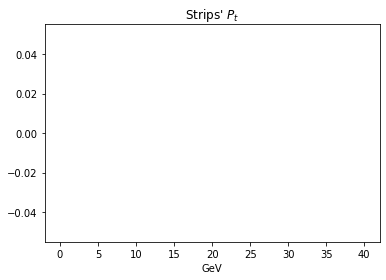

In [79]:
#strip ptss
from matplotlib import pyplot as plt
bins=np.linspace(0,40,50)
#strip_pts_mev=[strip_pt*10**3 for strip_pt in strip_pts]
plt.hist(strip_pts,bins=bins)
plt.xlabel('GeV')
plt.title('Strips\' $P_{t}$')
#plt.savefig('/home/aadi/ml-tau-reco/plots/plots_03_08/strips_pts.png')
plt.show()
#1.5 MeV low mass combined electron and brem and resolution error. Still a good approx?
#ask Joosep why?

In [1214]:
#loc and scale in python mean and std

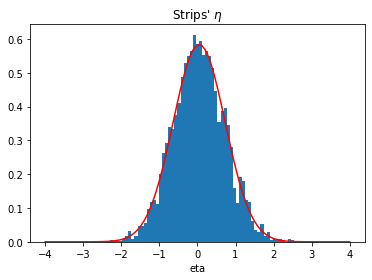

In [1250]:
#strip etas
from scipy import stats
from matplotlib import pyplot as plt
bins=np.linspace(-4,4,100)
#strip_pts_mev=[strip_pt*10**3 for strip_pt in strip_pts]
plt.hist(strip_etas,bins=bins,density=True)
plt.xlabel('eta')
plt.title('Strips\' $\eta$')

loc,scale=stats.norm.fit(strip_etas)
x=np.linspace(-4,4,100)
pdf=stats.norm.pdf(x,loc=loc,scale=scale)
plt.plot(x,pdf,color='red')
#plt.show()
#plt.savefig('/home/aadi/ml-tau-reco/plots/plots_03_08/strips_etas.png')
#1.5 MeV low mass combined electron and brem and resolution error. Still a good approx?
#ask Joosep why?

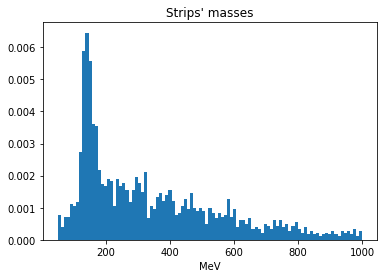

In [1251]:
#strip masses
from matplotlib import pyplot as plt
bins=np.linspace(50,1000,100)
strip_masses_mev=[strip_mass*10**3 for strip_mass in strip_masses]
plt.hist(strip_masses_mev,bins=bins,density=True)



plt.xlabel('MeV')
plt.title('Strips\' masses')

#plt.savefig('/home/aadi/ml-tau-reco/plots/plots_03_08/strips_masses.png')
plt.show()
#1.5 MeV low mass combined electron and brem and resolution error. Still a good approx?
#ask Joosep why?

In [ ]:
#bigger mev = n-pions 150 MeV
#plot eta and phi
#Do it on all events etas and phis.

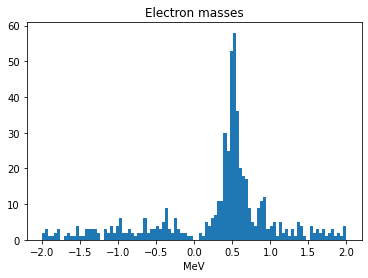

In [1196]:
#electron masses
from matplotlib import pyplot as plt
bins=np.linspace(-2,2,100)
plt.hist(electron_masses,bins=bins)
plt.xlabel('MeV')
plt.title('Electron masses')
plt.savefig('/home/aadi/ml-tau-reco/plots/plots_03_08/electron_masses.png')
plt.show()
#1.5 MeV low mass combined electron and brem and resolution error. Still a good approx?
#ask Joosep why?

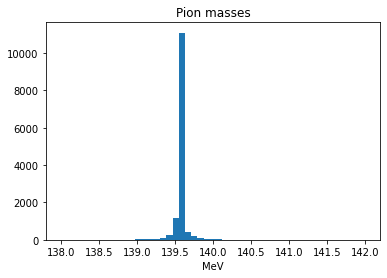

In [1195]:
#pion masses
from matplotlib import pyplot as plt
bins=np.linspace(138,142,50)
plt.hist(pion_masses,bins=bins)
plt.xlabel('MeV')
#plt.savefig('/home/aadi/ml-tau-reco/plots/plots_03_08/pion_masses.png')
plt.title('Pion masses')
plt.show()

# Misc

## Plot the graph for one event

In [ ]:
# from networkx.drawing.nx_pydot import graphviz_layout
# def node_color(node):
#     if node.startswith("gen"):
#         if abs(g.nodes[node]["typ"])==15:
#             return "purple"
#         return "red"
#     elif node.startswith("clu"):
#         return "blue"
#     elif node.startswith("tra"):
#         return "green"
#     else:
#         return "gray"
    
# def node_label(node):
#     typ = node[:4]
#     l = "{}\n{:.2f}".format(g.nodes[node]["typ"], g.nodes[node]["e"])
#     return l

# def edge_label(edge):
#     w = g.edges[edge]["w"]
#     if w>0.0:
#         return "{:.2f}".format(w)
#     return ""

In [ ]:
# plt.figure(figsize=(50,30))
# pos = graphviz_layout(g, prog="dot")
# nx.draw_networkx_nodes(g, pos,
#     node_size=[5*g.nodes[n]["e"] for n in g.nodes],
#     node_color=[node_color(n) for n in g.nodes],
# )
# nx.draw_networkx_labels(g, pos,
#     labels={n: node_label(n) for n in g.nodes},
#     font_size=4
# )
# nx.draw_networkx_edges(g, pos, node_size=100.0);
# nx.draw_networkx_edge_labels(
#     g, pos,
#     edge_labels={e: edge_label(e)  for e in g.edges},
#     font_size=4
# )
# plt.savefig("plot.svg")

In [ ]:
pion_masses2=[]
electron_masses2=[]
all_pions2=[]
all_pions_strips2=[]
errors2=0
event_count2=0
hadronic2=0
leptonic2=0
more_than_1taus2=[]
for nf,fn in enumerate(glob.glob("/scratch-persistent/joosep/ml-tau-reco/clic/gev380ee_pythia6_ttbar_rfull201/*.json.bz2")):
    #print('teen')
    if not nf % 100: print("Event: "+str(nf))
    event_count2+=1
    #if nf > 10: # -->15 min
    #    break
    #Load the data file consisting of multiple events
    data = json.load(bz2.BZ2File(fn, "r"))
    
    #Loop over the events in the data file
    
    for iev in range(len(data)):
        #print(iev)
        event_count2+=1
        ret=process_one_event(data, iev)
        #ret = cleanJets(ret[0], ret[1], ret[2], ret[3], ret[4], ret[5])
        try:
            ret = cleanJets(ret[0], ret[1], ret[2], ret[3], ret[4], ret[5])
        except Exception:
            errors2 +=1
            #print(f'errors: {errors}')
            continue
        if len(ret[0])>1:
            #print("more than one taus")
            more_than_1taus2.append([ret[0], ret[1], ret[2]])       
        leptonic2+=ret[5]
        hadronic2+=ret[6]
        #print(f'length of ret {len(ret[2])}')
        if len(ret[2]):#if list contains something(Taus) do it:
            #print("Yeah contained something")
            taus=ret[0][0]
            jets=ret[1][0]
            event_pfs=ret[2][0]    
            pions=get_pions(event_pfs)
            #Create a dict that combines strips,taus,pions,jets of single event    
            #Add all pions to a list from which the tau candidates can be calculated
            strips_pions_taus={'strips' : [], 'pions' : pions ,'taus' : taus, 'jets' : jets}
            electrons=get_electrons(event_pfs)
            for el in electrons:
                electron_masses2.append(get_pf_mass(el)*10**3)# Adding pion masses
            for pion in pions:
                pion_masses2.append(get_pf_mass(pion)*10**3)# Adding pion masses
                
            strips=cal_strips_event(event_pfs)
            #print(len(strips))
            
            
            if len(strips)!=0: #some events contain only pions. Have to fix it right no just a patch with a if clause
                #So if strips has any length then add to memory. If not ignore
                #strips_pions_taus['strips'].append(strips)
                strips_pions_taus['strips']=strips
            #temptau error exception
            all_pions_strips2.append(strips_pions_taus)
            
        else: #if empty continue
            continue
            
        #print(f'errors:{errors} ')
        

Event: 0


In [322]:
len(all_pions_strips2)


4931

In [433]:
print(f'Leptonic decays: {leptonic2}')
print(f'Hadronic decays: {hadronic2}')
print(f'Percentage of leptonic decays: {round(leptonic2/(hadronic2+leptonic2)*100,2)}%')
#Leptonic should be circa 35.21% So correct

Leptonic decays: 16034
Hadronic decays: 29637
Percentage of leptonic decays: 35.11%


In [434]:
#Lets do the first combinatorics. 3 charged pions charge  must be 1.
#So two same and one opposite charge.
#all_pions_strips[1]['pions'][0]-six pions
#test_pions
#pions=all_pions_strips[1]['pions'][0]
#test_pions=all_pions_strips[1]['pions'][0]
#def ch_pions_comb(pions):
#####3Charged particles
tau_candidates2=[]
for evt in range(len(all_pions_strips2)):
    evt_tau_candidates2=[]
    pions=all_pions_strips2[evt]['pions']
    #print(all_pions_strips[evt]['strips'])
    
    strips=all_pions_strips2[evt]['strips']
    strip_comb_indxs=[]
    pion_indxs=range(len(pions))
    strip_indxs=range(len(strips))
    if len(pions)>2:#if more than two pions, then 3 pions candidates are possible.
        print('more than two')
        #Three charged hadron mode
        #find subsets of three particles
        combs= list(itertools.combinations(pion_indxs, 3))
        #iterate through all combinations
        for i,pion_comb_indxs in enumerate(combs):
            #if charge abs(1) then continue:        
            charge_sum=sum([pions[i].charge for i in pion_comb_indxs])
            if abs(charge_sum)==1:
                #print('charge1')
                #now calculate mass of tau candidate(3 charged pions) from their 4-vector.
                lvs=[getPF_lv(pions[i]) for i in pion_comb_indxs]
                tau_cand_lv=sum_lvs(lvs)
                tau_cand_mass=tau_cand_lv.mass
                tau_cand_pt=tau_cand_lv.pt
                if 0.8<tau_cand_mass<1.5:
                    print(f'evt: {evt}')
                    print('found  smthng')
                    #Calculate cone using formula and tau candidate pt
                    cone_dr=calc_conedr(tau_cand_pt)
                    result=check_if_incone(pions, strips, pion_comb_indxs, strip_comb_indxs,cone_dr,tau_cand_lv)
                    if result == False:
                        #Nothing surrounds the candidate
                        print('found something true!!!')
                        tau_candidate=tau_cand_lv
                        evt_tau_candidates2.append(tau_candidate)
    if len(pions)=>1 and len(strips)>=2:
        #one charged hadron + two strips mode:
        
        strip_combs=list(itertools.combinations(strip_indxs, 2))
        for i,pion enumerate(pions):
            #iterate over all pions and match with two strip combination:
            for j,strip_comb_indxs in enumerate(strip_combs):
                pion_lv=getPF_lv(pions[i])
                strips_lv=get_strip_lv(strip_comb_indxs[0])+get_strip_lv(strip_comb_indxs[1])
                print(strips_lv)
            
        Vale
    
    
    
        #sort evt_candidates by pt and take the one with highest pt as candidate
        sorted_cands=sort_by_pt2(evt_tau_candidates2)
        if len(sorted_cands)!=0:
            tau_candidates2.append(sorted_cands[0])

SyntaxError: invalid syntax (<ipython-input-434-60a7e89f87a5>, line 46)

In [370]:
print(errors2)
print(len(more_than_1taus2))

1004
7


In [339]:
cand_masses=[cand.mass for cand in tau_candidates2]

In [340]:
len(cand_masses)
#Length before sorting 3340
#after cleaning 1166

1166

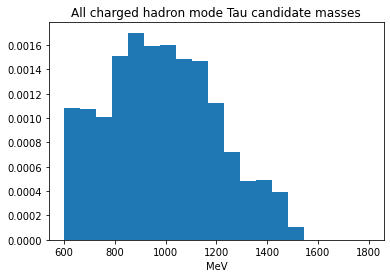

In [454]:
#cand masses
from matplotlib import pyplot as plt
bins=np.linspace(600,1800,20)
cand_masses=[cand.mass for cand in tau_candidates]
#strip_masses_mev=[strip_mass*10**3 for strip_mass in strip_masses]
cand_masses_mev=[cand_mass*10**3 for cand_mass in cand_masses]
plt.hist(cand_masses_mev,bins=bins,density=True)



plt.xlabel('MeV')
plt.title('All charged hadron mode Tau candidate masses')

#plt.savefig('/home/aadi/ml-tau-reco/plots/plots_03_08/strips_masses.png')
plt.show()
#before was around 1,2.

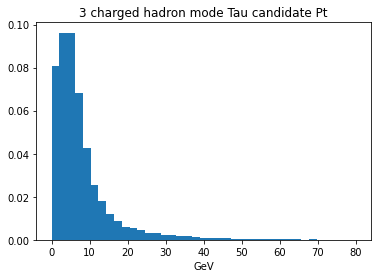

In [451]:
#cand pts
from matplotlib import pyplot as plt
bins=np.linspace(0,80,40)
cand_pts=[cand.pt for cand in tau_candidates]
#strip_masses_mev=[strip_mass*10**3 for strip_mass in strip_masses]
#cand_masses_mev=[cand_mass*10**3 for cand_mass in cand_masses]
plt.hist(cand_pts,bins=bins,density=True)



plt.xlabel('GeV')
plt.title('3 charged hadron mode Tau candidate Pt')

#plt.savefig('/home/aadi/ml-tau-reco/plots/plots_03_08/strips_masses.png')

plt.show()

In [ ]:
#gen particles Taus distributions for comparison

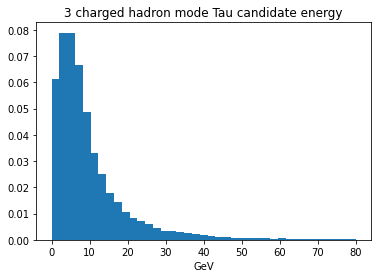

In [452]:
#https://arxiv.org/pdf/1510.07488.pdf#cand energy
from matplotlib import pyplot as plt
bins=np.linspace(0,80,40)
cand_energy=[cand.energy for cand in tau_candidates]
#strip_masses_mev=[strip_mass*10**3 for strip_mass in strip_masses]
#cand_masses_mev=[cand_mass*10**3 for cand_mass in cand_masses]
plt.hist(cand_energy,bins=bins,density=True)



plt.xlabel('GeV')
plt.title('3 charged hadron mode Tau candidate energy')

#plt.savefig('/home/aadi/ml-tau-reco/plots/plots_03_08/strips_masses.png')
plt.show()